# Importing Module

In [ ]:
import torch
from tqdm import tqdm
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from math import e
import plotly.graph_objects as go
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
%matplotlib inline
from PIL import Image

In [ ]:
lr = 0.005

# **Intuition Behind *Mixture of Experts* in ODE Solvers**
Differential equations often exhibit complex behaviors, and fitting a single neural network to capture all such dynamics can lead to suboptimal results. The intuition behind using a mixture of experts in ODE solvers is to leverage specialized networks, each trained to handle specific types or ranges of dynamics. Much like *oscillatory equations* where the output isn’t linear, training a single model on a broad range of dynamics can lead to instability and hinder learning. By splitting the task across expert networks, each can focus on learning stable solutions within its own specialized range, leading to a more robust overall solution.

# Network

In [ ]:
class Network(nn.Module):

    def __init__(self, N_INPUT = 1 , N_OUTPUT = 1, N_HIDDEN = 32, N_LAYERS = 3, init_weight = False, act = nn.Tanh ):
        super().__init__()
        activation = act
        self.fcs = nn.Sequential(*[
                        nn.Linear(N_INPUT, N_HIDDEN),
                        activation()])
        self.fch = nn.Sequential(*[
                        nn.Sequential(*[
                            nn.Linear(N_HIDDEN, N_HIDDEN),
                            activation()]) for _ in range(N_LAYERS-1)])
        self.fce = nn.Linear(N_HIDDEN, N_OUTPUT)
        if init_weight:
          self.apply(self._init_weights)

    def _init_weights(self, module):
        if isinstance(module, nn.Linear):
            print("called")
            torch.nn.init.xavier_normal_(module.weight)
            if module.bias is not None:
                module.bias.data.fill_(0.0)

    def forward(self, x):
        x = self.fcs(x)
        x = self.fch(x)
        x = self.fce(x)
        return x

In [ ]:
class Expert(nn.Module):
    def __init__(self, N_INPUT, N_HIDDEN,  N_LAYERS , init_weight, act):
        super(Expert, self).__init__()
        self.network = Network(N_INPUT = N_INPUT, N_HIDDEN = N_HIDDEN,  N_LAYERS = N_LAYERS, init_weight = init_weight, act = act)
    def forward(self, x):
        return self.network(x)

class GatingNetwork(nn.Module):
    def __init__(self, N_INPUT, N_OUTPUT, N_HIDDEN = 16, init_weight = False, activation = nn.ReLU, N_LAYERS = 2):
        super(GatingNetwork, self).__init__()
        self.network = Network(N_INPUT = N_INPUT, N_HIDDEN = N_HIDDEN,  N_LAYERS = N_LAYERS, init_weight = init_weight, act = activation, N_OUTPUT = N_OUTPUT)
    def forward(self, x):
        o = F.softmax(self.network(x)/2, dim = 1)
        return o

class MixtureOfExperts(nn.Module):
    def __init__(self, N_EXPERT = 1, N_HIDDEN=32, output_dim=1, N_LAYERS = 3 , init_weight = False, act =  nn.Tanh, GATE_HIDDEN =  16,  GATE_LAYERS = 1 , GATE_ACTIVATION = nn.ReLU, GATE_init_wieghts = False):
        super(MixtureOfExperts, self).__init__()
        self.gate_weights = None
        self.experts = nn.ModuleList([Expert(2, N_HIDDEN, N_LAYERS, init_weight, act) for _ in range(N_EXPERT)])
        self.gating_network = GatingNetwork(1, N_EXPERT, GATE_HIDDEN, GATE_init_wieghts, GATE_ACTIVATION, GATE_LAYERS)

    def forward(self, x):
        x_sin = torch.sin(x)
        x_transformed = torch.cat([x, x_sin], dim=-1)
        self.gate_weights = self.gating_network(x)
        expert_outputs = torch.stack([expert(x_transformed) for expert in self.experts], dim=-1)
        output = torch.sum(expert_outputs * self.gate_weights.unsqueeze(1), dim=-1)
        return output

# Additional Function

In [ ]:
def visulaize(train_solution, network, domain_lb = 0, domain_ub = 1, points = 100):
  t = torch.linspace(domain_lb, domain_ub, points, requires_grad=True).unsqueeze(1)
  solution = trial_solution(network, t)
  t = t.detach().cpu().numpy()
  solution = solution.detach().cpu().numpy()
  plt.figure(figsize=(8, 6))
  plt.plot(t, solution, label='Neural Network Solution')
  plt.plot(t_values, x_values, label = "Exact Solution")
  plt.xlabel('t')
  plt.legend()
  plt.grid(True)
  plt.show()

In [ ]:
def plot_result(x , y, xh , yh,  xp=None, i = None, x_data = None, y_data = None):
    plt.figure(figsize=(8,4))
    plt.plot(x ,y, color="grey", linewidth=2, alpha=0.8, label="Exact solution")
    plt.plot(xh, yh, color="tab:blue", linewidth=4, alpha=0.8, label="Neural network prediction")

    if xp is not None:
        plt.scatter(xp, -0*torch.ones_like(xp), s=60, color="tab:green", alpha=0.4,
                    label='Physics loss training locations')
    if x_data is not None:
        plt.scatter(x_data, y_data, s=60, color="tab:orange", alpha=0.4,
                label='Data Points')

    l = plt.legend(loc=(1.01,0.34), frameon=False, fontsize="large")
    plt.setp(l.get_texts(), color="k")
    plt.xlim(-0.05, 3.05)
    plt.ylim(-1.1, 1.1)
    if i :
      plt.text(1.065,0.7,"Training step: %i"%(i+1),fontsize="xx-large",color="k")
    # plt.axis("off")

In [ ]:
def save_gif_PIL(outfile, files, fps=5, loop=0):
    "Helper function for saving GIFs"
    imgs = [Image.open(file) for file in files]
    imgs[0].save(fp=outfile, format='GIF', append_images=imgs[1:], save_all=True, duration=int(1000/fps), loop=loop)


# Training Function

In [ ]:
# training function considering batch size
def train(optimizer, network, loss_function, trial_solution, epochs, display_step=10,
                   domain_lower_bound=0, domain_upper_bound=1, num_points=10, step_size=2, plot_points=500, gif_n = "gif", scheduler = None):

    l = []
    # alpha = 1
    for i in range(domain_lower_bound, domain_upper_bound, step_size):
        l.append((i, min(i + step_size, domain_upper_bound)))

    for epoch in tqdm(range(epochs), desc="Epochs Progress", leave=True):
        for (low, up) in l:
            optimizer.zero_grad()
            loss = loss_function(network, trial_solution, low, up, num_points)

            gate_weights = network.gate_weights
            max_weight = torch.tensor([0.00])
            # # loss2 = -torch.mean(torch.sum(gate_weights * torch.log( gate_weights + 1e-12), dim=1))
            usage_penalty = torch.mean((gate_weights.mean(dim=0) - 1/gate_weights.shape[1]) ** 2)
            for expert in range(gate_weights.shape[1]):
              max_weight = torch.max(max_weight , torch.sum(torch.argmax(gate_weights, dim = 1) == expert))
            loss = loss +  0.01*usage_penalty
            loss.backward()
            optimizer.step()

            if epoch % display_step == 0:
                print(max_weight)
                print(f"epoch: {epoch}, loss: {loss.item()}")
        if scheduler:
            scheduler.step()
        if epoch % display_step == 0:
            visulaize(trial_solution, network, domain_lower_bound, domain_upper_bound, plot_points)

In [ ]:
def only_physics_train(optimizer, network, loss_function, trial_solution, epochs, display_step=10,
                   domain_lb=0, domain_ub=1, num_points=10,  plot_points=500, x = None ,y = None, gif_n="van_exp1", scheduler = None):

    files = []
    for epoch in tqdm(range(epochs), desc="Epochs Progress", leave=True):
            optimizer.zero_grad()

            # Compute the loss
            loss = loss_function(network, trial_solution, domain_lb, domain_ub, num_points)
            loss.backward()
            optimizer.step()
            if scheduler:
              scheduler.step()
            if epoch % display_step == 0:
                print(f"epoch: {epoch}, loss: {loss.item()}")

            if (epoch) % 100 == 0:
              xp = torch.linspace(domain_lb, domain_ub, num_points, requires_grad=True).unsqueeze(1).detach().cpu()
              xh = torch.linspace(domain_lb, domain_ub, plot_points, requires_grad=True).unsqueeze(1)
              yh = trial_solution(network, xh).detach().cpu().numpy()
              xh = xh.detach().cpu().numpy()

              plot_result(x,y,xh,yh, xp)

              file = f"/content/plots/{gif_n}%.8i.png"%(epoch+1)
              plt.savefig(file, bbox_inches='tight', pad_inches=0.1, dpi=100, facecolor="white")
              files.append(file)

              if (epoch) % display_step == 0: plt.show()
              else: plt.close("all")

    save_gif_PIL(f"{gif_n}.gif", files, fps=50, loop=0)

# Van der Pol-Duffing equation

In [ ]:
params = {"u" : 0 , "alpha" : 0.09, "beta" : 0.0036 , "F" : 0.2 , "omega": 2}

In [ ]:
# Runge-Kutta 4th-order method
def rk4_step(f, t, y, h):
    k1 = h * f(t, y)
    k2 = h * f(t + 0.5 * h, y + 0.5 * k1)
    k3 = h * f(t + 0.5 * h, y + 0.5 * k2)
    k4 = h * f(t + h, y + k3)
    return y + (k1 + 2 * k2 + 2 * k3 + k4) / 6

In [ ]:
# Define the system of ODEs
def duffing_oscillator(t, y):
    x, x_dot = y
    dxdt = x_dot
    d2xdt2 = -(0.3**2) * (x + (0.2**2) * x**3) + 0.2 * np.sin(2 * t)
    return np.array([dxdt, d2xdt2])

In [ ]:
t0 = 0
tf = 15
h = 0.001
N = int((tf - t0) / h)
y0 = np.array([0.15, 0.0])

# Time array
t_values = np.linspace(t0, tf, N)
x_values = np.zeros(N)
x_dot_values = np.zeros(N)

# Initial values
x_values[0] = y0[0]
x_dot_values[0] = y0[1]

# Solve using RK4
y = y0
for i in range(1, N):
    y = rk4_step(duffing_oscillator, t_values[i-1], y, h)
    x_values[i] = y[0]
    x_dot_values[i] = y[1]

In [ ]:
def first_order_loss(neural_network, trial_solution,  domain_lower_bound=0, domain_upper_bound=1, num_points=10):

    delta = 1e-5
    t = torch.linspace(domain_lower_bound, domain_upper_bound, num_points, requires_grad=True).unsqueeze(1)
    x = trial_solution(neural_network, t)

    dx_dt = torch.autograd.grad(x, t, grad_outputs=torch.ones_like(x),create_graph=True)[0]
    d2x_dt2 = torch.autograd.grad(dx_dt, t,  grad_outputs=torch.ones_like(dx_dt),create_graph=True)[0]

    individual_error = torch.abs((d2x_dt2 - params["u"]*(1 - x**2)*dx_dt + params["alpha"]*x  + params["beta"]*(x**3) - params["F"]*torch.sin(params["omega"]*t) ))

    return torch.sum(individual_error)/num_points

In [ ]:
def trial_solution(neural_network, x):
    return 0.15 + x*x*neural_network(x)

# **Experiment**
# 1. Number Of Expert

## Num Of Expert = 1

In [ ]:
model_expert_1 = MixtureOfExperts(N_EXPERT = 1)
optimizer_expert_1 = optim.Adam(model_expert_1.parameters(), lr = lr  )

In [ ]:
train(optimizer_expert_1, model_expert_1, first_order_loss, trial_solution, 40001, 500, 0, 15, 500, 15, 1000)

## Num Of Expert = 2

In [ ]:
model_expert_2 = MixtureOfExperts(N_EXPERT = 2)
optimizer_expert_2 = optim.Adam(model_expert_2.parameters(), lr = lr  )

Epochs Progress:   0%|          | 0/40001 [00:00<?, ?it/s]

epoch: 0, loss: 0.03263954445719719


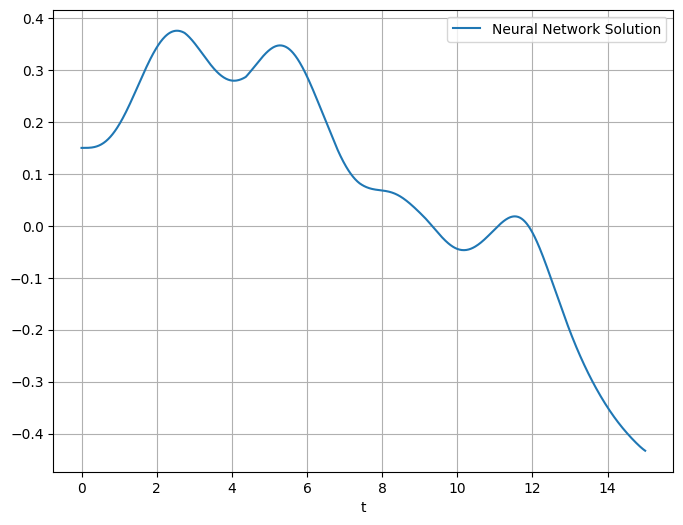

Epochs Progress:   1%|          | 499/40001 [00:07<10:53, 60.46it/s]

epoch: 500, loss: 0.02329143136739731


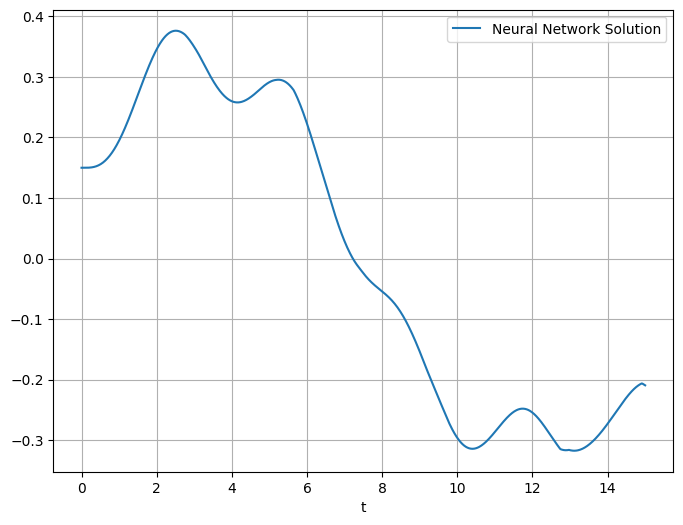

Epochs Progress:   2%|▏         | 995/40001 [00:12<07:11, 90.42it/s]

epoch: 1000, loss: 0.01797463931143284


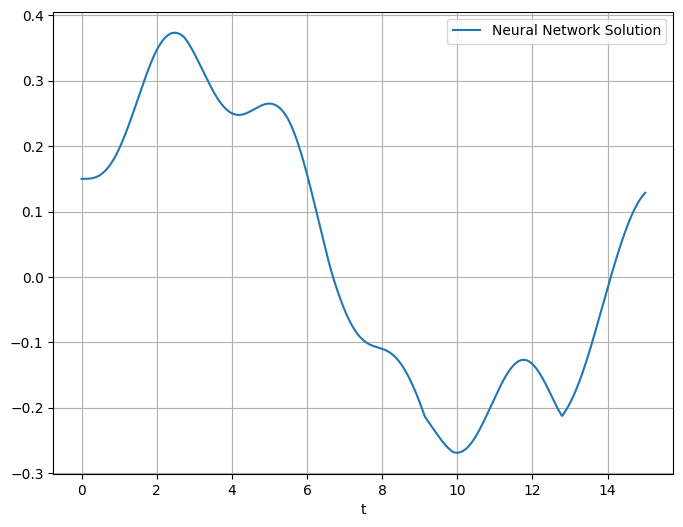

Epochs Progress:   4%|▎         | 1495/40001 [00:19<10:25, 61.58it/s]

epoch: 1500, loss: 0.016808943822979927


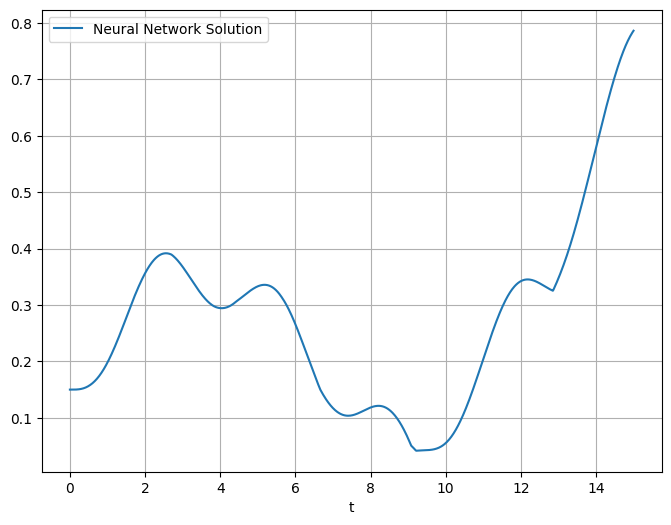

Epochs Progress:   5%|▍         | 1994/40001 [00:25<06:53, 91.89it/s]

epoch: 2000, loss: 0.030588943511247635


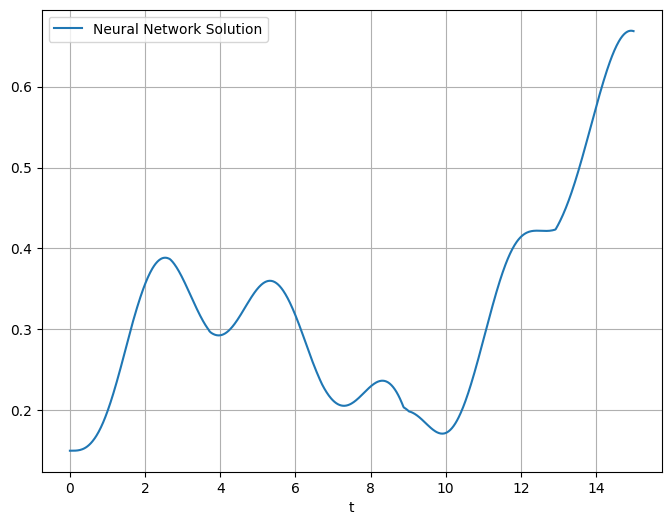

Epochs Progress:   6%|▌         | 2491/40001 [00:31<06:36, 94.62it/s]

epoch: 2500, loss: 0.03383699432015419


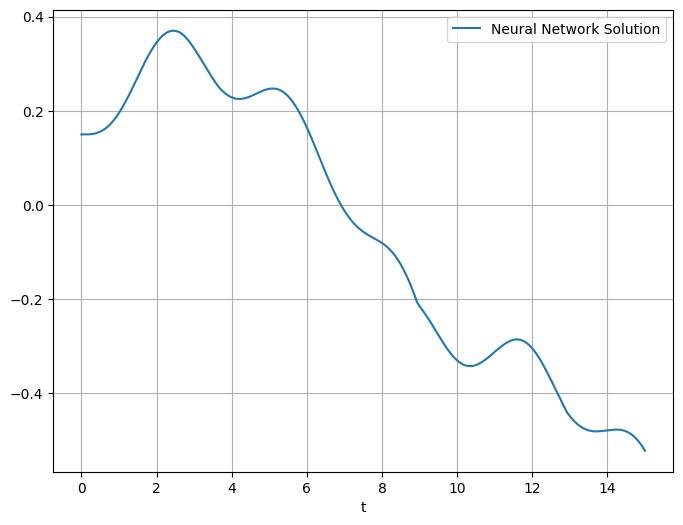

Epochs Progress:   7%|▋         | 2998/40001 [00:38<06:50, 90.20it/s]

epoch: 3000, loss: 0.011661933735013008


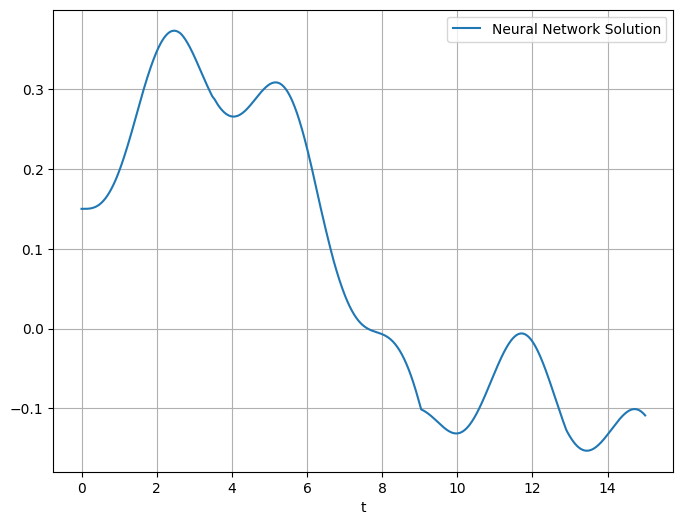

Epochs Progress:   9%|▊         | 3491/40001 [00:43<06:35, 92.27it/s]

epoch: 3500, loss: 0.019068246707320213


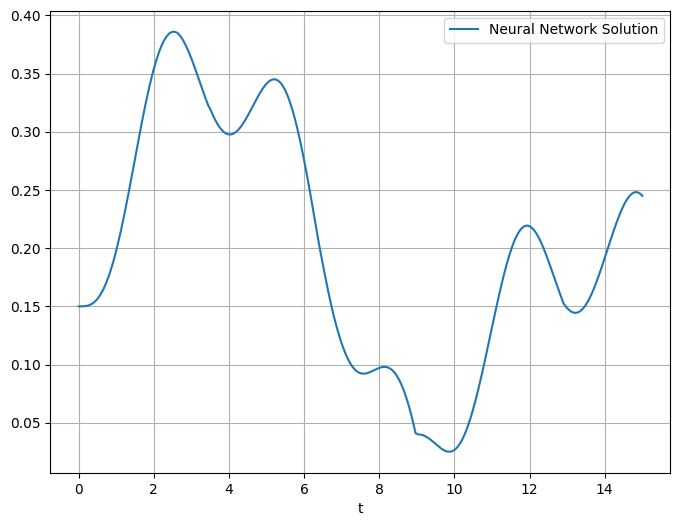

Epochs Progress:  10%|▉         | 3994/40001 [00:51<06:39, 90.11it/s]

epoch: 4000, loss: 0.011328895576298237


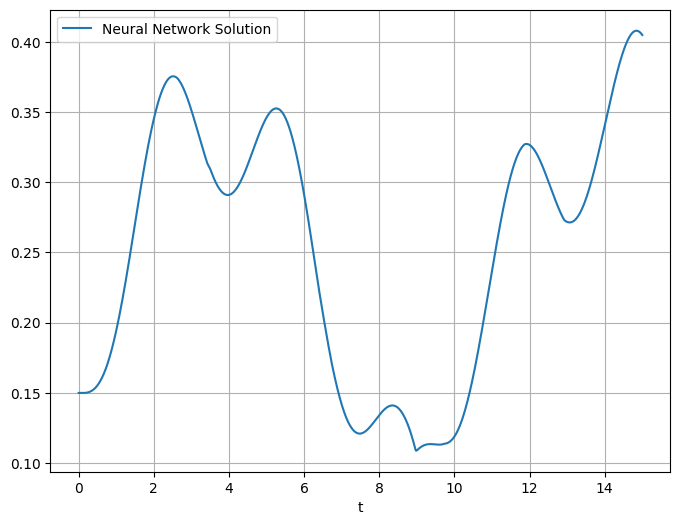

Epochs Progress:  11%|█         | 4496/40001 [00:57<07:08, 82.78it/s]

epoch: 4500, loss: 0.019197460263967514


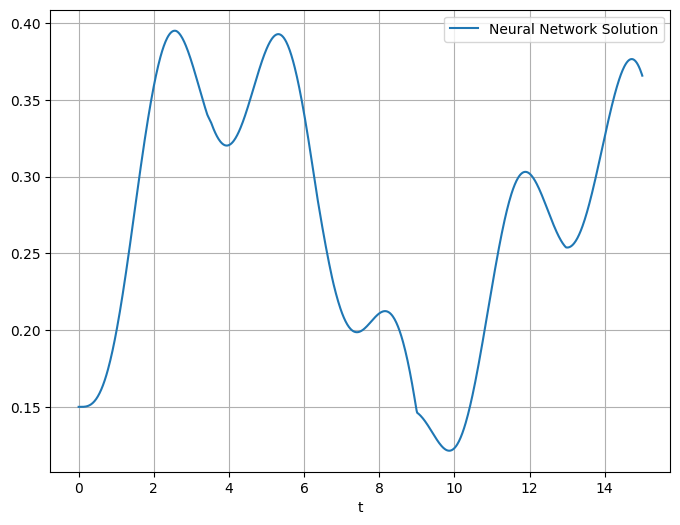

Epochs Progress:  12%|█▏        | 4995/40001 [01:04<07:37, 76.50it/s]

epoch: 5000, loss: 0.016719626262784004


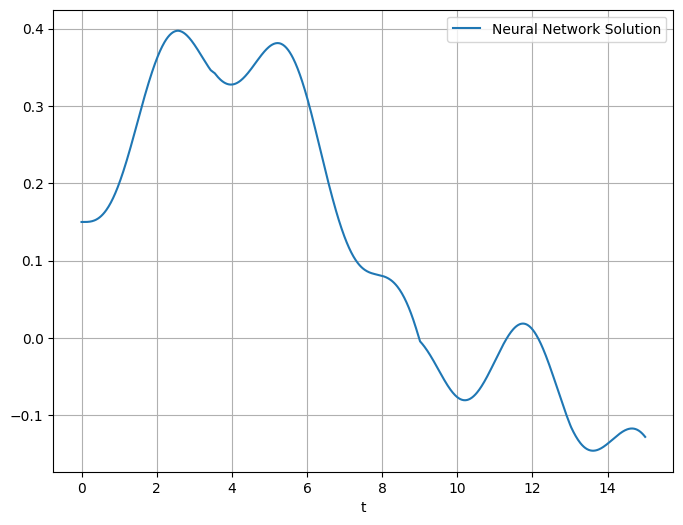

Epochs Progress:  14%|█▎        | 5498/40001 [01:10<06:47, 84.59it/s]

epoch: 5500, loss: 0.016657928004860878


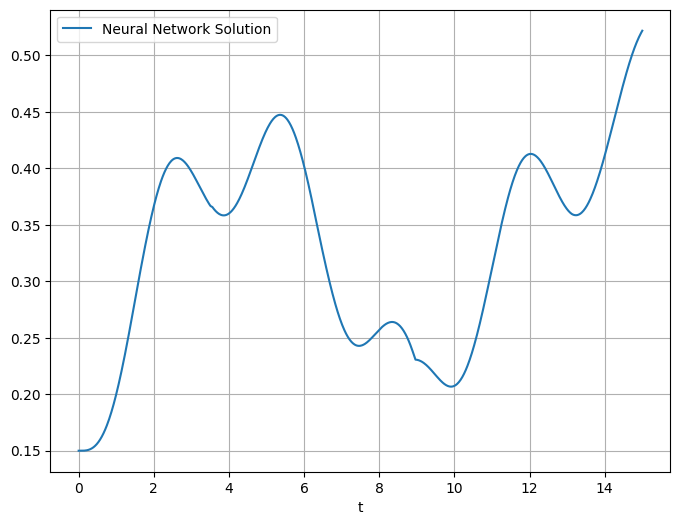

Epochs Progress:  15%|█▍        | 5994/40001 [01:17<09:19, 60.81it/s]

epoch: 6000, loss: 0.017852965742349625


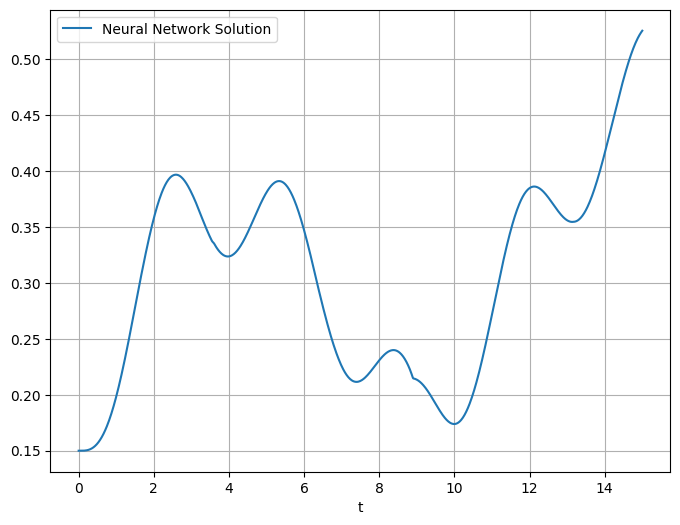

Epochs Progress:  16%|█▌        | 6493/40001 [01:23<06:31, 85.60it/s]

epoch: 6500, loss: 0.012047975324094296


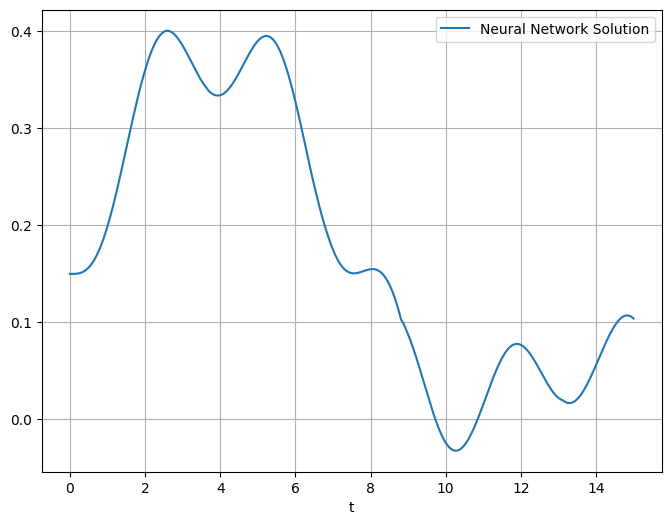

Epochs Progress:  17%|█▋        | 6997/40001 [01:29<09:10, 59.92it/s]

epoch: 7000, loss: 0.009143603034317493


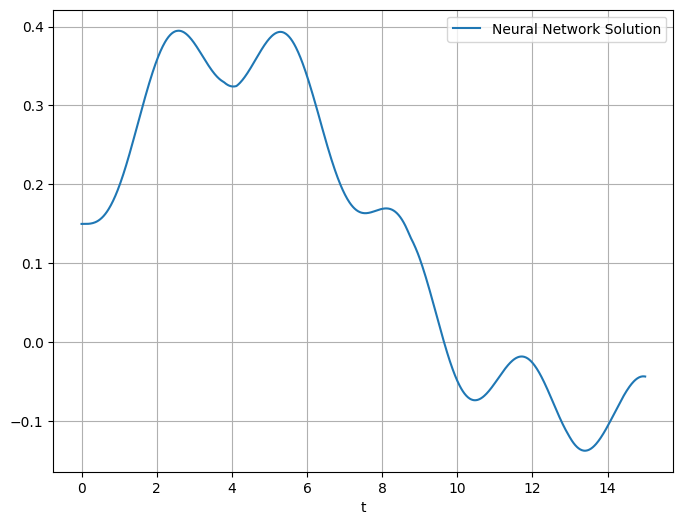

Epochs Progress:  19%|█▊        | 7492/40001 [01:36<06:18, 86.00it/s]

epoch: 7500, loss: 0.009368112310767174


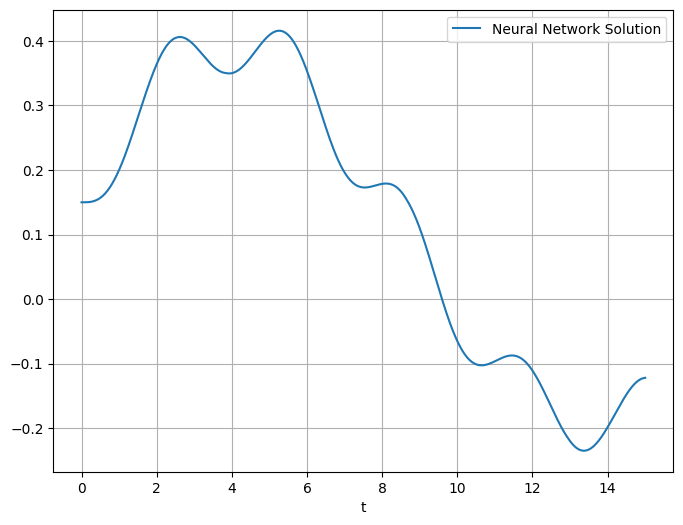

Epochs Progress:  20%|█▉        | 7995/40001 [01:42<06:54, 77.19it/s]

epoch: 8000, loss: 0.006955214310437441


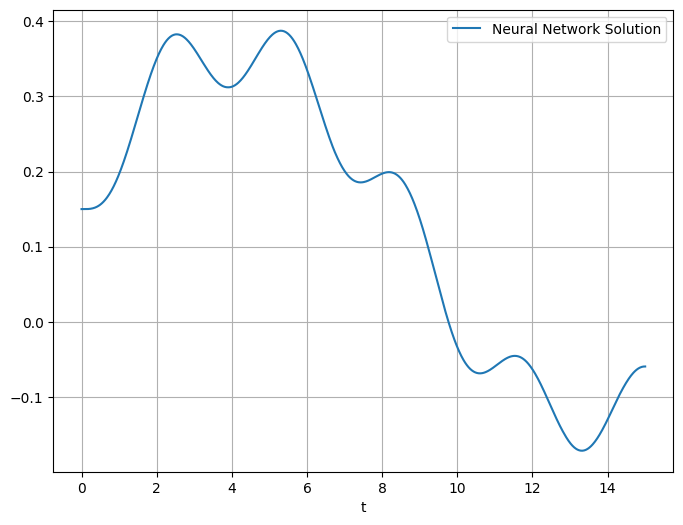

Epochs Progress:  21%|██        | 8494/40001 [01:49<05:46, 90.80it/s]

epoch: 8500, loss: 0.012498890049755573


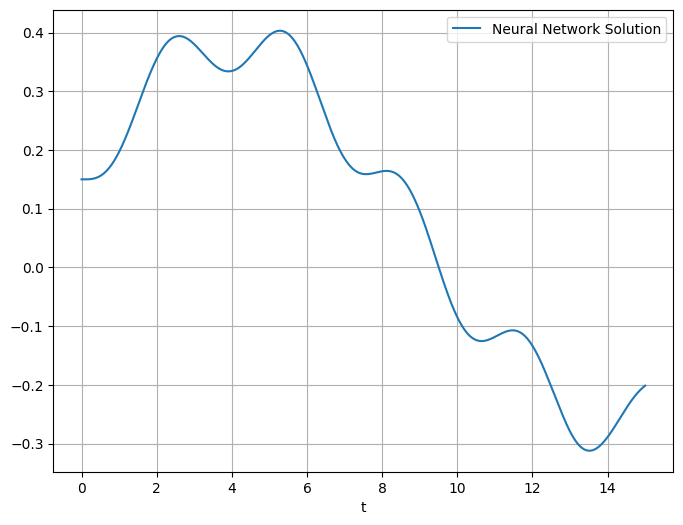

Epochs Progress:  22%|██▏       | 8995/40001 [01:55<06:00, 86.12it/s]

epoch: 9000, loss: 0.0063133230432868


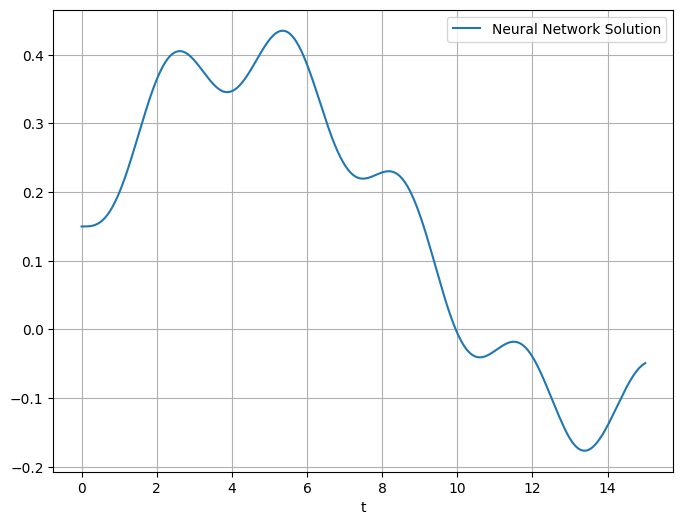

Epochs Progress:  24%|██▎       | 9495/40001 [02:03<05:54, 86.06it/s]

epoch: 9500, loss: 0.010084065608680248


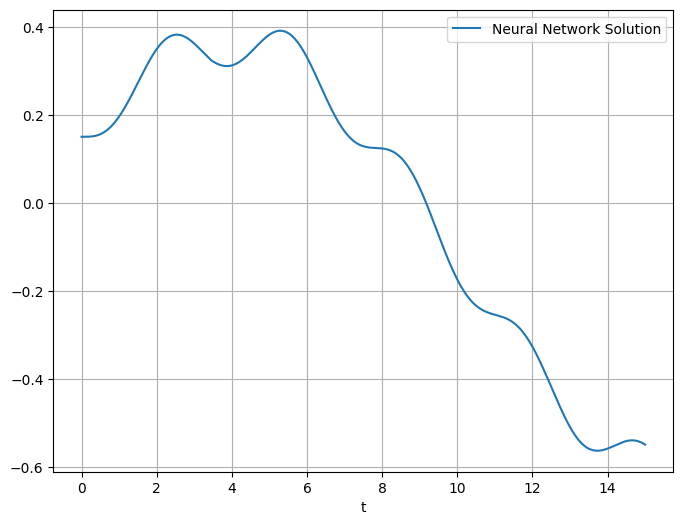

Epochs Progress:  25%|██▍       | 9993/40001 [02:09<05:54, 84.69it/s]

epoch: 10000, loss: 0.005701030138880014


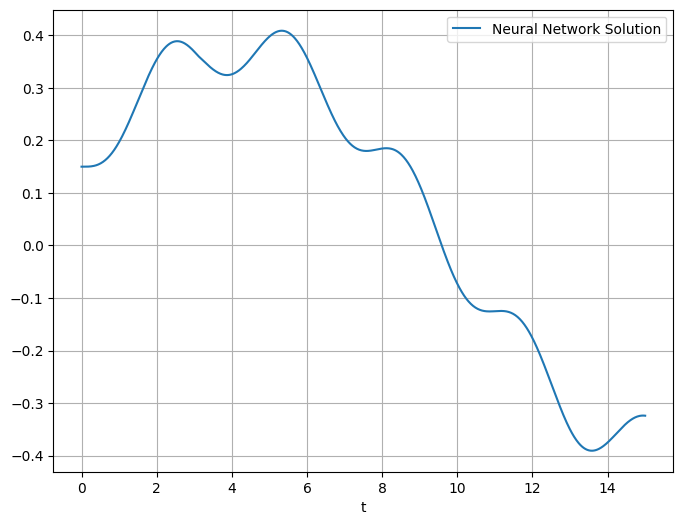

Epochs Progress:  26%|██▌       | 10494/40001 [02:16<05:48, 84.78it/s]

epoch: 10500, loss: 0.005646315403282642


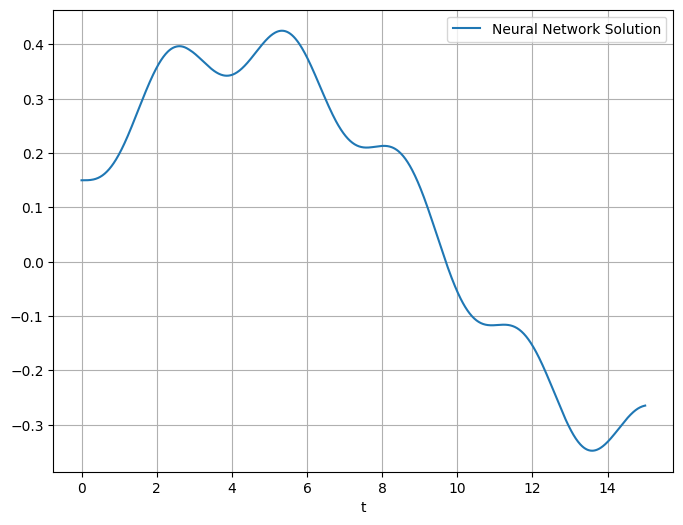

Epochs Progress:  27%|██▋       | 10995/40001 [02:22<05:36, 86.25it/s]

epoch: 11000, loss: 0.009912670589983463


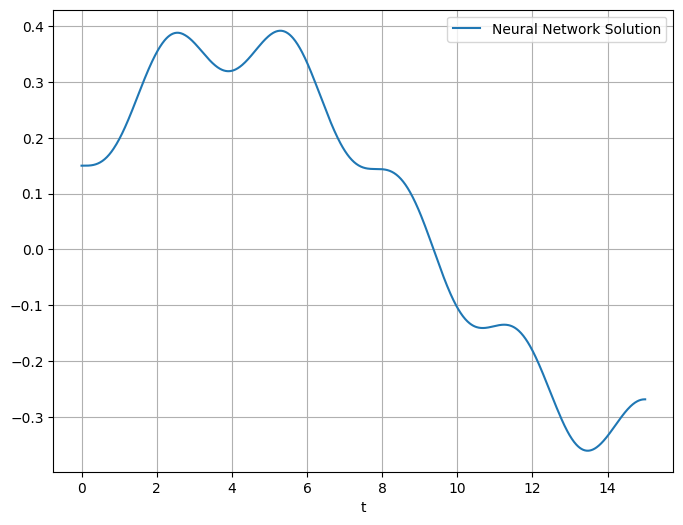

Epochs Progress:  29%|██▊       | 11493/40001 [02:30<06:09, 77.18it/s]

epoch: 11500, loss: 0.007528665009886026


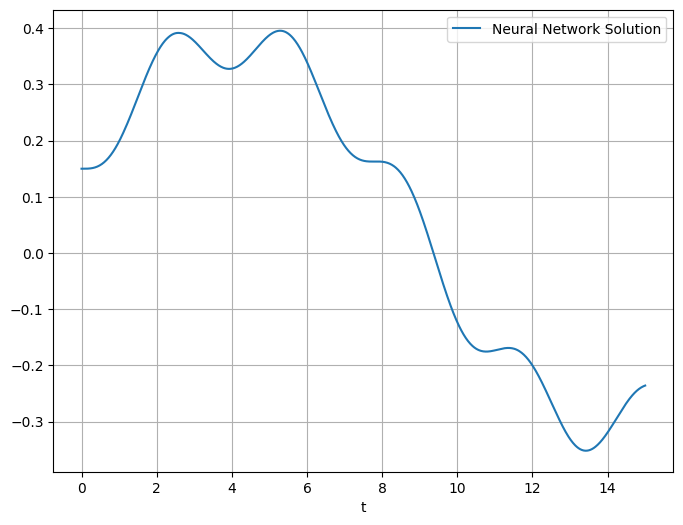

Epochs Progress:  30%|██▉       | 12000/40001 [02:36<05:27, 85.41it/s]

epoch: 12000, loss: 0.007414912339299917


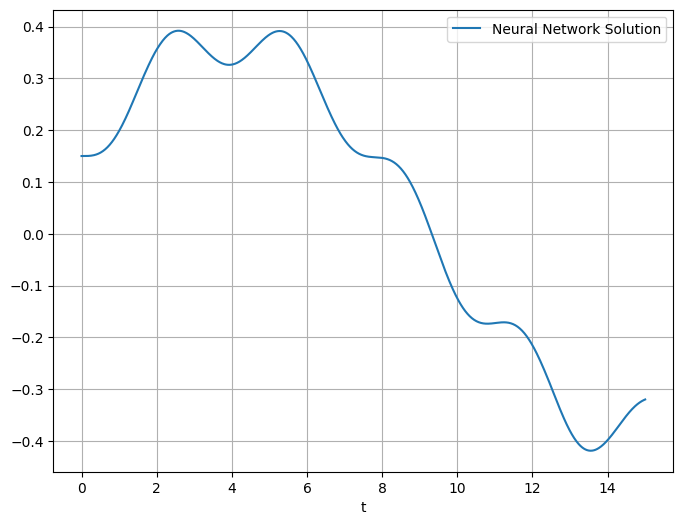

Epochs Progress:  31%|███       | 12499/40001 [02:43<07:54, 57.90it/s]

epoch: 12500, loss: 0.0039474135264754295


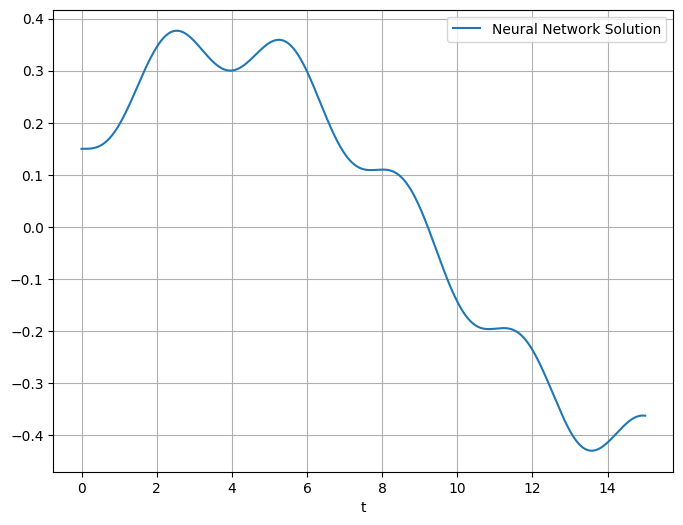

Epochs Progress:  32%|███▏      | 12997/40001 [02:49<05:21, 84.00it/s]

epoch: 13000, loss: 0.005522866267710924


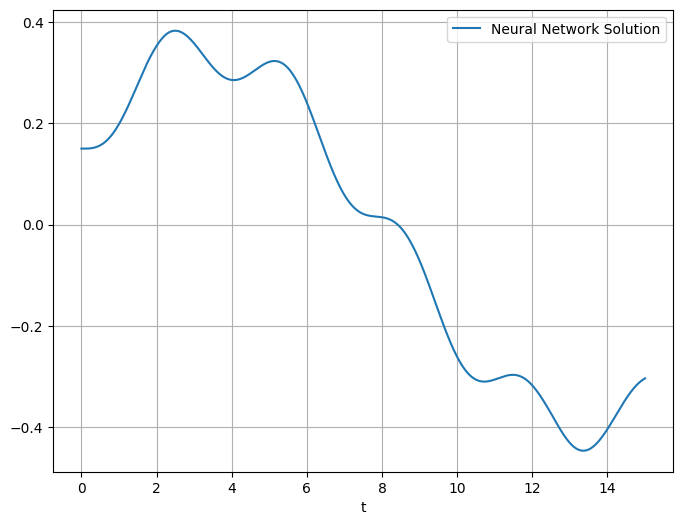

Epochs Progress:  34%|███▎      | 13499/40001 [02:56<07:18, 60.43it/s]

epoch: 13500, loss: 0.007074318826198578


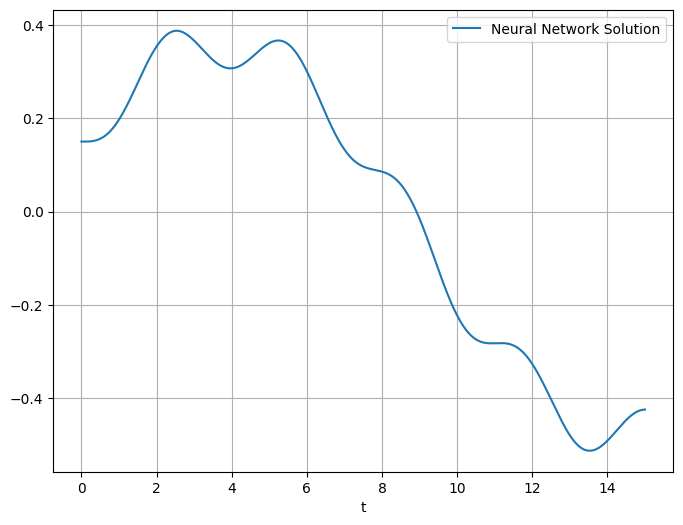

Epochs Progress:  35%|███▍      | 13997/40001 [03:03<04:59, 86.87it/s]

epoch: 14000, loss: 0.010735195130109787


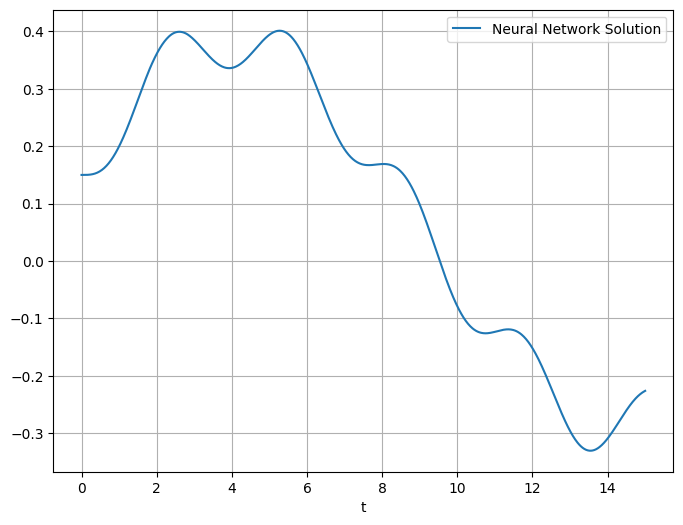

Epochs Progress:  36%|███▌      | 14500/40001 [03:09<06:23, 66.44it/s]

epoch: 14500, loss: 0.01095096580684185


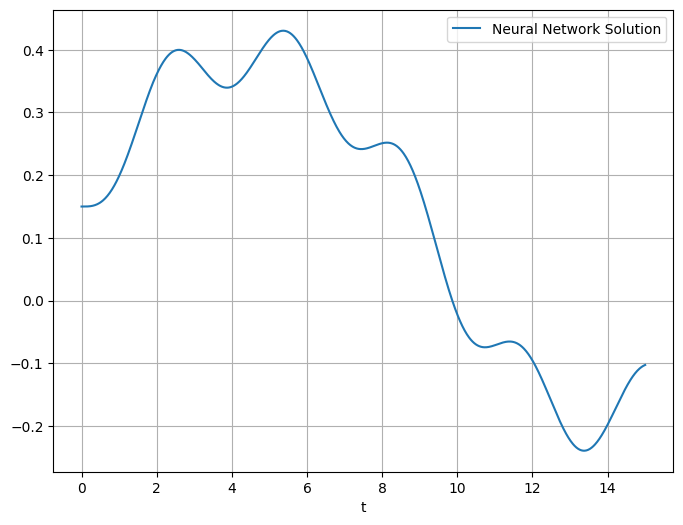

Epochs Progress:  37%|███▋      | 15000/40001 [03:16<04:52, 85.59it/s]

epoch: 15000, loss: 0.004951992072165012


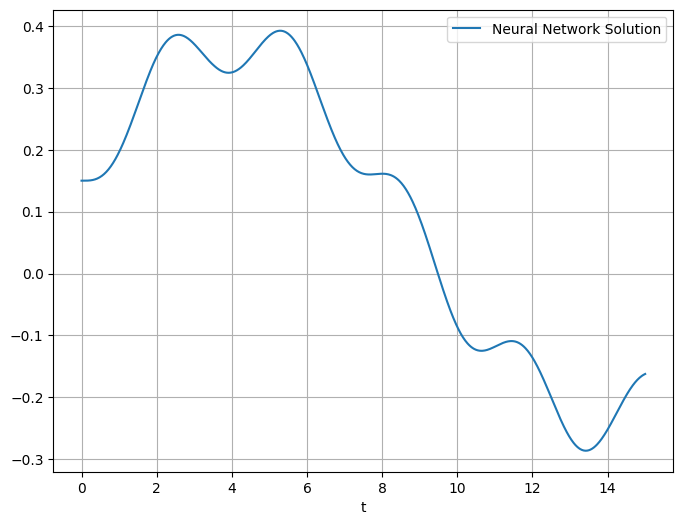

Epochs Progress:  39%|███▊      | 15496/40001 [03:22<04:49, 84.61it/s]

epoch: 15500, loss: 0.0028173658065497875


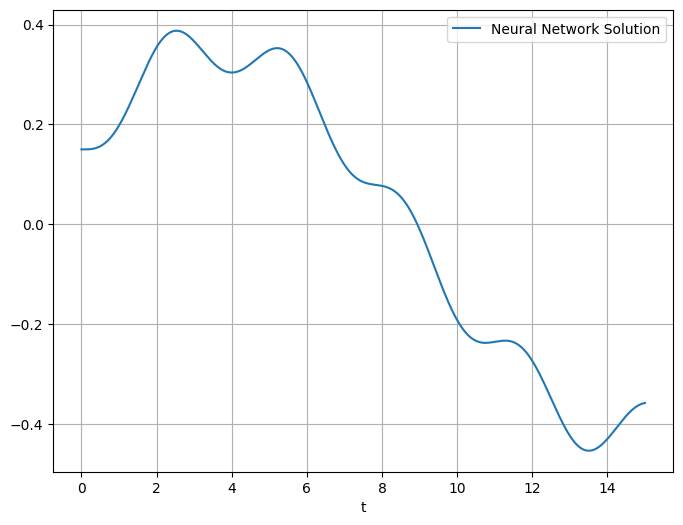

Epochs Progress:  40%|███▉      | 15999/40001 [03:29<04:36, 86.77it/s]

epoch: 16000, loss: 0.005098175257444382


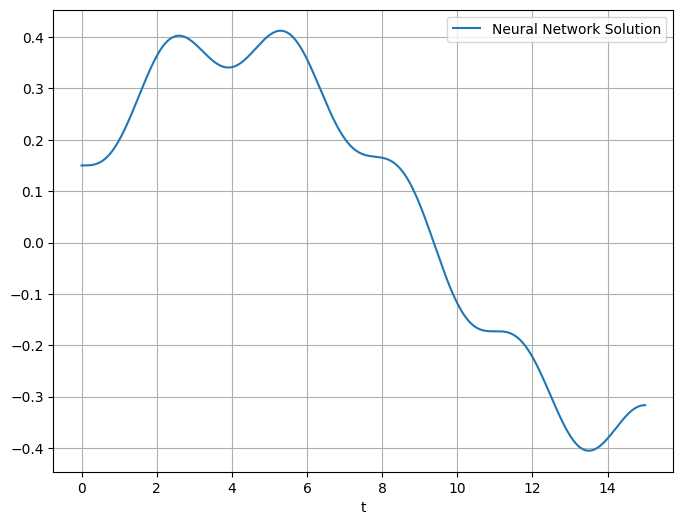

Epochs Progress:  41%|████      | 16494/40001 [03:35<04:41, 83.36it/s]

epoch: 16500, loss: 0.005862369667738676


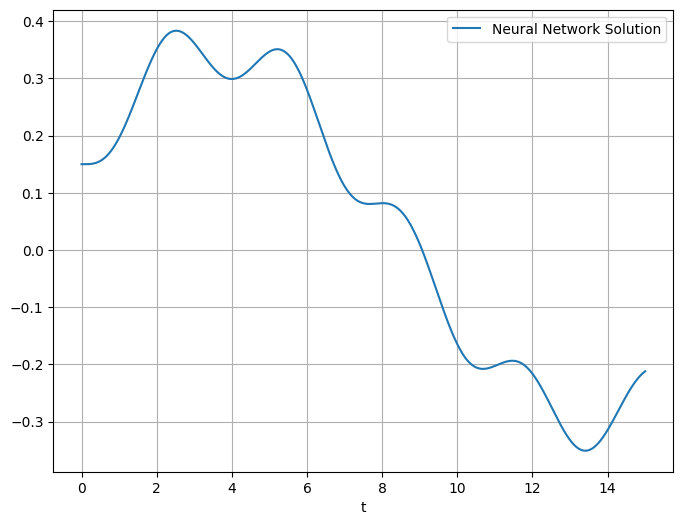

Epochs Progress:  42%|████▏     | 16996/40001 [03:43<04:28, 85.84it/s]

epoch: 17000, loss: 0.00426736194640398


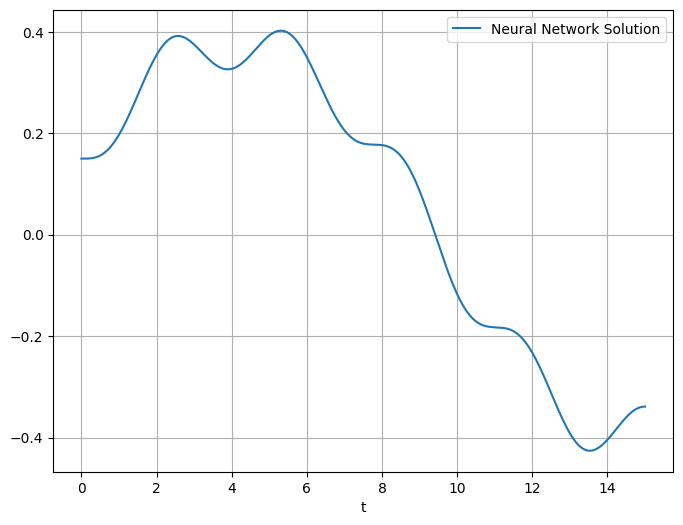

Epochs Progress:  44%|████▎     | 17496/40001 [03:49<04:20, 86.35it/s]

epoch: 17500, loss: 0.004044072702527046


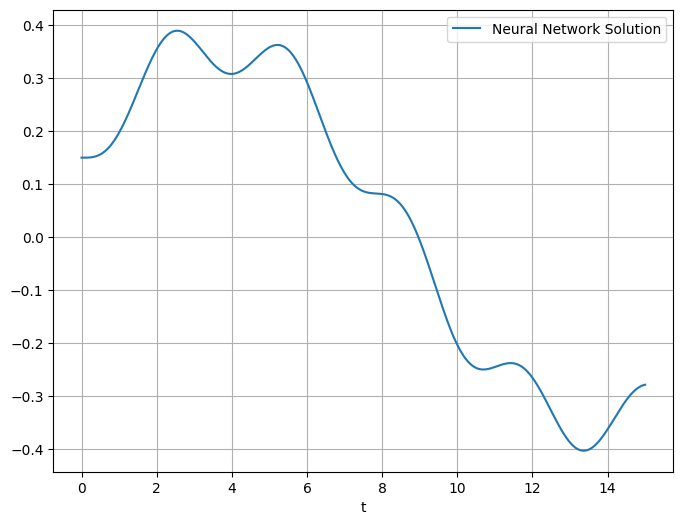

Epochs Progress:  45%|████▍     | 17999/40001 [03:57<06:39, 55.09it/s]

epoch: 18000, loss: 0.006650303956121206


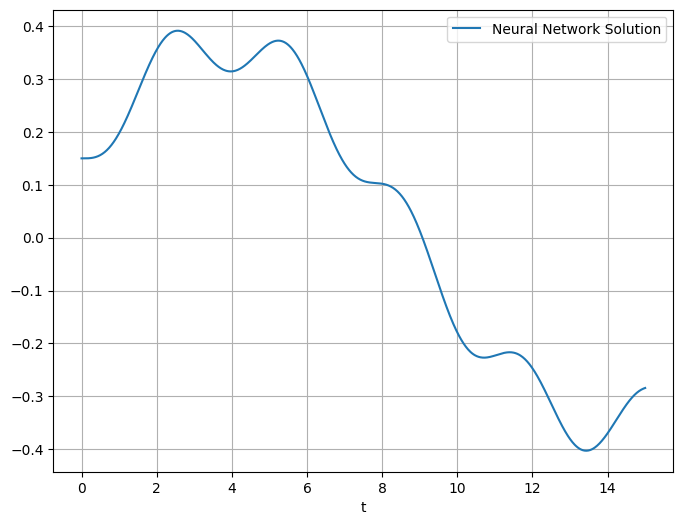

Epochs Progress:  46%|████▌     | 18493/40001 [04:03<04:04, 87.84it/s]

epoch: 18500, loss: 0.009207283146679401


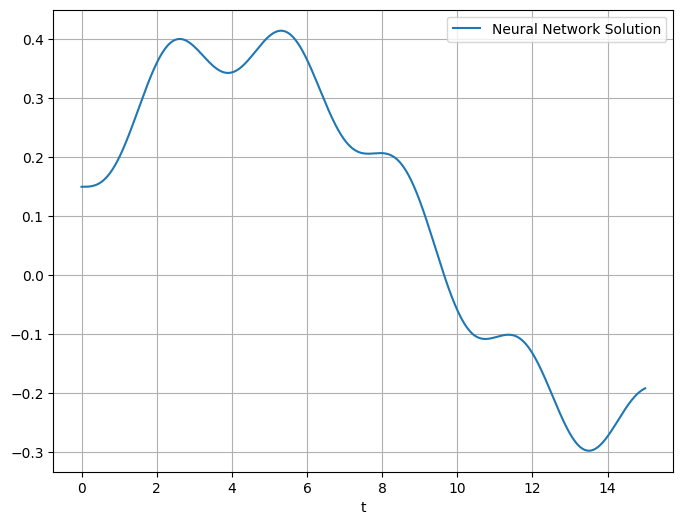

Epochs Progress:  47%|████▋     | 18994/40001 [04:10<05:35, 62.57it/s]

epoch: 19000, loss: 0.005703719798475504


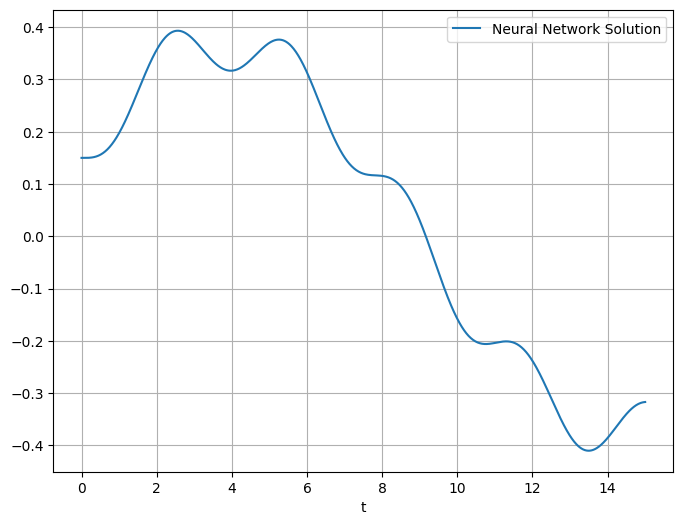

Epochs Progress:  49%|████▊     | 19493/40001 [04:16<04:04, 83.91it/s]

epoch: 19500, loss: 0.004442246630787849


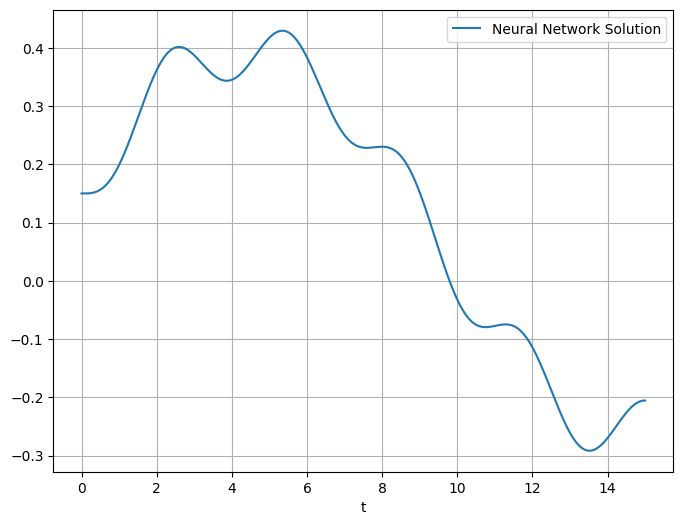

Epochs Progress:  50%|████▉     | 19999/40001 [04:23<05:25, 61.48it/s]

epoch: 20000, loss: 0.004265885334461927


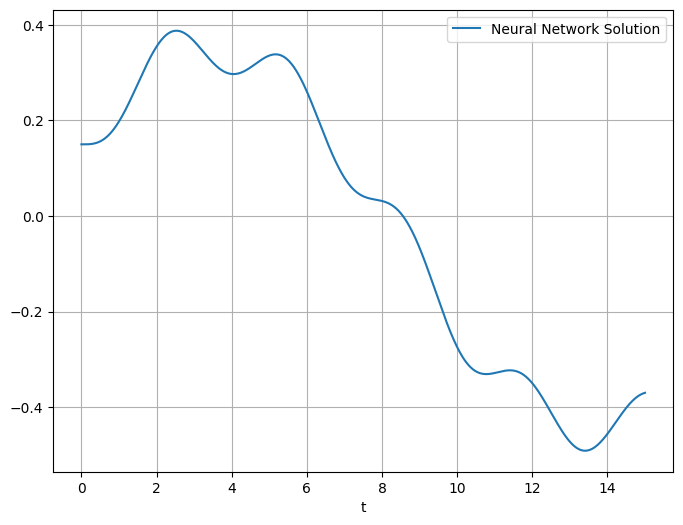

Epochs Progress:  51%|█████     | 20495/40001 [04:30<03:45, 86.65it/s]

epoch: 20500, loss: 0.006500504445284605


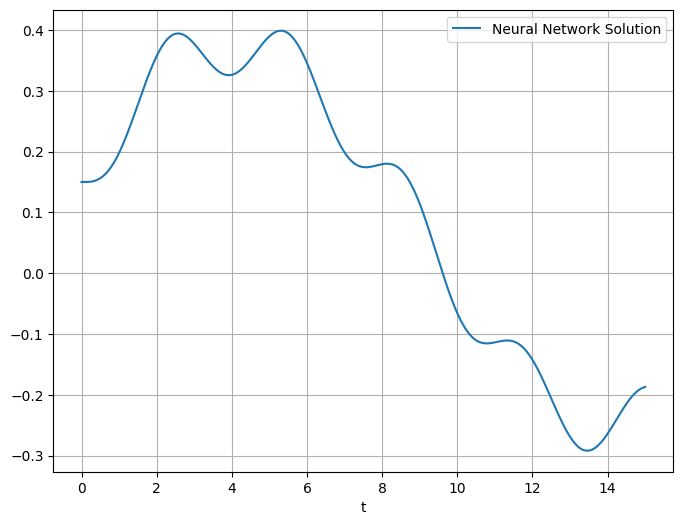

Epochs Progress:  52%|█████▏    | 20994/40001 [04:36<04:27, 71.14it/s]

epoch: 21000, loss: 0.0028572941664606333


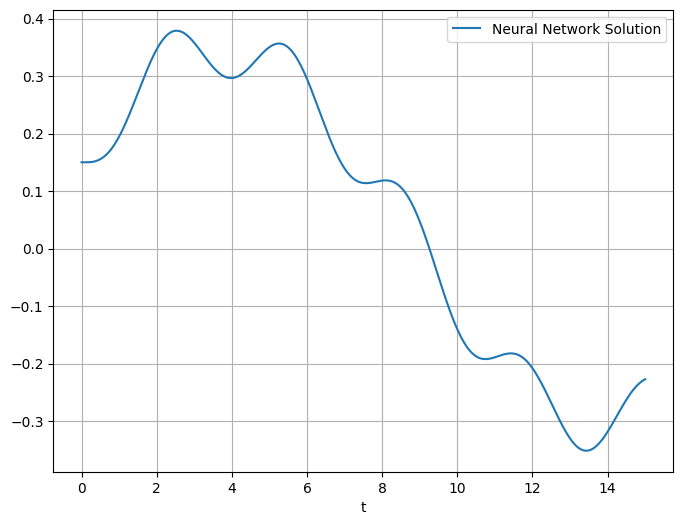

Epochs Progress:  54%|█████▎    | 21494/40001 [04:44<03:36, 85.63it/s]

epoch: 21500, loss: 0.03170393779873848


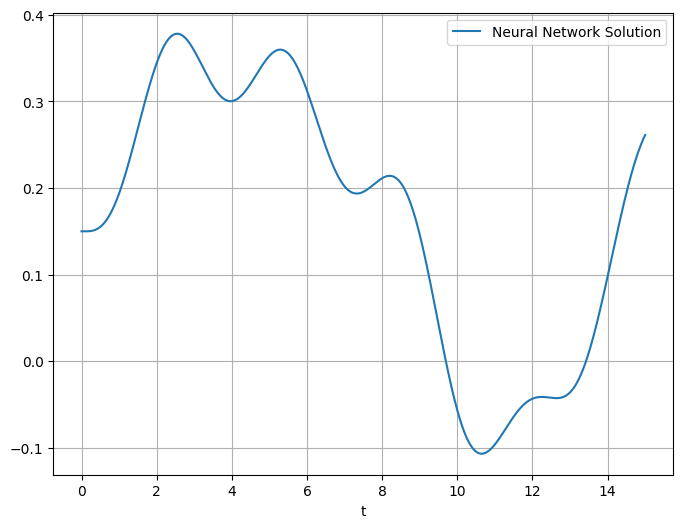

Epochs Progress:  55%|█████▍    | 22000/40001 [04:50<03:31, 85.11it/s]

epoch: 22000, loss: 0.003421254688873887


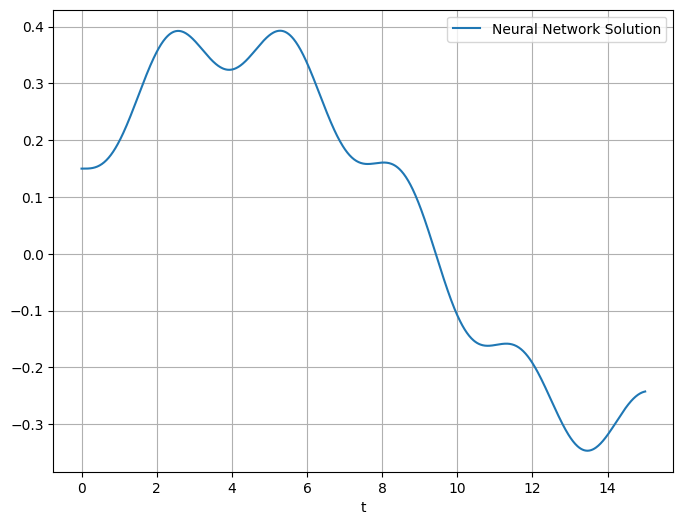

Epochs Progress:  56%|█████▌    | 22499/40001 [04:58<03:36, 80.90it/s]

epoch: 22500, loss: 0.004985983949154615


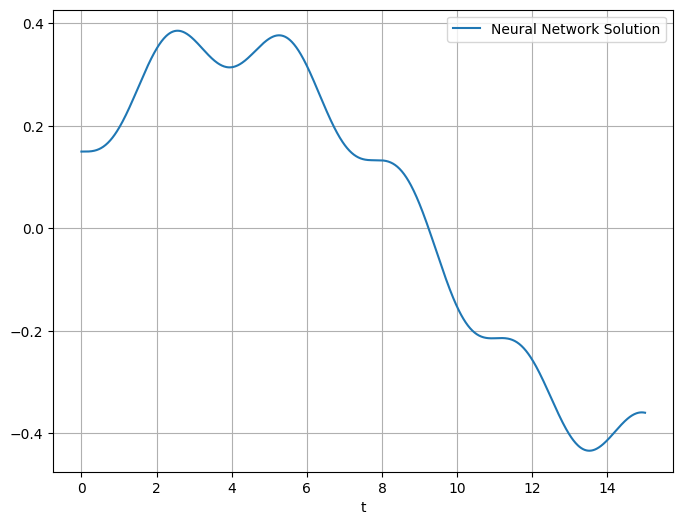

Epochs Progress:  57%|█████▋    | 22991/40001 [05:04<03:20, 84.88it/s]

epoch: 23000, loss: 0.006961994804441929


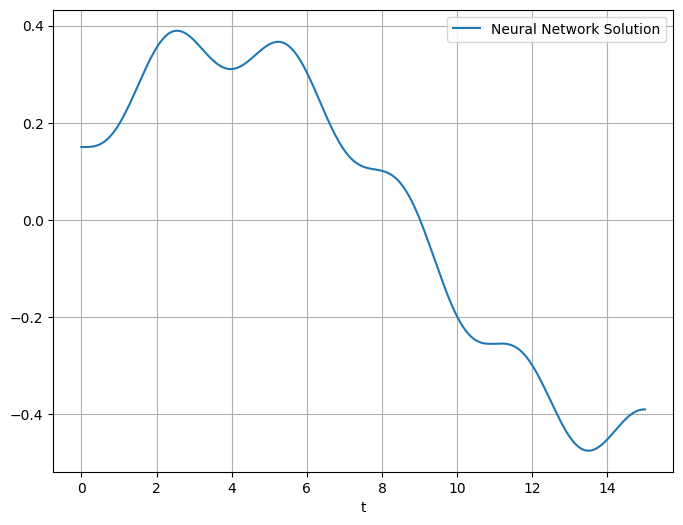

Epochs Progress:  59%|█████▊    | 23497/40001 [05:11<03:16, 83.80it/s]

epoch: 23500, loss: 0.005382267292588949


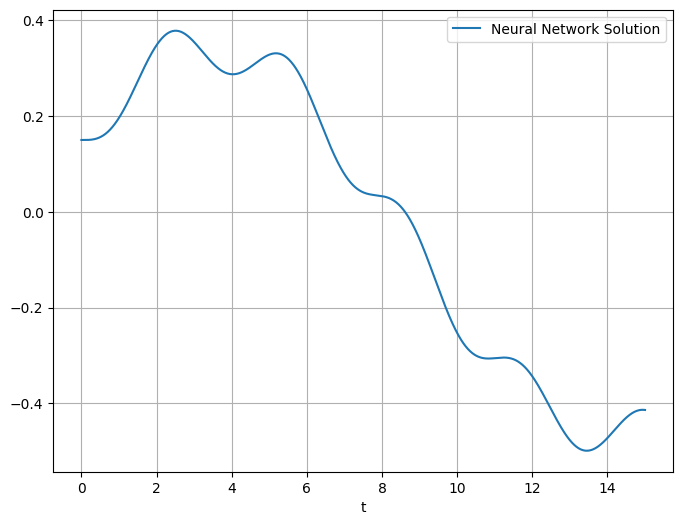

Epochs Progress:  60%|█████▉    | 23992/40001 [05:18<03:16, 81.53it/s]

epoch: 24000, loss: 0.006520730908960104


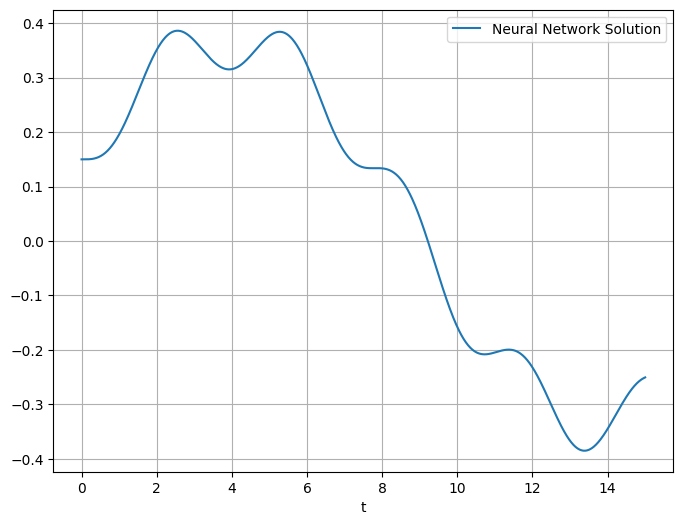

Epochs Progress:  61%|██████    | 24495/40001 [05:25<04:38, 55.60it/s]

epoch: 24500, loss: 0.005786859896034002


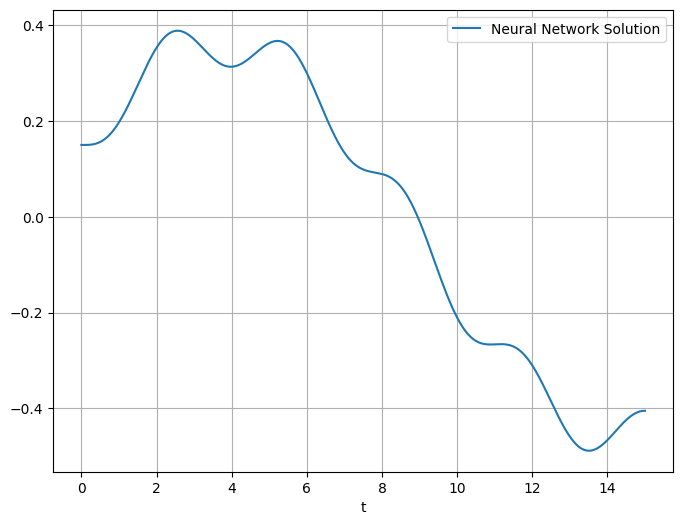

Epochs Progress:  62%|██████▏   | 24998/40001 [05:32<03:10, 78.92it/s]

epoch: 25000, loss: 0.004917205777019262


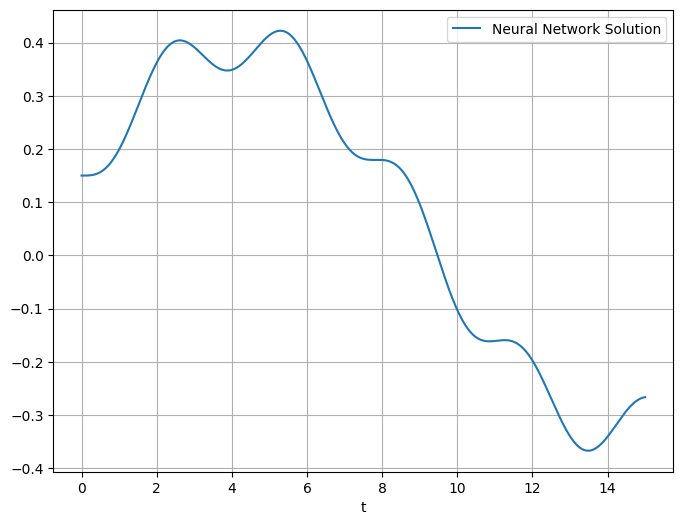

Epochs Progress:  64%|██████▎   | 25498/40001 [05:39<04:07, 58.61it/s]

epoch: 25500, loss: 0.07009918242692947


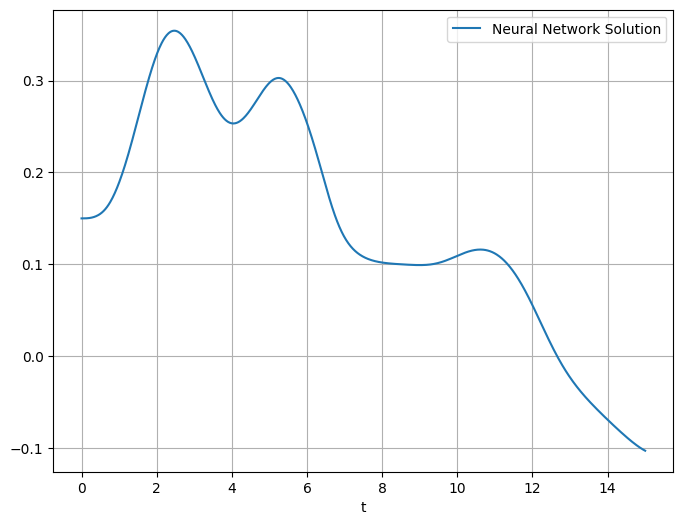

Epochs Progress:  65%|██████▍   | 25995/40001 [05:46<02:40, 87.34it/s]

epoch: 26000, loss: 0.02173144370317459


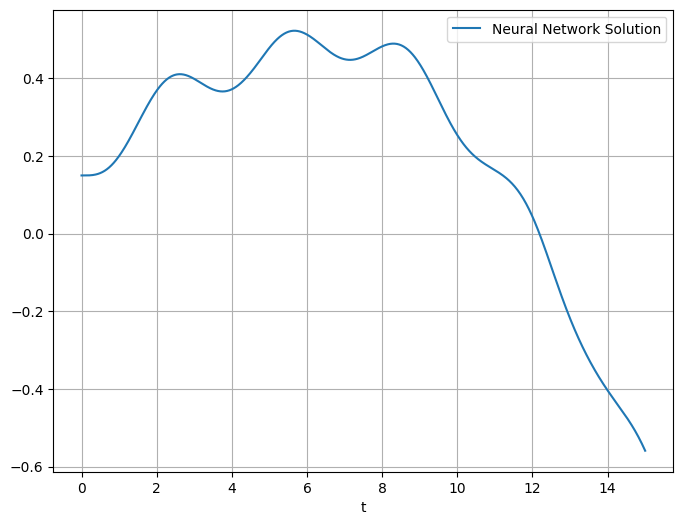

Epochs Progress:  66%|██████▌   | 26495/40001 [05:52<03:36, 62.45it/s]

epoch: 26500, loss: 0.011455637402832508


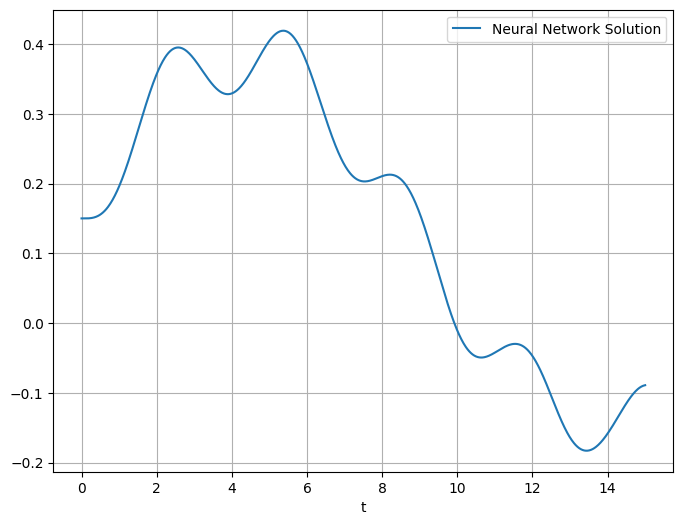

Epochs Progress:  67%|██████▋   | 26999/40001 [05:59<02:35, 83.65it/s]

epoch: 27000, loss: 0.027310214936733246


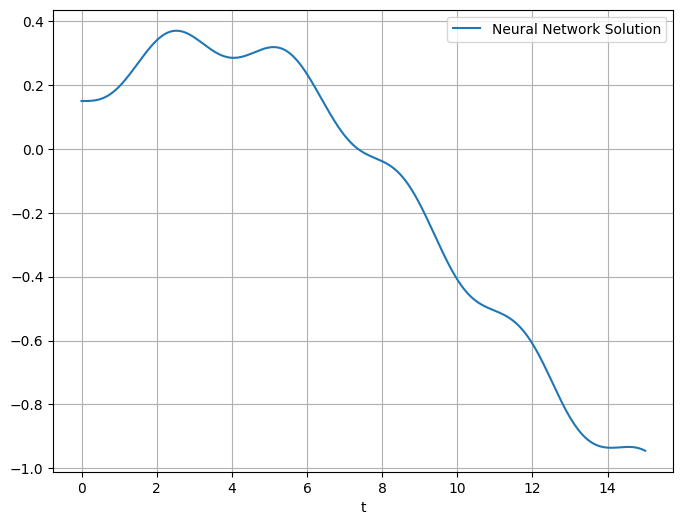

Epochs Progress:  69%|██████▊   | 27492/40001 [06:06<02:22, 87.78it/s]

epoch: 27500, loss: 0.011960944160819054


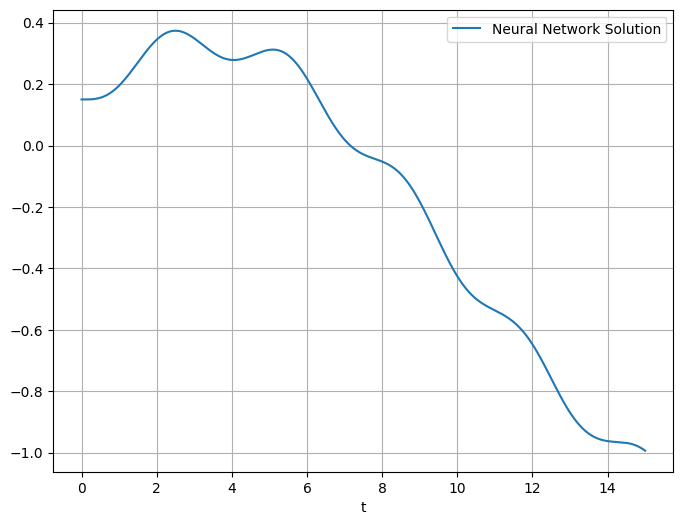

Epochs Progress:  70%|██████▉   | 27993/40001 [06:13<02:33, 78.09it/s]

epoch: 28000, loss: 0.015799015760421753


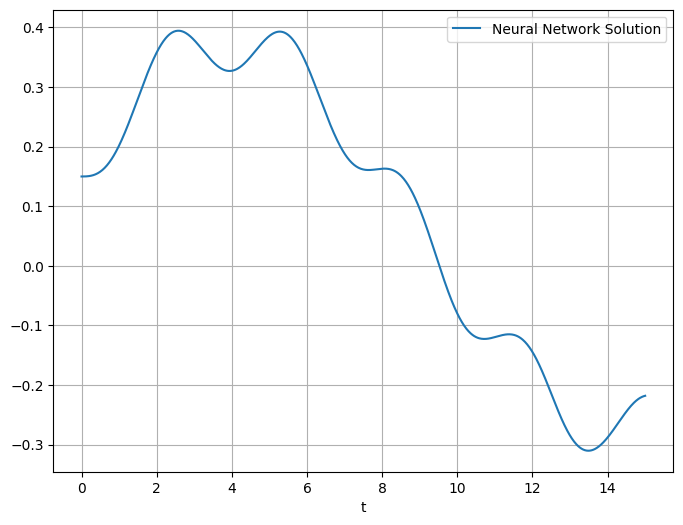

Epochs Progress:  71%|███████   | 28497/40001 [06:19<02:09, 88.87it/s]

epoch: 28500, loss: 0.007256018929183483


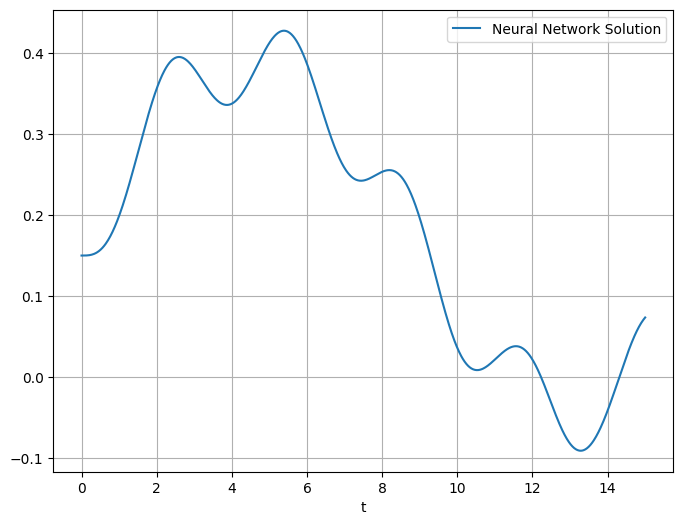

Epochs Progress:  72%|███████▏  | 29000/40001 [06:27<02:17, 80.20it/s]

epoch: 29000, loss: 0.006704794708639383


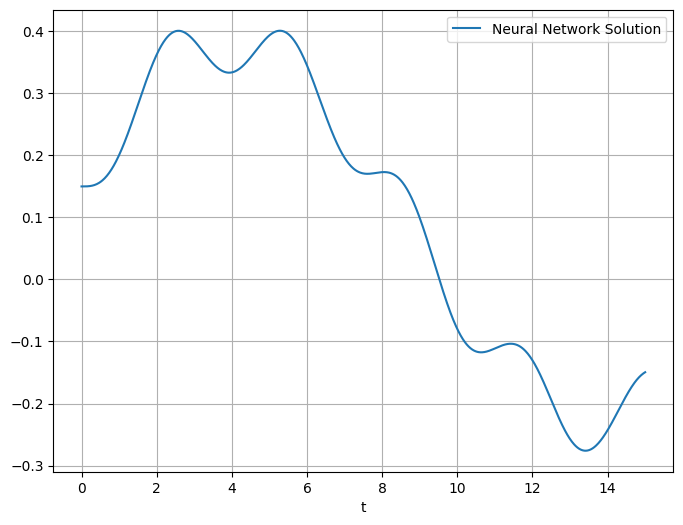

Epochs Progress:  74%|███████▎  | 29492/40001 [06:33<02:11, 80.04it/s]

epoch: 29500, loss: 0.016165927052497864


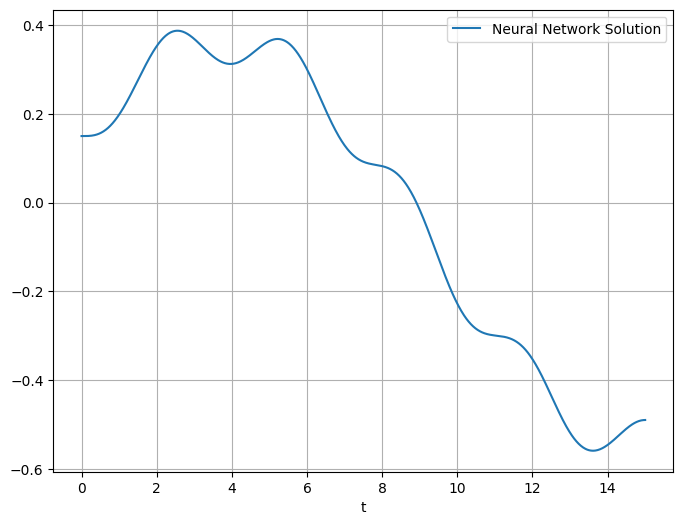

Epochs Progress:  75%|███████▍  | 29994/40001 [06:41<02:05, 79.68it/s]

epoch: 30000, loss: 0.006806930992752314


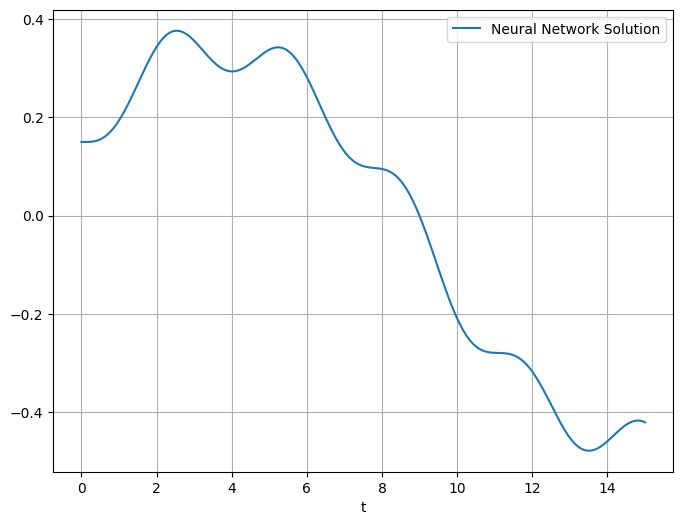

Epochs Progress:  76%|███████▌  | 30499/40001 [06:47<01:54, 83.20it/s]

epoch: 30500, loss: 0.008446481078863144


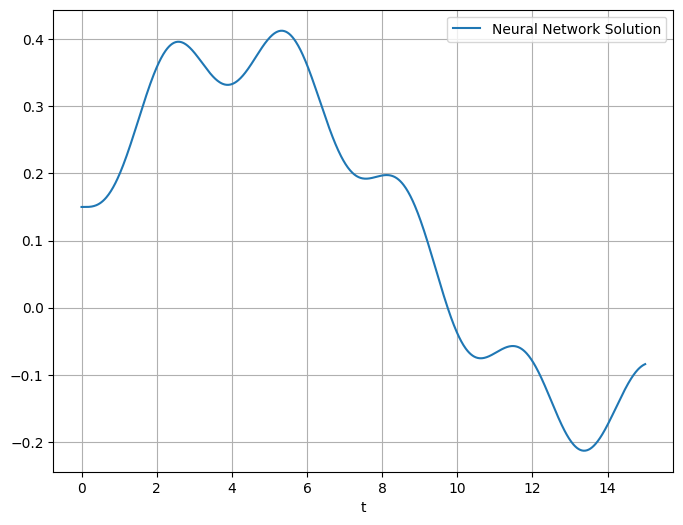

Epochs Progress:  77%|███████▋  | 30998/40001 [06:54<02:33, 58.71it/s]

epoch: 31000, loss: 0.020910056307911873


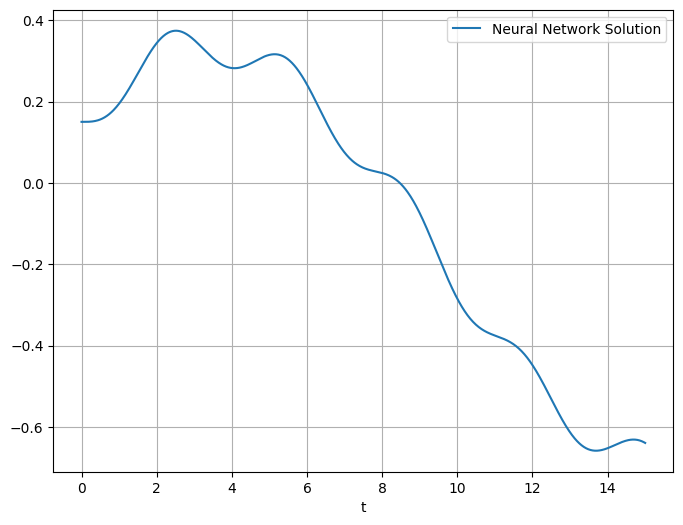

Epochs Progress:  79%|███████▊  | 31497/40001 [07:00<01:39, 85.18it/s]

epoch: 31500, loss: 0.011165004223585129


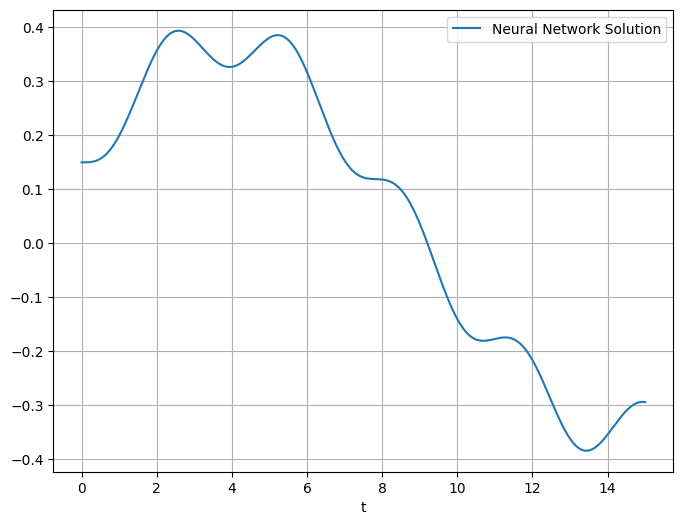

Epochs Progress:  80%|███████▉  | 31994/40001 [07:07<02:04, 64.48it/s]

epoch: 32000, loss: 0.006805721204727888


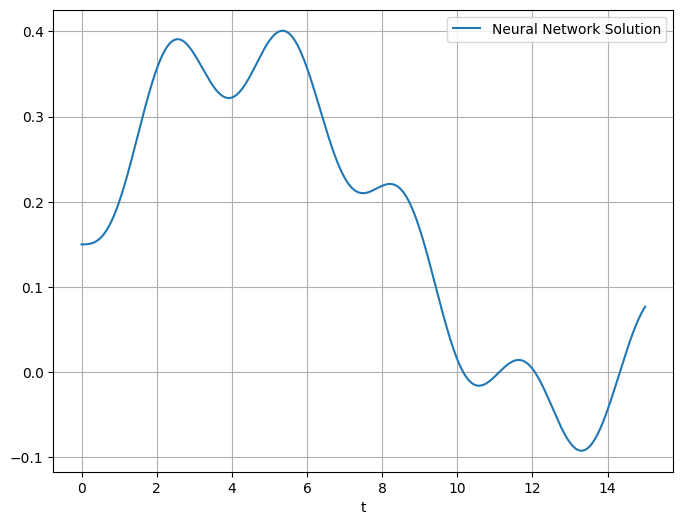

Epochs Progress:  81%|████████  | 32497/40001 [07:14<01:30, 82.60it/s]

epoch: 32500, loss: 0.010063056834042072


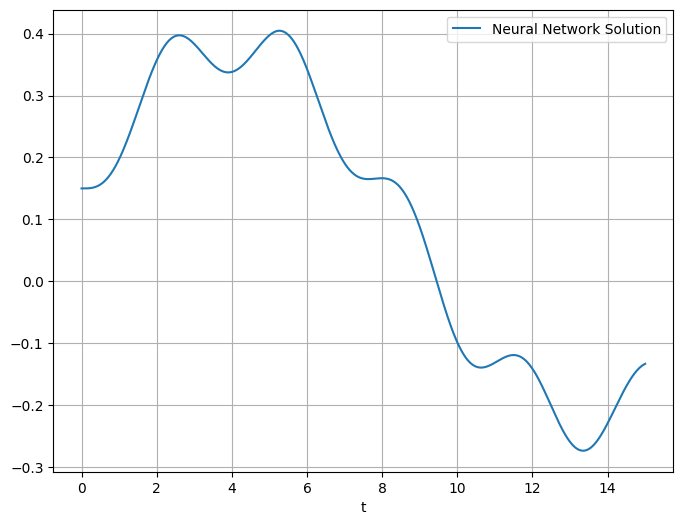

Epochs Progress:  82%|████████▏ | 32996/40001 [07:20<01:53, 61.47it/s]

epoch: 33000, loss: 0.017039693892002106


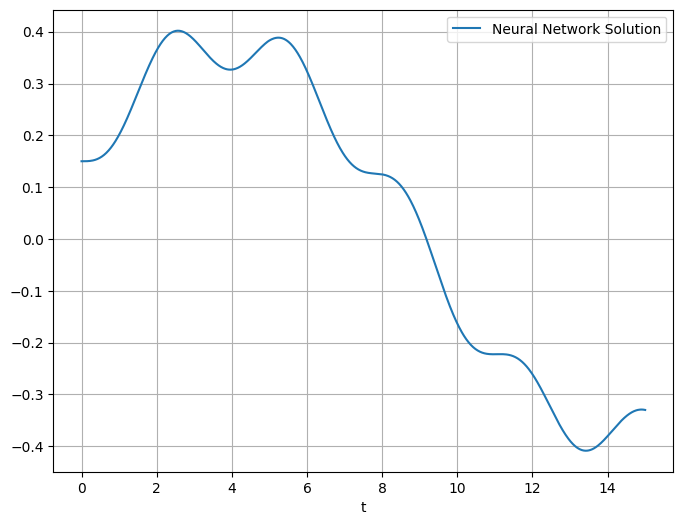

Epochs Progress:  84%|████████▎ | 33496/40001 [07:28<01:16, 85.37it/s]

epoch: 33500, loss: 0.005209736991673708


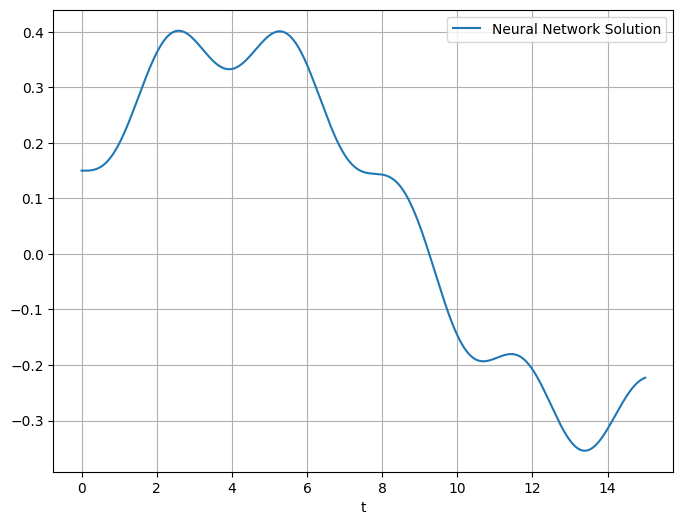

Epochs Progress:  85%|████████▍ | 33994/40001 [07:34<01:10, 84.70it/s]

epoch: 34000, loss: 0.016388151794672012


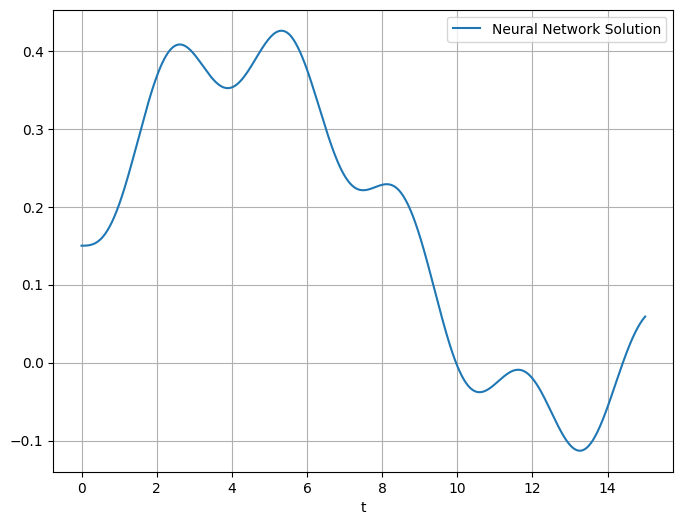

Epochs Progress:  86%|████████▌ | 34496/40001 [07:41<01:07, 80.96it/s]

epoch: 34500, loss: 0.008122572675347328


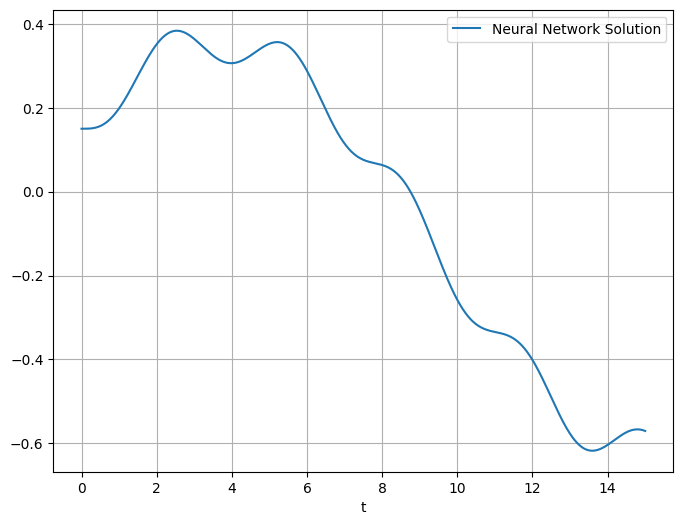

Epochs Progress:  87%|████████▋ | 34994/40001 [07:47<00:58, 86.11it/s]

epoch: 35000, loss: 0.008050668053328991


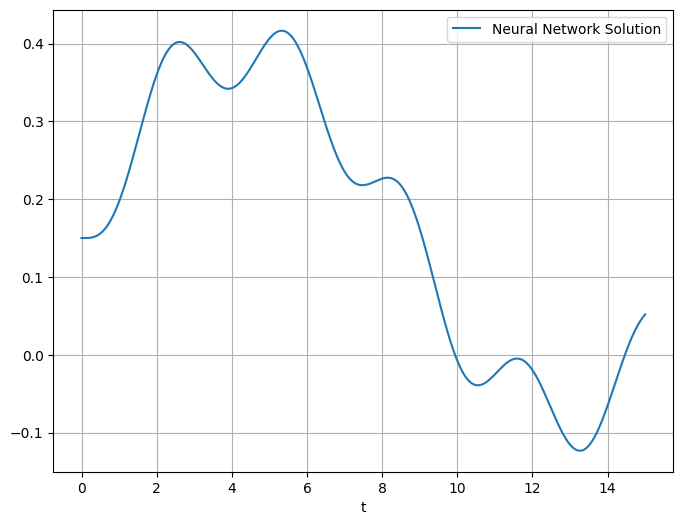

Epochs Progress:  89%|████████▊ | 35498/40001 [07:55<01:00, 74.12it/s]

epoch: 35500, loss: 0.011953059583902359


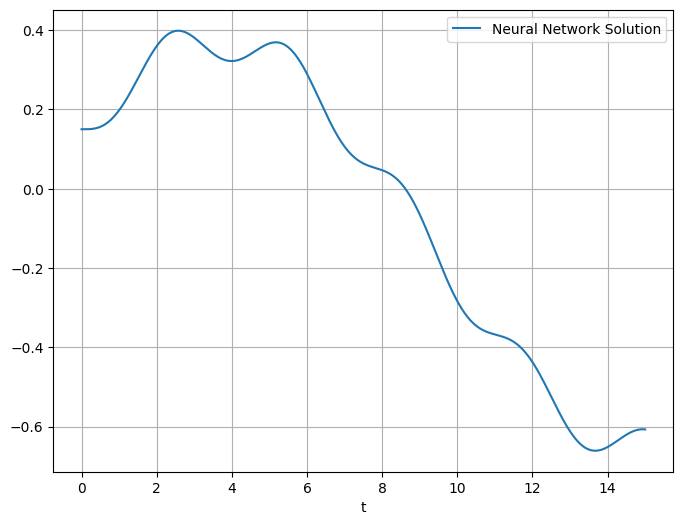

Epochs Progress:  90%|████████▉ | 35998/40001 [08:01<00:51, 78.08it/s]

epoch: 36000, loss: 0.0045481594279408455


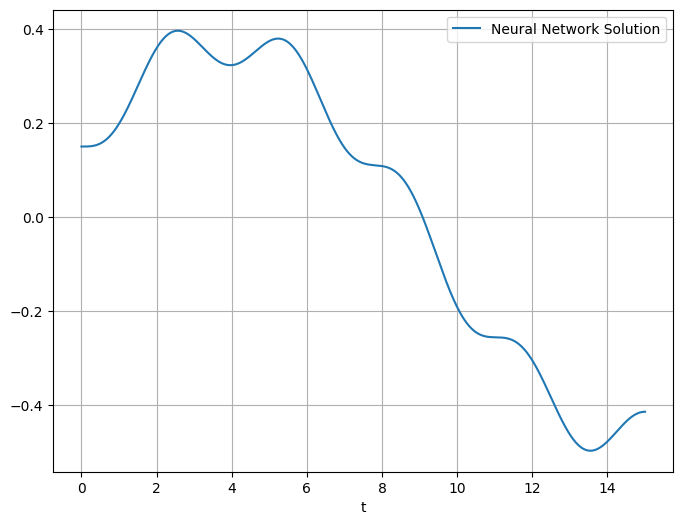

Epochs Progress:  91%|█████████ | 36494/40001 [08:08<00:52, 66.49it/s]

epoch: 36500, loss: 0.02297917753458023


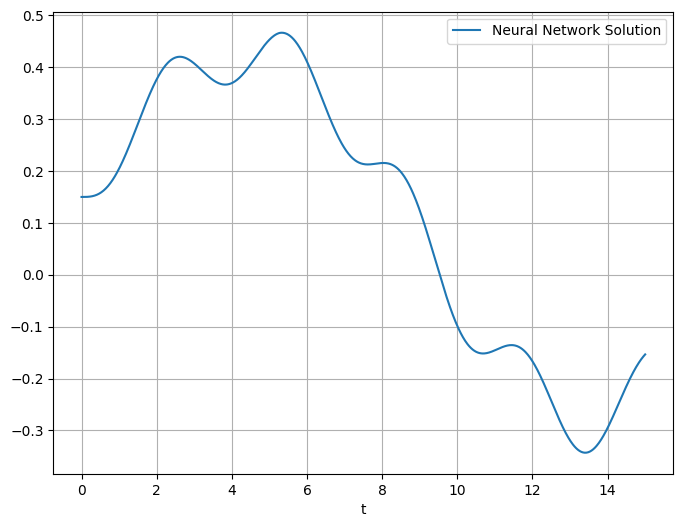

Epochs Progress:  92%|█████████▏| 36998/40001 [08:15<00:35, 83.96it/s]

epoch: 37000, loss: 0.008882926777005196


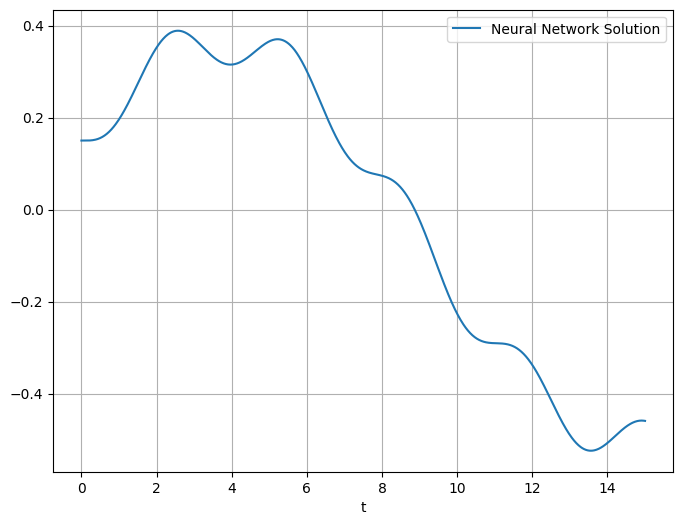

Epochs Progress:  94%|█████████▎| 37497/40001 [08:22<00:41, 60.81it/s]

epoch: 37500, loss: 0.00881202518939972


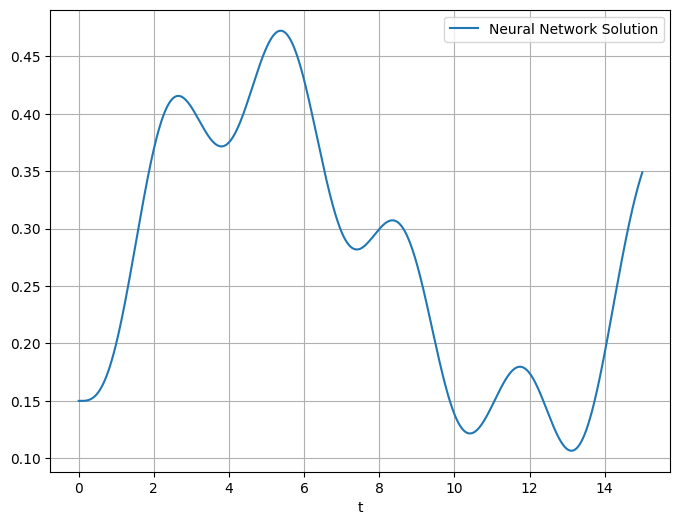

Epochs Progress:  95%|█████████▍| 37996/40001 [08:29<00:25, 80.09it/s]

epoch: 38000, loss: 0.044060222804546356


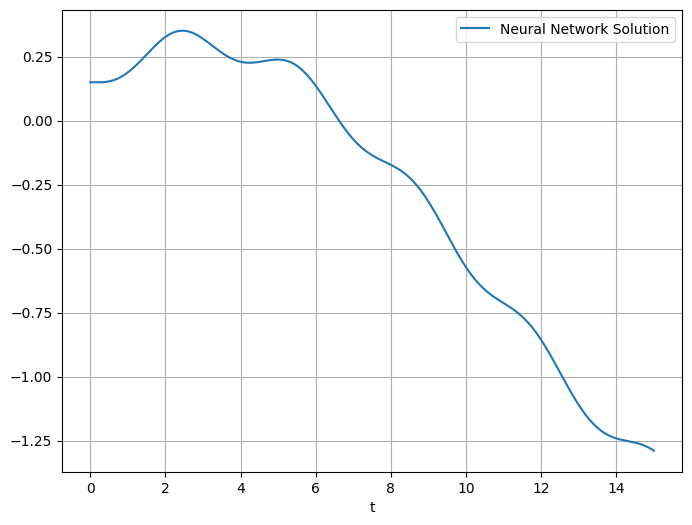

Epochs Progress:  96%|█████████▌| 38495/40001 [08:35<00:24, 61.46it/s]

epoch: 38500, loss: 0.03207701817154884


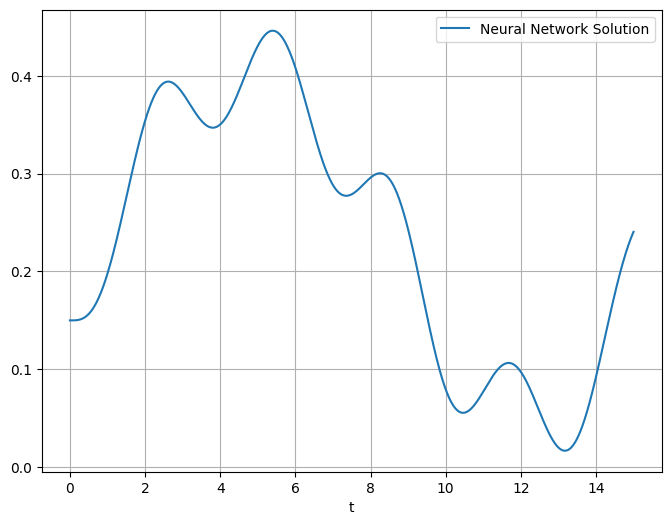

Epochs Progress:  97%|█████████▋| 38992/40001 [08:42<00:12, 81.34it/s]

epoch: 39000, loss: 0.0046466076746582985


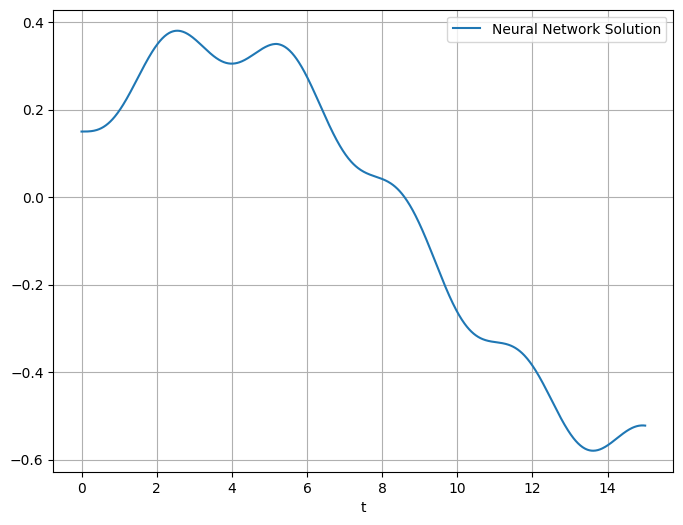

Epochs Progress:  99%|█████████▊| 39497/40001 [08:49<00:06, 81.07it/s]

epoch: 39500, loss: 0.006188601721078157


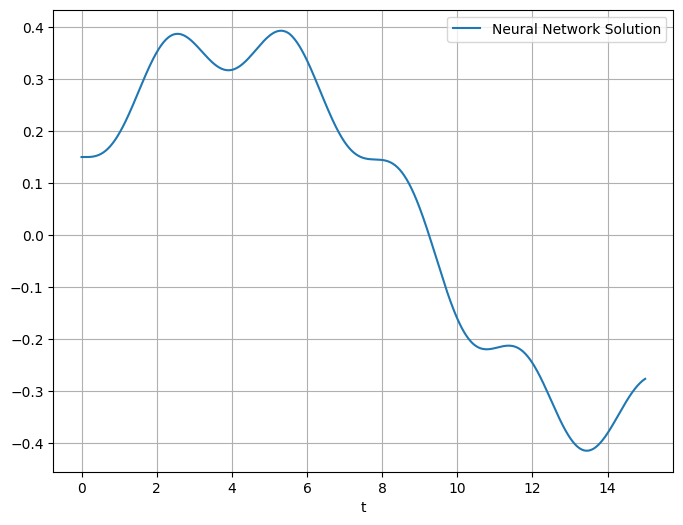

Epochs Progress: 100%|█████████▉| 39994/40001 [08:56<00:00, 87.49it/s]

epoch: 40000, loss: 0.01984669826924801


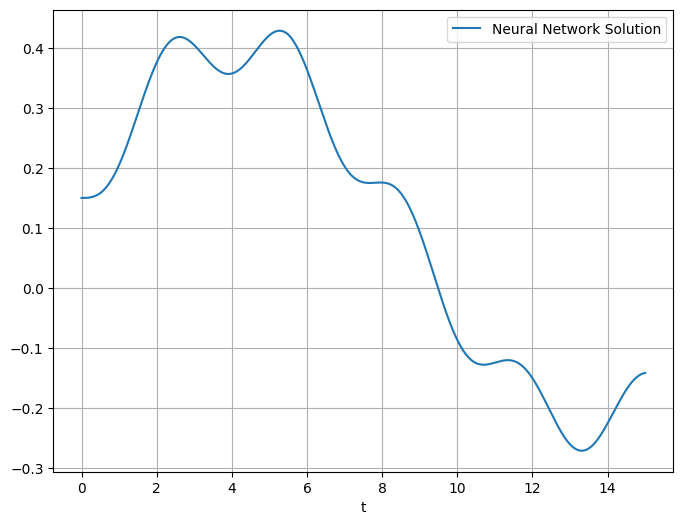

Epochs Progress: 100%|██████████| 40001/40001 [08:57<00:00, 74.48it/s]


In [ ]:
train(optimizer_expert_2, model_expert_2, first_order_loss, trial_solution, 40001, 500, 0, 15, 500, 15, 1000)

## Num Of Expert = 4

In [ ]:
model_expert_4 = MixtureOfExperts(N_EXPERT = 4)
optimizer_expert_4 = optim.Adam(model_expert_4.parameters(), lr = lr  )

In [ ]:
train(optimizer_expert_4, model_expert_4, first_order_loss, trial_solution, 30001, 500, 0, 15, 400, 15, 1000)

## Softmax Activation Function

In [ ]:
model_expert_1 = MixtureOfExperts(N_EXPERT = 1)
lr = 0.005
optimizer_expert_1 = optim.Adam(model_expert_1.parameters(), lr = lr  )
scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer_expert_1, T_max=40000)

Epochs Progress:   0%|          | 0/40001 [00:00<?, ?it/s]

tensor([400.])
epoch: 0, loss: 0.33871448040008545


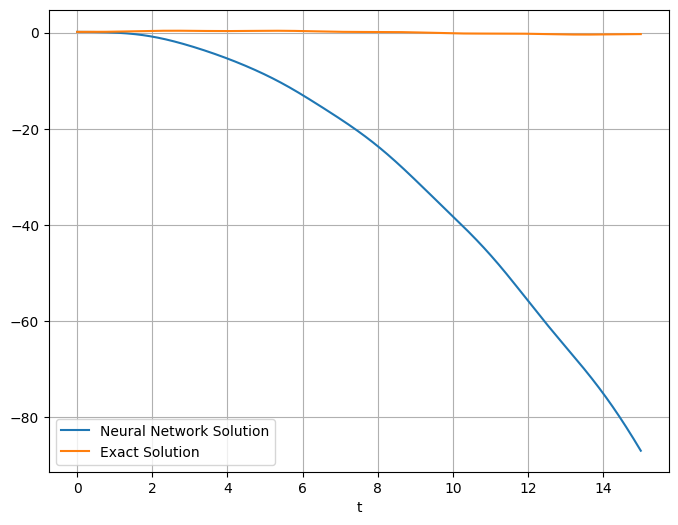

Epochs Progress:   1%|          | 489/40001 [00:07<08:00, 82.28it/s]

tensor([400.])
epoch: 500, loss: 0.047438401728868484


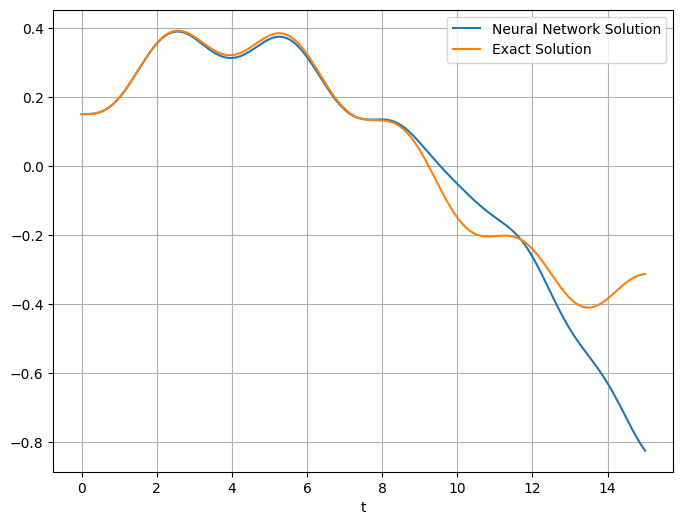

Epochs Progress:   2%|▏         | 989/40001 [00:12<05:40, 114.55it/s]

tensor([400.])
epoch: 1000, loss: 0.030540406703948975


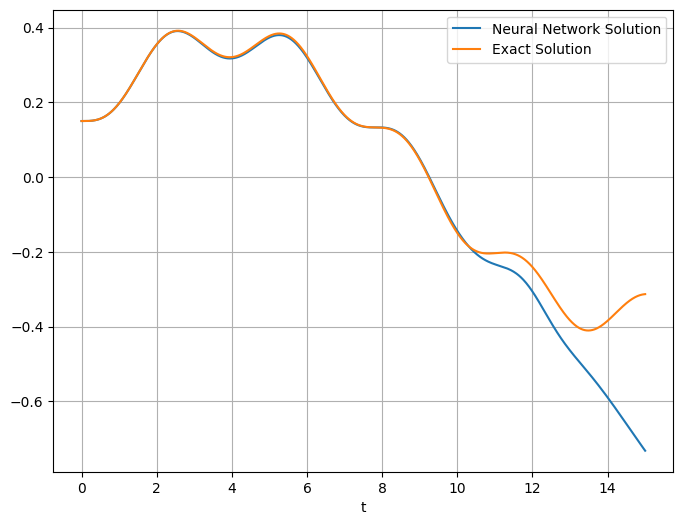

Epochs Progress:   4%|▎         | 1494/40001 [00:17<07:59, 80.28it/s]

tensor([400.])
epoch: 1500, loss: 0.023530183359980583


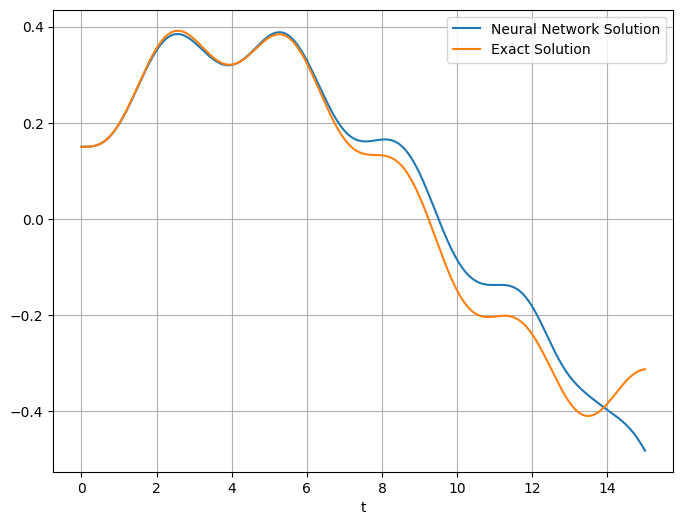

Epochs Progress:   5%|▍         | 2000/40001 [00:23<06:07, 103.38it/s]

tensor([400.])
epoch: 2000, loss: 0.030136937275528908


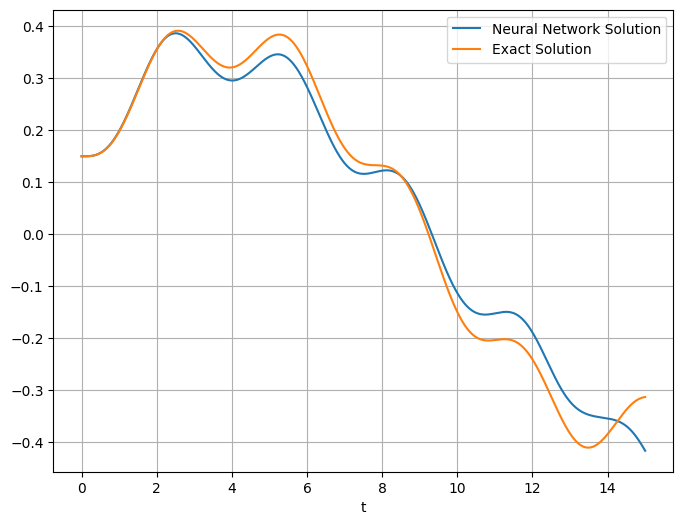

Epochs Progress:   6%|▌         | 2495/40001 [00:28<04:59, 125.33it/s]

tensor([400.])
epoch: 2500, loss: 0.03760853409767151


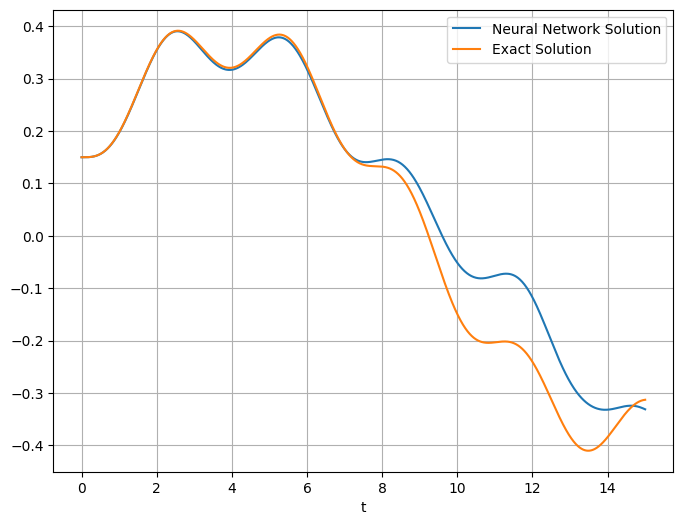

Epochs Progress:   7%|▋         | 2999/40001 [00:33<06:51, 89.89it/s]

tensor([400.])
epoch: 3000, loss: 0.03190581873059273


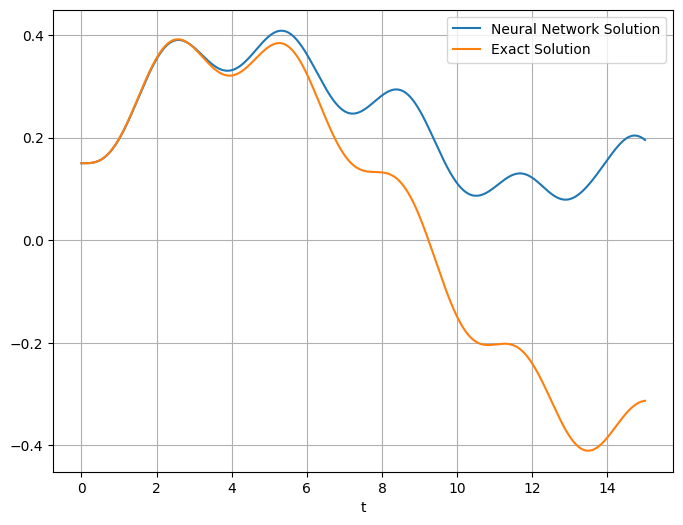

Epochs Progress:   9%|▊         | 3490/40001 [00:38<04:49, 126.03it/s]

tensor([400.])
epoch: 3500, loss: 0.021075503900647163


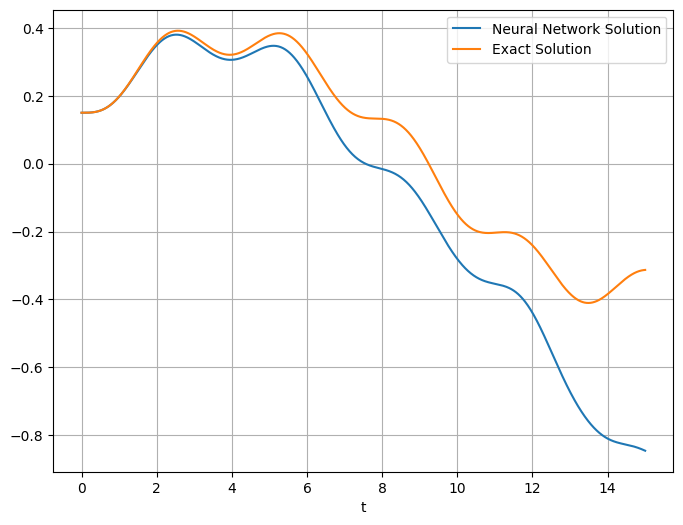

Epochs Progress:  10%|▉         | 3991/40001 [00:42<04:44, 126.51it/s]

tensor([400.])
epoch: 4000, loss: 0.012428028509020805


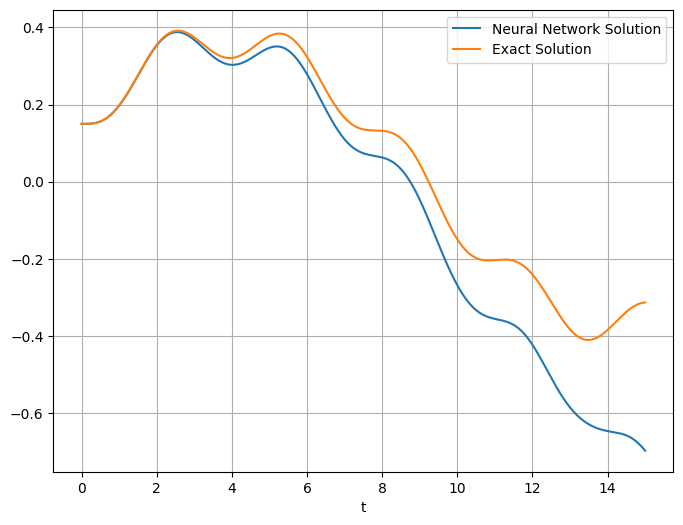

Epochs Progress:  11%|█         | 4493/40001 [00:47<07:07, 83.03it/s]

tensor([400.])
epoch: 4500, loss: 0.03110111504793167


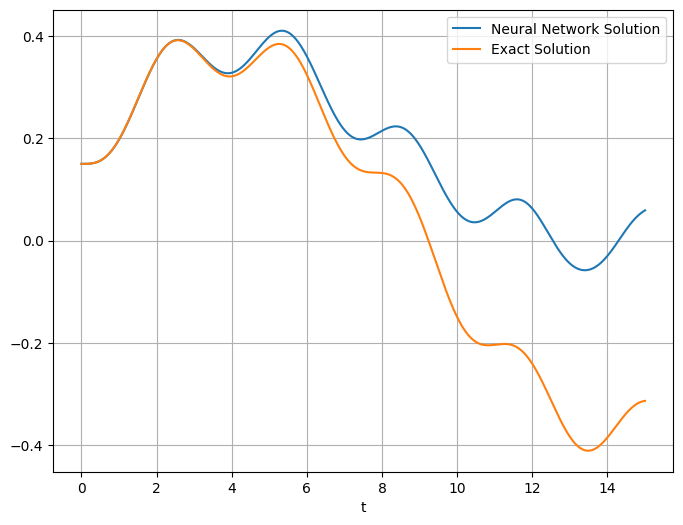

Epochs Progress:  12%|█▏        | 4991/40001 [00:52<04:47, 121.60it/s]

tensor([400.])
epoch: 5000, loss: 0.021266330033540726


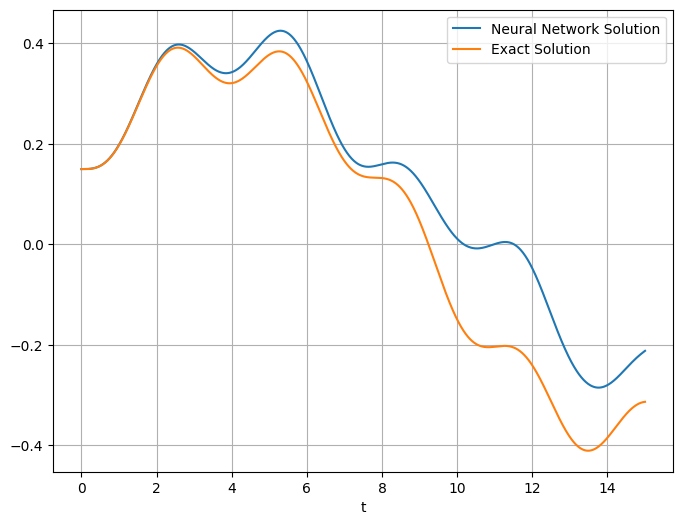

Epochs Progress:  14%|█▎        | 5489/40001 [00:56<04:50, 118.69it/s]

tensor([400.])
epoch: 5500, loss: 0.014569686725735664


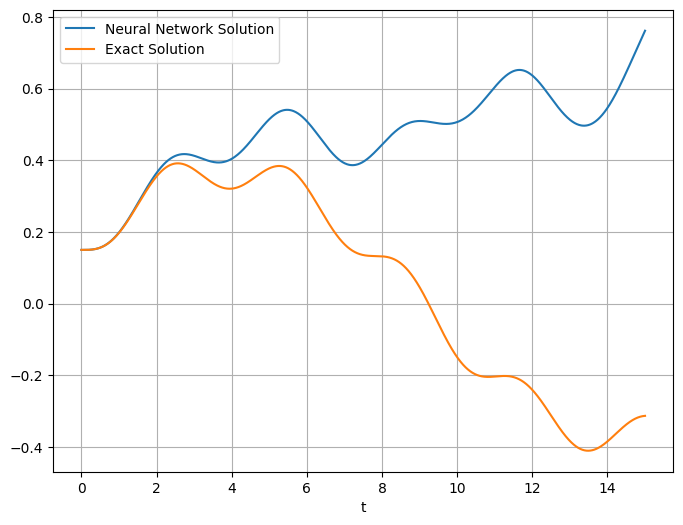

Epochs Progress:  15%|█▍        | 5998/40001 [01:01<06:30, 87.11it/s]

tensor([400.])
epoch: 6000, loss: 0.015021825209259987


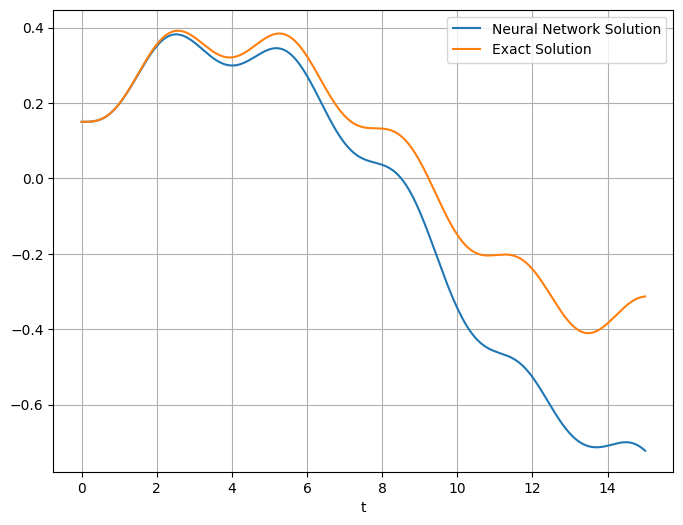

Epochs Progress:  16%|█▌        | 6488/40001 [01:06<04:42, 118.64it/s]

tensor([400.])
epoch: 6500, loss: 0.02623557485640049


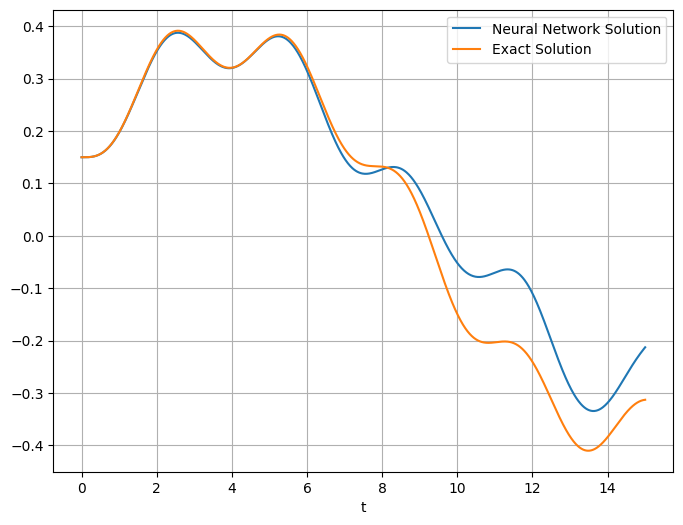

Epochs Progress:  17%|█▋        | 6993/40001 [01:11<04:32, 121.33it/s]

tensor([400.])
epoch: 7000, loss: 0.024917850270867348


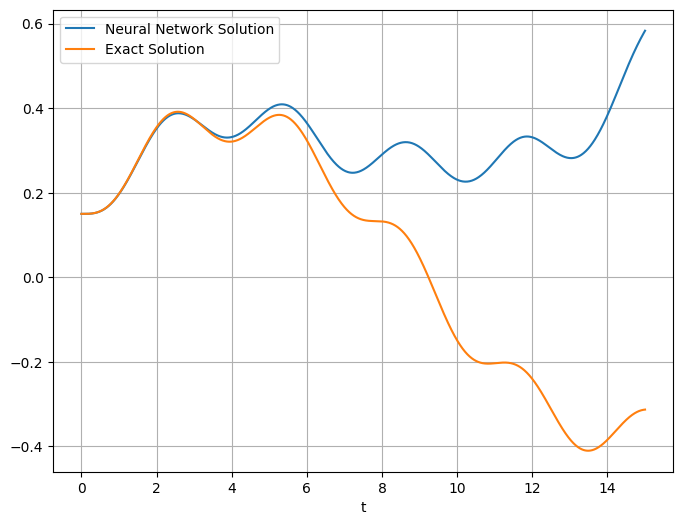

Epochs Progress:  19%|█▊        | 7496/40001 [01:16<06:13, 87.10it/s]

tensor([400.])
epoch: 7500, loss: 0.019931470975279808


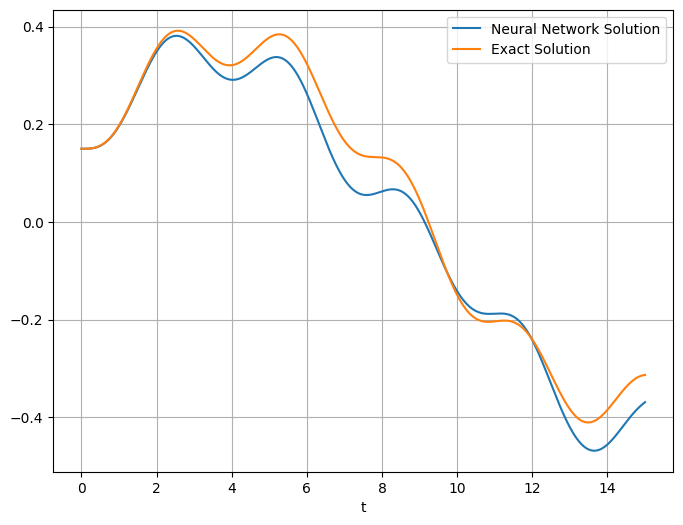

Epochs Progress:  20%|█▉        | 7992/40001 [01:21<04:27, 119.71it/s]

tensor([400.])
epoch: 8000, loss: 0.02427412010729313


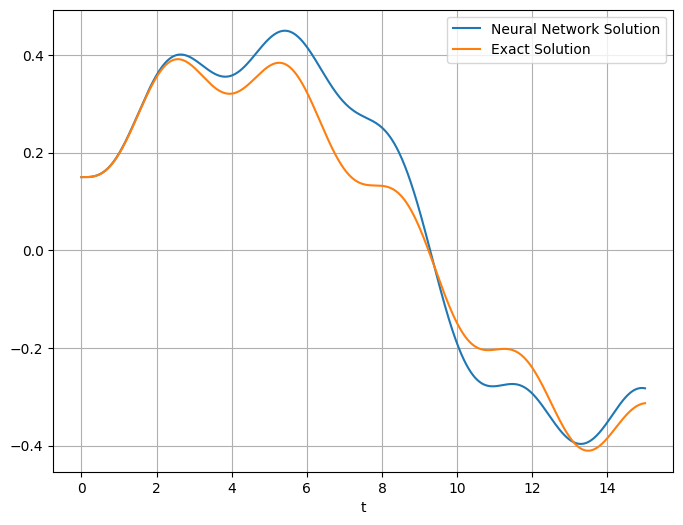

Epochs Progress:  21%|██        | 8499/40001 [01:26<04:22, 120.12it/s]

tensor([400.])
epoch: 8500, loss: 0.01069934107363224


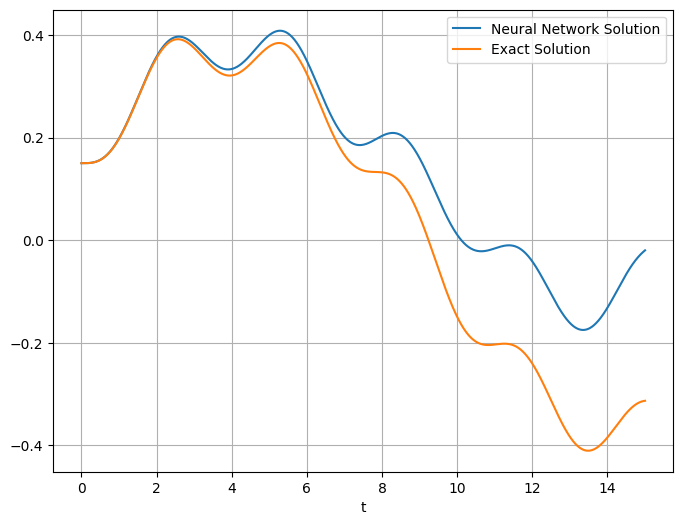

Epochs Progress:  22%|██▏       | 8995/40001 [01:31<06:06, 84.51it/s]

tensor([400.])
epoch: 9000, loss: 0.009251382201910019


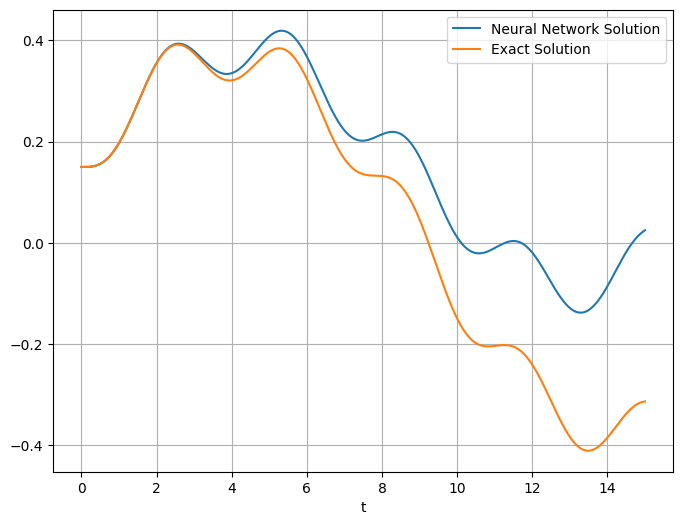

Epochs Progress:  24%|██▎       | 9495/40001 [01:36<04:17, 118.47it/s]

tensor([400.])
epoch: 9500, loss: 0.021435635164380074


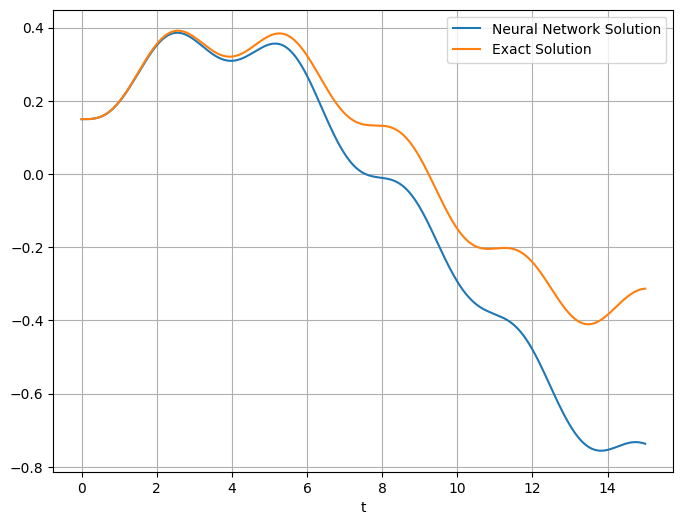

Epochs Progress:  25%|██▍       | 9998/40001 [01:41<04:16, 117.09it/s]

tensor([400.])
epoch: 10000, loss: 0.01435118168592453


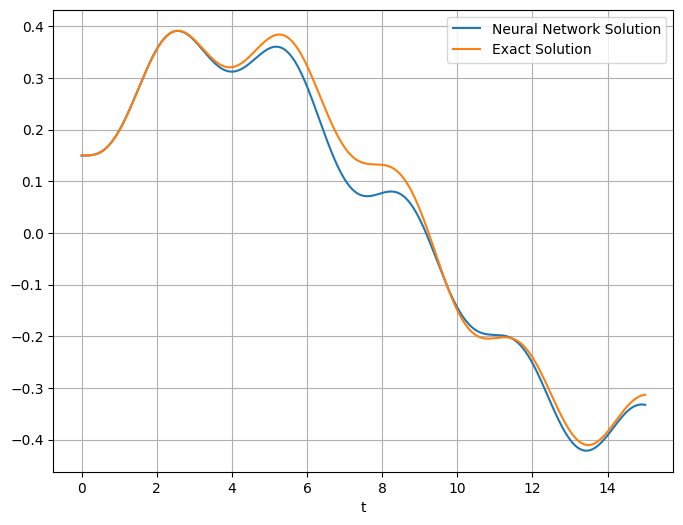

Epochs Progress:  26%|██▌       | 10497/40001 [01:47<06:22, 77.19it/s]

tensor([400.])
epoch: 10500, loss: 0.012216729111969471


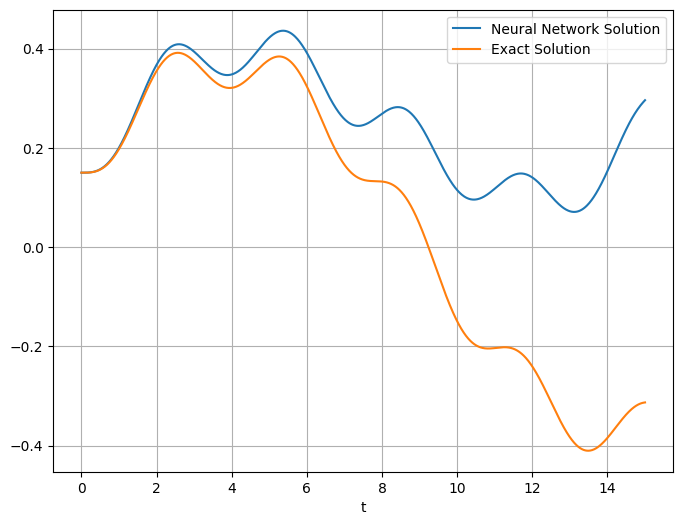

Epochs Progress:  27%|██▋       | 10989/40001 [01:51<04:08, 116.64it/s]

tensor([400.])
epoch: 11000, loss: 0.007621203549206257


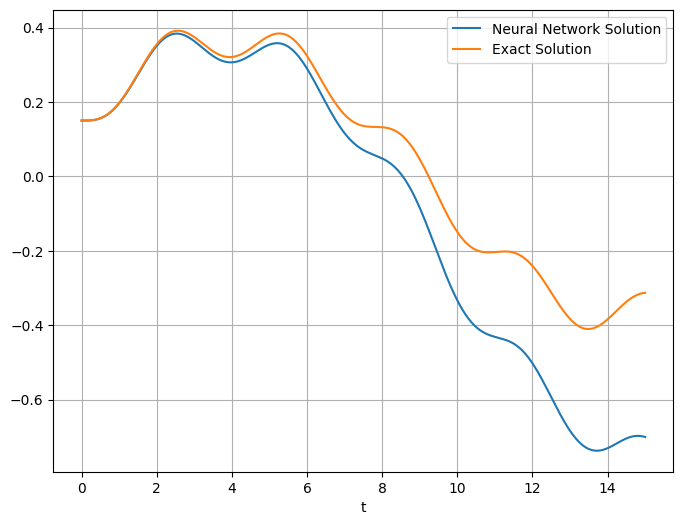

Epochs Progress:  29%|██▊       | 11489/40001 [01:56<04:14, 111.89it/s]

tensor([400.])
epoch: 11500, loss: 0.01074537169188261


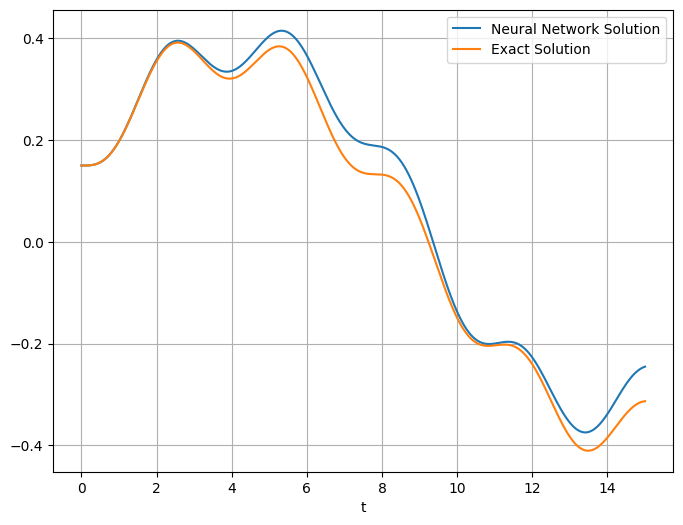

Epochs Progress:  30%|██▉       | 11994/40001 [02:02<06:02, 77.34it/s]

tensor([400.])
epoch: 12000, loss: 0.009608112275600433


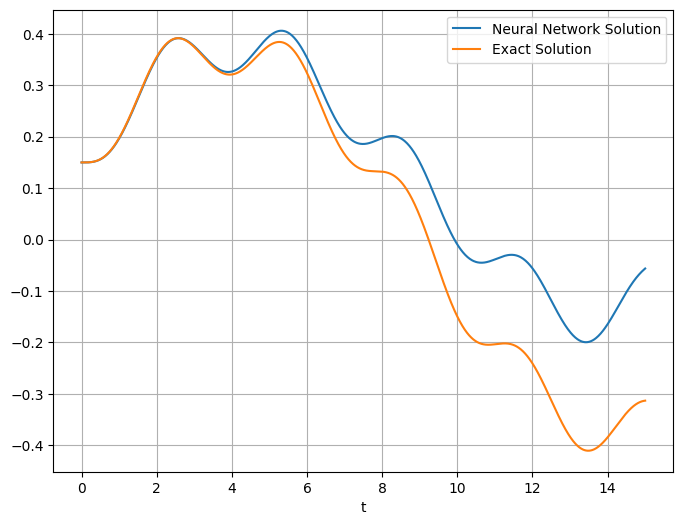

Epochs Progress:  31%|███       | 12490/40001 [02:07<04:02, 113.61it/s]

tensor([400.])
epoch: 12500, loss: 0.00921865738928318


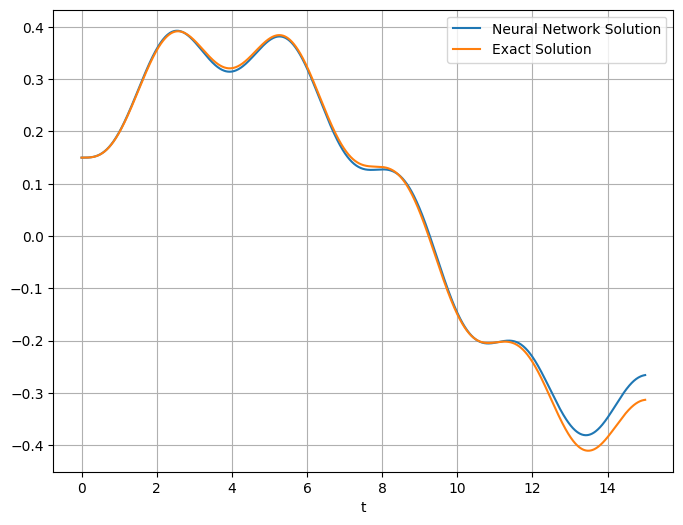

Epochs Progress:  32%|███▏      | 12989/40001 [02:11<03:57, 113.78it/s]

tensor([400.])
epoch: 13000, loss: 0.017452139407396317


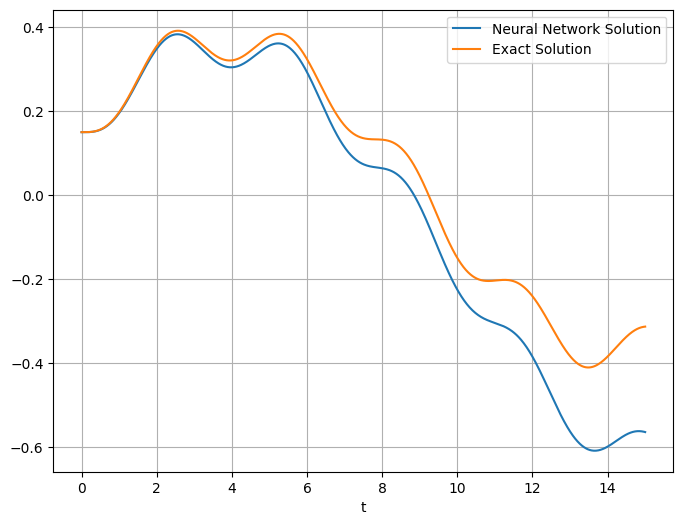

Epochs Progress:  34%|███▎      | 13498/40001 [02:17<04:58, 88.77it/s]

tensor([400.])
epoch: 13500, loss: 0.006427760235965252


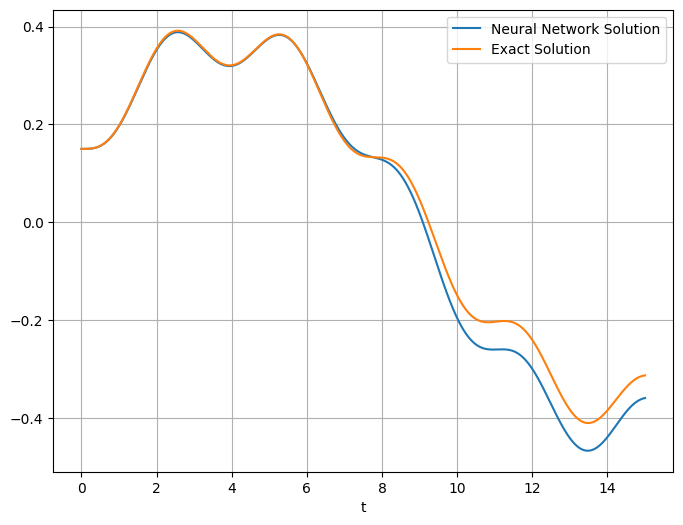

Epochs Progress:  35%|███▍      | 13993/40001 [02:22<03:40, 117.70it/s]

tensor([400.])
epoch: 14000, loss: 0.004668726585805416


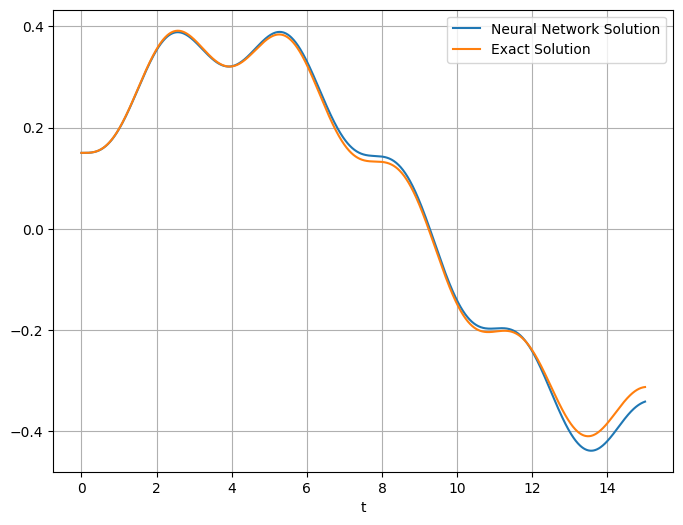

Epochs Progress:  36%|███▌      | 14495/40001 [02:26<03:41, 115.21it/s]

tensor([400.])
epoch: 14500, loss: 0.00718051427975297


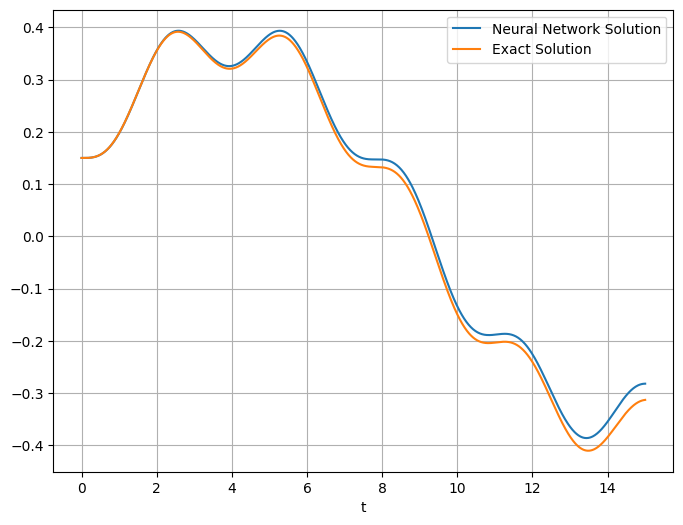

Epochs Progress:  37%|███▋      | 14999/40001 [02:32<04:08, 100.78it/s]

tensor([400.])
epoch: 15000, loss: 0.004812258295714855


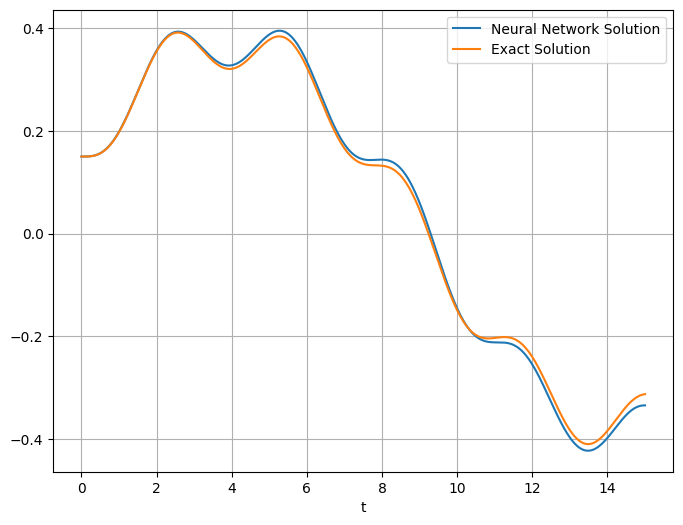

Epochs Progress:  39%|███▊      | 15490/40001 [02:37<03:29, 117.10it/s]

tensor([400.])
epoch: 15500, loss: 0.004920853301882744


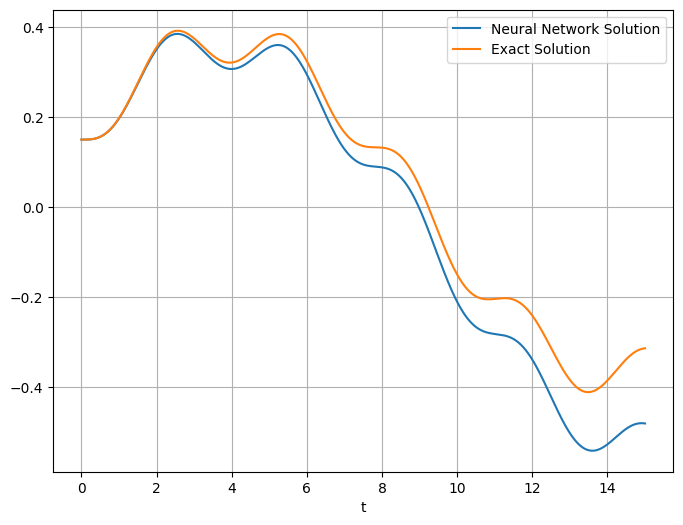

Epochs Progress:  40%|███▉      | 15999/40001 [02:42<03:25, 117.03it/s]

tensor([400.])
epoch: 16000, loss: 0.01928521692752838


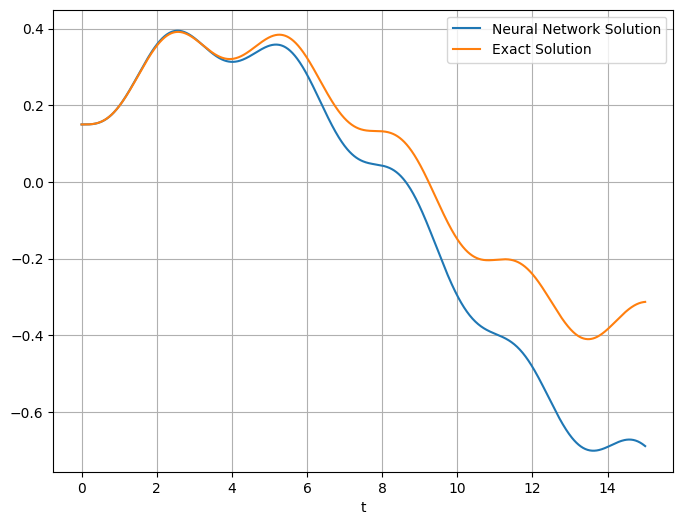

Epochs Progress:  41%|████      | 16500/40001 [02:48<03:55, 99.99it/s]

tensor([400.])
epoch: 16500, loss: 0.006015430204570293


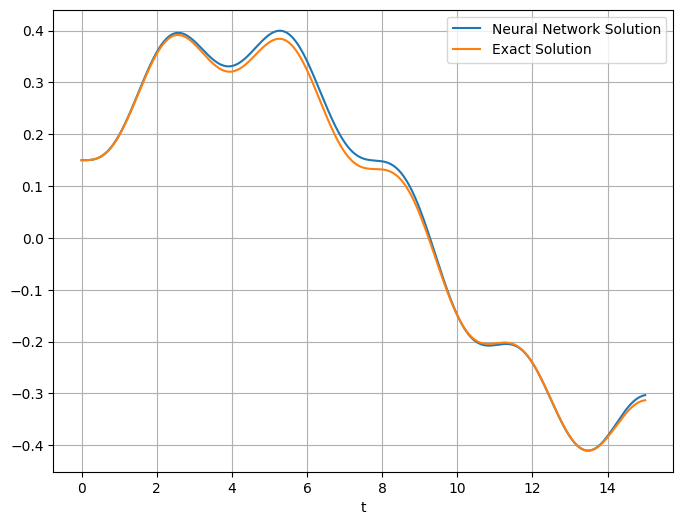

Epochs Progress:  42%|████▏     | 16990/40001 [02:52<03:46, 101.45it/s]

tensor([400.])
epoch: 17000, loss: 0.005500318948179483


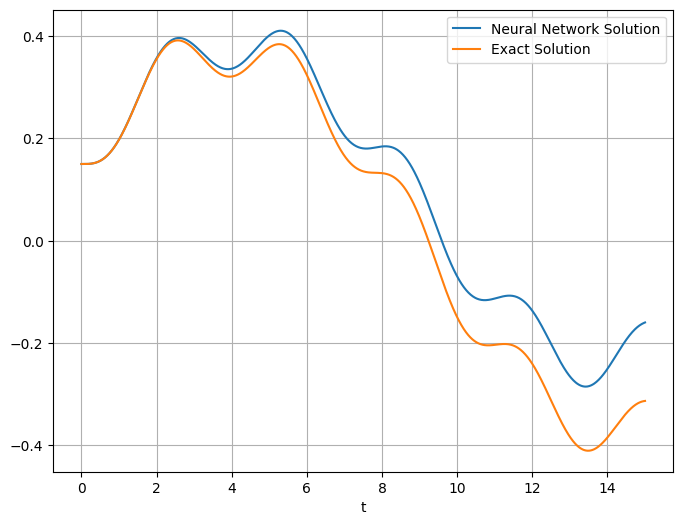

Epochs Progress:  44%|████▎     | 17493/40001 [02:57<03:23, 110.58it/s]

tensor([400.])
epoch: 17500, loss: 0.005959471687674522


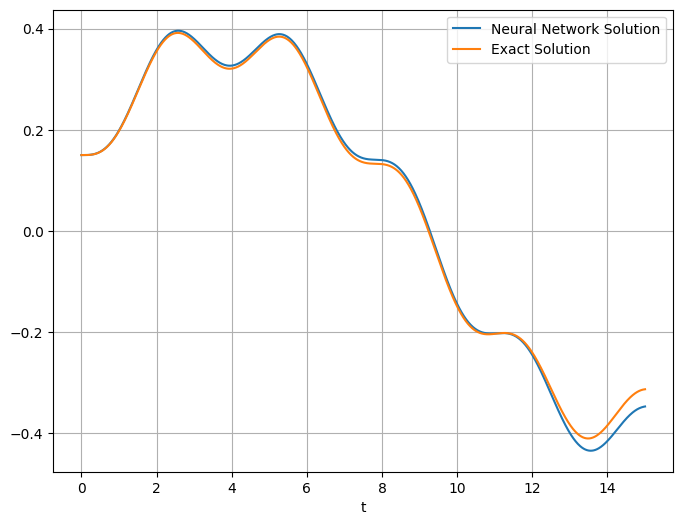

Epochs Progress:  45%|████▍     | 17993/40001 [03:03<03:34, 102.52it/s]

tensor([400.])
epoch: 18000, loss: 0.003966216929256916


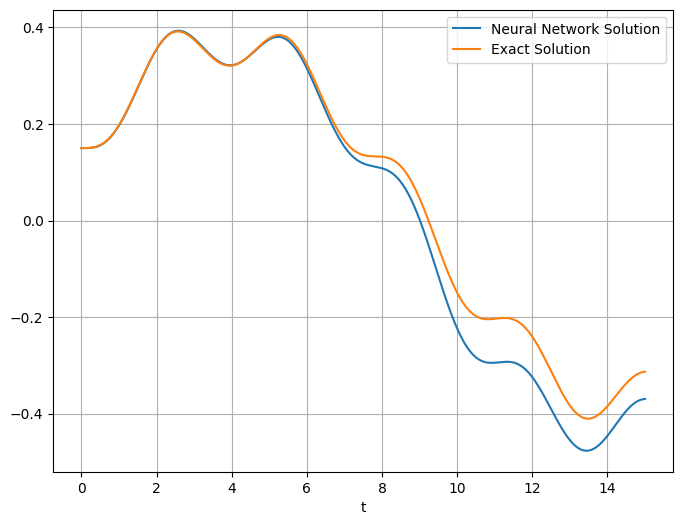

Epochs Progress:  46%|████▌     | 18493/40001 [03:08<03:08, 114.15it/s]

tensor([400.])
epoch: 18500, loss: 0.004191684536635876


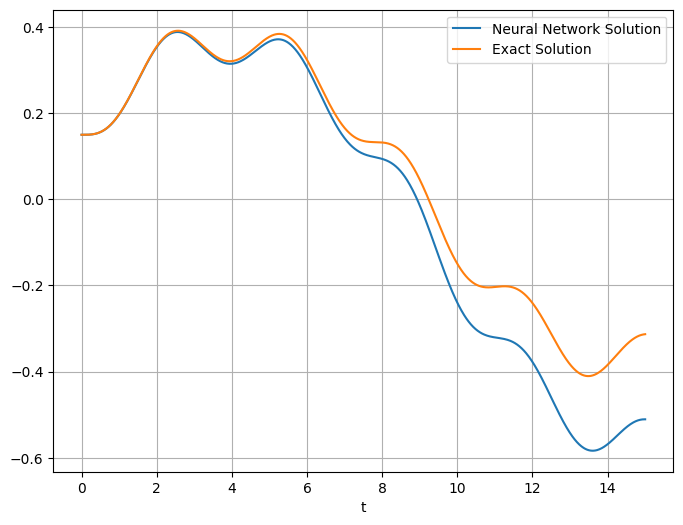

Epochs Progress:  47%|████▋     | 18992/40001 [03:13<03:00, 116.62it/s]

tensor([400.])
epoch: 19000, loss: 0.006405063439160585


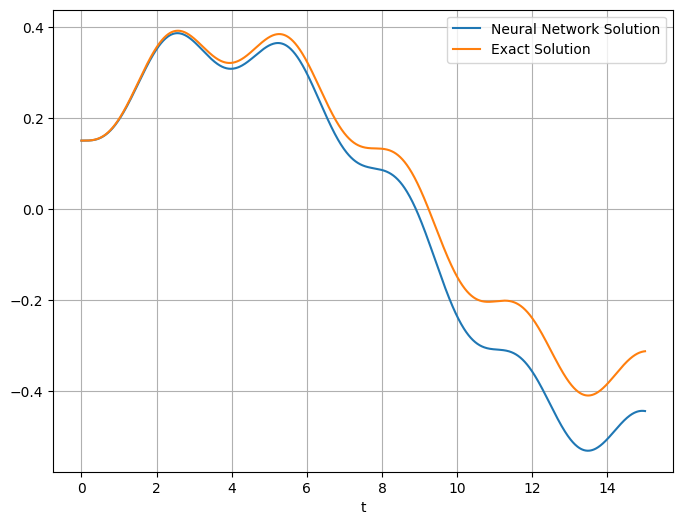

Epochs Progress:  49%|████▊     | 19497/40001 [03:19<03:12, 106.46it/s]

tensor([400.])
epoch: 19500, loss: 0.0035981175024062395


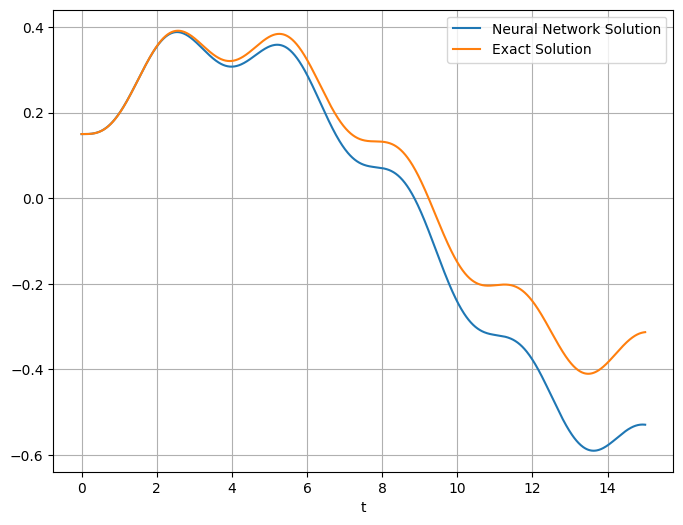

Epochs Progress:  50%|████▉     | 19995/40001 [03:24<02:50, 117.51it/s]

tensor([400.])
epoch: 20000, loss: 0.005912527441978455


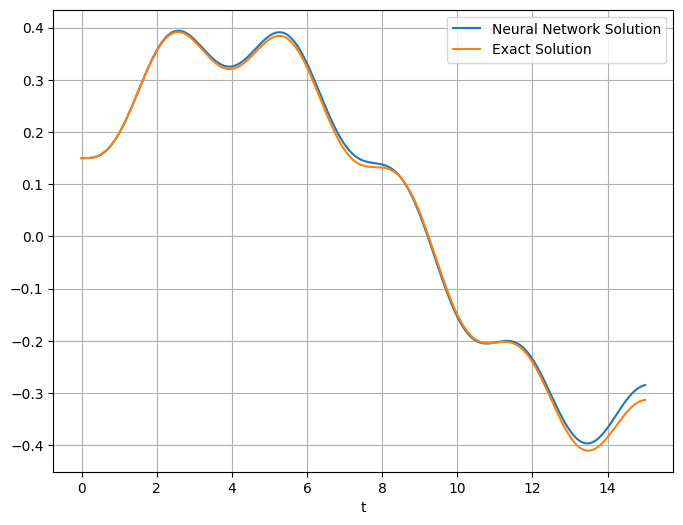

Epochs Progress:  51%|█████     | 20500/40001 [03:29<03:38, 89.24it/s]

tensor([400.])
epoch: 20500, loss: 0.004215871449559927


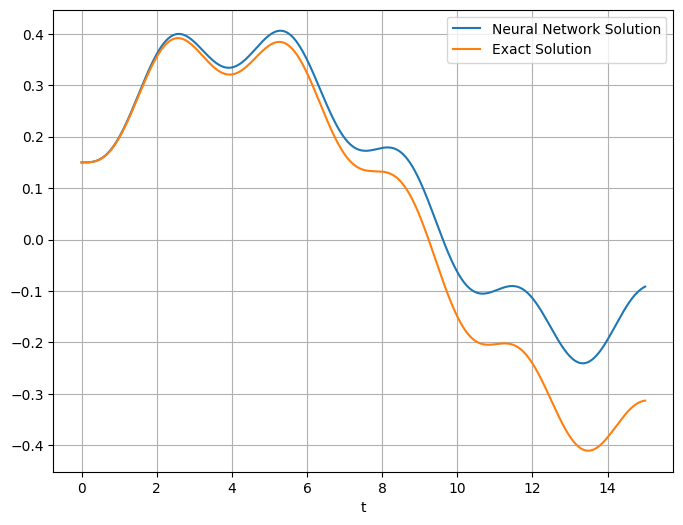

Epochs Progress:  52%|█████▏    | 21000/40001 [03:35<02:51, 111.02it/s]

tensor([400.])
epoch: 21000, loss: 0.008714098483324051


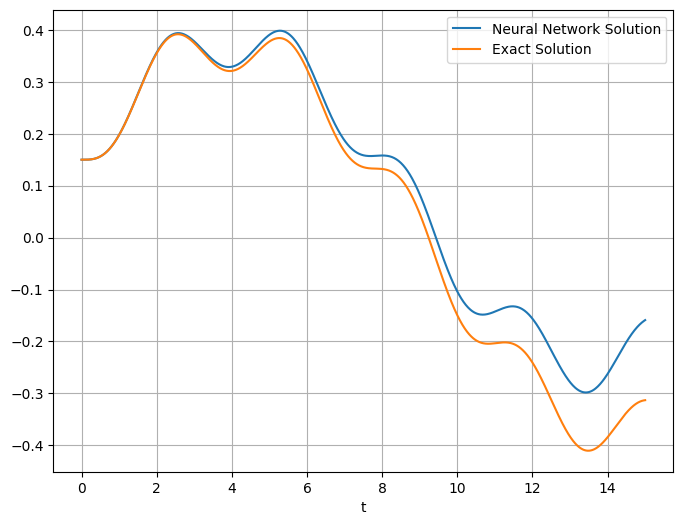

Epochs Progress:  54%|█████▎    | 21490/40001 [03:40<02:43, 113.52it/s]

tensor([400.])
epoch: 21500, loss: 0.004025897942483425


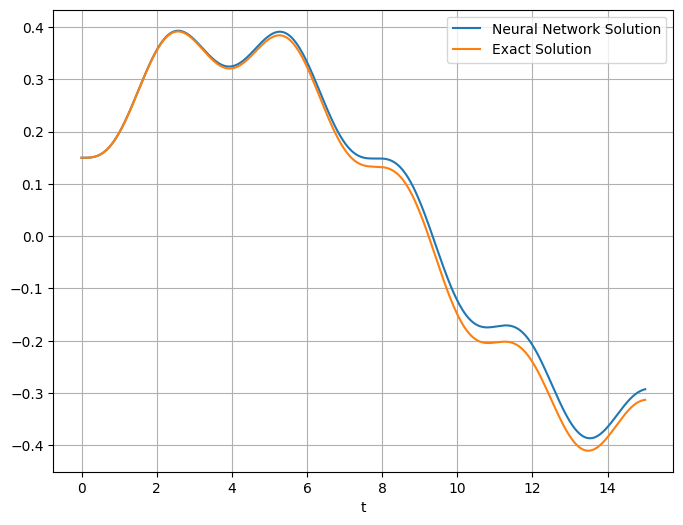

Epochs Progress:  55%|█████▍    | 21997/40001 [03:45<03:25, 87.64it/s]

tensor([400.])
epoch: 22000, loss: 0.00471156369894743


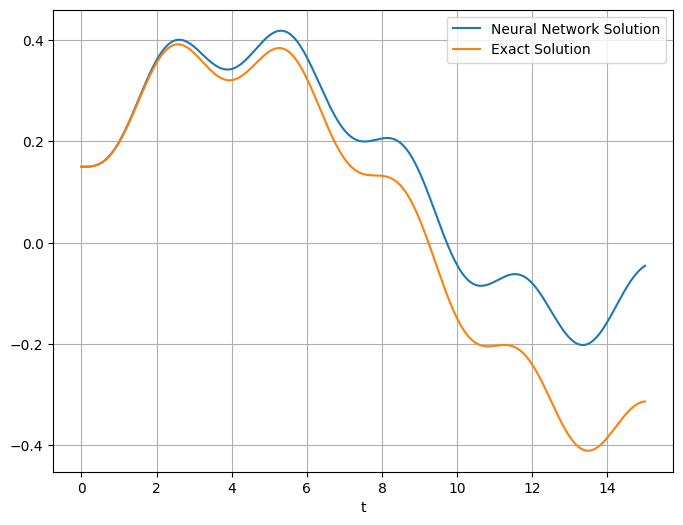

Epochs Progress:  56%|█████▌    | 22497/40001 [03:51<02:32, 114.51it/s]

tensor([400.])
epoch: 22500, loss: 0.006422038190066814


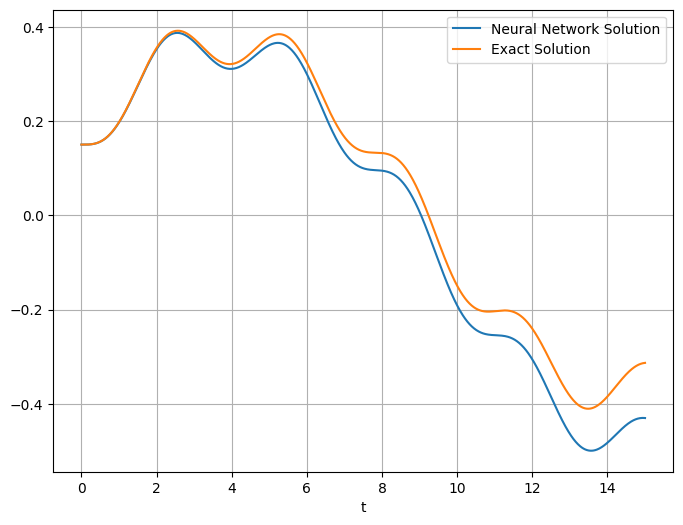

Epochs Progress:  57%|█████▋    | 23000/40001 [03:56<02:30, 113.02it/s]

tensor([400.])
epoch: 23000, loss: 0.0026198786217719316


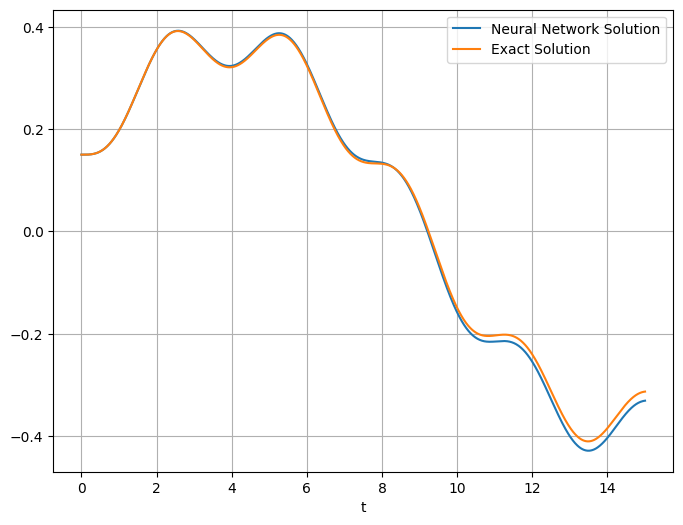

Epochs Progress:  59%|█████▊    | 23492/40001 [04:01<02:55, 93.84it/s]

tensor([400.])
epoch: 23500, loss: 0.006313752382993698


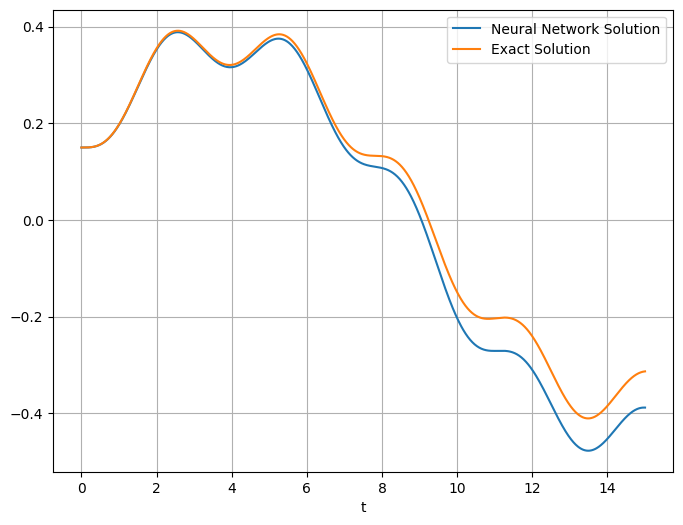

Epochs Progress:  60%|█████▉    | 23995/40001 [04:07<02:23, 111.81it/s]

tensor([400.])
epoch: 24000, loss: 0.002787207718938589


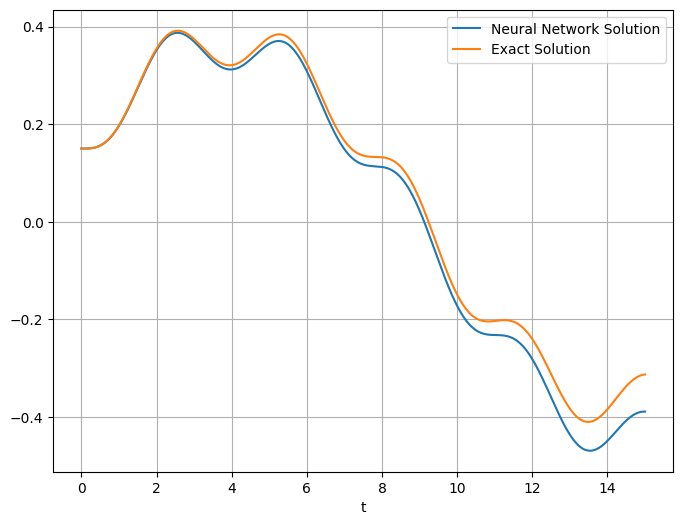

Epochs Progress:  61%|██████    | 24498/40001 [04:11<02:18, 111.93it/s]

tensor([400.])
epoch: 24500, loss: 0.002176034264266491


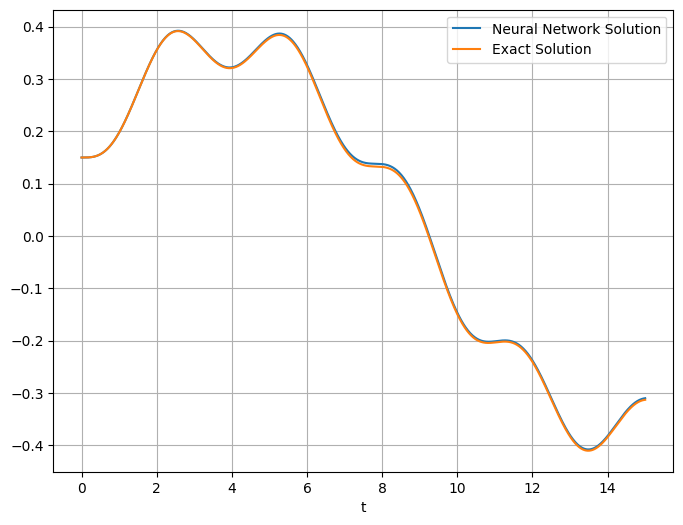

Epochs Progress:  62%|██████▏   | 24999/40001 [04:17<02:48, 89.04it/s]

tensor([400.])
epoch: 25000, loss: 0.004499692469835281


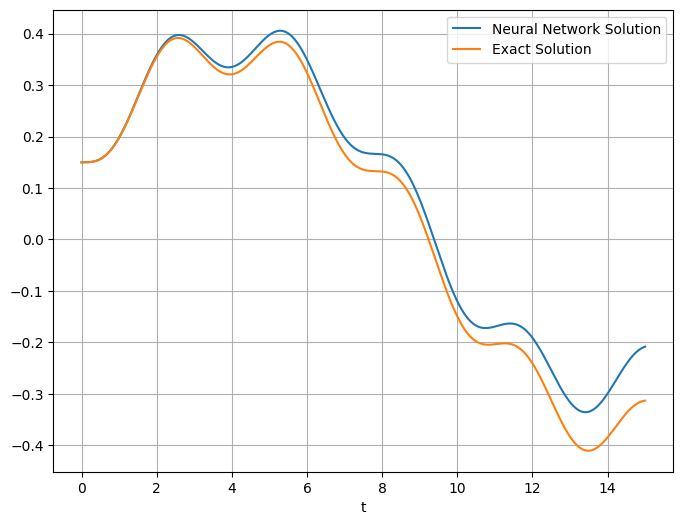

Epochs Progress:  64%|██████▎   | 25493/40001 [04:22<02:11, 109.93it/s]

tensor([400.])
epoch: 25500, loss: 0.0024075983092188835


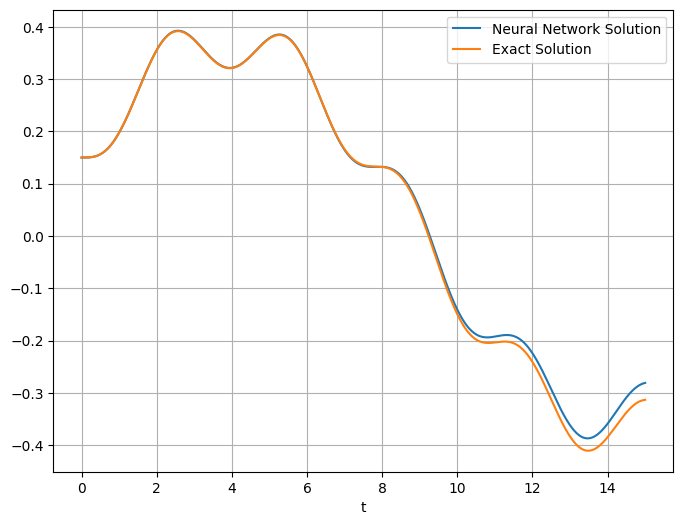

Epochs Progress:  65%|██████▍   | 26000/40001 [04:27<02:05, 111.29it/s]

tensor([400.])
epoch: 26000, loss: 0.0034069654066115618


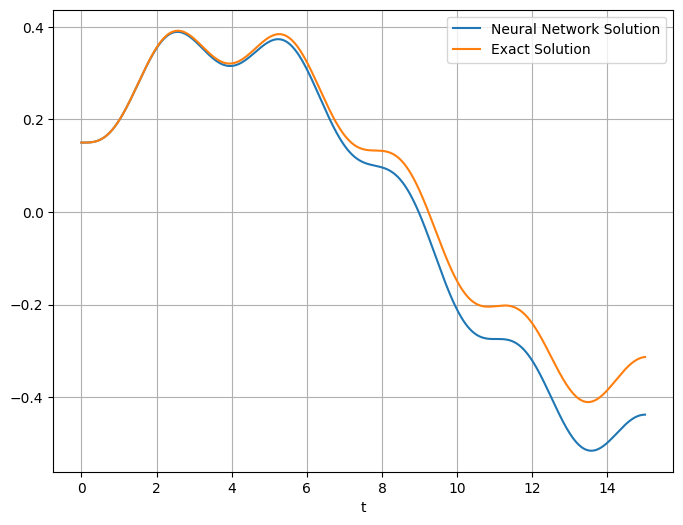

Epochs Progress:  66%|██████▌   | 26497/40001 [04:33<02:30, 89.74it/s]

tensor([400.])
epoch: 26500, loss: 0.002436174778267741


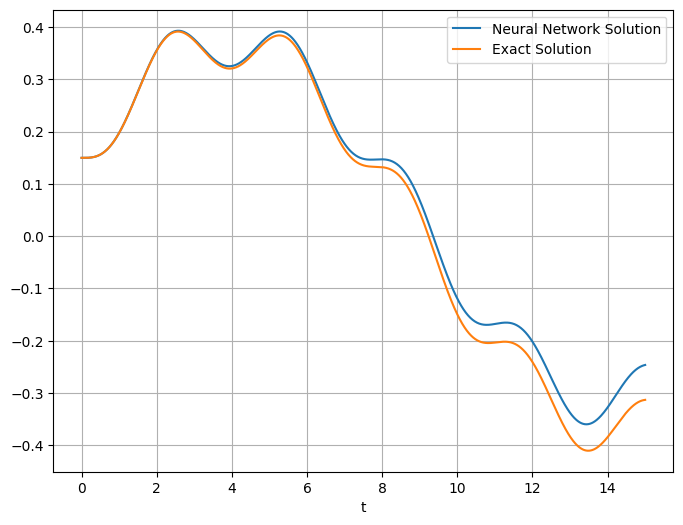

Epochs Progress:  67%|██████▋   | 26995/40001 [04:39<01:59, 108.61it/s]

tensor([400.])
epoch: 27000, loss: 0.0020681011956185102


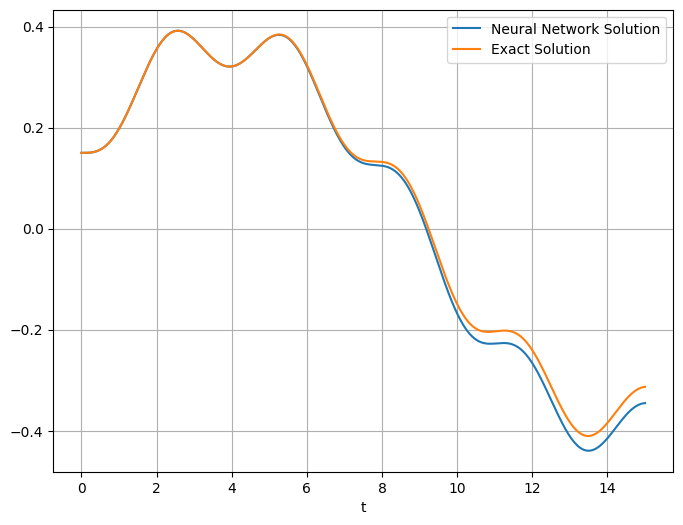

Epochs Progress:  69%|██████▊   | 27499/40001 [04:43<01:53, 110.55it/s]

tensor([400.])
epoch: 27500, loss: 0.003496692981570959


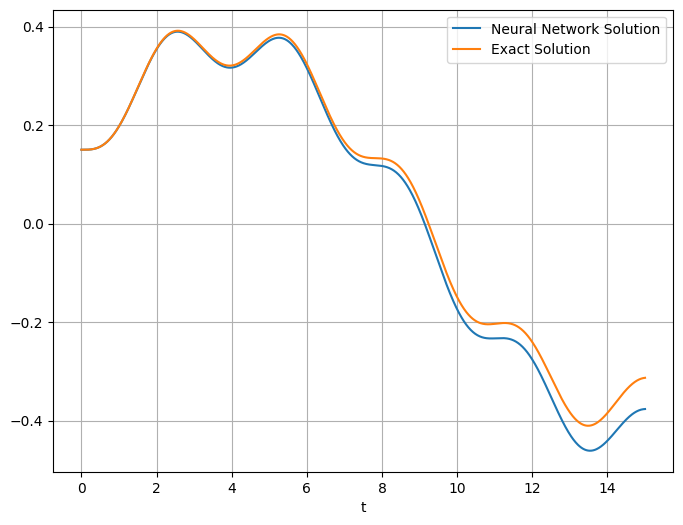

Epochs Progress:  70%|██████▉   | 27992/40001 [04:49<02:16, 88.05it/s]

tensor([400.])
epoch: 28000, loss: 0.0012291556922718883


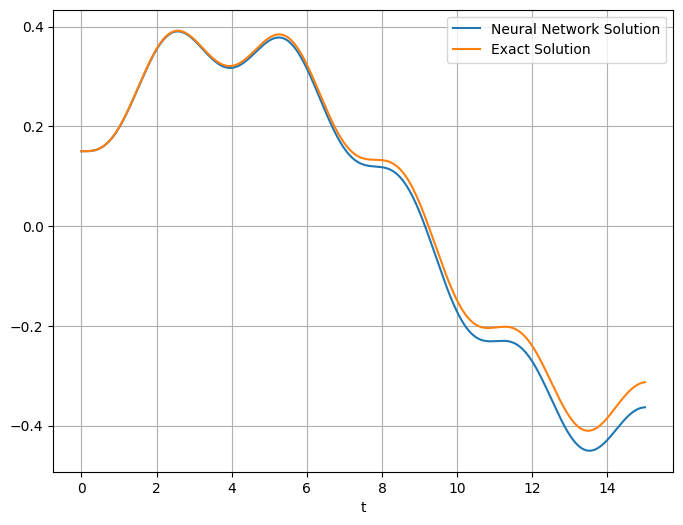

Epochs Progress:  71%|███████   | 28497/40001 [04:55<01:47, 106.96it/s]

tensor([400.])
epoch: 28500, loss: 0.002870462602004409


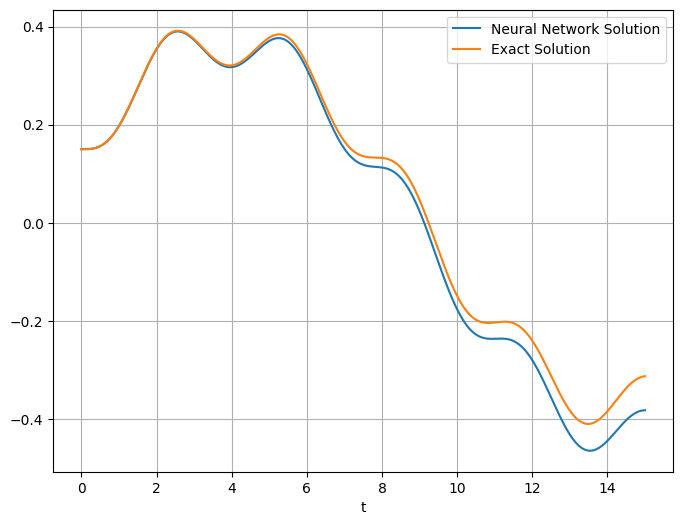

Epochs Progress:  72%|███████▏  | 29000/40001 [05:00<01:43, 106.67it/s]

tensor([400.])
epoch: 29000, loss: 0.0014560202835127711


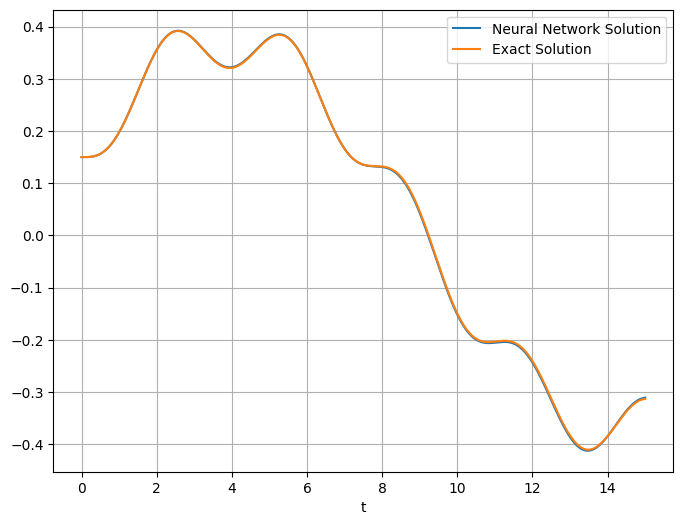

Epochs Progress:  74%|███████▎  | 29494/40001 [05:05<02:14, 78.28it/s]

tensor([400.])
epoch: 29500, loss: 0.0021928870119154453


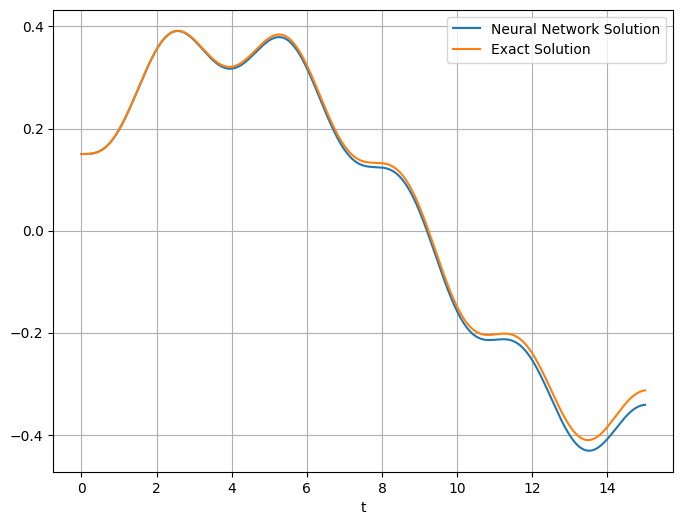

Epochs Progress:  75%|███████▍  | 29995/40001 [05:11<01:33, 107.13it/s]

tensor([400.])
epoch: 30000, loss: 0.000925456581171602


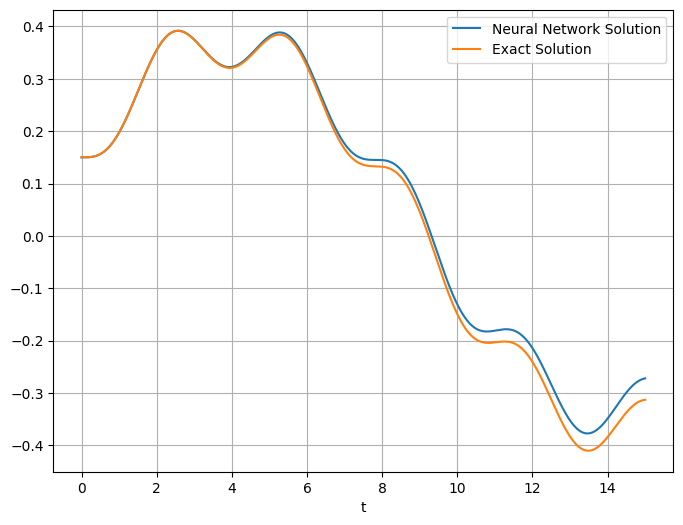

Epochs Progress:  76%|███████▌  | 30491/40001 [05:16<01:30, 104.78it/s]

tensor([400.])
epoch: 30500, loss: 0.0012691712472587824


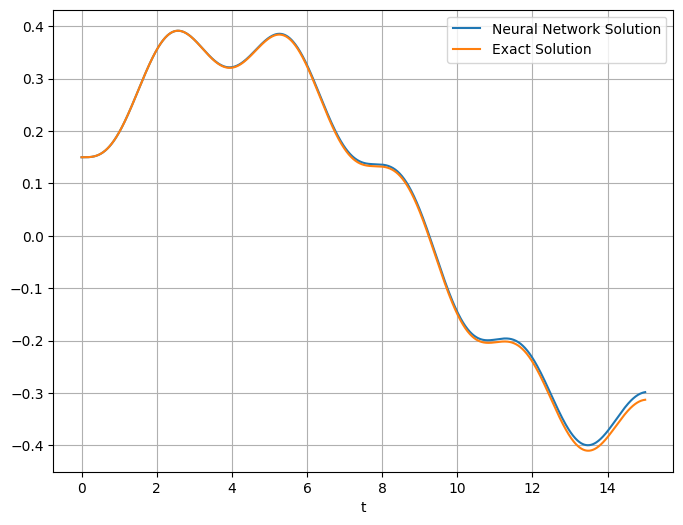

Epochs Progress:  77%|███████▋  | 30997/40001 [05:22<01:59, 75.52it/s]

tensor([400.])
epoch: 31000, loss: 0.0011340177152305841


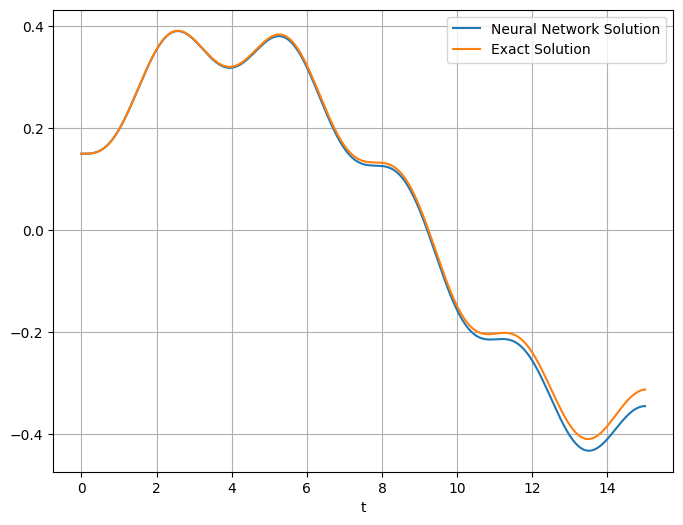

Epochs Progress:  79%|███████▊  | 31500/40001 [05:28<01:19, 107.25it/s]

tensor([400.])
epoch: 31500, loss: 0.0008407765417359769


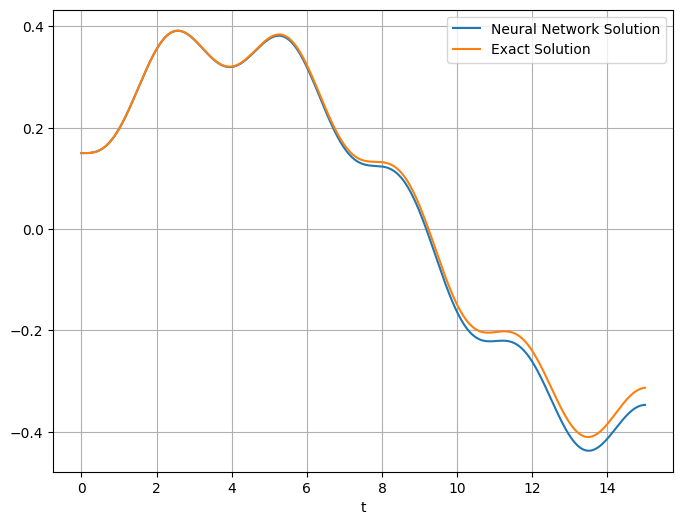

Epochs Progress:  80%|███████▉  | 31991/40001 [05:32<01:13, 109.12it/s]

tensor([400.])
epoch: 32000, loss: 0.00040202285163104534


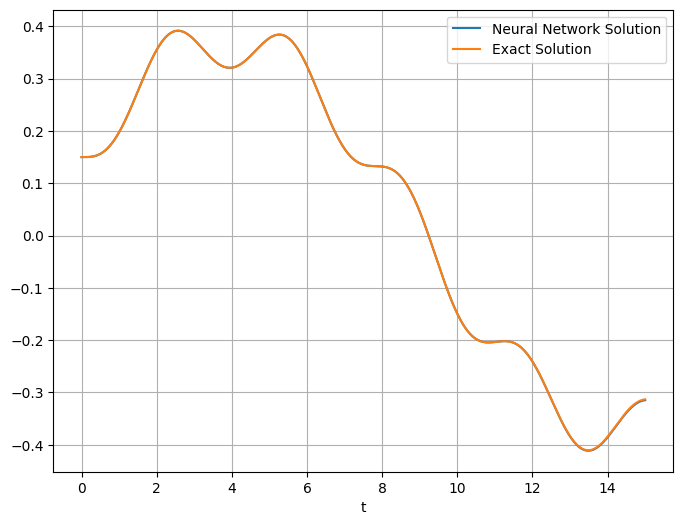

Epochs Progress:  81%|████████  | 32491/40001 [05:38<01:20, 93.55it/s]

tensor([400.])
epoch: 32500, loss: 0.0005382474628277123


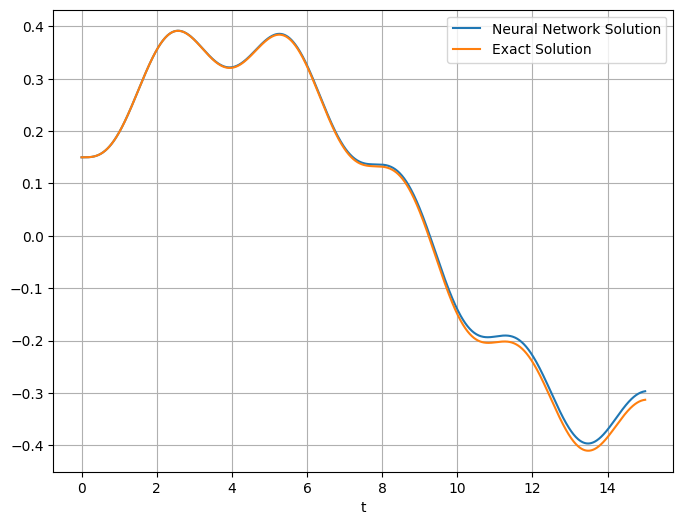

Epochs Progress:  82%|████████▏ | 32997/40001 [05:44<01:05, 107.03it/s]

tensor([400.])
epoch: 33000, loss: 0.0012382083805277944


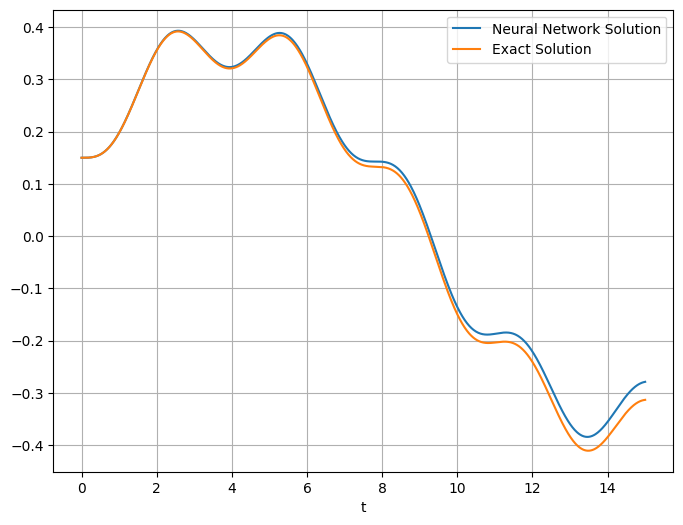

Epochs Progress:  84%|████████▎ | 33498/40001 [05:49<01:00, 107.82it/s]

tensor([400.])
epoch: 33500, loss: 0.0005816768971271813


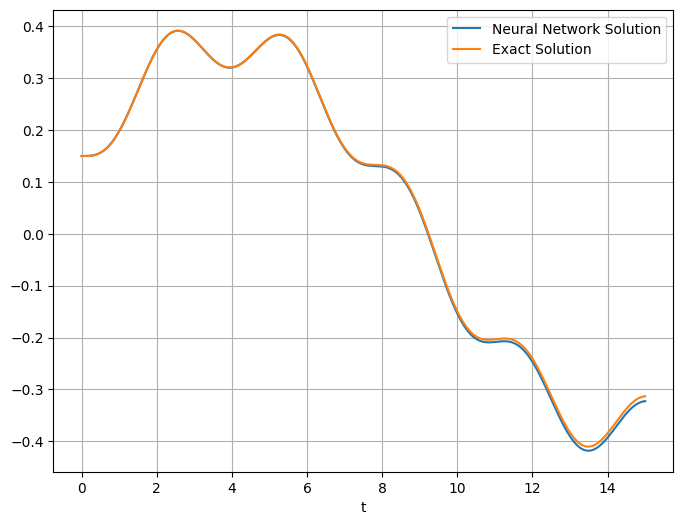

Epochs Progress:  85%|████████▍ | 33999/40001 [05:54<01:09, 85.90it/s]

tensor([400.])
epoch: 34000, loss: 0.00034446854260750115


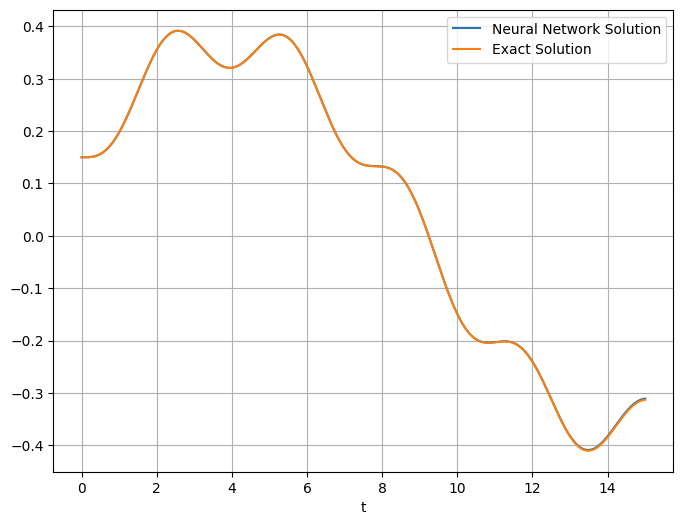

Epochs Progress:  86%|████████▌ | 34492/40001 [06:00<00:52, 104.56it/s]

tensor([400.])
epoch: 34500, loss: 0.00032820721389725804


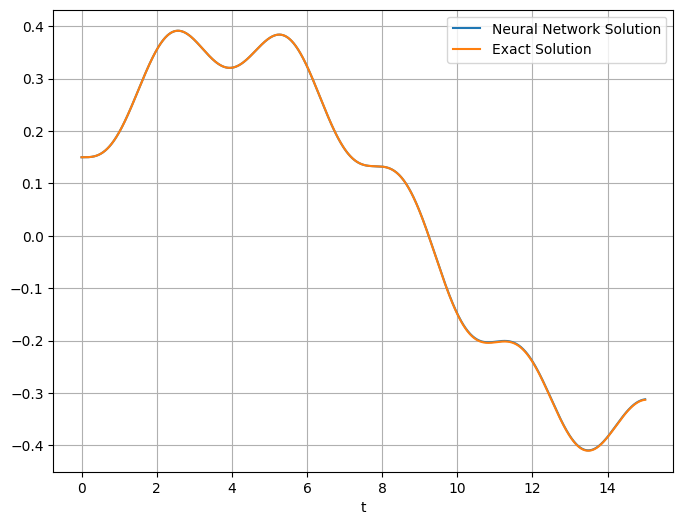

Epochs Progress:  87%|████████▋ | 34997/40001 [06:05<00:45, 110.36it/s]

tensor([400.])
epoch: 35000, loss: 0.00031014333944767714


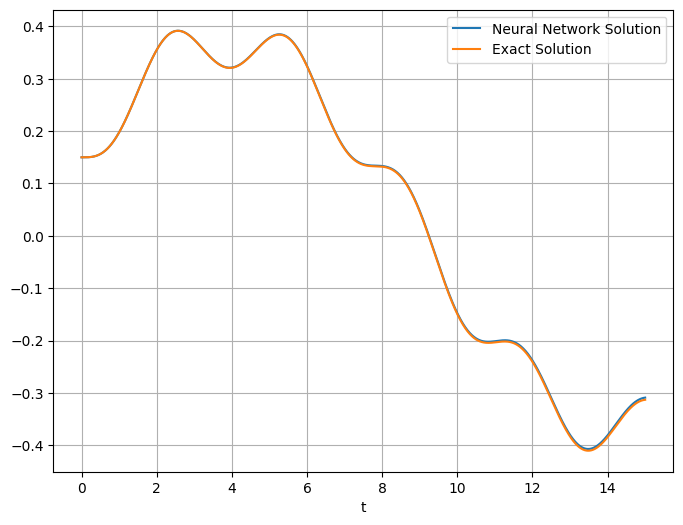

Epochs Progress:  89%|████████▊ | 35494/40001 [06:11<00:53, 84.66it/s]

tensor([400.])
epoch: 35500, loss: 0.0002927578170783818


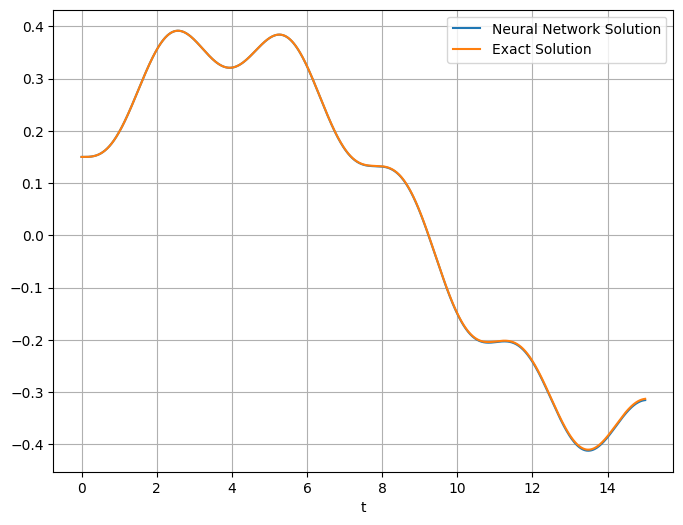

Epochs Progress:  90%|████████▉ | 36000/40001 [06:17<00:38, 104.78it/s]

tensor([400.])
epoch: 36000, loss: 0.00025935747544281185


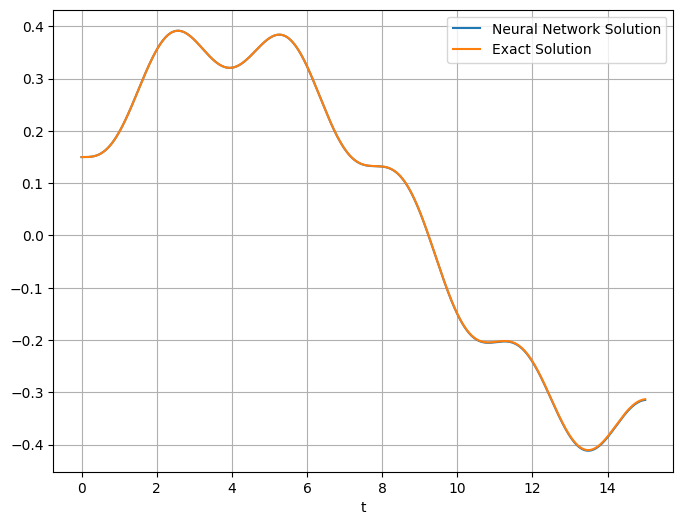

Epochs Progress:  91%|█████████ | 36496/40001 [06:22<00:33, 104.30it/s]

tensor([400.])
epoch: 36500, loss: 0.00024448620388284326


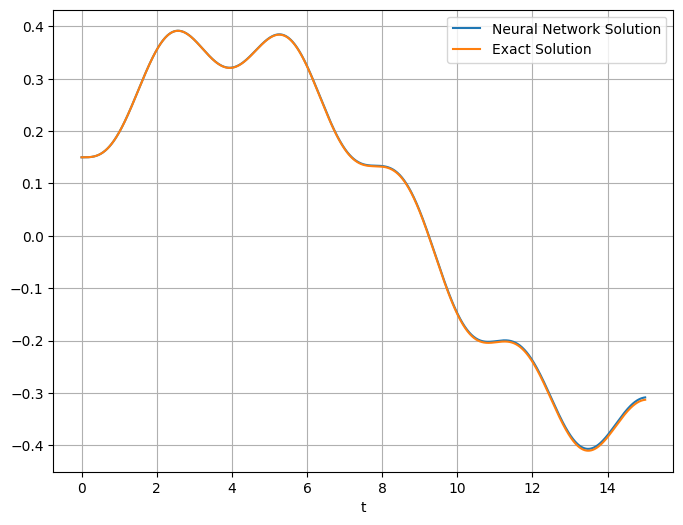

Epochs Progress:  92%|█████████▏| 36997/40001 [06:28<00:37, 80.06it/s]

tensor([400.])
epoch: 37000, loss: 0.00022448079835157841


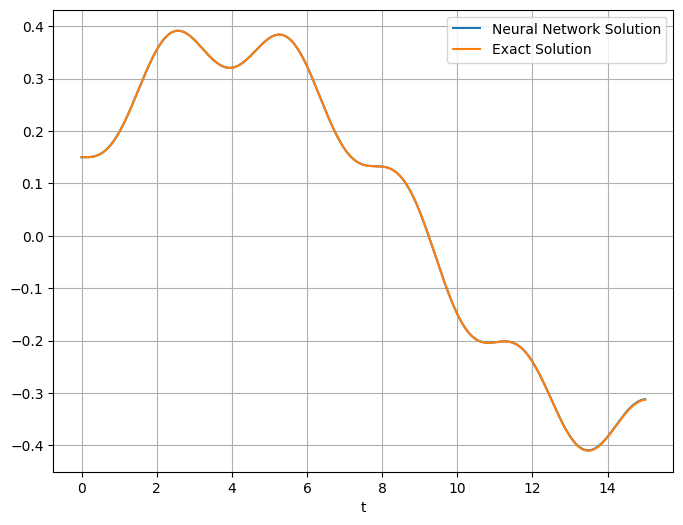

Epochs Progress:  94%|█████████▎| 37498/40001 [06:34<00:25, 98.67it/s] 

tensor([400.])
epoch: 37500, loss: 0.00020491726172622293


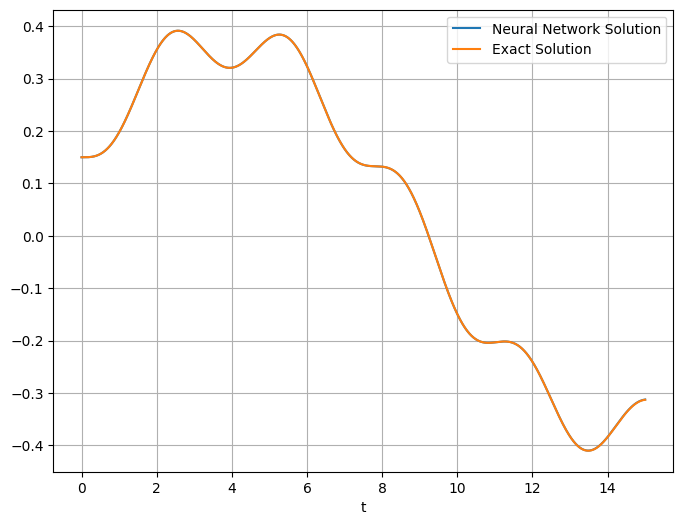

Epochs Progress:  95%|█████████▍| 37997/40001 [06:39<00:19, 104.29it/s]

tensor([400.])
epoch: 38000, loss: 0.00019329773203935474


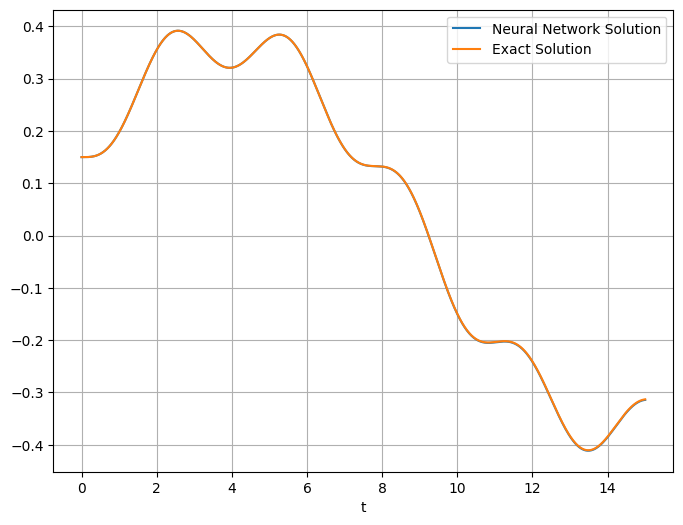

Epochs Progress:  96%|█████████▌| 38493/40001 [06:45<00:17, 85.09it/s]

tensor([400.])
epoch: 38500, loss: 0.00018605314835440367


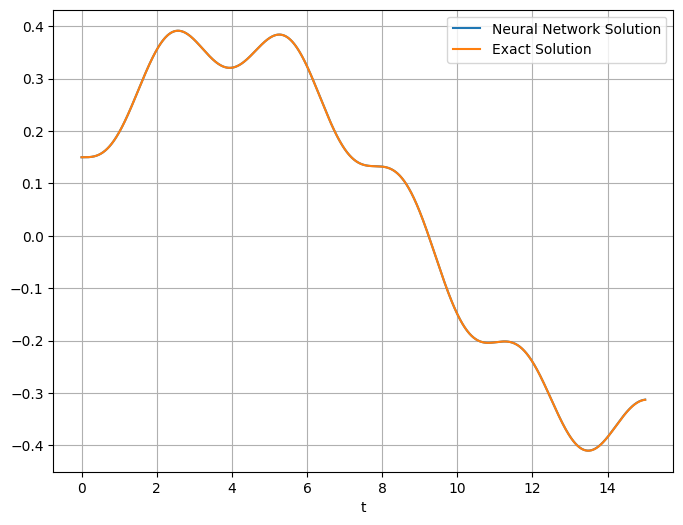

Epochs Progress:  97%|█████████▋| 38998/40001 [06:51<00:09, 104.87it/s]

tensor([400.])
epoch: 39000, loss: 0.00017846420814748853


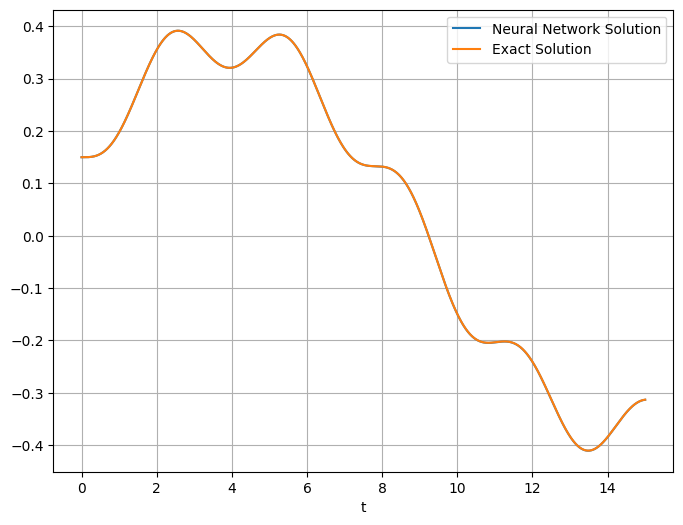

Epochs Progress:  99%|█████████▊| 39499/40001 [06:57<00:04, 100.89it/s]

tensor([400.])
epoch: 39500, loss: 0.00017585046589374542


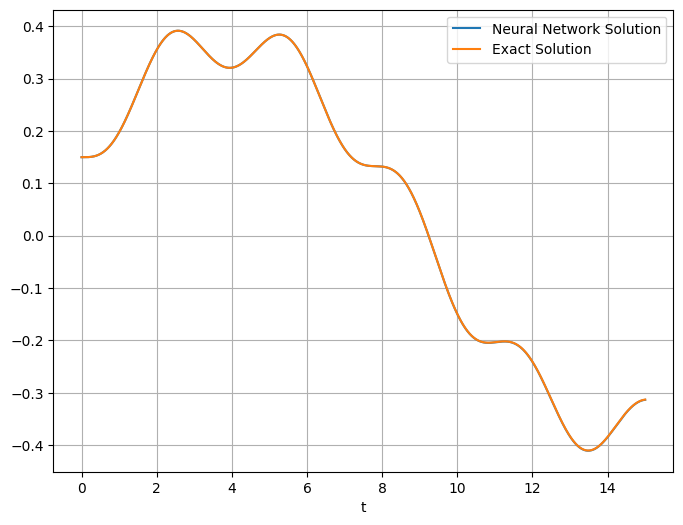

Epochs Progress: 100%|█████████▉| 39994/40001 [07:02<00:00, 83.21it/s]

tensor([400.])
epoch: 40000, loss: 0.00017539053806103766


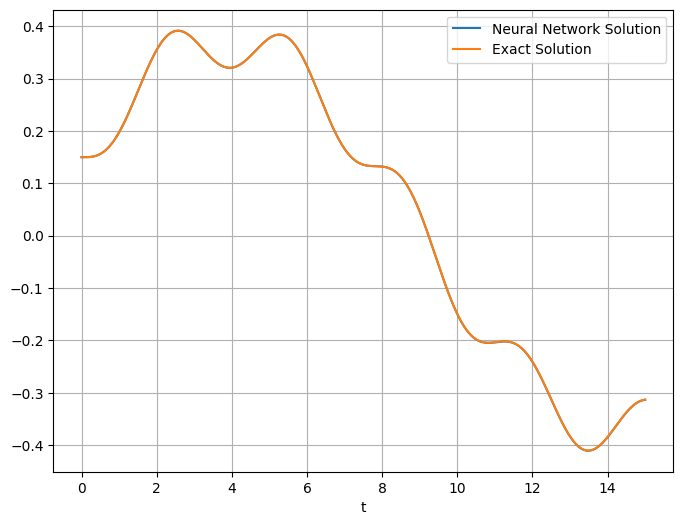

Epochs Progress: 100%|██████████| 40001/40001 [07:03<00:00, 94.55it/s]


In [ ]:
train(optimizer_expert_1, model_expert_1, first_order_loss, trial_solution, 40001, 500, 0, 15, 400, 15, 1000, scheduler = scheduler)

# **Why Stable Training is Essential**
Stable training is crucial to ensure that the model's output aligns with the expected behavior across epochs. When training is stable, we can confidently interpret outputs as accurate and reflective of the model's understanding. However, in the current setup sometime, the model diverges instead of converging as epochs increase, leading to inconsistent results. This instability implies that the neural network may not reliably perform on complex tasks, as fluctuating outputs could compromise overall accuracy.

# **1D Under-Damped Harmonic Oscillator**

$$
m \dfrac{d^2 x}{d t^2} + \mu \dfrac{d x}{d t} + kx = 0~,
$$
with the initial conditions$$
x(0) = 1~~,~~\dfrac{d x}{d t} = 0~.
$$
We will focus on solving the problem for the under-damped state, i.e. when
$$
\delta < \omega_0~,~~~~~\mathrm{with}~~\delta = \dfrac{\mu}{2m}~,~\omega_0 = \sqrt{\dfrac{k}{m}}~.
$$
*Exact Solution :*
$$
x(t) = e^{-\delta t}(2 A \cos(\phi + \omega t))~,~~~~~\mathrm{with}~~\omega=\sqrt{\omega_0^2 - \delta^2}~.
$$

For this problem, we use $\delta=1$, $\omega_0=10$, and try to learn the solution over the domain $x\in [0,1]$.


In [ ]:
w0 = 10
d = 1

In [ ]:
def harmonic_oscillator(t):
    '''Defines the analytical solution to the 1D underdamped harmonic oscillator problem.
    Equations taken from: https://beltoforion.de/en/harmonic_oscillator/'''
    w = np.sqrt(w0**2-d**2)
    phi = np.arctan(-d/w)
    A = 1/(2*np.cos(phi))
    cos = torch.cos(phi+w*t)
    exp = torch.exp(-d*t)
    x  = exp*2*A*cos
    return x

In [ ]:
def harmonic_trial_solution(neural_network, x):
    return 1 + x*x*neural_network(x)

In [ ]:
def harmonic_loss(neural_network, trial_solution, domain_lower_bound=0, domain_upper_bound=1, num_points=10):
    t = torch.linspace(domain_lower_bound, domain_upper_bound, num_points, requires_grad=True).unsqueeze(1)
    x = trial_solution(neural_network, t)
    dx_dt = torch.autograd.grad(x, t, grad_outputs=torch.ones_like(x),create_graph=True)[0]
    d2x_dt2 = torch.autograd.grad(dx_dt, t,  grad_outputs=torch.ones_like(dx_dt),create_graph=True)[0]
    individual_error = torch.abs(d2x_dt2 + 2*d*dx_dt + w0*w0*x)
    return torch.sum(individual_error)/num_points

In [ ]:
display_x = torch.linspace(0, 1, 100, requires_grad=False).unsqueeze(1)
display_y = harmonic_oscillator(display_x)

In [ ]:
harmonic_expert_2 = MixtureOfExperts(N_EXPERT = 2)
harmonic_optimizer_expert_2 = optim.Adam(harmonic_expert_2.parameters(), lr = lr)
schduler = optim.lr_scheduler.CosineAnnealingLR(harmonic_optimizer_expert_2, T_max=80000)

Epochs Progress:   0%|          | 0/40000 [00:00<?, ?it/s]

epoch: 0, loss: 104.36195373535156


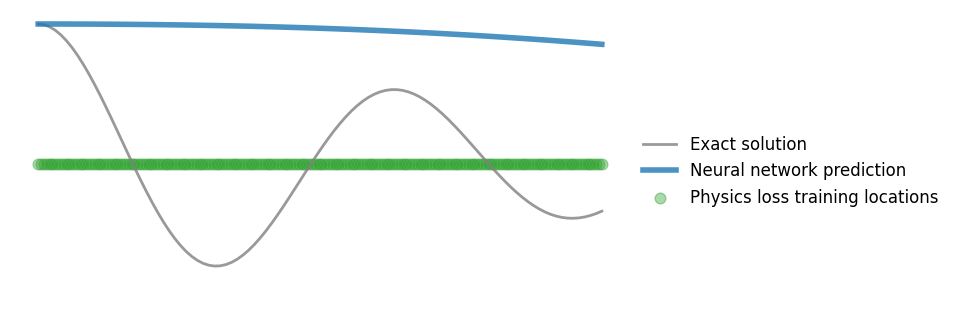

Epochs Progress:   1%|          | 495/40000 [00:06<06:02, 108.87it/s]

epoch: 500, loss: 12.465346336364746


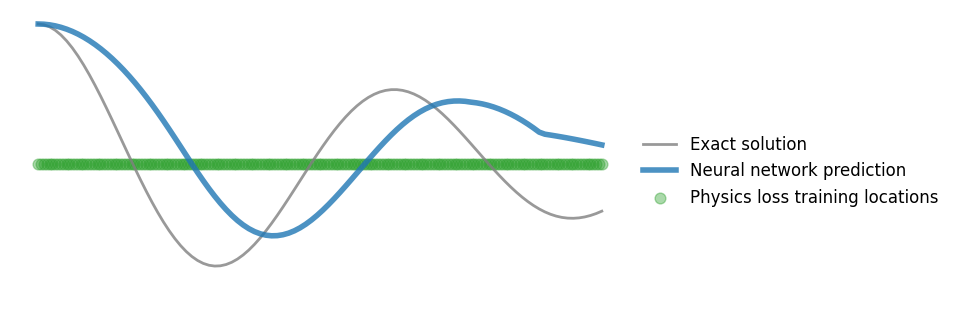

Epochs Progress:   2%|▏         | 994/40000 [00:11<06:04, 107.01it/s]

epoch: 1000, loss: 11.84677505493164


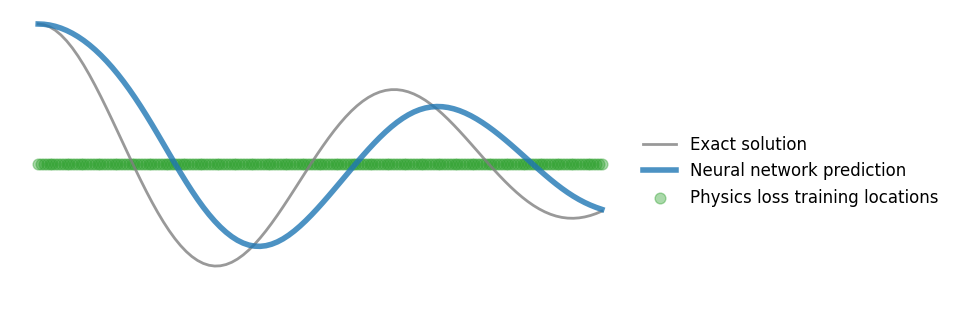

Epochs Progress:   4%|▎         | 1493/40000 [00:18<09:02, 70.94it/s]

epoch: 1500, loss: 8.724376678466797


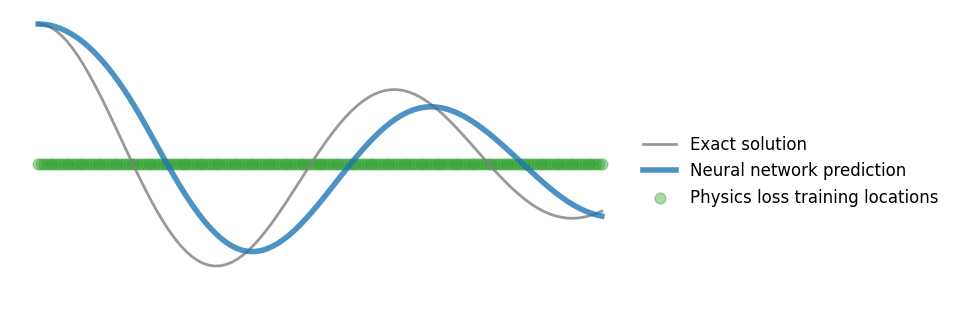

Epochs Progress:   5%|▍         | 1994/40000 [00:23<05:43, 110.78it/s]

epoch: 2000, loss: 7.324382305145264


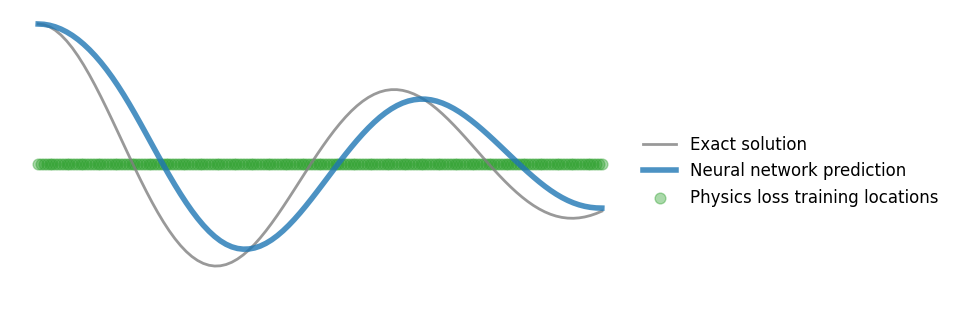

Epochs Progress:   6%|▋         | 2500/40000 [00:29<07:02, 88.82it/s]

epoch: 2500, loss: 8.310806274414062


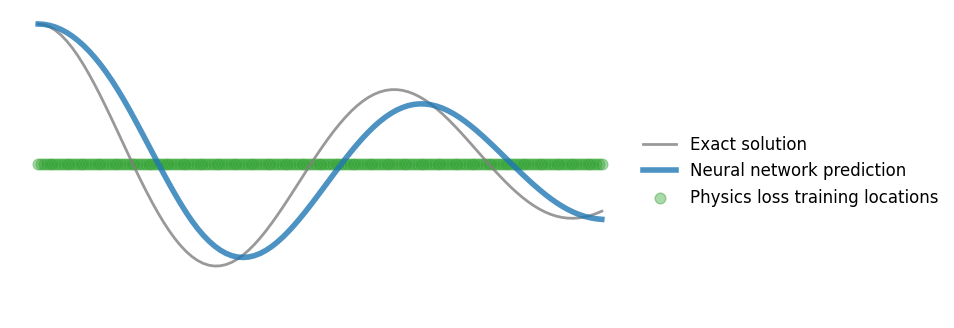

Epochs Progress:   7%|▋         | 2999/40000 [00:36<08:51, 69.67it/s]

epoch: 3000, loss: 6.688676834106445


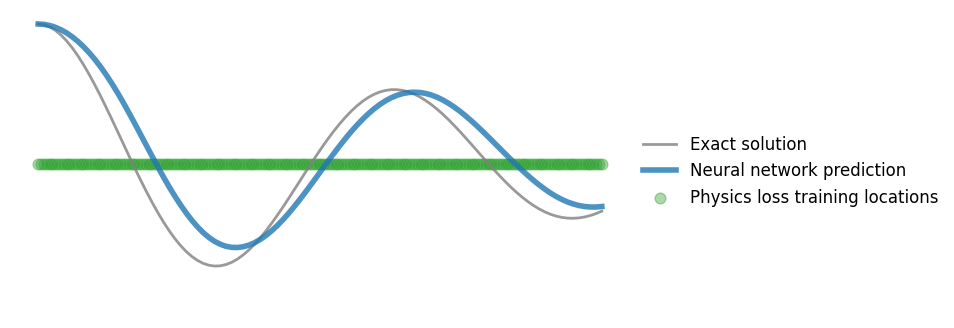

Epochs Progress:   9%|▊         | 3491/40000 [00:41<05:46, 105.22it/s]

epoch: 3500, loss: 5.715418815612793


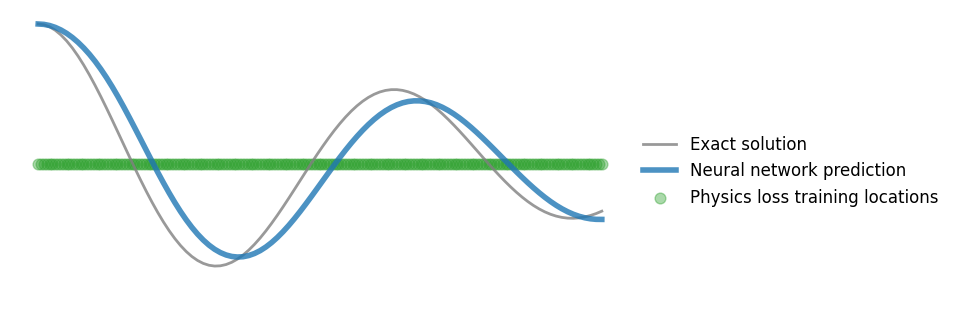

Epochs Progress:  10%|▉         | 3999/40000 [00:48<05:39, 106.12it/s]

epoch: 4000, loss: 4.6396379470825195


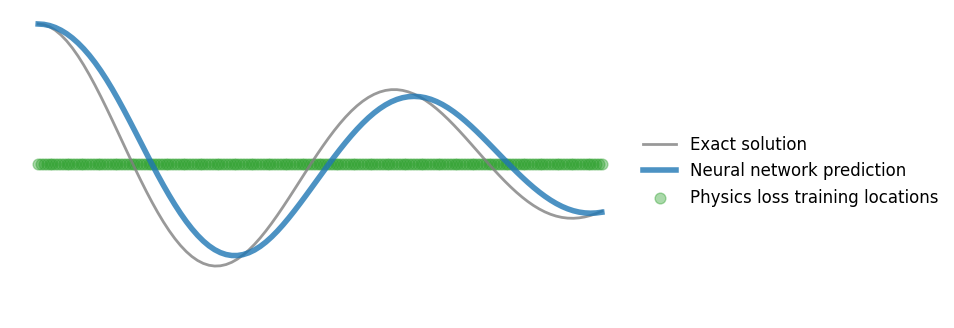

Epochs Progress:  11%|█         | 4491/40000 [00:54<05:33, 106.57it/s]

epoch: 4500, loss: 3.904738664627075


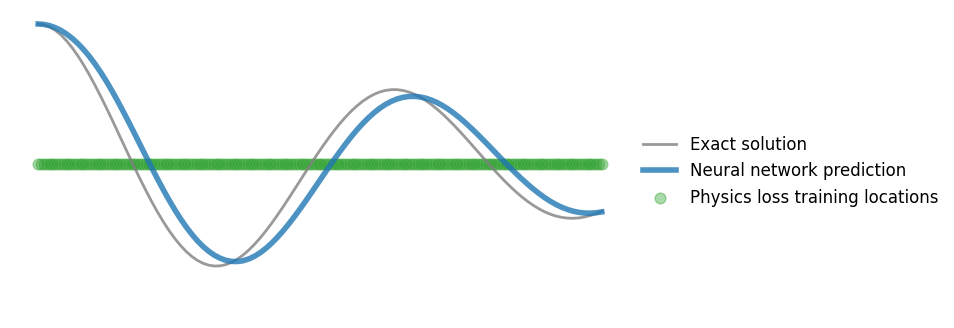

Epochs Progress:  12%|█▏        | 4995/40000 [01:01<08:35, 67.92it/s]

epoch: 5000, loss: 3.8119091987609863


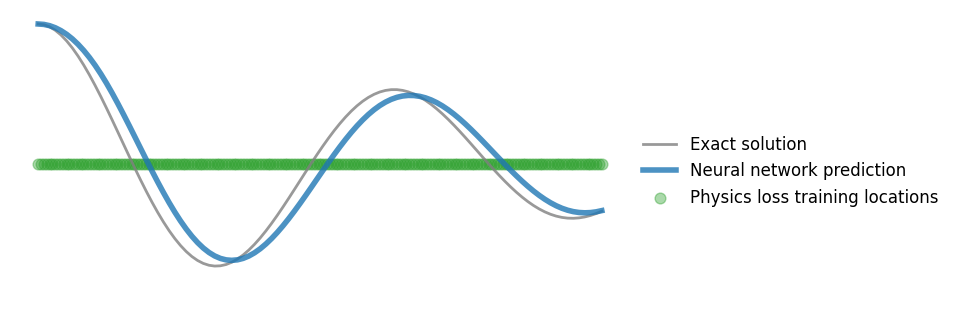

Epochs Progress:  14%|█▎        | 5491/40000 [01:06<05:32, 103.74it/s]

epoch: 5500, loss: 3.736391544342041


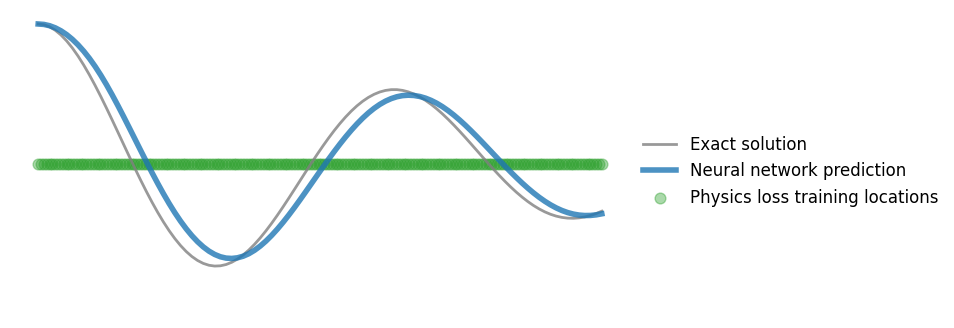

Epochs Progress:  15%|█▌        | 6000/40000 [01:12<07:02, 80.57it/s]

epoch: 6000, loss: 3.6000354290008545


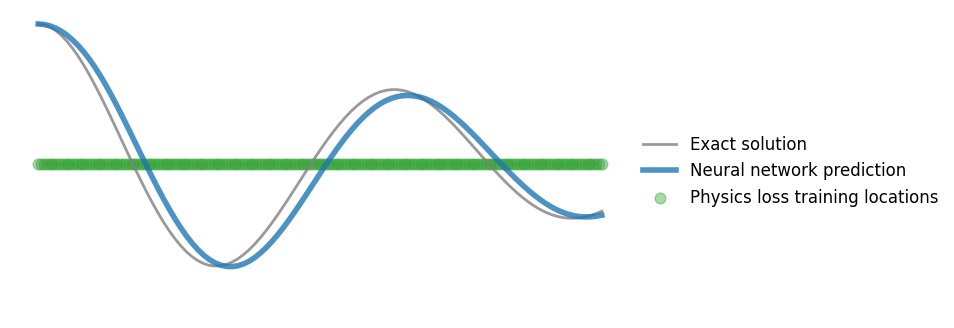

Epochs Progress:  16%|█▌        | 6499/40000 [01:18<05:02, 110.70it/s]

epoch: 6500, loss: 3.6344497203826904


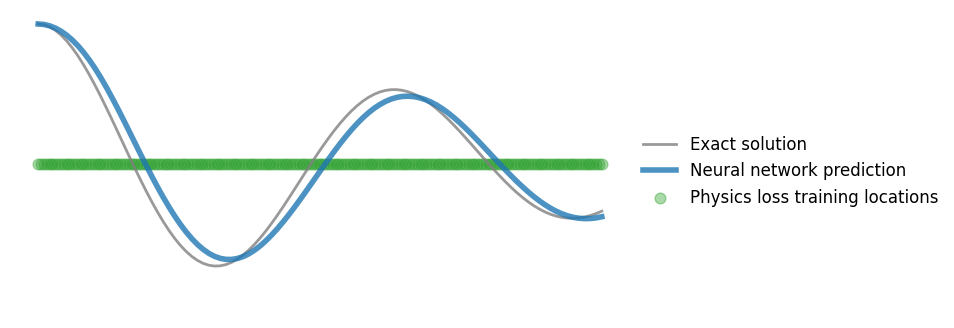

Epochs Progress:  17%|█▋        | 6991/40000 [01:24<05:16, 104.34it/s]

epoch: 7000, loss: 3.50376558303833


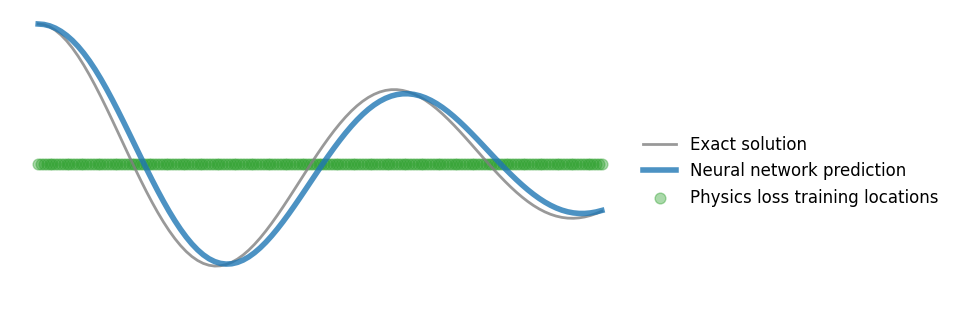

Epochs Progress:  19%|█▊        | 7499/40000 [01:31<05:43, 94.68it/s] 

epoch: 7500, loss: 2.938676118850708


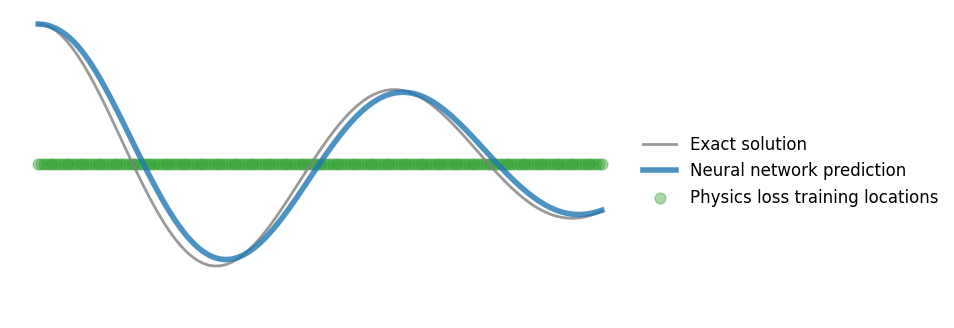

Epochs Progress:  20%|█▉        | 7995/40000 [01:36<05:28, 97.43it/s]

epoch: 8000, loss: 3.218332290649414


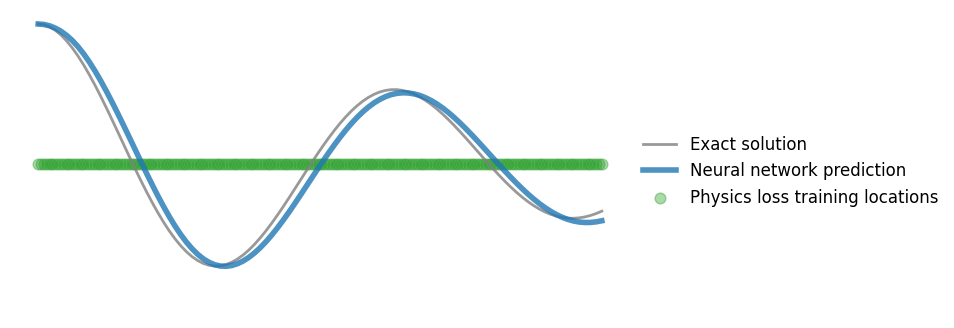

Epochs Progress:  21%|██        | 8494/40000 [01:43<07:26, 70.56it/s]

epoch: 8500, loss: 2.5167617797851562


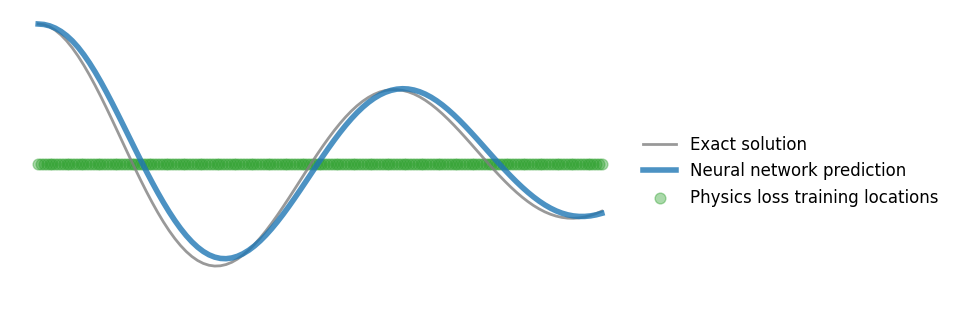

Epochs Progress:  22%|██▏       | 8989/40000 [01:48<05:01, 102.78it/s]

epoch: 9000, loss: 2.792924404144287


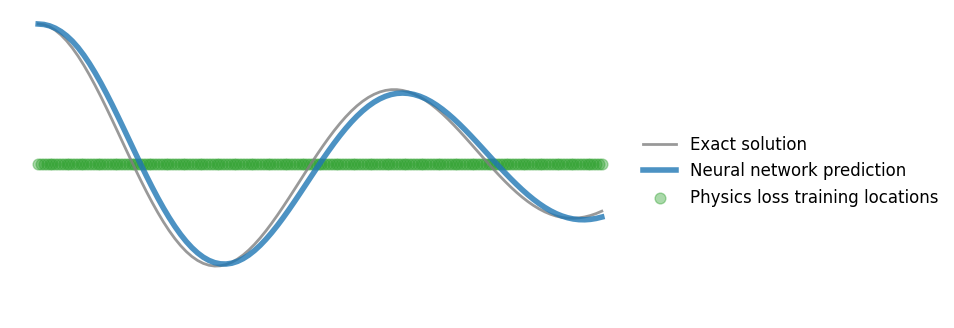

Epochs Progress:  24%|██▎       | 9493/40000 [01:54<06:40, 76.27it/s]

epoch: 9500, loss: 2.846090316772461


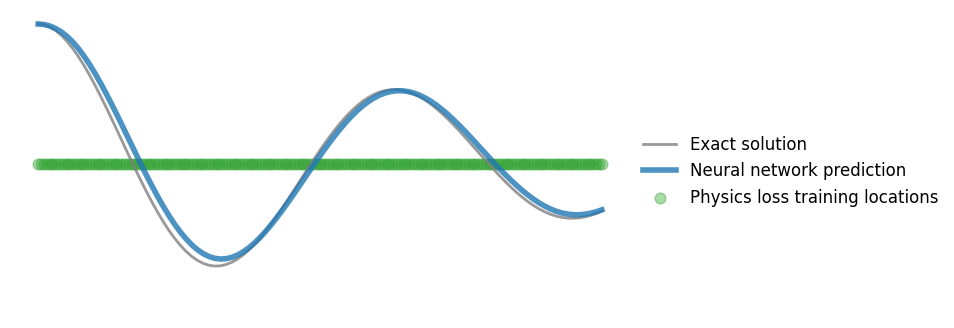

Epochs Progress:  25%|██▍       | 9993/40000 [02:01<04:59, 100.34it/s]

epoch: 10000, loss: 2.3438870906829834


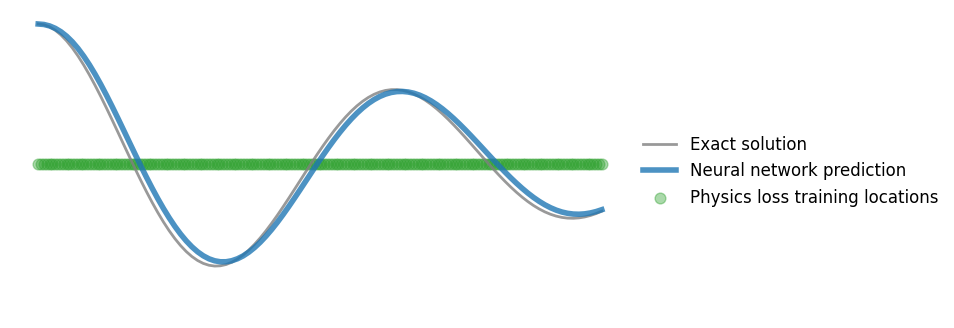

Epochs Progress:  26%|██▌       | 10497/40000 [02:06<04:43, 104.22it/s]

epoch: 10500, loss: 2.549544095993042


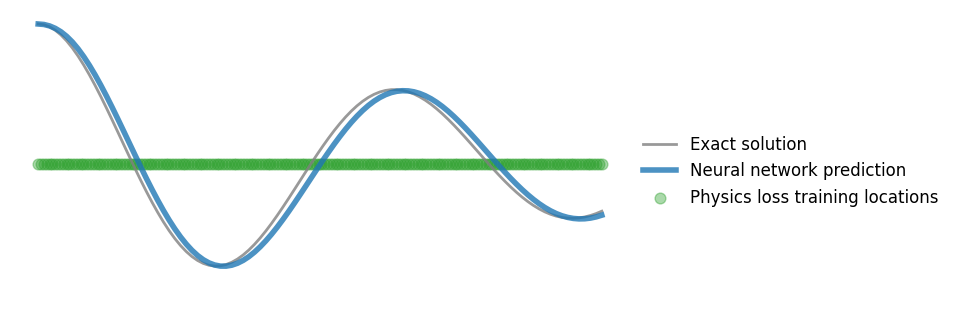

Epochs Progress:  27%|██▋       | 10999/40000 [02:13<04:32, 106.34it/s]

epoch: 11000, loss: 2.212252140045166


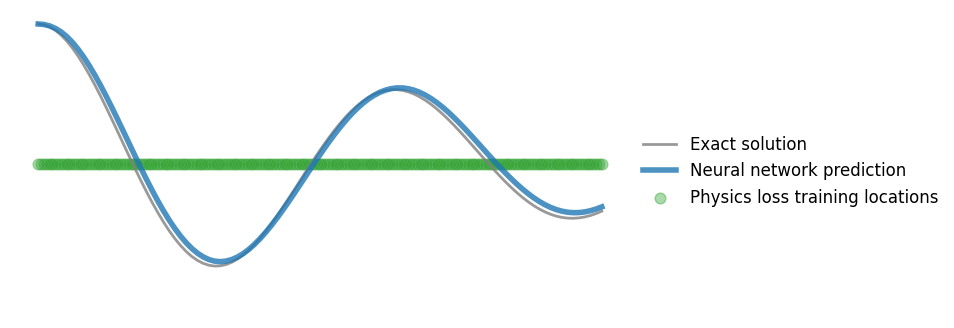

Epochs Progress:  29%|██▊       | 11489/40000 [02:18<04:29, 105.68it/s]

epoch: 11500, loss: 3.1790082454681396


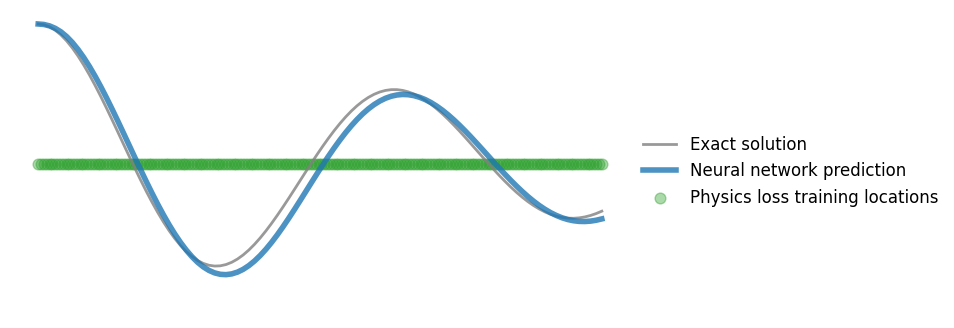

Epochs Progress:  30%|███       | 12000/40000 [02:25<05:56, 78.53it/s]

epoch: 12000, loss: 2.060723066329956


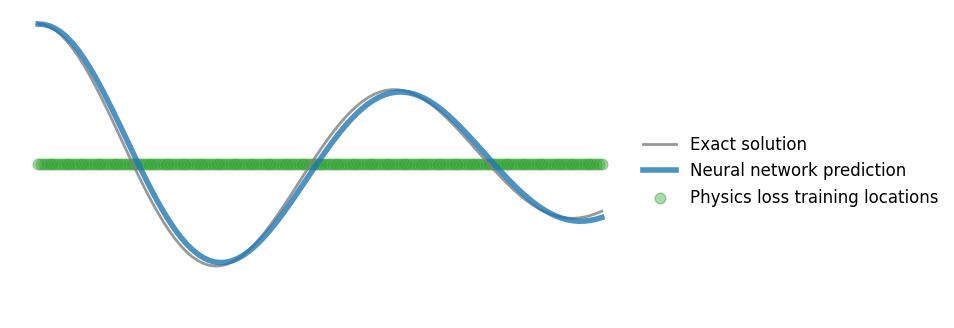

Epochs Progress:  31%|███       | 12495/40000 [02:31<04:32, 101.06it/s]

epoch: 12500, loss: 2.637108087539673


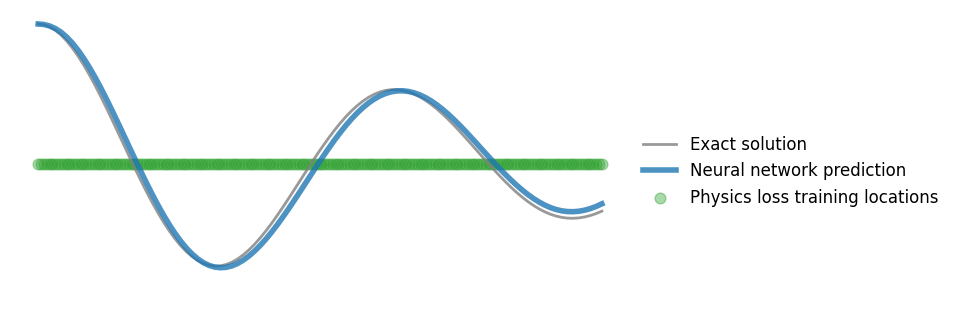

Epochs Progress:  32%|███▏      | 12992/40000 [02:36<05:35, 80.60it/s]

epoch: 13000, loss: 2.177309989929199


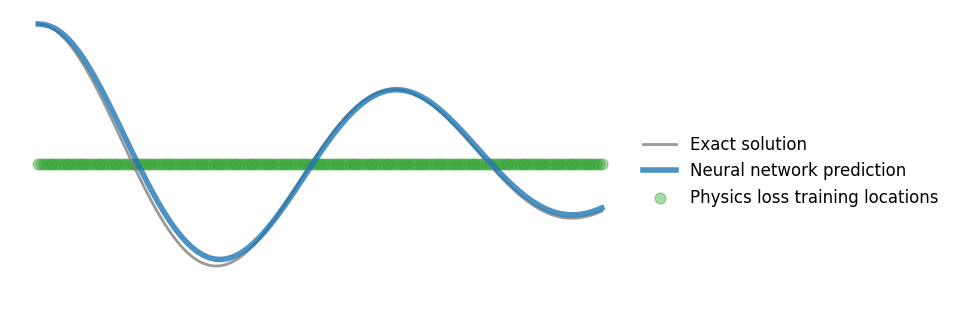

Epochs Progress:  34%|███▍      | 13500/40000 [02:43<04:09, 106.15it/s]

epoch: 13500, loss: 1.7553315162658691


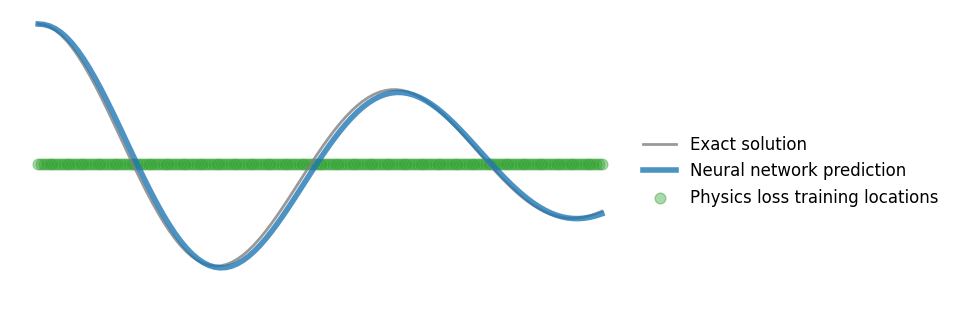

Epochs Progress:  35%|███▌      | 14000/40000 [02:49<04:14, 102.12it/s]

epoch: 14000, loss: 3.917698621749878


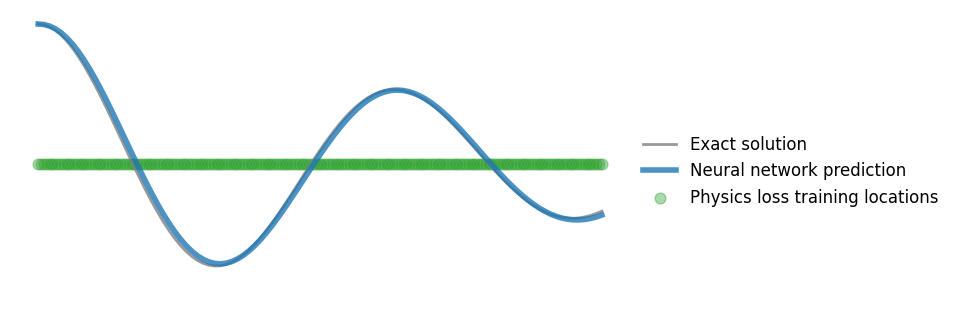

Epochs Progress:  36%|███▋      | 14500/40000 [02:56<04:23, 96.80it/s]

epoch: 14500, loss: 1.8443336486816406


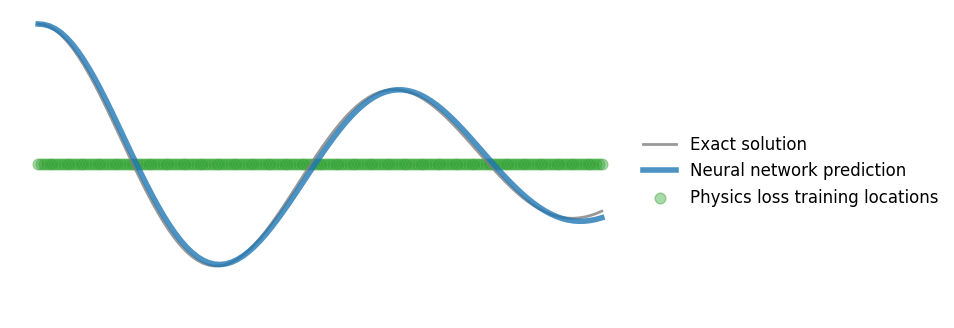

Epochs Progress:  37%|███▋      | 14990/40000 [03:01<04:07, 101.07it/s]

epoch: 15000, loss: 2.8204894065856934


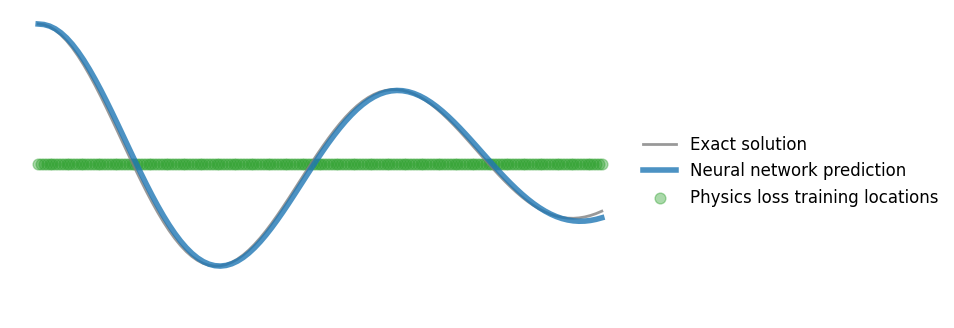

Epochs Progress:  39%|███▊      | 15494/40000 [03:08<05:28, 74.50it/s]

epoch: 15500, loss: 2.6740453243255615


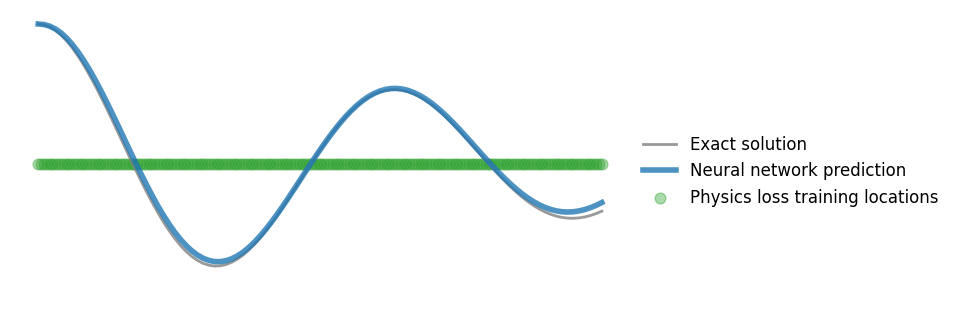

Epochs Progress:  40%|███▉      | 15997/40000 [03:14<03:48, 104.98it/s]

epoch: 16000, loss: 1.6288048028945923


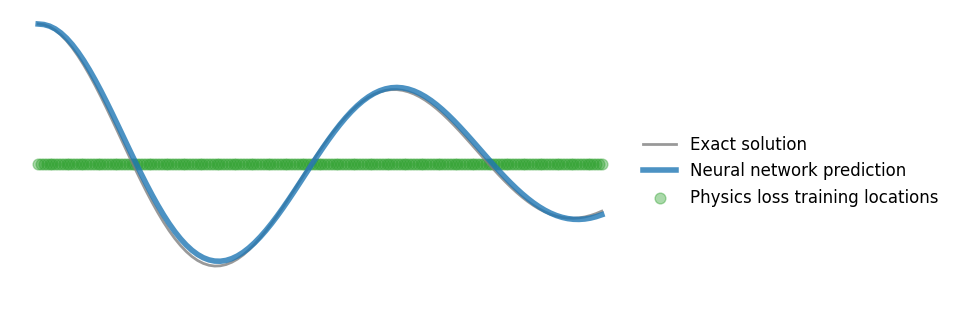

Epochs Progress:  41%|████      | 16497/40000 [03:20<04:32, 86.21it/s] 

epoch: 16500, loss: 1.331588864326477


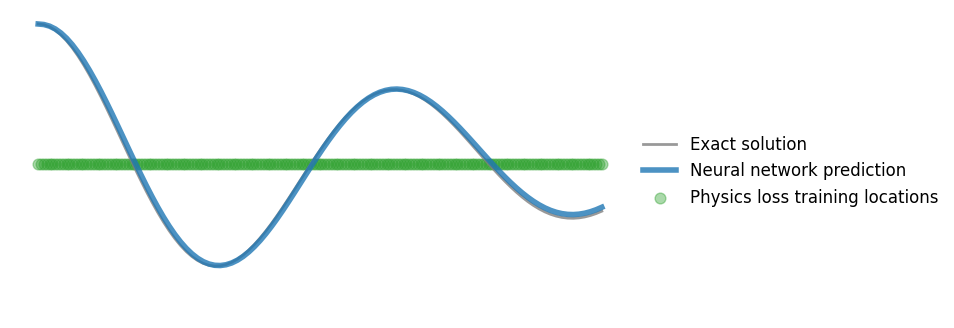

Epochs Progress:  42%|████▏     | 16997/40000 [03:26<03:35, 106.92it/s]

epoch: 17000, loss: 2.009183883666992


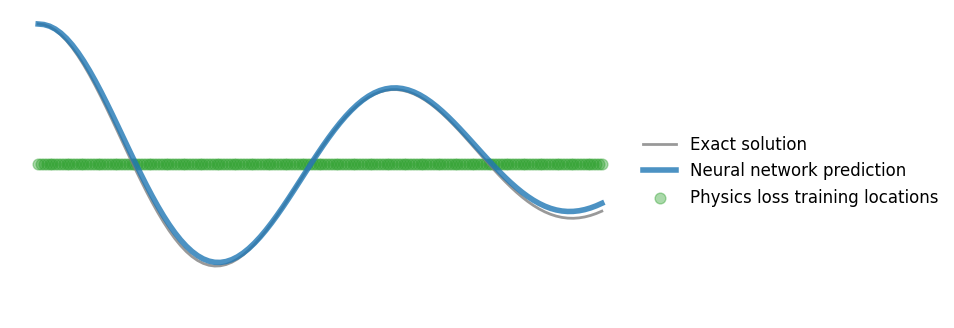

Epochs Progress:  44%|████▎     | 17490/40000 [03:32<03:43, 100.57it/s]

epoch: 17500, loss: 3.8528318405151367


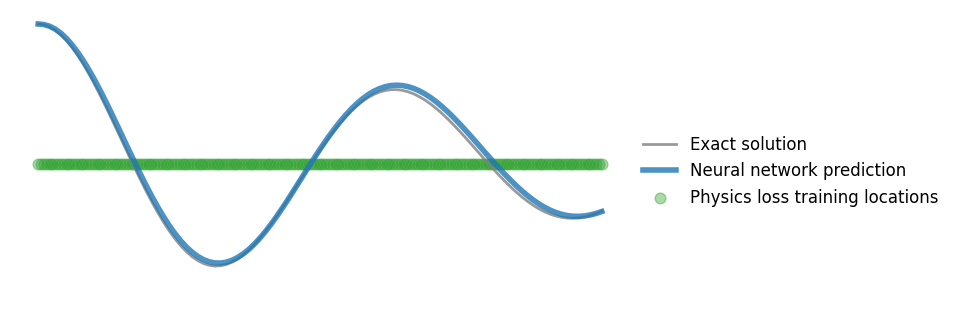

Epochs Progress:  45%|████▍     | 17997/40000 [03:39<04:29, 81.50it/s]

epoch: 18000, loss: 1.439429521560669


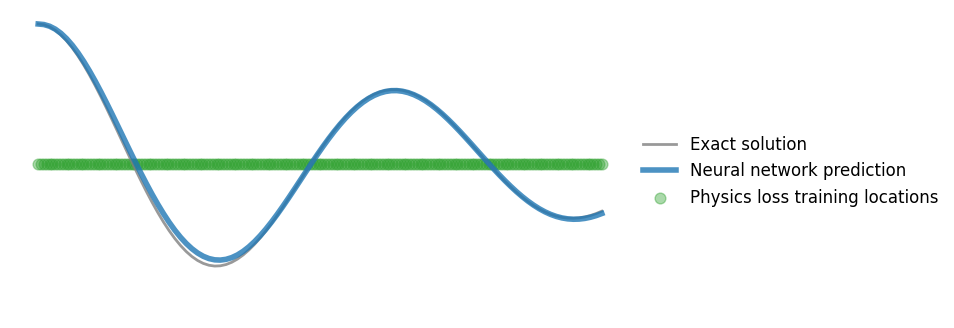

Epochs Progress:  46%|████▌     | 18496/40000 [03:44<03:27, 103.84it/s]

epoch: 18500, loss: 1.227523684501648


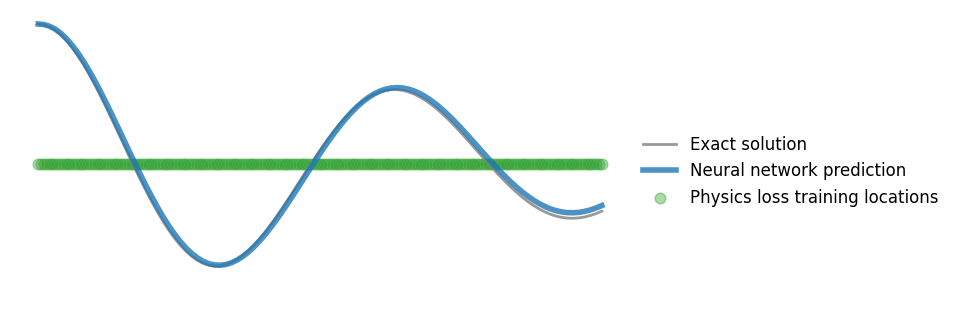

Epochs Progress:  47%|████▋     | 18992/40000 [03:51<04:44, 73.84it/s]

epoch: 19000, loss: 1.2388534545898438


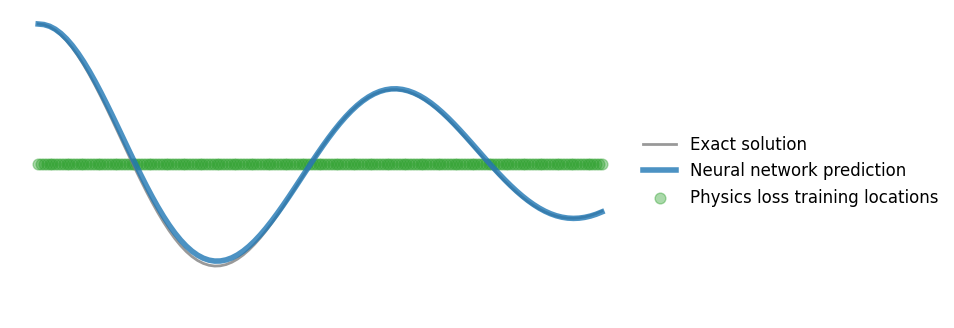

Epochs Progress:  49%|████▊     | 19496/40000 [03:57<03:32, 96.64it/s] 

epoch: 19500, loss: 1.5527533292770386


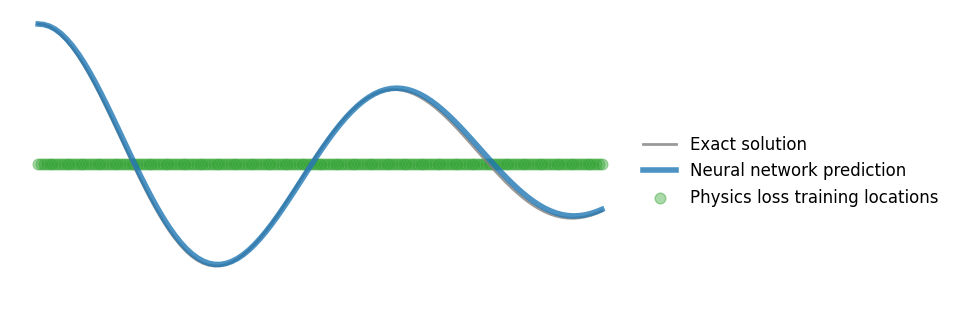

Epochs Progress:  50%|████▉     | 19994/40000 [04:03<03:30, 95.26it/s] 

epoch: 20000, loss: 0.9655318260192871


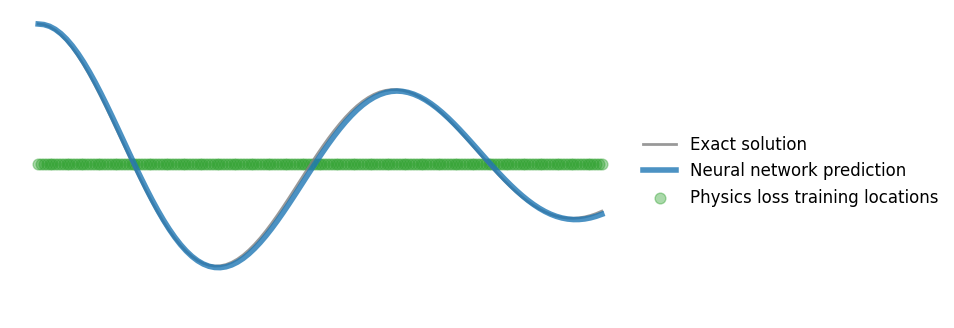

Epochs Progress:  51%|█████     | 20492/40000 [04:10<03:25, 95.01it/s]

epoch: 20500, loss: 1.4380520582199097


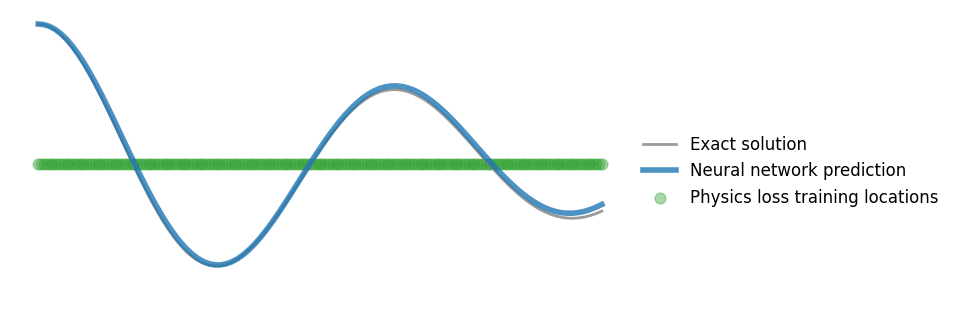

Epochs Progress:  52%|█████▏    | 20996/40000 [04:15<03:07, 101.57it/s]

epoch: 21000, loss: 1.3281772136688232


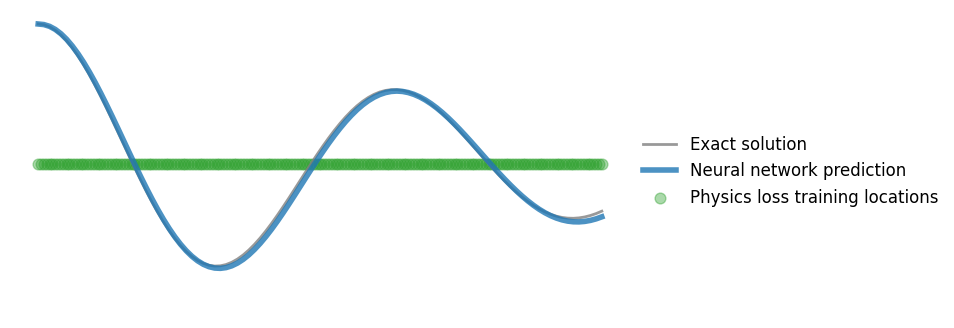

Epochs Progress:  54%|█████▍    | 21500/40000 [04:22<04:09, 74.17it/s]

epoch: 21500, loss: 1.5592741966247559


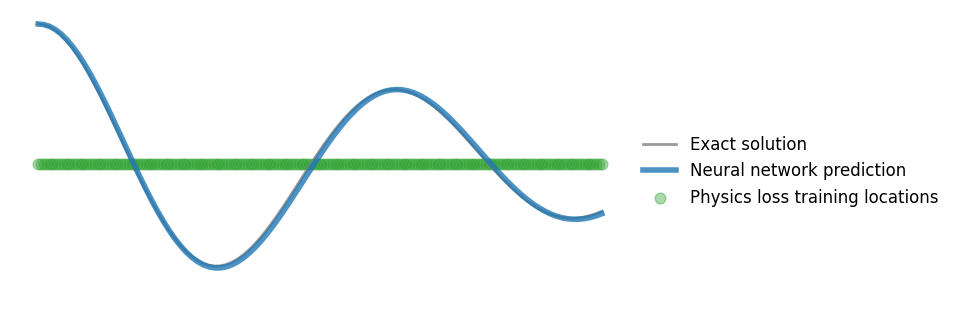

Epochs Progress:  55%|█████▍    | 21996/40000 [04:28<03:03, 98.35it/s]

epoch: 22000, loss: 1.228623390197754


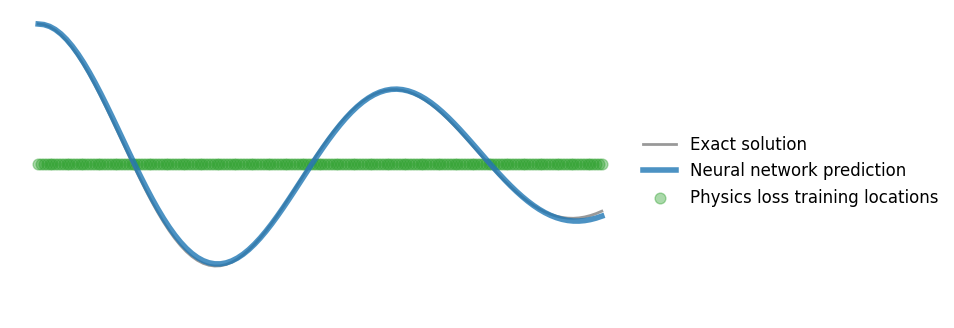

Epochs Progress:  56%|█████▌    | 22493/40000 [04:34<03:57, 73.72it/s]

epoch: 22500, loss: 1.5648868083953857


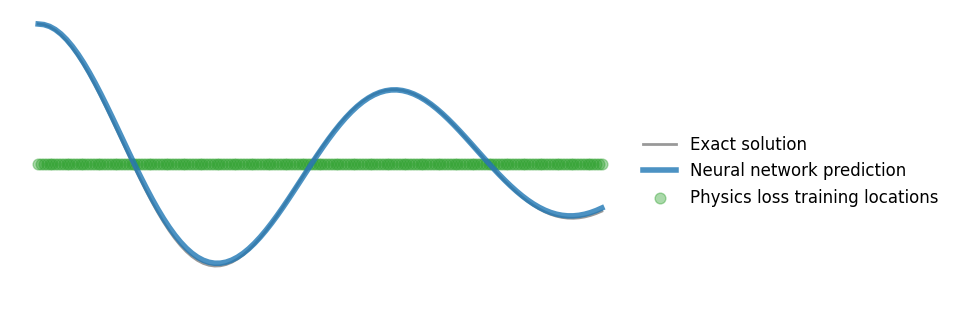

Epochs Progress:  57%|█████▊    | 23000/40000 [04:41<02:48, 101.09it/s]

epoch: 23000, loss: 2.6264681816101074


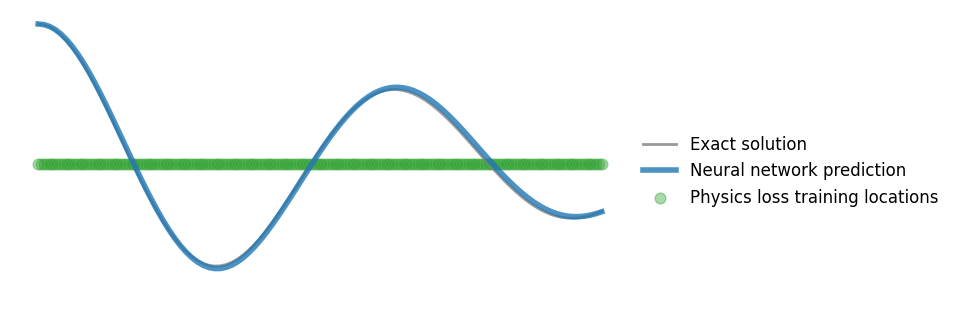

Epochs Progress:  59%|█████▊    | 23494/40000 [04:46<02:41, 102.38it/s]

epoch: 23500, loss: 1.2135437726974487


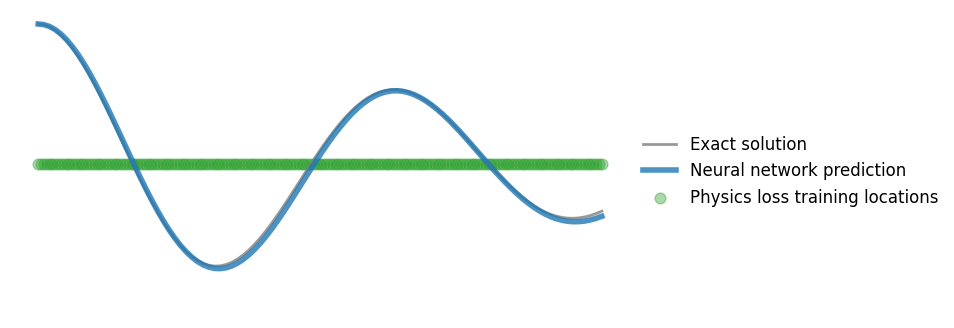

Epochs Progress:  60%|██████    | 24000/40000 [04:54<02:46, 96.36it/s]

epoch: 24000, loss: 1.4246604442596436


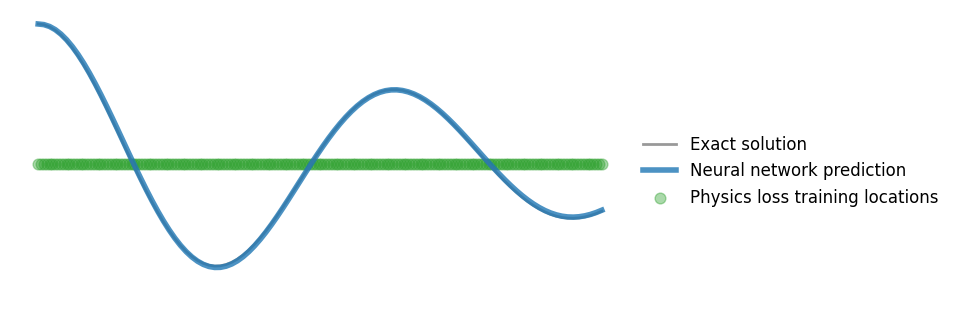

Epochs Progress:  61%|██████    | 24492/40000 [04:59<02:37, 98.24it/s]

epoch: 24500, loss: 1.5318547487258911


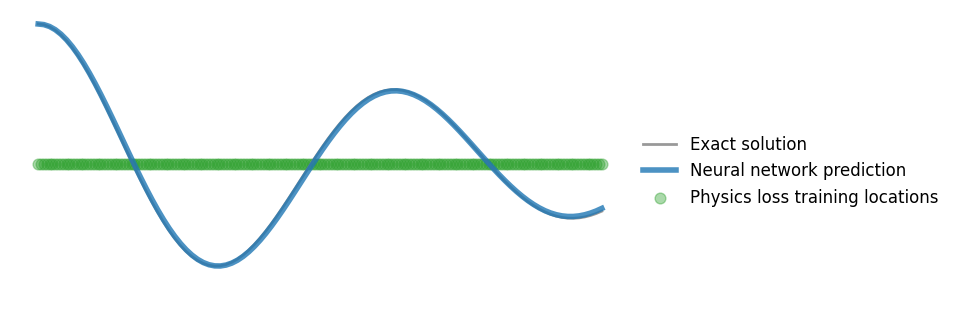

Epochs Progress:  62%|██████▏   | 24997/40000 [05:06<03:22, 74.01it/s]

epoch: 25000, loss: 0.6852418780326843


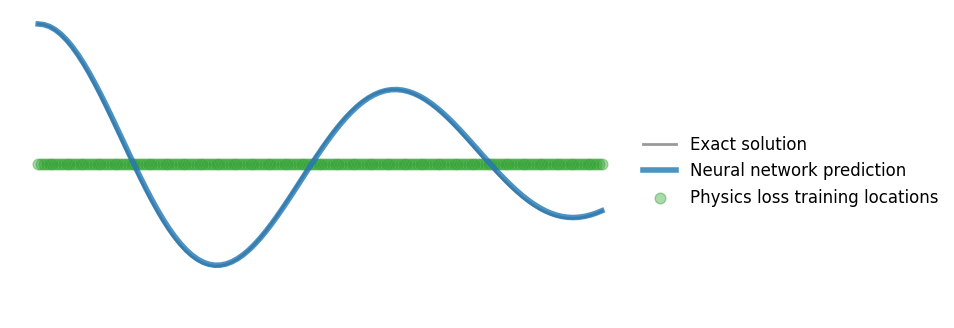

Epochs Progress:  64%|██████▎   | 25491/40000 [05:12<02:21, 102.28it/s]

epoch: 25500, loss: 1.305336356163025


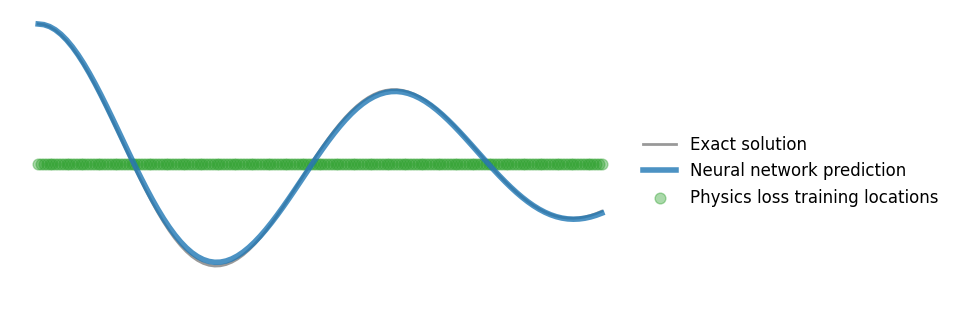

Epochs Progress:  65%|██████▍   | 25994/40000 [05:18<03:07, 74.74it/s]

epoch: 26000, loss: 0.8775646090507507


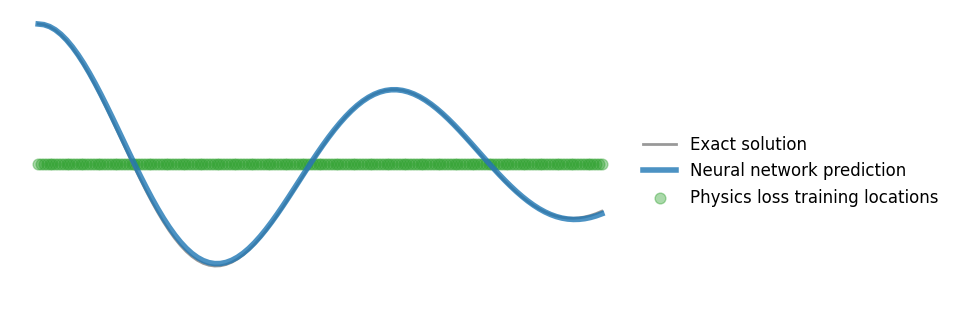

Epochs Progress:  66%|██████▌   | 26491/40000 [05:25<02:14, 100.47it/s]

epoch: 26500, loss: 1.7942882776260376


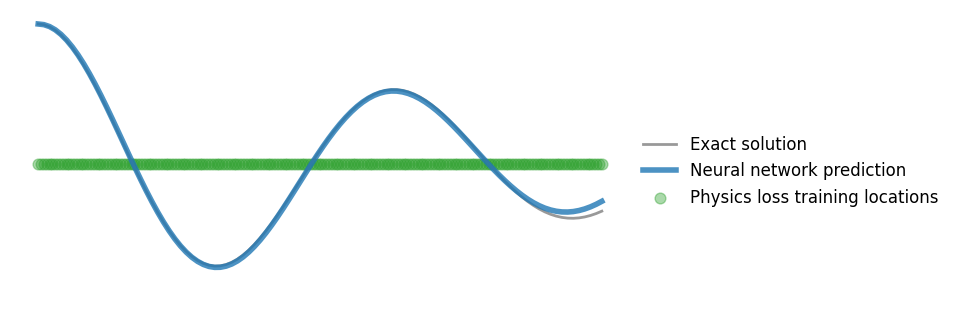

Epochs Progress:  67%|██████▋   | 26998/40000 [05:31<02:06, 102.91it/s]

epoch: 27000, loss: 1.2619850635528564


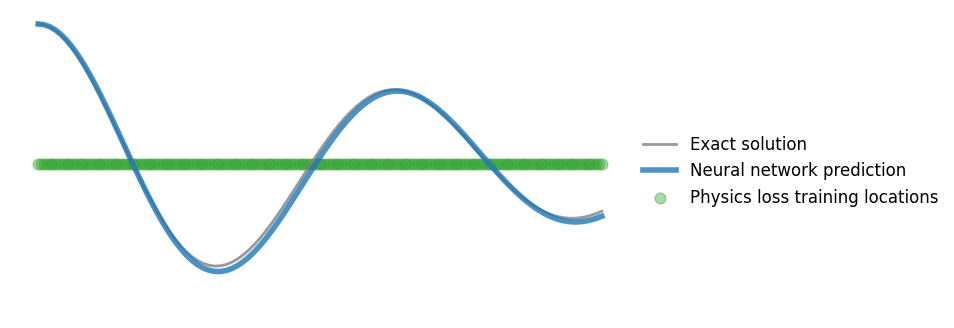

Epochs Progress:  69%|██████▊   | 27494/40000 [05:38<02:22, 87.52it/s]

epoch: 27500, loss: 1.8316736221313477


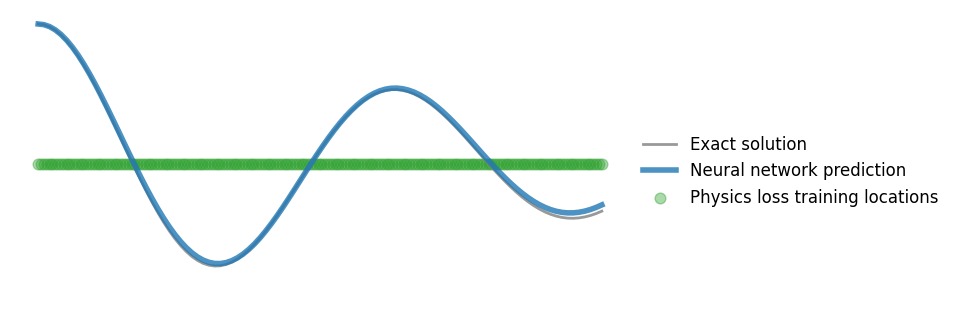

Epochs Progress:  70%|██████▉   | 27992/40000 [05:44<02:02, 98.11it/s]

epoch: 28000, loss: 1.266740322113037


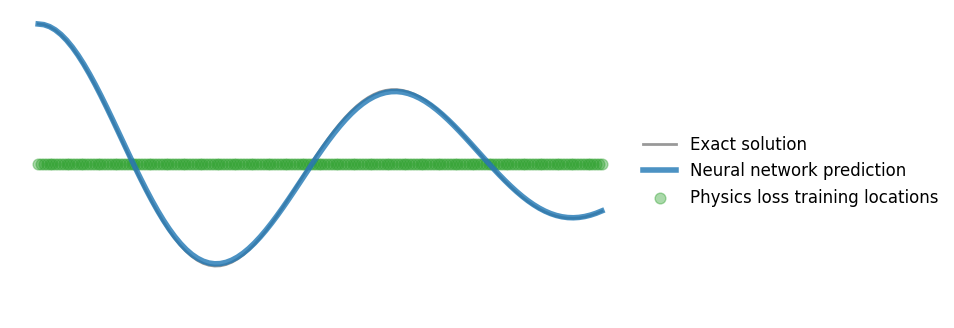

Epochs Progress:  71%|███████   | 28497/40000 [05:51<02:43, 70.30it/s]

epoch: 28500, loss: 1.1836313009262085


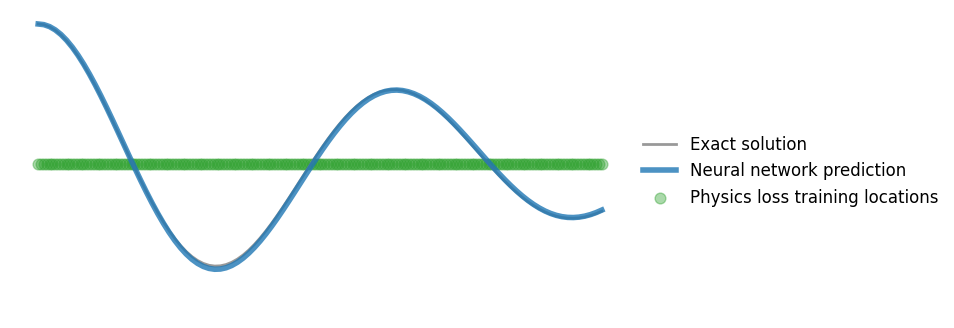

Epochs Progress:  72%|███████▏  | 28994/40000 [05:57<01:53, 97.10it/s]

epoch: 29000, loss: 1.8139922618865967


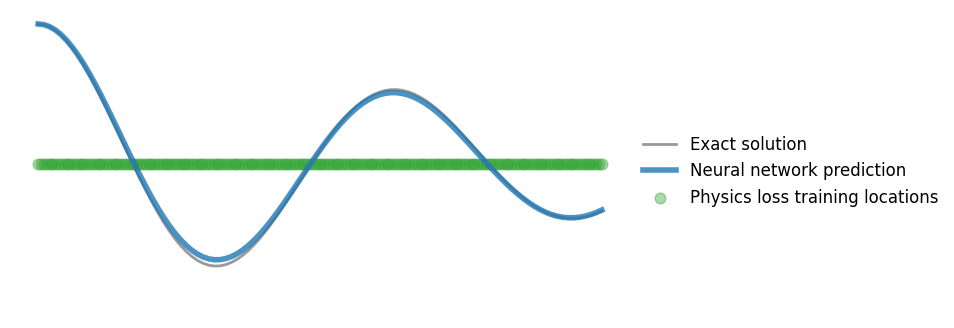

Epochs Progress:  74%|███████▎  | 29495/40000 [06:04<02:27, 71.41it/s]

epoch: 29500, loss: 0.6141304969787598


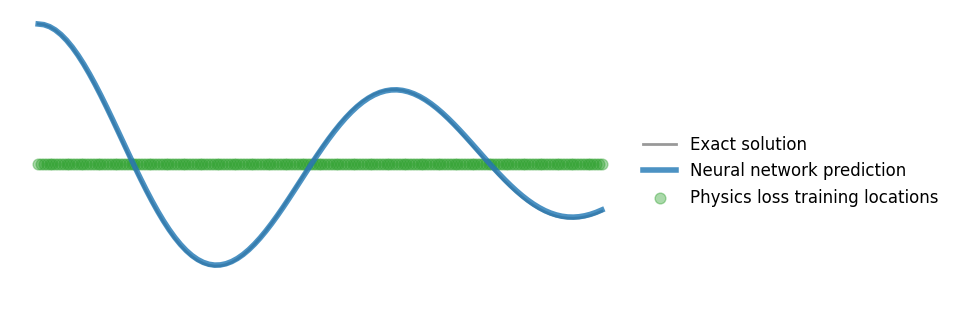

Epochs Progress:  75%|███████▍  | 29992/40000 [06:11<01:39, 101.06it/s]

epoch: 30000, loss: 1.2494620084762573


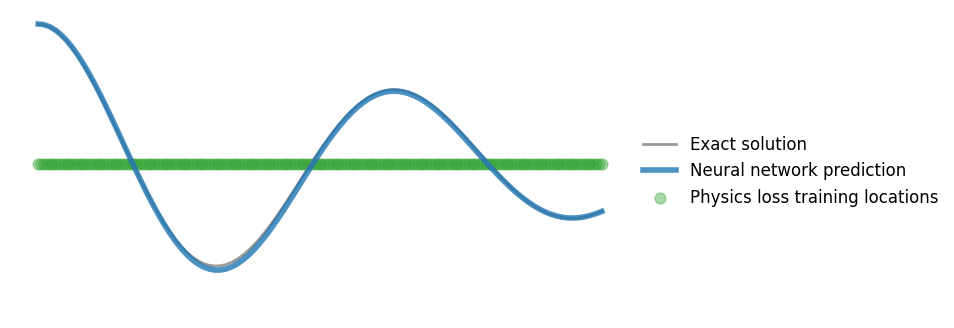

Epochs Progress:  76%|███████▌  | 30498/40000 [06:16<01:35, 99.35it/s]

epoch: 30500, loss: 2.1999571323394775


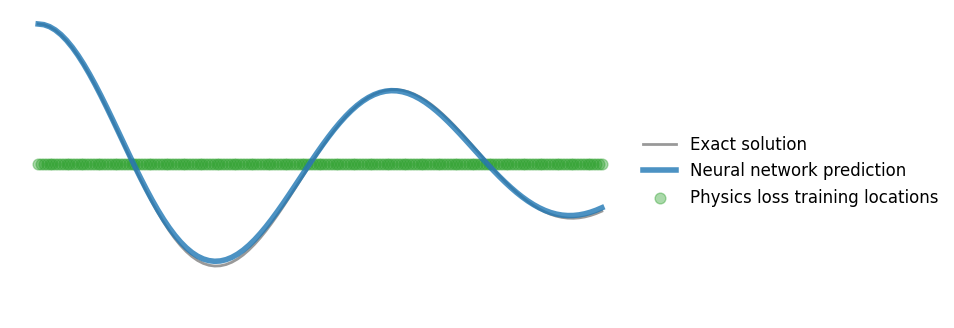

Epochs Progress:  77%|███████▋  | 30993/40000 [06:24<01:35, 94.02it/s]

epoch: 31000, loss: 0.5166195034980774


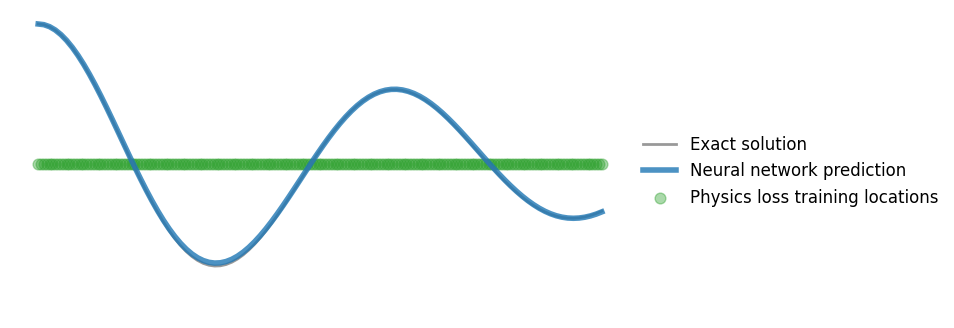

Epochs Progress:  79%|███████▊  | 31497/40000 [06:30<01:35, 88.64it/s]

epoch: 31500, loss: 1.4984240531921387


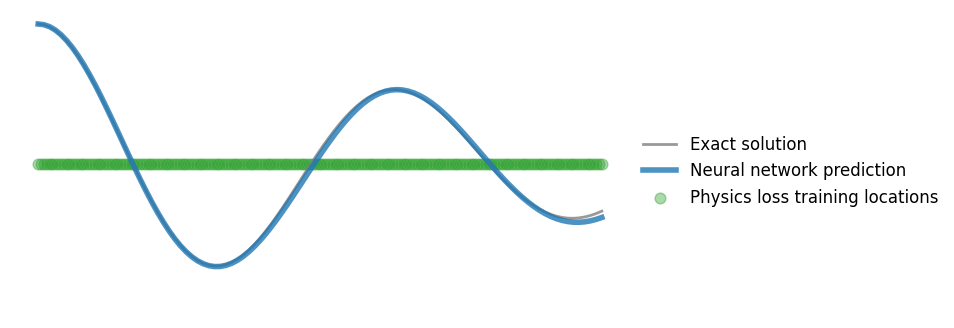

Epochs Progress:  80%|████████  | 32000/40000 [06:37<01:43, 77.41it/s]

epoch: 32000, loss: 0.7046086192131042


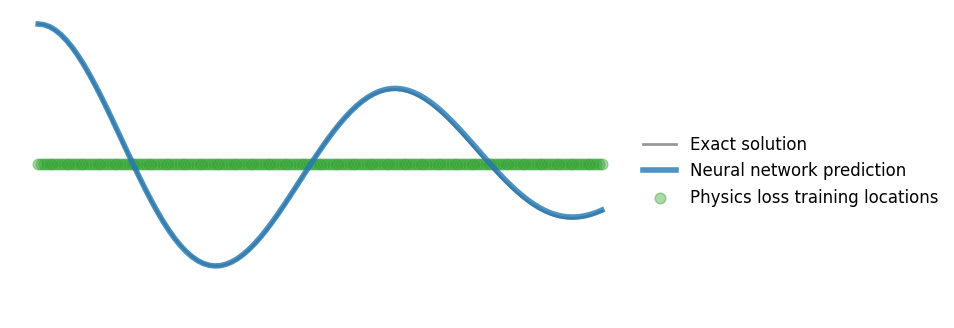

Epochs Progress:  81%|████████  | 32498/40000 [06:43<01:15, 99.44it/s]

epoch: 32500, loss: 1.1020362377166748


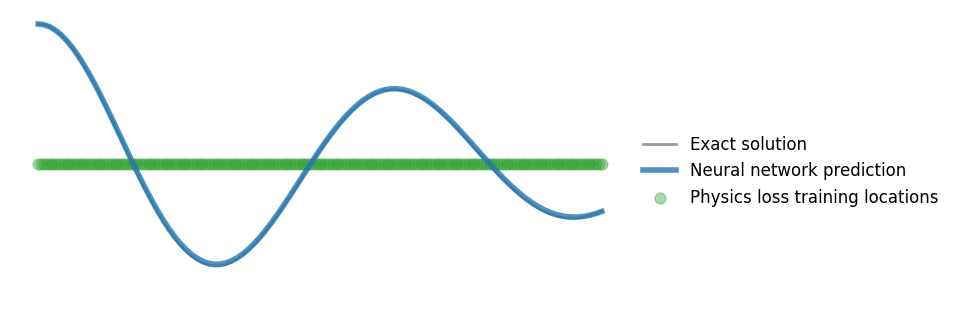

Epochs Progress:  82%|████████▏ | 32997/40000 [06:49<01:30, 77.34it/s]

epoch: 33000, loss: 1.5800387859344482


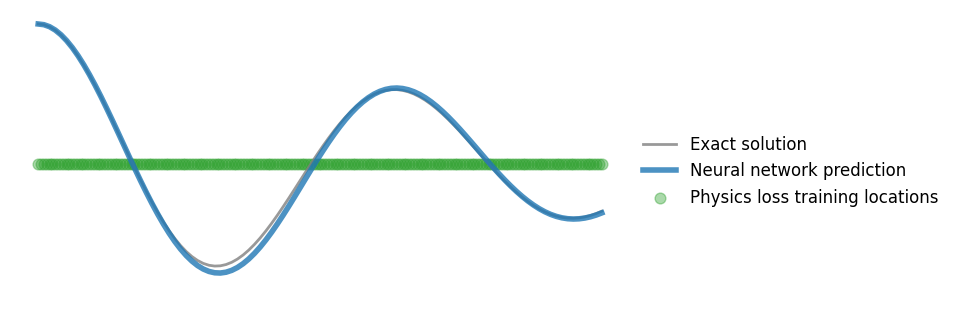

Epochs Progress:  84%|████████▎ | 33492/40000 [06:56<01:08, 95.56it/s]

epoch: 33500, loss: 1.1841518878936768


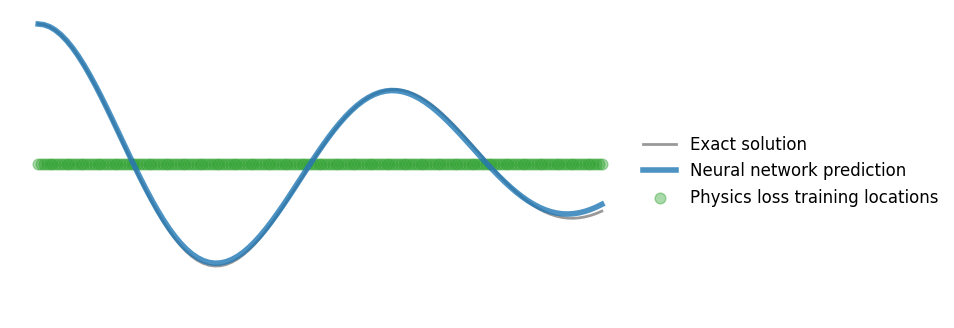

Epochs Progress:  85%|████████▍ | 33994/40000 [07:02<01:03, 94.64it/s]

epoch: 34000, loss: 1.0528745651245117


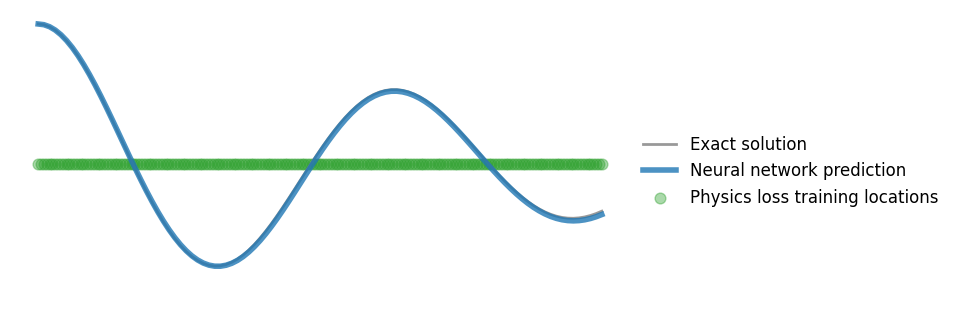

Epochs Progress:  86%|████████▌ | 34495/40000 [07:10<01:26, 63.29it/s]

epoch: 34500, loss: 1.0739017724990845


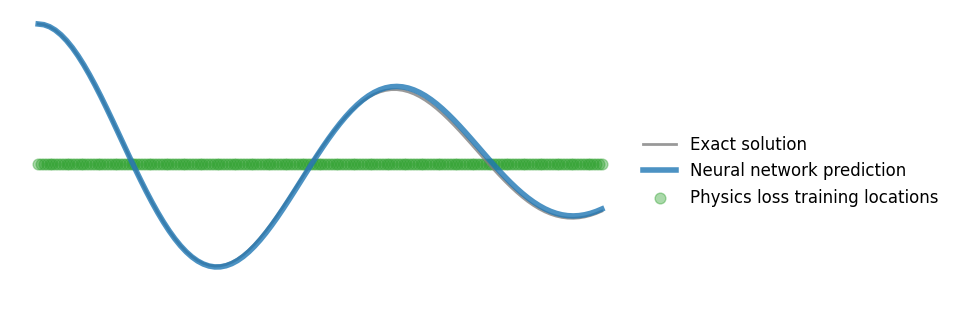

Epochs Progress:  87%|████████▋ | 34990/40000 [07:16<00:52, 95.41it/s]

epoch: 35000, loss: 0.5531671047210693


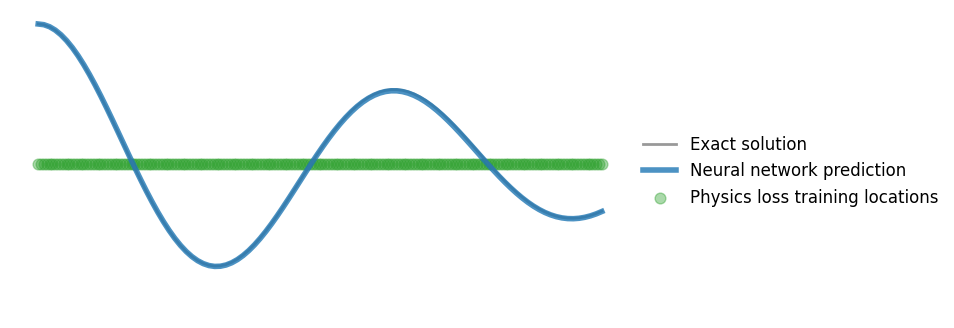

Epochs Progress:  89%|████████▊ | 35495/40000 [07:22<01:02, 72.40it/s]

epoch: 35500, loss: 1.3200058937072754


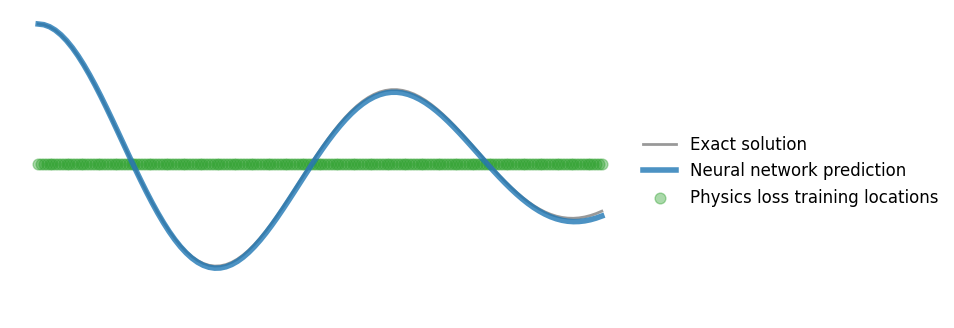

Epochs Progress:  90%|████████▉ | 35991/40000 [07:29<00:42, 95.10it/s]

epoch: 36000, loss: 0.6703338027000427


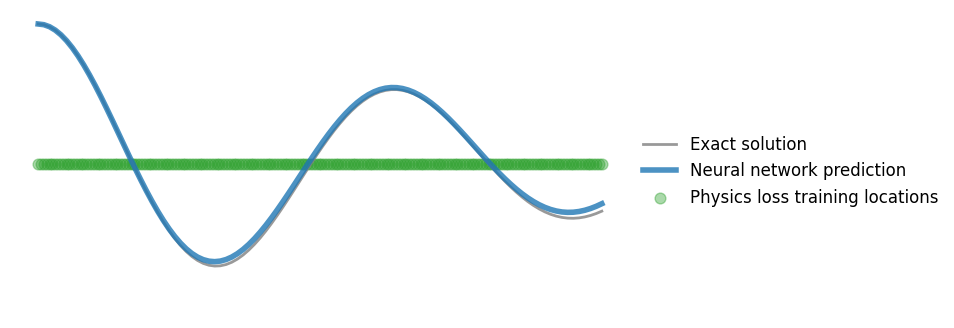

Epochs Progress:  91%|█████████ | 36498/40000 [07:35<00:36, 96.20it/s]

epoch: 36500, loss: 1.8189787864685059


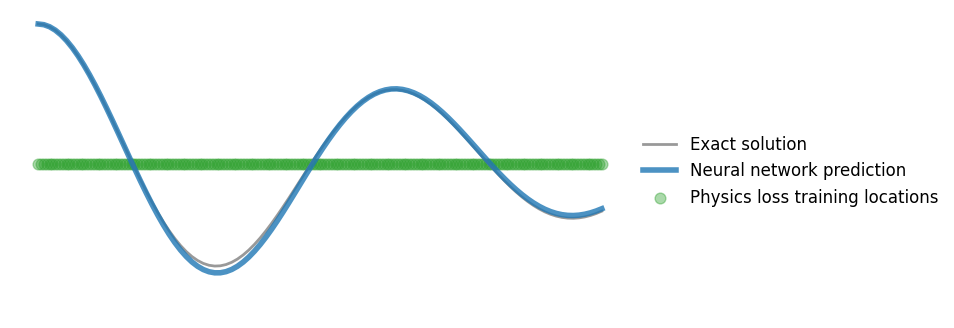

Epochs Progress:  92%|█████████▎| 37000/40000 [07:43<00:31, 94.51it/s]

epoch: 37000, loss: 0.7496761083602905


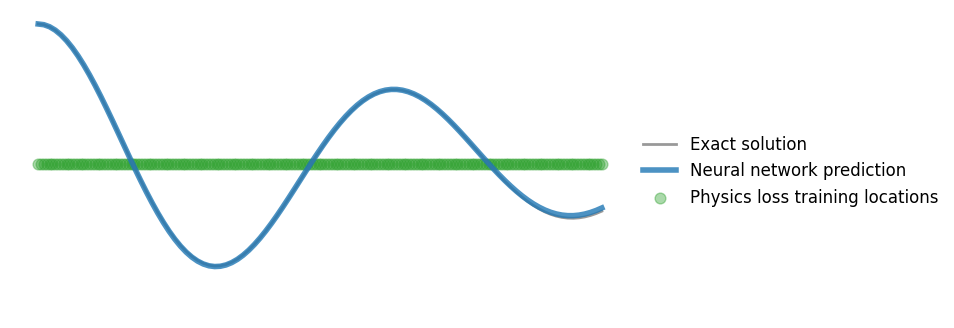

Epochs Progress:  94%|█████████▎| 37497/40000 [07:49<00:26, 95.53it/s]

epoch: 37500, loss: 1.0858032703399658


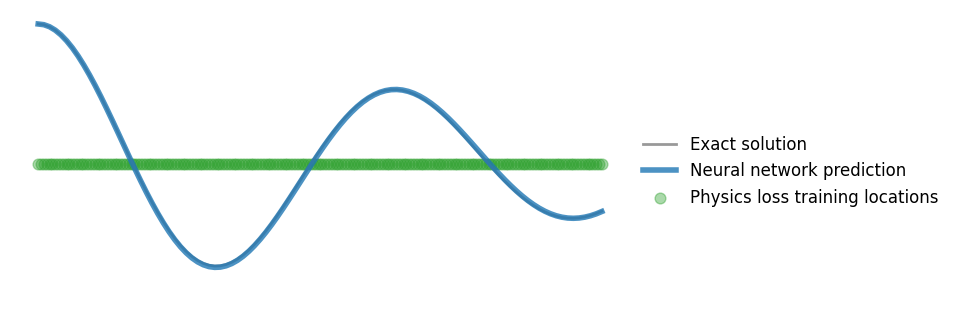

Epochs Progress:  95%|█████████▍| 37999/40000 [07:57<00:32, 61.83it/s]

epoch: 38000, loss: 2.44291353225708


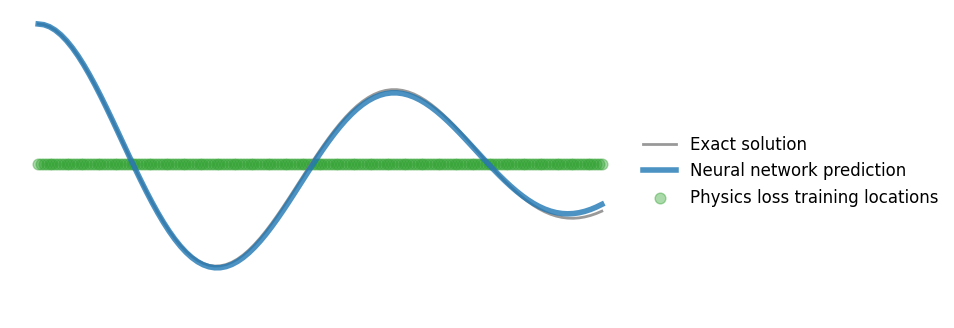

Epochs Progress:  96%|█████████▌| 38493/40000 [08:03<00:16, 91.44it/s]

epoch: 38500, loss: 1.3226618766784668


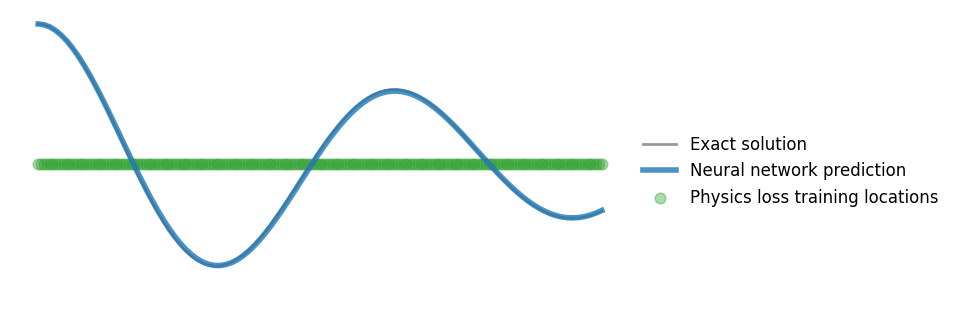

Epochs Progress:  98%|█████████▊| 39000/40000 [08:10<00:14, 67.91it/s]

epoch: 39000, loss: 0.7042576670646667


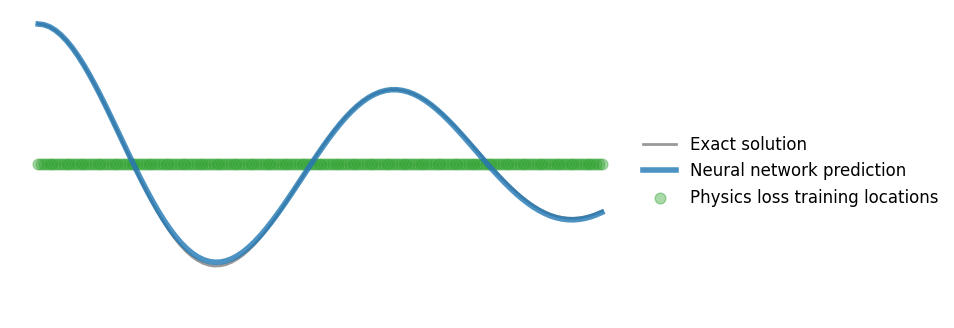

Epochs Progress:  99%|█████████▊| 39493/40000 [08:17<00:05, 97.70it/s]

epoch: 39500, loss: 0.8791100978851318


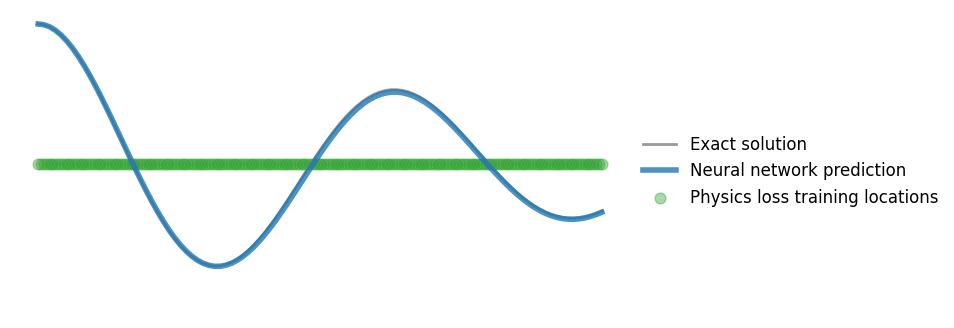

Epochs Progress: 100%|██████████| 40000/40000 [08:24<00:00, 79.35it/s]


In [ ]:
only_physics_train(harmonic_optimizer_expert_2, harmonic_expert_2, harmonic_loss, harmonic_trial_solution, epochs = 40000, display_step=500,domain_lb=0, domain_ub=1, num_points=200,  plot_points=100, x = display_x ,y = display_y, gif_n="harmonic_expert_2")

In [ ]:
harmonic_expert_2_points_50 = MixtureOfExperts(N_EXPERT = 2)
harmonic_optimizer_expert_2_points_50 = optim.Adam(harmonic_expert_2_points_50.parameters(), lr = lr)
schduler = optim.lr_scheduler.CosineAnnealingLR(harmonic_optimizer_expert_2_points_50, T_max=80000)

In [ ]:
only_physics_train(harmonic_optimizer_expert_2_points_50, harmonic_expert_2_points_50, harmonic_loss, harmonic_trial_solution, epochs = 40000, display_step=500,domain_lb=0, domain_ub=1, num_points=50,  plot_points=100, x = display_x ,y = display_y, gif_n="harmonic_expert_2_points_50")

In [ ]:
harmonic_expert_2_points_100 = MixtureOfExperts(N_EXPERT = 2)
harmonic_optimizer_expert_2_points_100 = optim.Adam(harmonic_expert_2_points_100.parameters(), lr = lr)
schduler = optim.lr_scheduler.CosineAnnealingLR(harmonic_optimizer_expert_2_points_100, T_max=80000)

In [ ]:
only_physics_train(harmonic_optimizer_expert_2_points_100, harmonic_expert_2_points_100, harmonic_loss, harmonic_trial_solution, epochs = 40000, display_step=500,domain_lb=0, domain_ub=1, num_points=100,  plot_points=100, x = display_x ,y = display_y, gif_n="harmonic_expert_2_points_100")

## Soft Plus Activation Function

The SoftPlus activation function is a smooth approximation of the ReLU (Rectified Linear Unit) activation function. It is defined to be continuously differentiable, which can be advantageous in neural network models, especially when smooth gradients are preferred. Unlike the ReLU, which has a sharp nonlinearity at zero, the SoftPlus function gradually transitions from zero to positive values, making it more suited for applications that benefit from smooth gradients.

The equation for the SoftPlus activation function is:

$$
f(x) = \ln(1 + e^x)
$$

where \( x \) is the input to the function.

### Properties of SoftPlus

1. **Range**: The output of the SoftPlus function is always positive, with values ranging from \( 0 \) to \( + $\infty$ \).
2. **Smoothness**: SoftPlus is continuously differentiable, making it more suitable for gradient-based optimization.
3. **Approximation to ReLU**: As \( x $\to$ + $\infty$ \), the SoftPlus function approaches \( x \), similar to the behavior of ReLU. However, as \( x $\to$ -$\infty$ \), SoftPlus approaches 0.

### Derivative of SoftPlus

The derivative of the SoftPlus function, which is useful for backpropagation in neural networks, is given by:

$$
f'(x) = \frac{1}{1 + e^{-x}} = \sigma(x)
$$

where $ \sigma(x)$ is the Sigmoid function. This shows that the gradient of SoftPlus is directly related to the Sigmoid function, further enhancing its smoothness in the learning process.


In [ ]:
harmonic_model_4 = MixtureOfExperts(N_EXPERT = 1, N_LAYERS = 5, act = nn.Softplus)
harmonic_optimizer_4 = optim.Adam(harmonic_model_4.parameters(), lr = lr)

Epochs Progress:   0%|          | 0/40000 [00:00<?, ?it/s]

epoch: 0, loss: 80.01488494873047


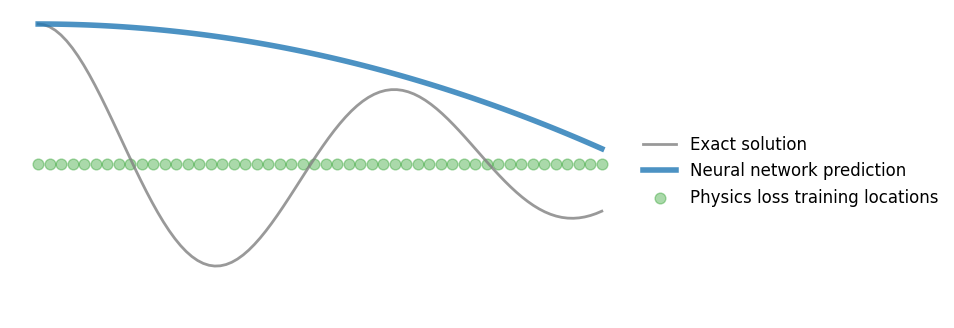

Epochs Progress:   1%|▏         | 500/40000 [00:14<14:26, 45.57it/s]

epoch: 500, loss: 7.426331043243408


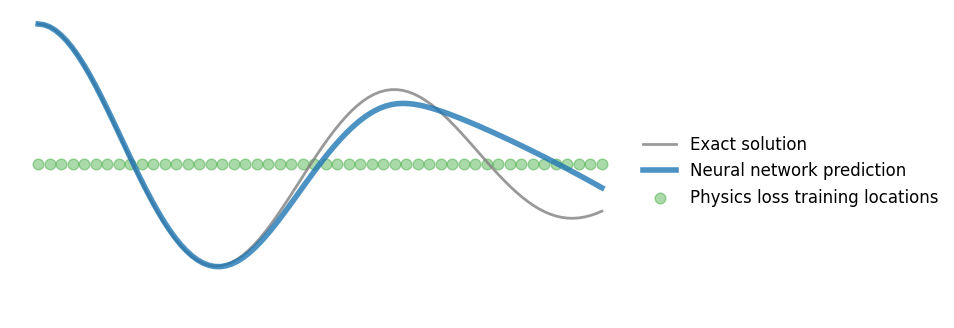

Epochs Progress:   2%|▏         | 991/40000 [00:28<16:23, 39.68it/s]

epoch: 1000, loss: 1.5244985818862915


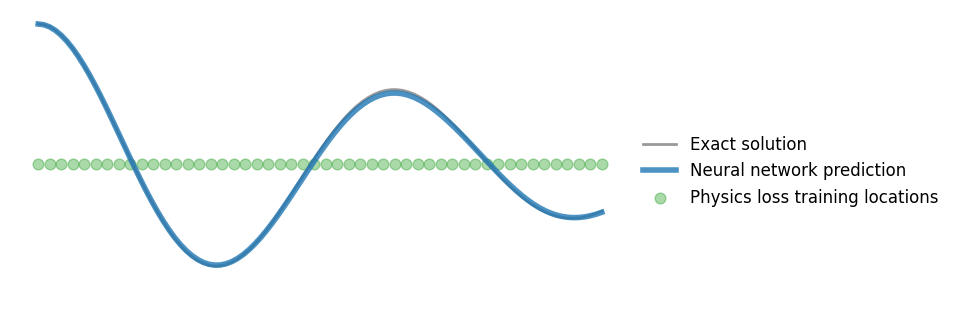

Epochs Progress:   4%|▎         | 1499/40000 [00:43<14:10, 45.29it/s]

epoch: 1500, loss: 4.037981033325195


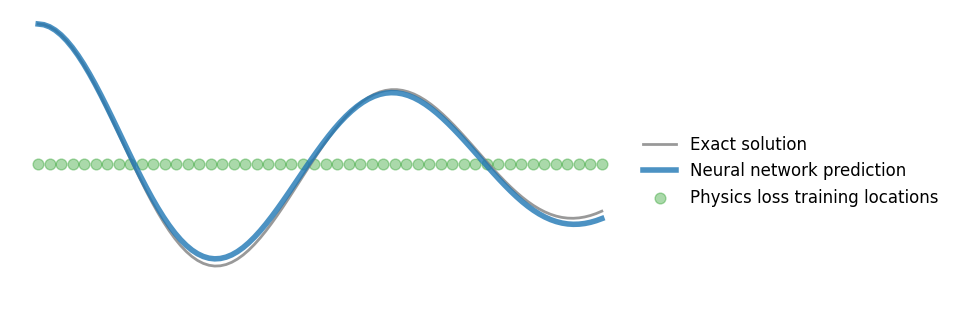

Epochs Progress:   5%|▍         | 1991/40000 [00:58<16:51, 37.57it/s]

epoch: 2000, loss: 1.098230004310608


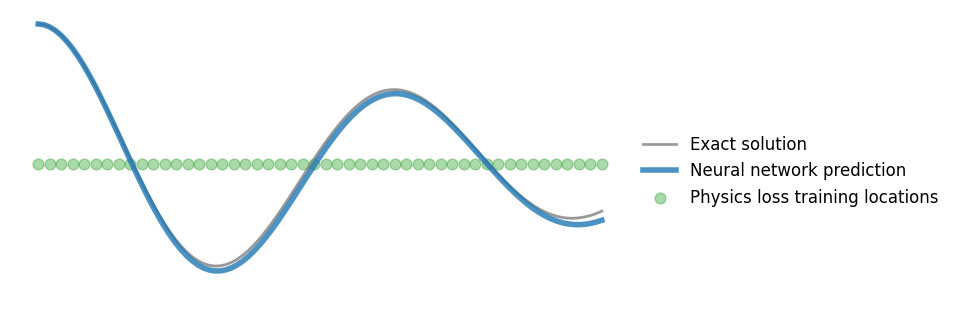

Epochs Progress:   6%|▌         | 2491/40000 [01:13<17:03, 36.67it/s]

epoch: 2500, loss: 1.9171375036239624


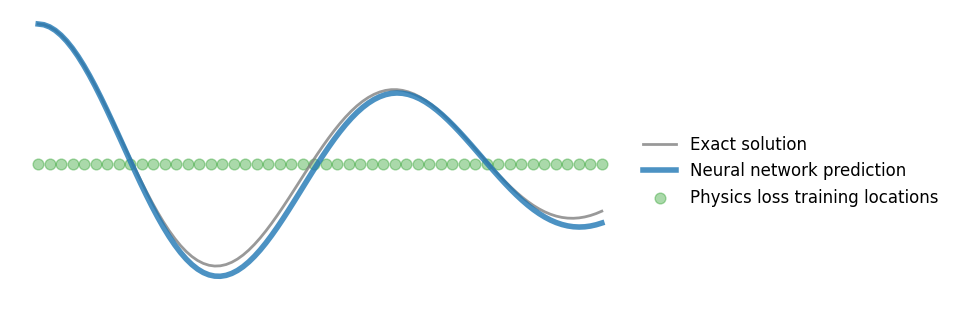

Epochs Progress:   7%|▋         | 2996/40000 [01:28<18:38, 33.09it/s]

epoch: 3000, loss: 1.4565194845199585


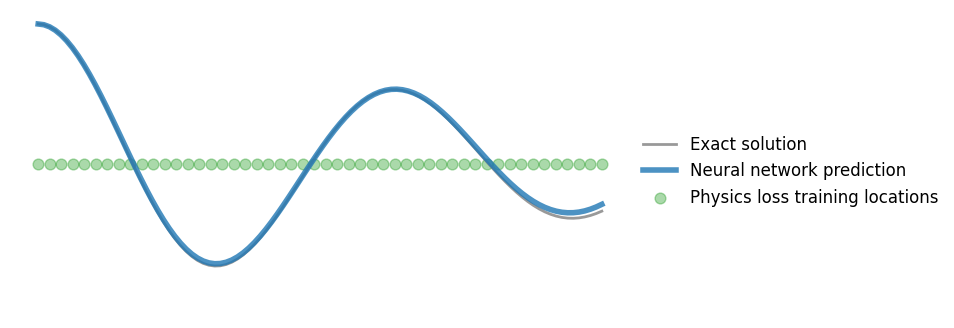

Epochs Progress:   9%|▊         | 3499/40000 [01:44<18:54, 32.18it/s]

epoch: 3500, loss: 1.85638427734375


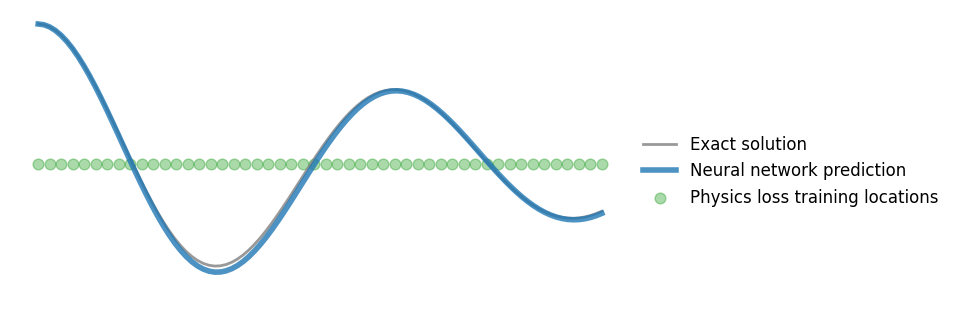

Epochs Progress:  10%|▉         | 3999/40000 [01:59<19:29, 30.78it/s]

epoch: 4000, loss: 1.3189151287078857


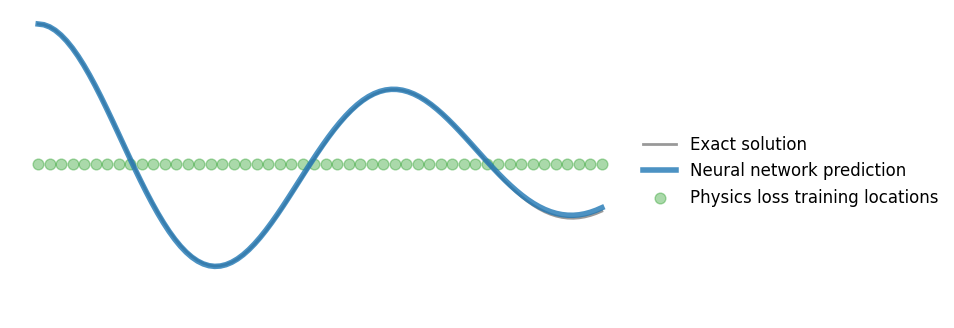

Epochs Progress:  11%|█         | 4495/40000 [02:16<24:10, 24.47it/s]

epoch: 4500, loss: 0.7263261675834656


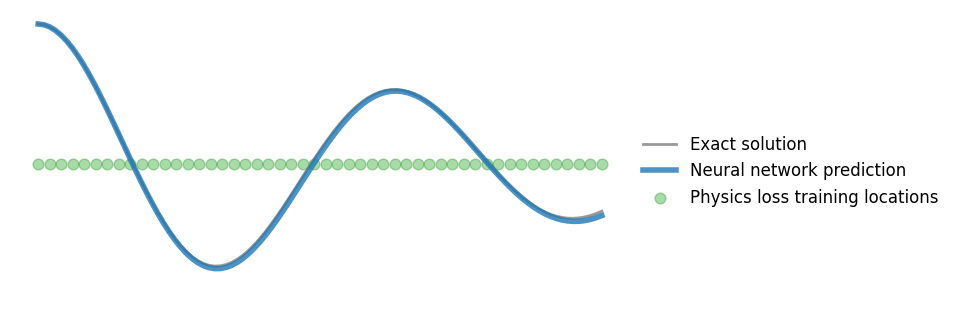

Epochs Progress:  12%|█▏        | 4997/40000 [02:30<20:48, 28.04it/s]

epoch: 5000, loss: 2.0506343841552734


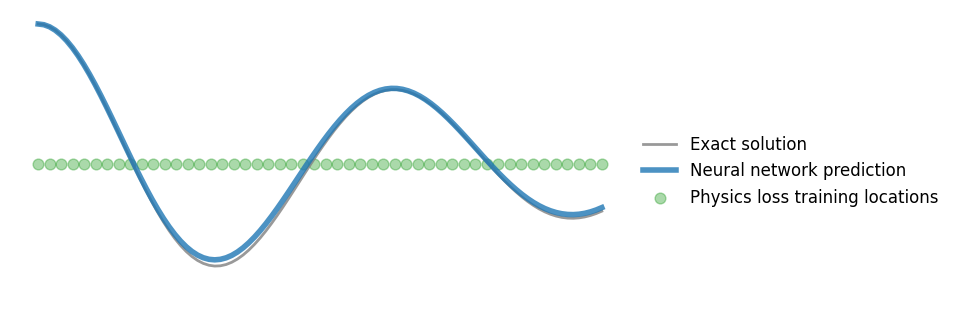

Epochs Progress:  14%|█▎        | 5494/40000 [02:45<24:02, 23.92it/s]

epoch: 5500, loss: 2.553148031234741


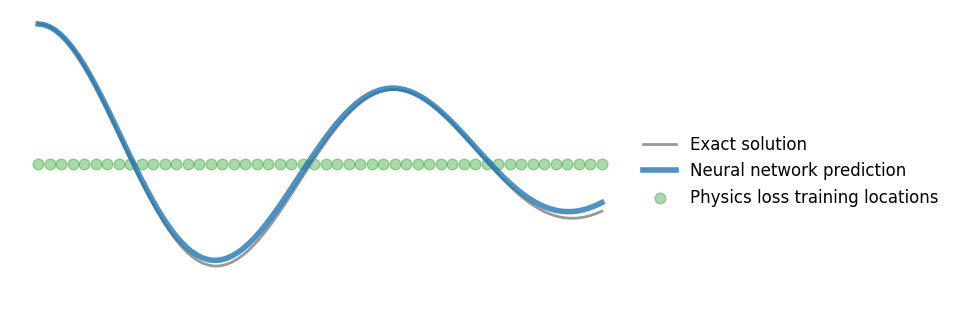

Epochs Progress:  15%|█▍        | 5991/40000 [02:59<21:15, 26.67it/s]

epoch: 6000, loss: 2.027045249938965


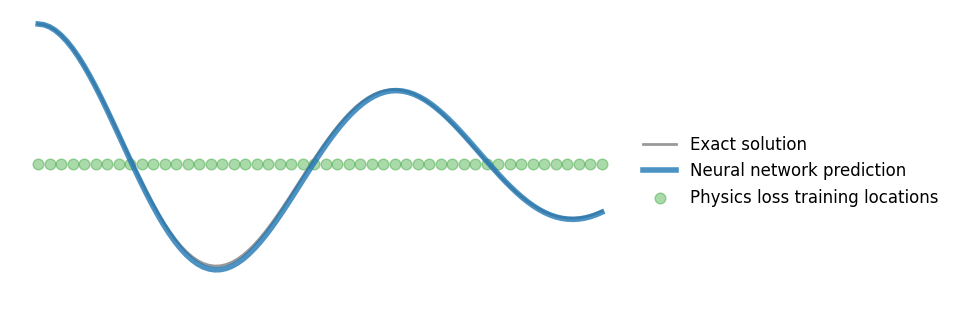

Epochs Progress:  16%|█▌        | 6491/40000 [03:14<17:32, 31.83it/s]

epoch: 6500, loss: 3.0696794986724854


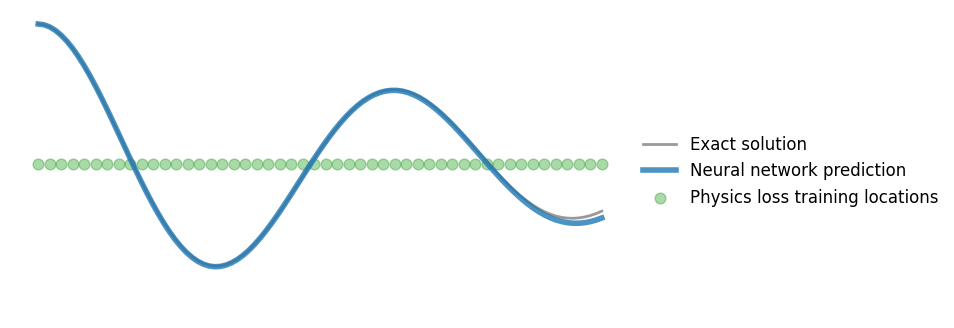

Epochs Progress:  17%|█▋        | 6991/40000 [03:29<14:40, 37.47it/s]

epoch: 7000, loss: 1.1232906579971313


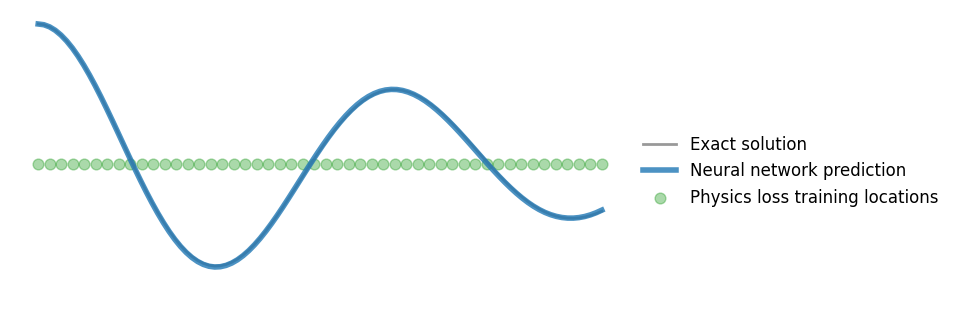

Epochs Progress:  19%|█▊        | 7491/40000 [03:44<15:02, 36.03it/s]

epoch: 7500, loss: 1.6480499505996704


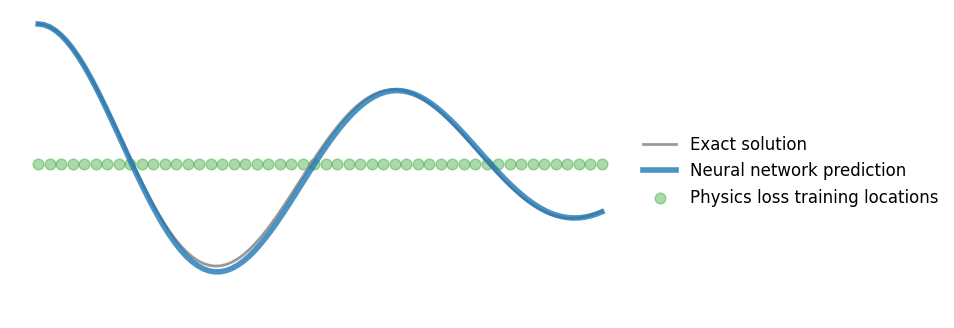

Epochs Progress:  20%|█▉        | 7996/40000 [03:59<13:41, 38.95it/s]

epoch: 8000, loss: 1.099361538887024


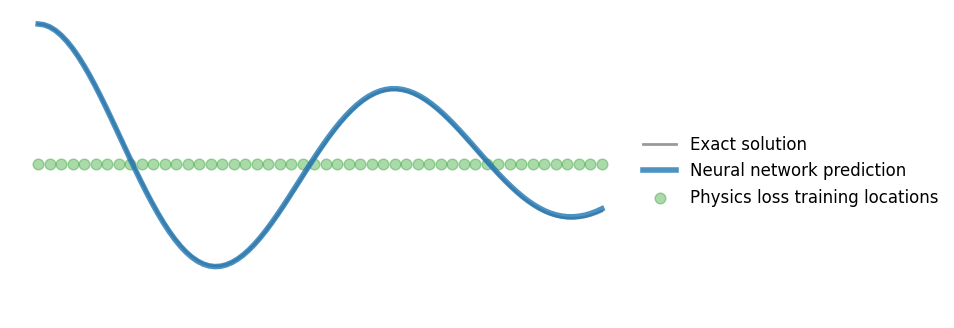

Epochs Progress:  21%|██        | 8491/40000 [04:13<14:52, 35.32it/s]

epoch: 8500, loss: 1.5226390361785889


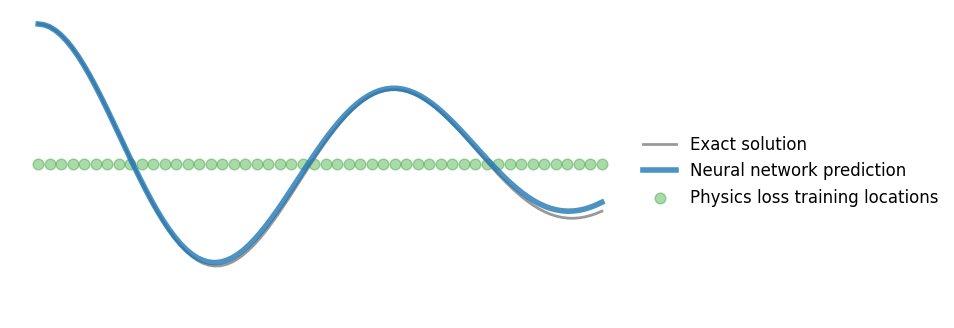

Epochs Progress:  22%|██▏       | 8991/40000 [04:28<13:12, 39.13it/s]

epoch: 9000, loss: 1.9556602239608765


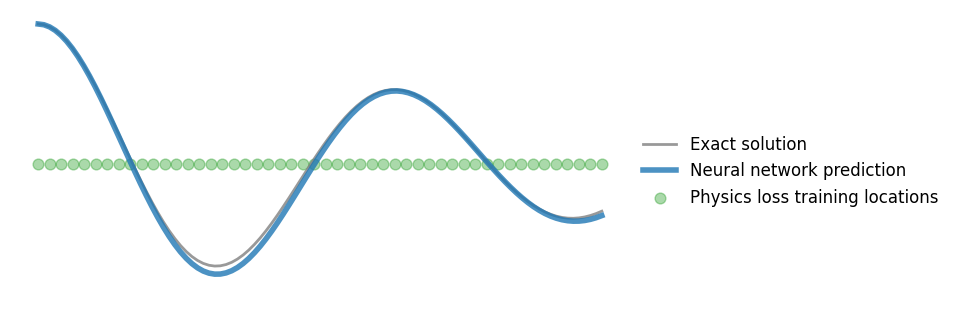

Epochs Progress:  24%|██▍       | 9500/40000 [04:43<11:07, 45.71it/s]

epoch: 9500, loss: 1.4244260787963867


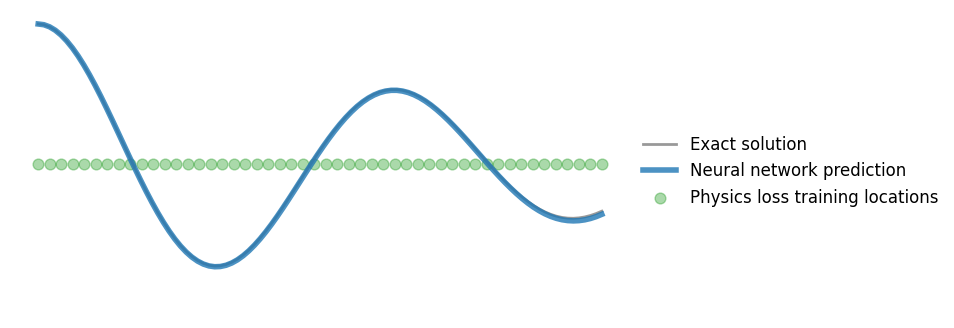

Epochs Progress:  25%|██▌       | 10000/40000 [04:58<10:58, 45.58it/s]

epoch: 10000, loss: 2.134488582611084


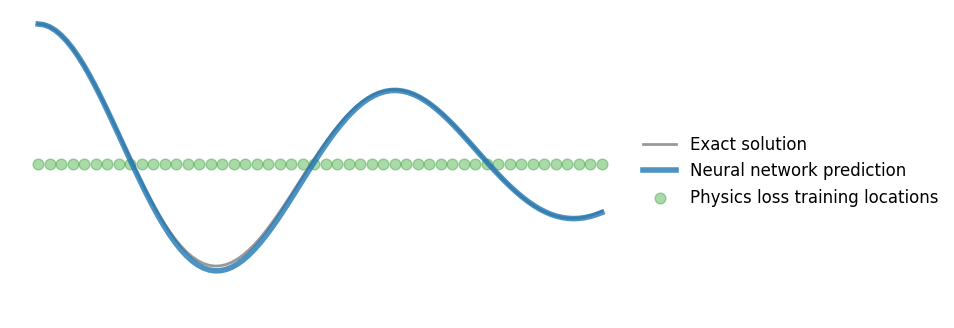

Epochs Progress:  26%|██▌       | 10496/40000 [05:13<12:16, 40.09it/s]

epoch: 10500, loss: 2.1320557594299316


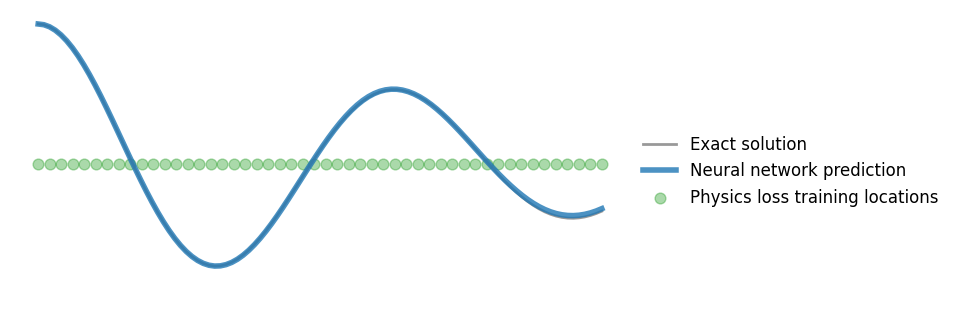

Epochs Progress:  27%|██▋       | 10991/40000 [05:28<13:26, 35.98it/s]

epoch: 11000, loss: 0.7264719605445862


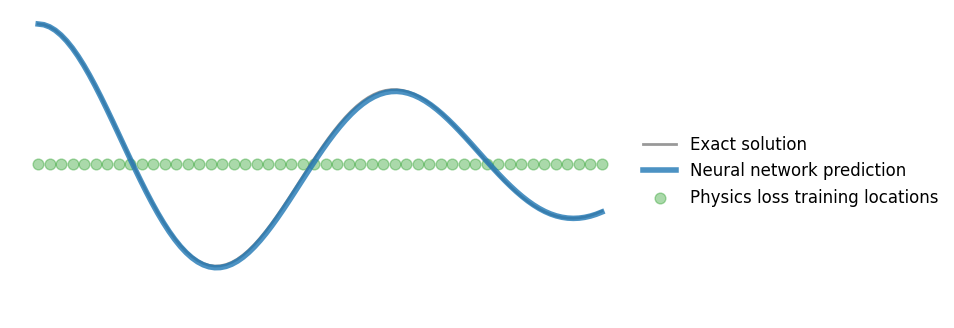

Epochs Progress:  29%|██▊       | 11491/40000 [05:42<12:53, 36.85it/s]

epoch: 11500, loss: 1.651163935661316


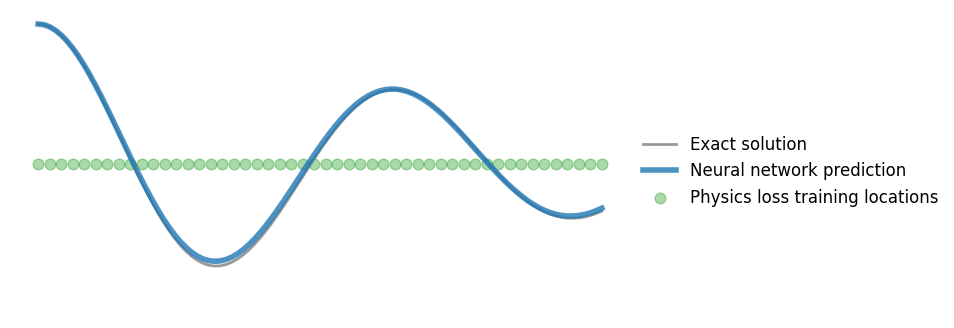

Epochs Progress:  30%|██▉       | 11991/40000 [05:57<12:45, 36.57it/s]

epoch: 12000, loss: 0.8811044096946716


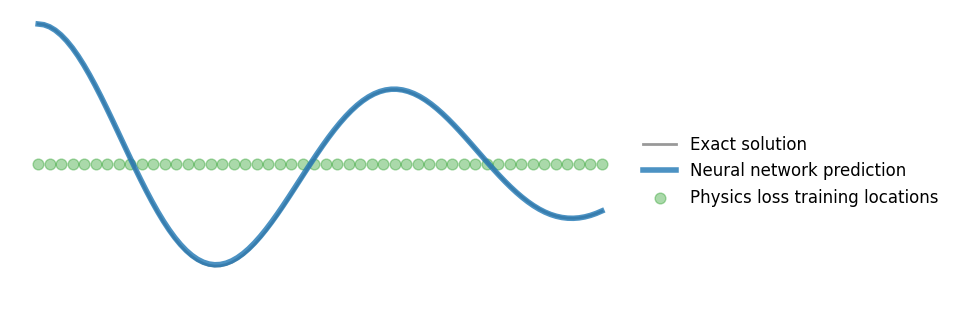

Epochs Progress:  31%|███       | 12491/40000 [06:12<12:08, 37.74it/s]

epoch: 12500, loss: 0.502556324005127


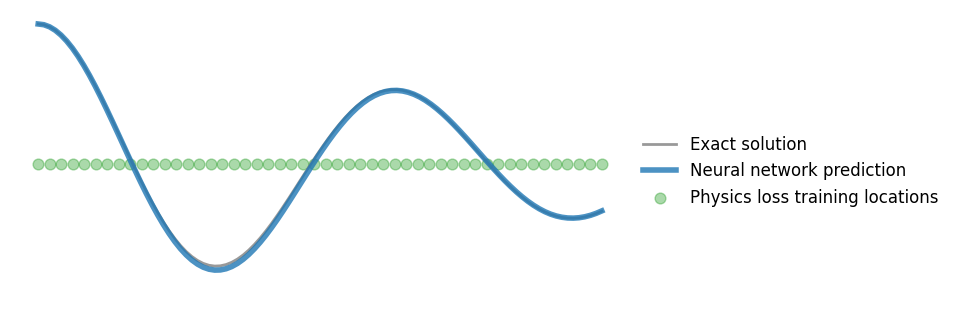

Epochs Progress:  32%|███▎      | 13000/40000 [06:27<10:02, 44.79it/s]

epoch: 13000, loss: 1.067705512046814


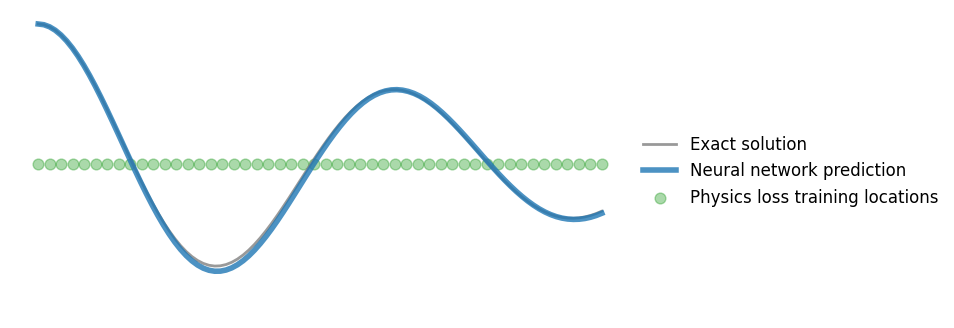

Epochs Progress:  34%|███▎      | 13491/40000 [06:42<11:14, 39.29it/s]

epoch: 13500, loss: 2.642630100250244


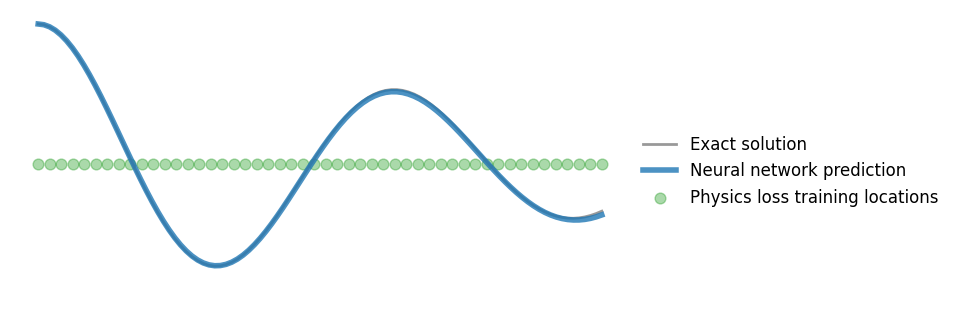

Epochs Progress:  35%|███▍      | 13991/40000 [06:57<12:43, 34.05it/s]

epoch: 14000, loss: 0.7696266770362854


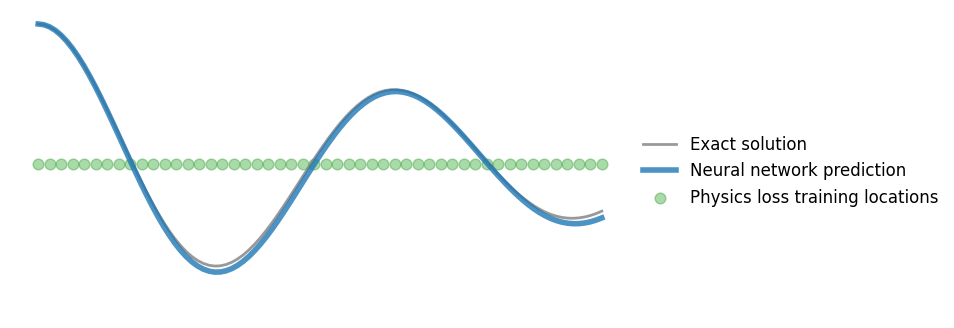

Epochs Progress:  36%|███▌      | 14491/40000 [07:12<12:09, 34.97it/s]

epoch: 14500, loss: 0.6972375512123108


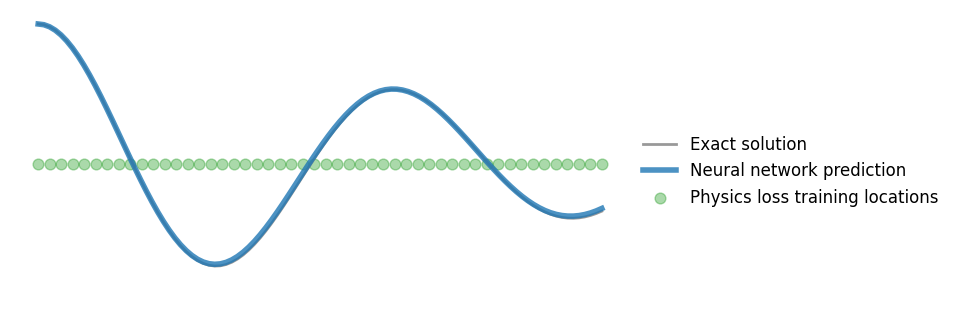

Epochs Progress:  37%|███▋      | 14996/40000 [07:27<11:01, 37.81it/s]

epoch: 15000, loss: 1.9317846298217773


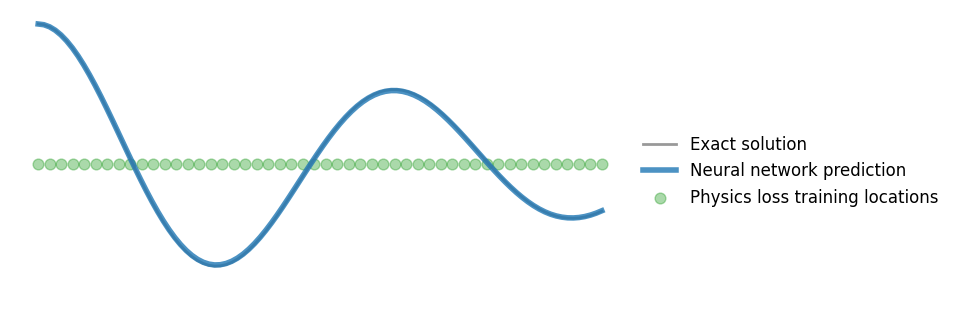

Epochs Progress:  39%|███▊      | 15496/40000 [07:42<10:21, 39.41it/s]

epoch: 15500, loss: 1.6500741243362427


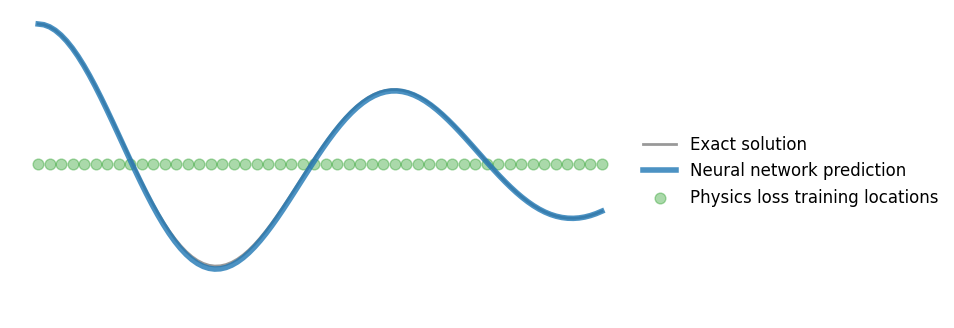

Epochs Progress:  40%|████      | 16000/40000 [07:58<09:02, 44.28it/s]

epoch: 16000, loss: 0.4466874301433563


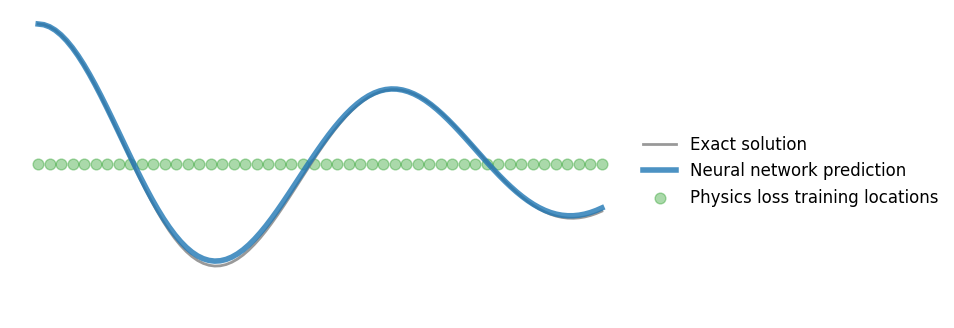

Epochs Progress:  41%|████      | 16499/40000 [08:18<13:30, 29.01it/s]

epoch: 16500, loss: 2.2482101917266846


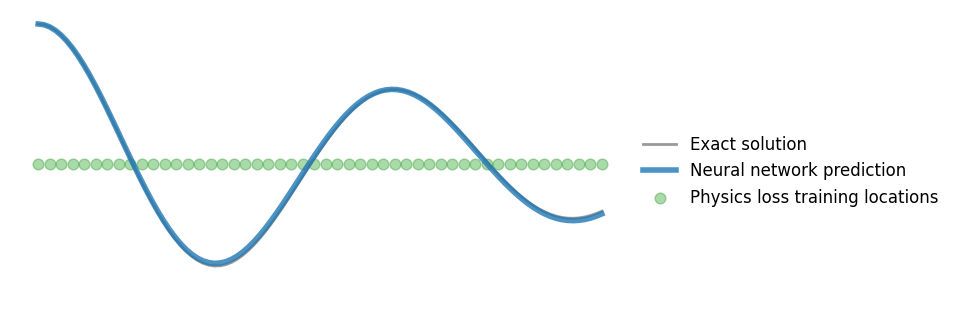

Epochs Progress:  42%|████▏     | 16996/40000 [08:40<15:28, 24.77it/s]

epoch: 17000, loss: 2.0665764808654785


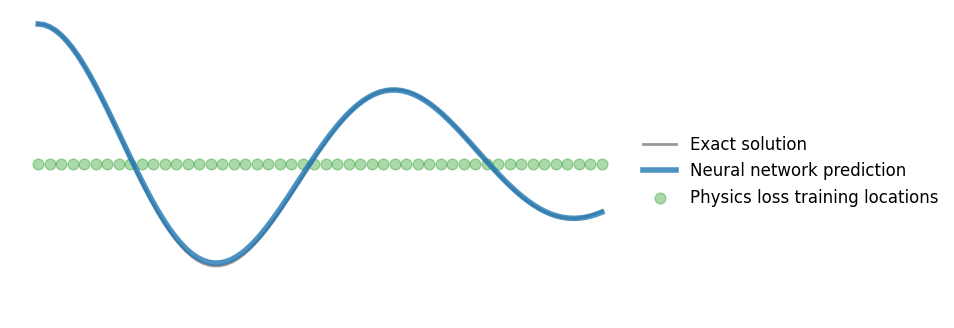

Epochs Progress:  44%|████▍     | 17500/40000 [09:02<17:31, 21.39it/s]

epoch: 17500, loss: 4.155106544494629


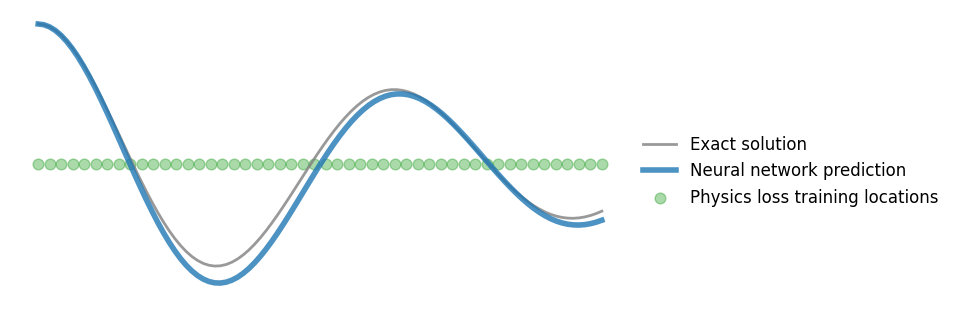

Epochs Progress:  45%|████▍     | 17996/40000 [09:30<15:04, 24.32it/s]

epoch: 18000, loss: 0.8497491478919983


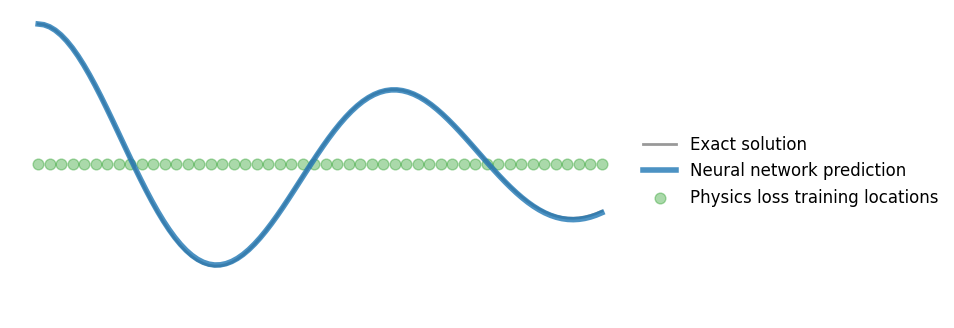

Epochs Progress:  46%|████▌     | 18491/40000 [09:54<10:56, 32.77it/s]

epoch: 18500, loss: 2.6902194023132324


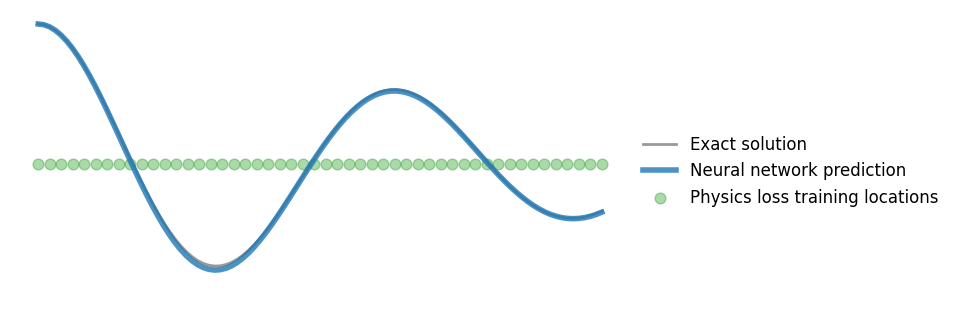

Epochs Progress:  48%|████▊     | 19000/40000 [10:09<08:08, 42.99it/s]

epoch: 19000, loss: 1.493577241897583


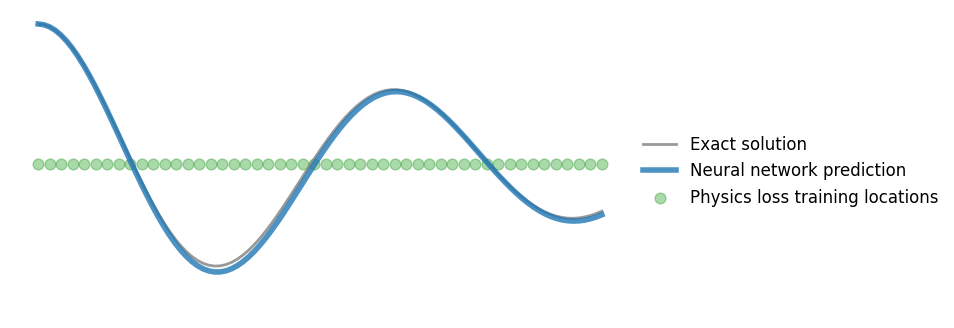

Epochs Progress:  49%|████▊     | 19498/40000 [10:28<09:15, 36.91it/s]

epoch: 19500, loss: 1.4355047941207886


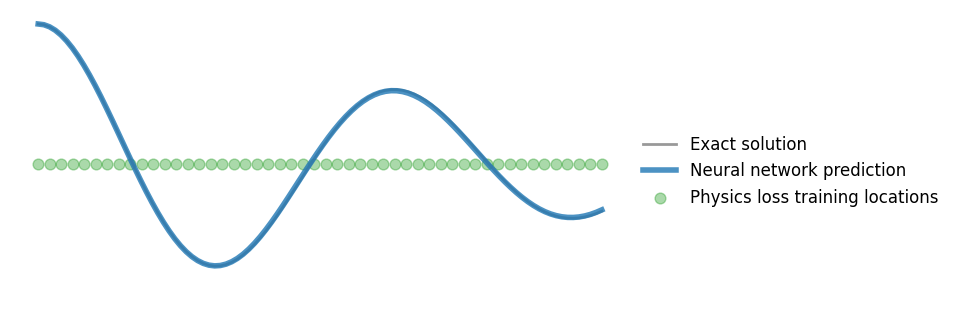

Epochs Progress:  50%|████▉     | 19997/40000 [10:46<08:23, 39.77it/s]

epoch: 20000, loss: 1.6621040105819702


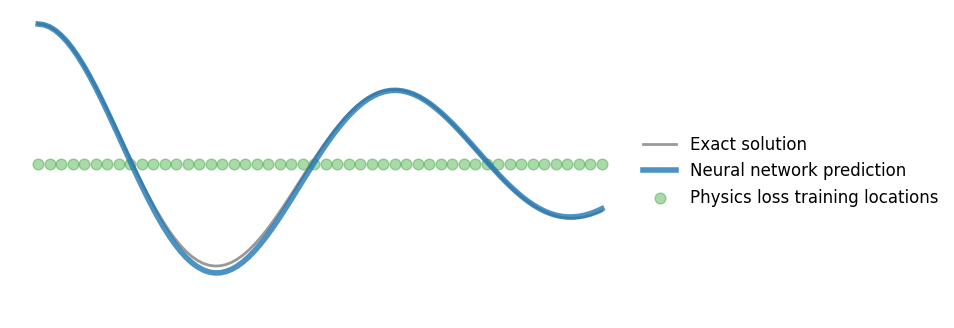

Epochs Progress:  51%|█████     | 20498/40000 [11:01<07:49, 41.53it/s]

epoch: 20500, loss: 1.4030332565307617


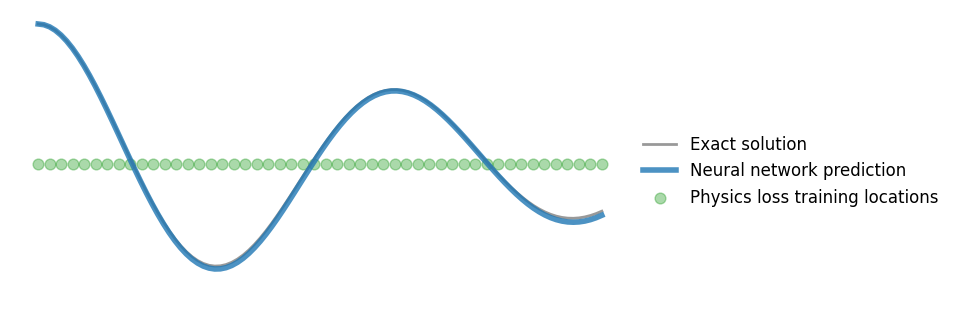

Epochs Progress:  52%|█████▏    | 20991/40000 [11:16<08:36, 36.78it/s]

epoch: 21000, loss: 1.5248063802719116


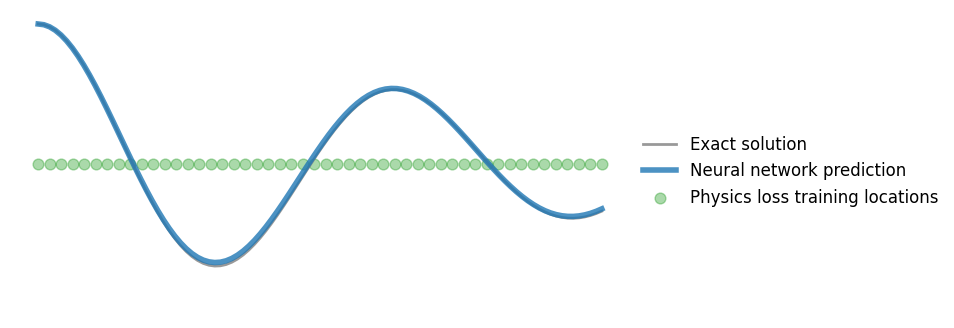

Epochs Progress:  54%|█████▎    | 21499/40000 [11:31<07:28, 41.22it/s]

epoch: 21500, loss: 0.6042070984840393


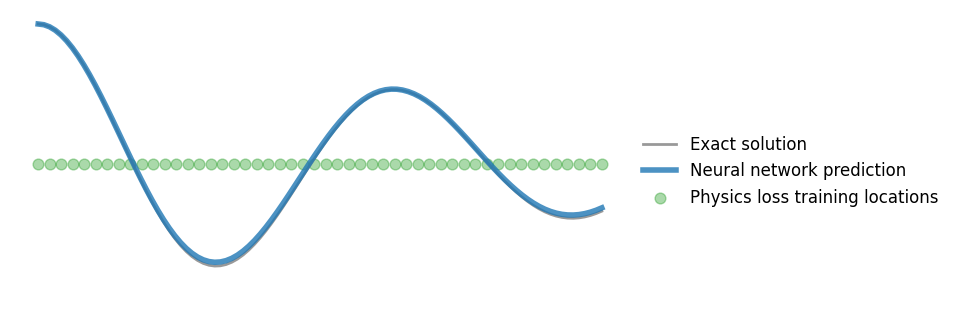

Epochs Progress:  55%|█████▍    | 21998/40000 [11:47<09:00, 33.31it/s]

epoch: 22000, loss: 0.713285505771637


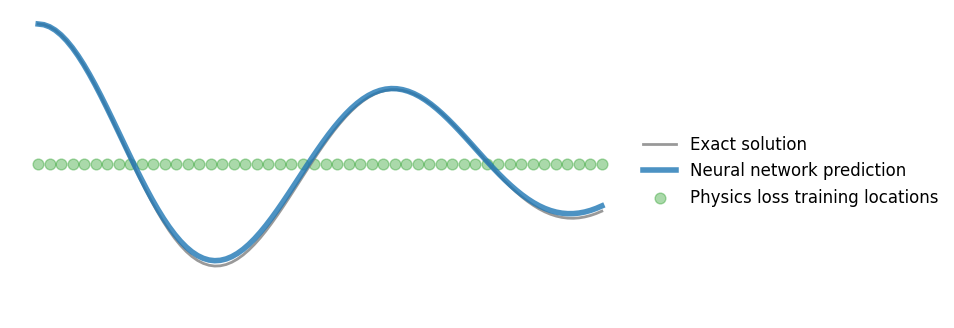

Epochs Progress:  56%|█████▌    | 22499/40000 [12:03<09:23, 31.05it/s]

epoch: 22500, loss: 2.0169811248779297


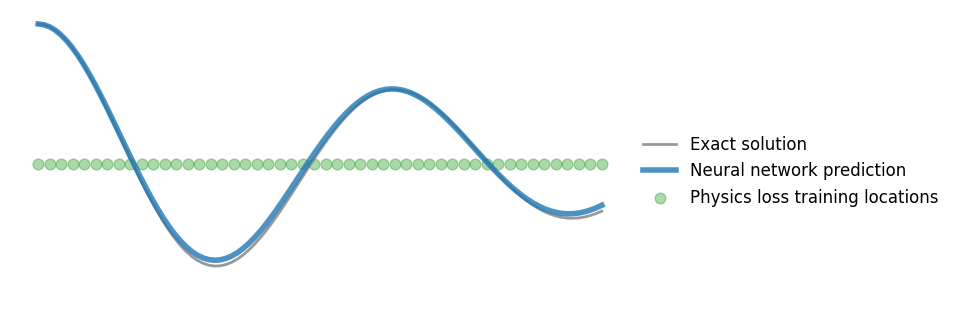

Epochs Progress:  57%|█████▋    | 22998/40000 [12:18<08:45, 32.38it/s]

epoch: 23000, loss: 1.2004294395446777


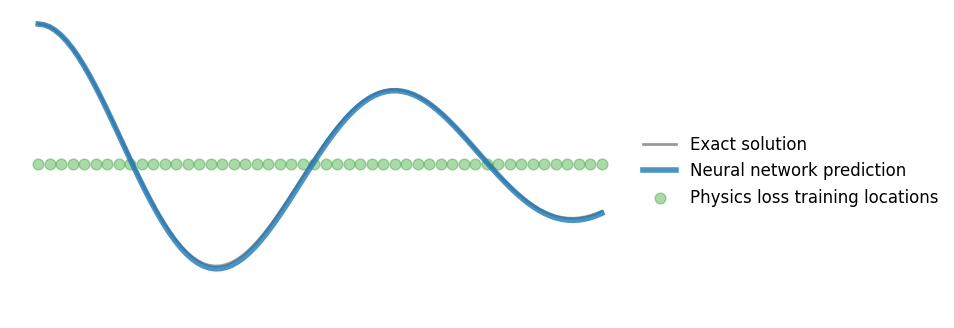

Epochs Progress:  59%|█████▊    | 23498/40000 [12:35<09:13, 29.82it/s]

epoch: 23500, loss: 1.2567194700241089


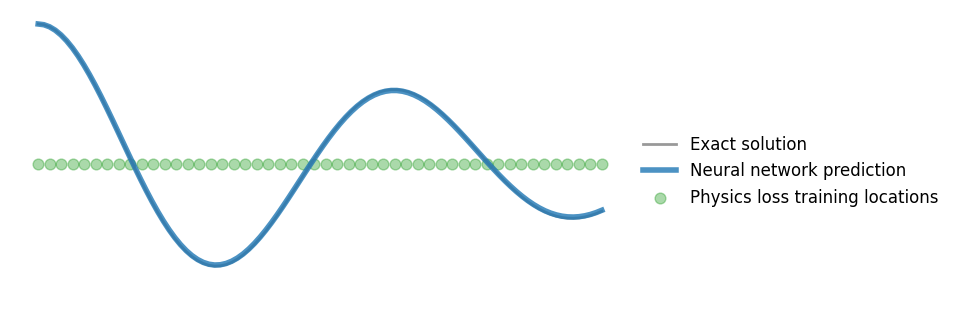

Epochs Progress:  60%|█████▉    | 23999/40000 [12:50<08:50, 30.17it/s]

epoch: 24000, loss: 0.6466013193130493


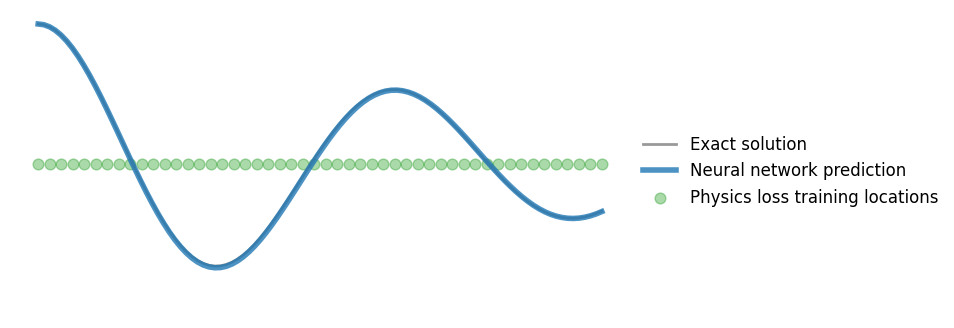

Epochs Progress:  61%|██████    | 24494/40000 [13:06<09:26, 27.36it/s]

epoch: 24500, loss: 1.293880820274353


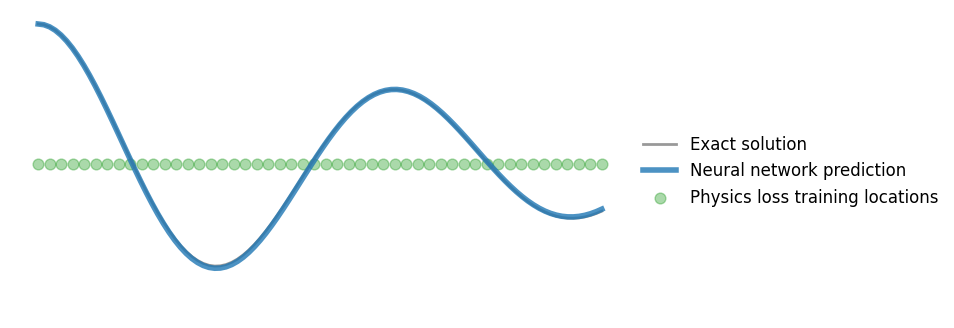

Epochs Progress:  62%|██████▏   | 24998/40000 [13:22<08:24, 29.76it/s]

epoch: 25000, loss: 2.763293743133545


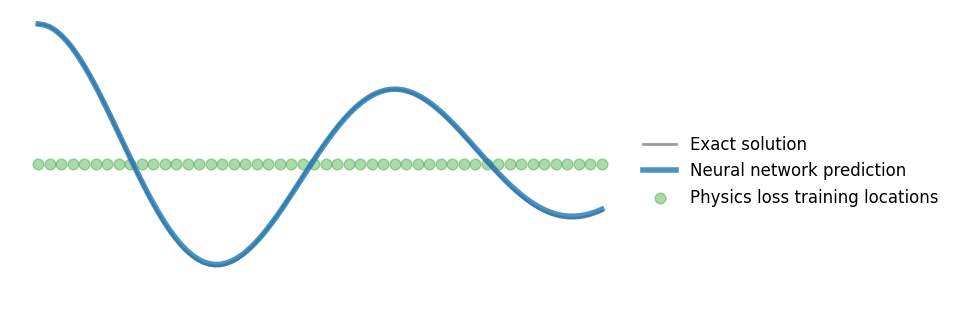

Epochs Progress:  64%|██████▎   | 25499/40000 [13:38<08:24, 28.73it/s]

epoch: 25500, loss: 2.173229932785034


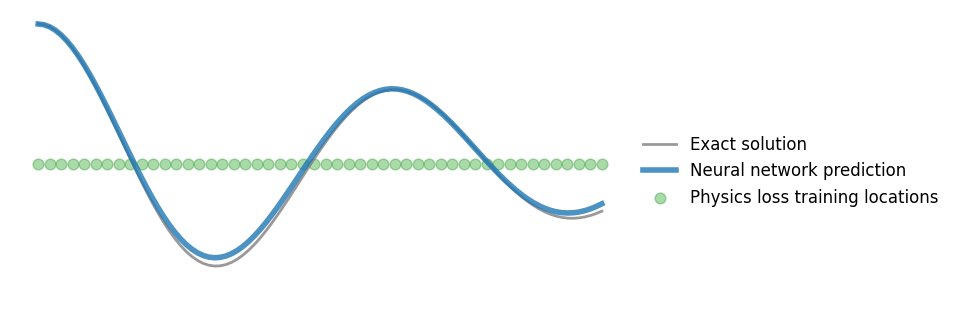

Epochs Progress:  65%|██████▍   | 25997/40000 [13:54<08:26, 27.63it/s]

epoch: 26000, loss: 1.5896557569503784


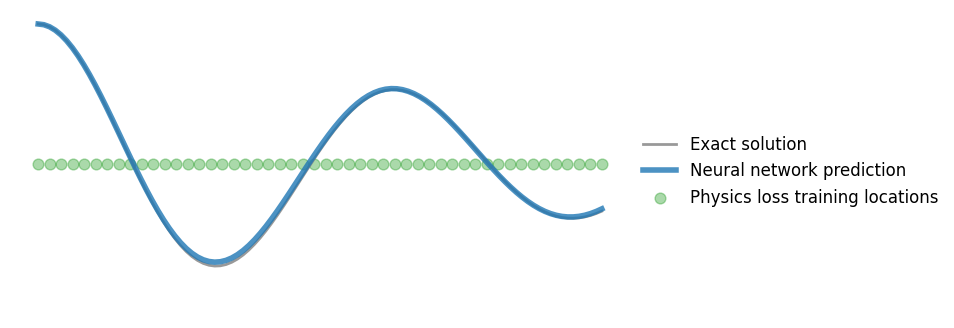

Epochs Progress:  66%|██████▌   | 26497/40000 [14:09<09:04, 24.78it/s]

epoch: 26500, loss: 0.9996976256370544


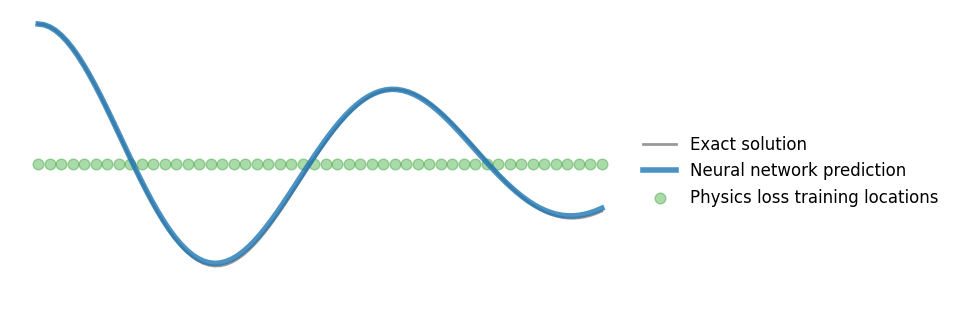

Epochs Progress:  67%|██████▋   | 26995/40000 [14:25<09:25, 22.98it/s]

epoch: 27000, loss: 3.0336644649505615


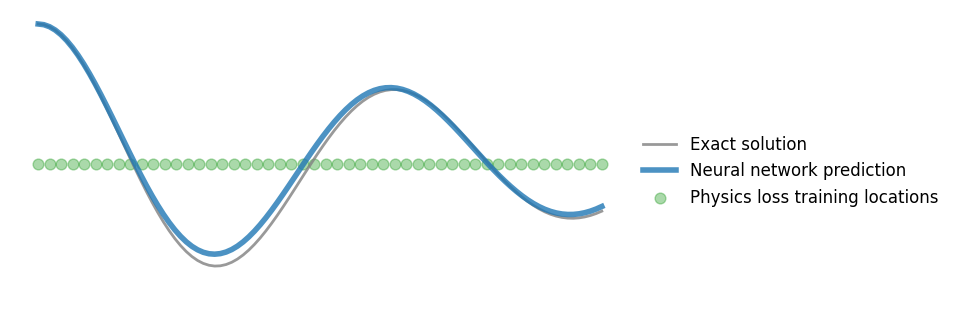

Epochs Progress:  69%|██████▊   | 27495/40000 [14:41<06:55, 30.11it/s]

epoch: 27500, loss: 1.376776933670044


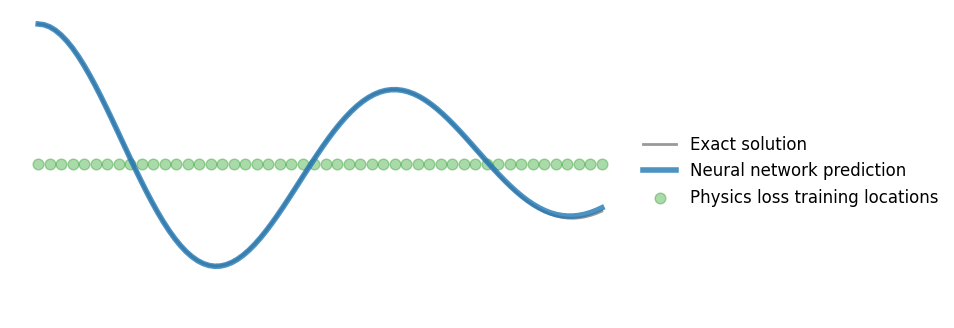

Epochs Progress:  70%|██████▉   | 27991/40000 [14:56<06:52, 29.15it/s]

epoch: 28000, loss: 0.4010005295276642


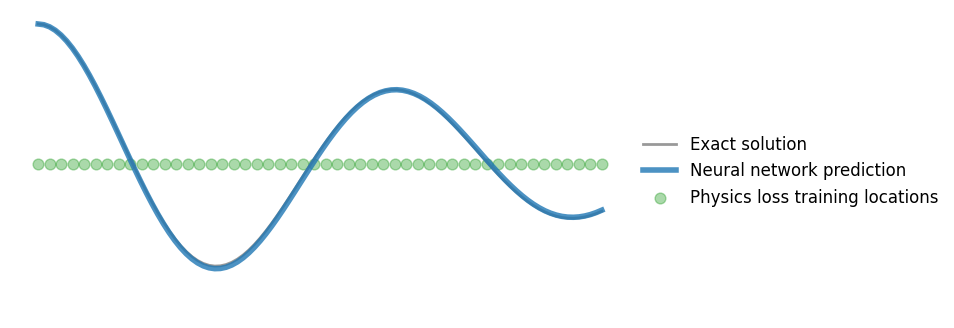

Epochs Progress:  71%|███████   | 28491/40000 [15:12<06:09, 31.12it/s]

epoch: 28500, loss: 1.2891672849655151


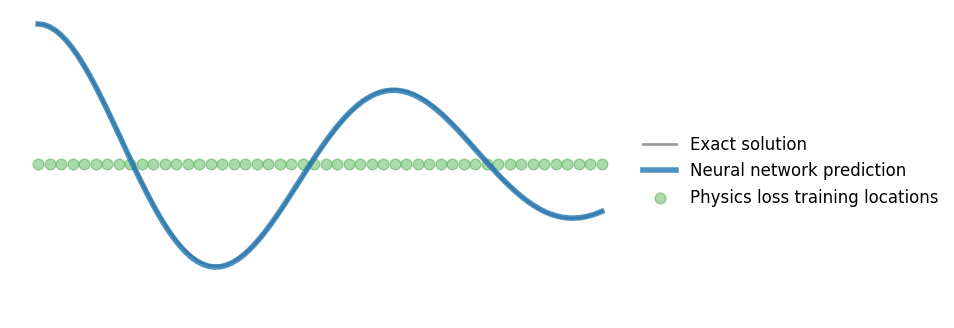

Epochs Progress:  72%|███████▏  | 28998/40000 [15:28<04:51, 37.79it/s]

epoch: 29000, loss: 1.74776029586792


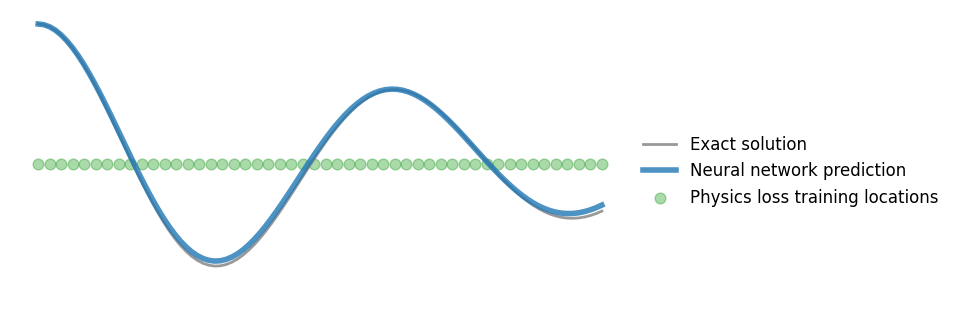

Epochs Progress:  74%|███████▎  | 29494/40000 [15:45<05:14, 33.42it/s]

epoch: 29500, loss: 0.579546332359314


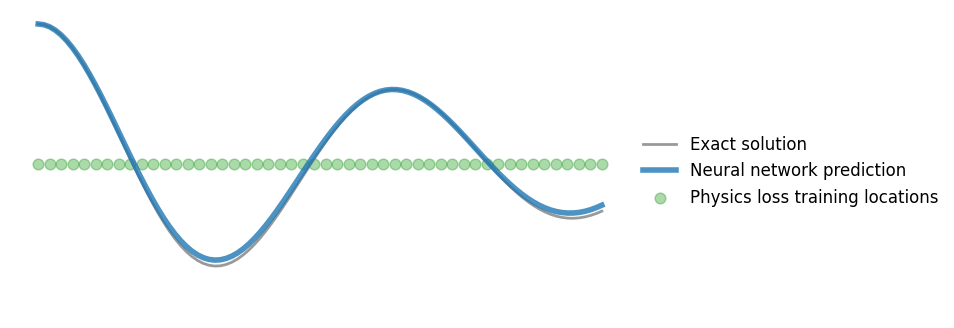

Epochs Progress:  75%|███████▍  | 29999/40000 [16:01<04:07, 40.35it/s]

epoch: 30000, loss: 1.2790350914001465


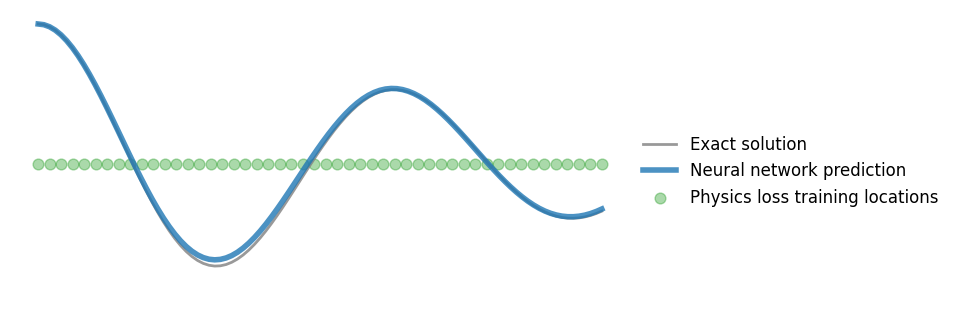

Epochs Progress:  76%|███████▋  | 30500/40000 [16:17<03:40, 43.01it/s]

epoch: 30500, loss: 1.5150625705718994


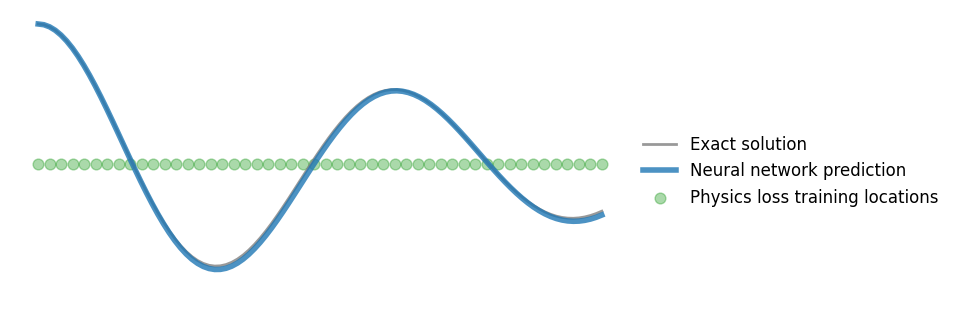

Epochs Progress:  77%|███████▋  | 30998/40000 [16:33<03:53, 38.57it/s]

epoch: 31000, loss: 1.7149345874786377


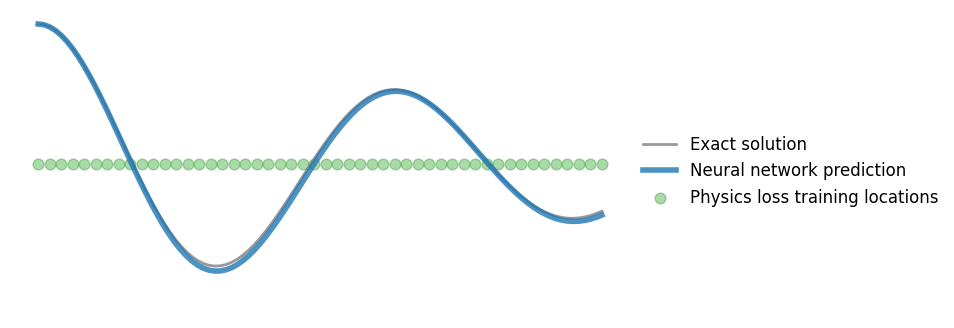

Epochs Progress:  79%|███████▊  | 31491/40000 [16:48<04:27, 31.80it/s]

epoch: 31500, loss: 0.3849029839038849


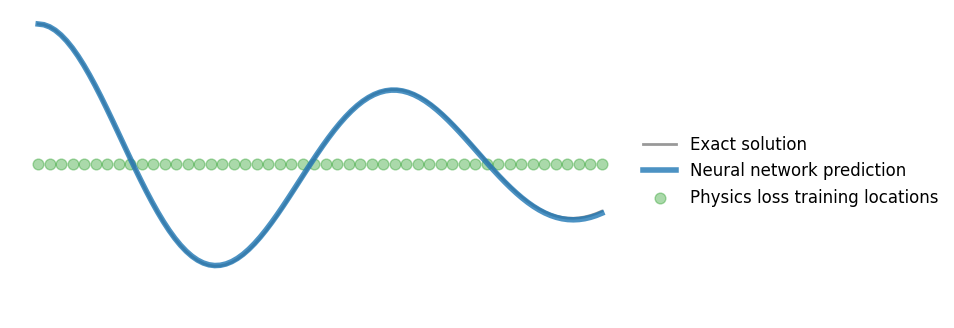

Epochs Progress:  80%|███████▉  | 31994/40000 [17:05<03:59, 33.44it/s]

epoch: 32000, loss: 1.2456862926483154


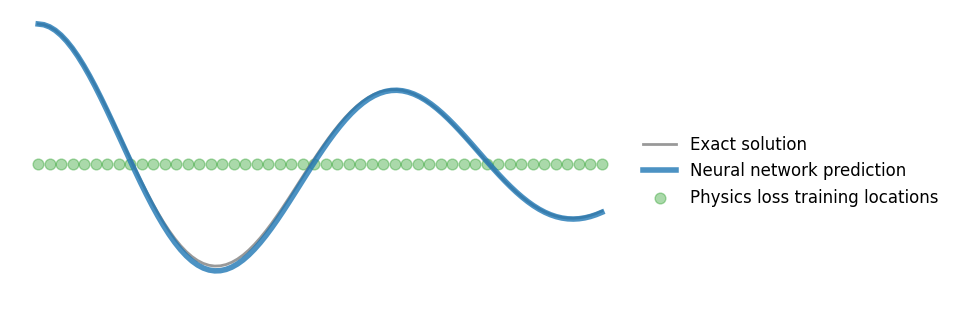

Epochs Progress:  81%|████████  | 32496/40000 [17:21<03:36, 34.62it/s]

epoch: 32500, loss: 0.4451292157173157


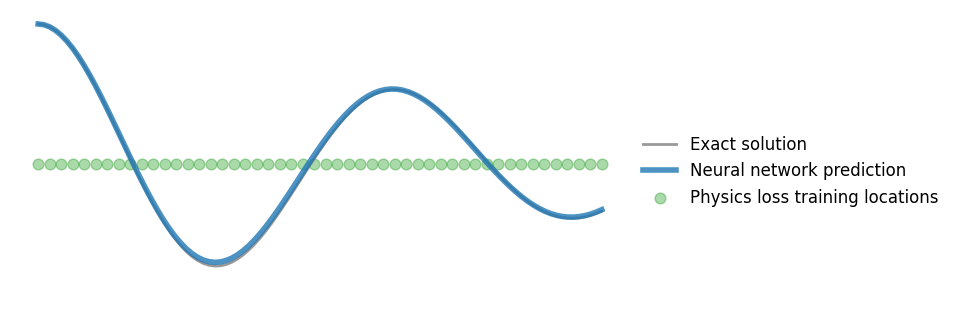

Epochs Progress:  82%|████████▏ | 32996/40000 [17:37<03:20, 34.99it/s]

epoch: 33000, loss: 0.7527304887771606


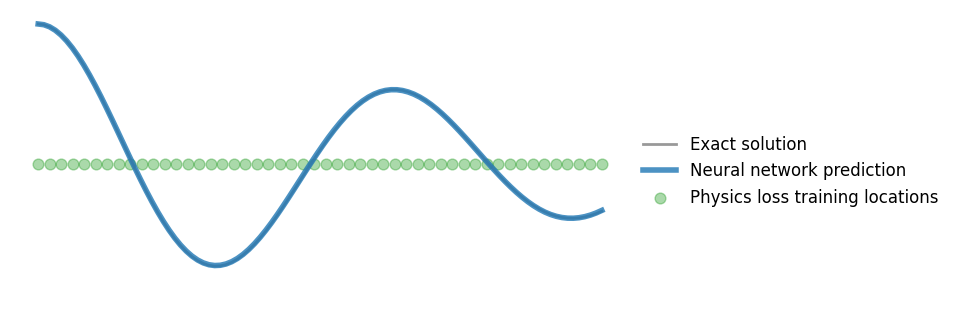

Epochs Progress:  84%|████████▎ | 33498/40000 [17:54<02:44, 39.50it/s]

epoch: 33500, loss: 1.5619592666625977


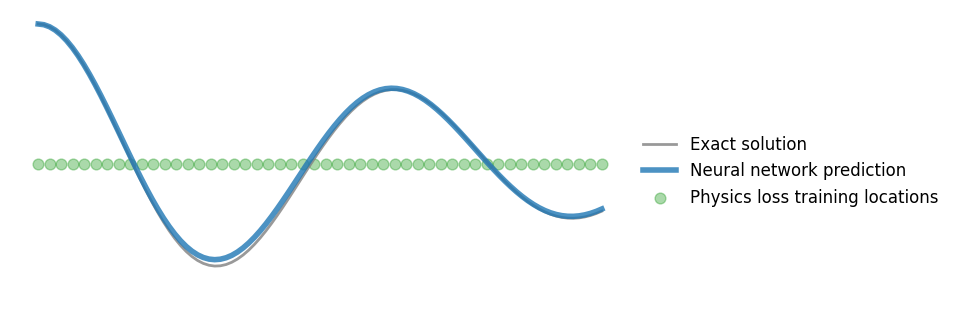

Epochs Progress:  85%|████████▍ | 33996/40000 [18:10<02:47, 35.74it/s]

epoch: 34000, loss: 0.9258202314376831


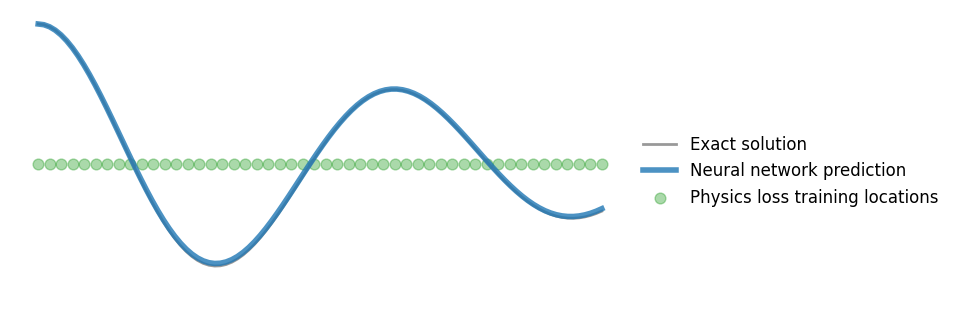

Epochs Progress:  86%|████████▌ | 34499/40000 [18:26<02:14, 40.87it/s]

epoch: 34500, loss: 1.1312073469161987


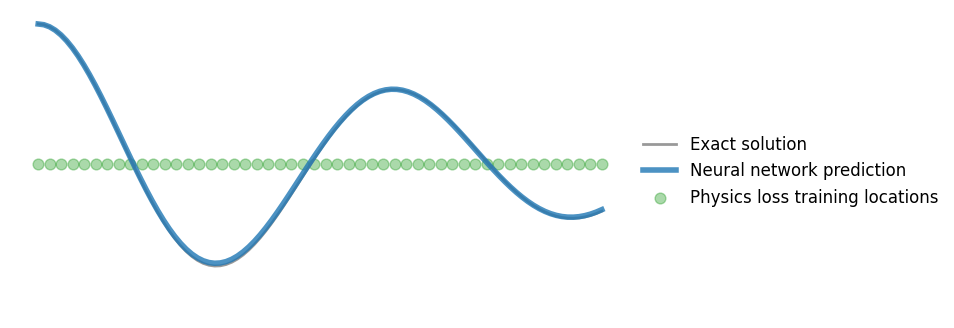

Epochs Progress:  87%|████████▋ | 34996/40000 [18:43<02:19, 35.80it/s]

epoch: 35000, loss: 1.8272193670272827


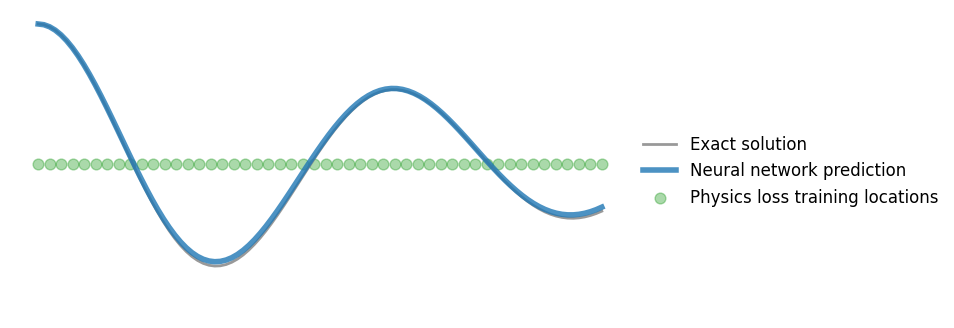

Epochs Progress:  89%|████████▊ | 35496/40000 [18:59<02:01, 37.14it/s]

epoch: 35500, loss: 1.6754037141799927


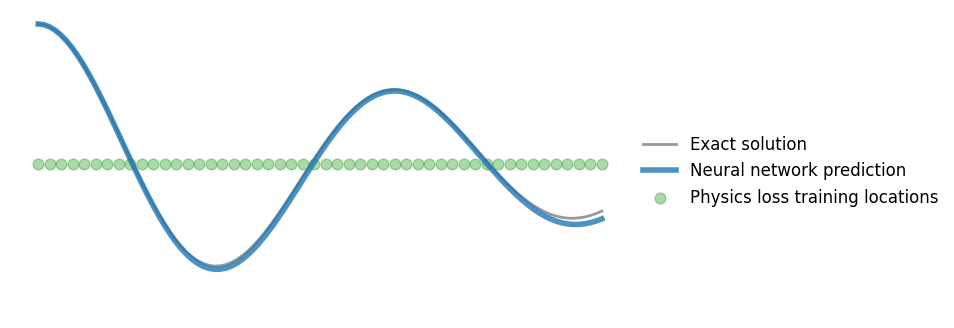

Epochs Progress:  90%|████████▉ | 35999/40000 [19:15<01:39, 40.20it/s]

epoch: 36000, loss: 0.9189239740371704


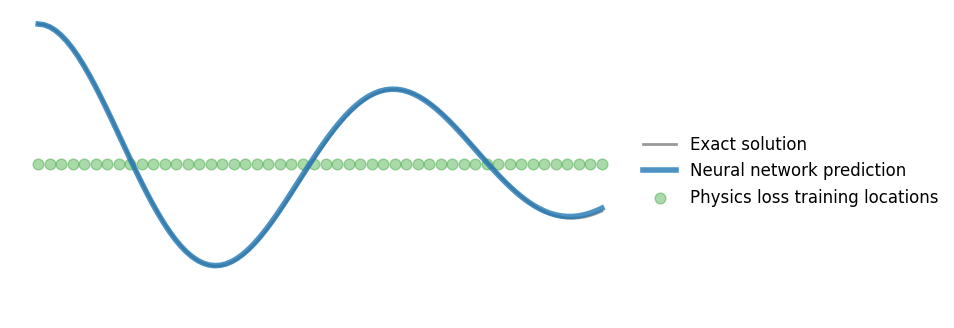

Epochs Progress:  91%|█████████ | 36494/40000 [19:31<01:46, 32.89it/s]

epoch: 36500, loss: 1.2125284671783447


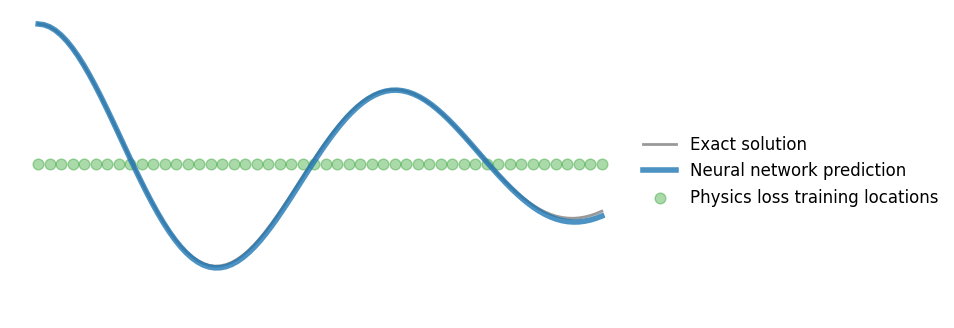

Epochs Progress:  92%|█████████▏| 36996/40000 [19:47<01:23, 35.82it/s]

epoch: 37000, loss: 1.4678782224655151


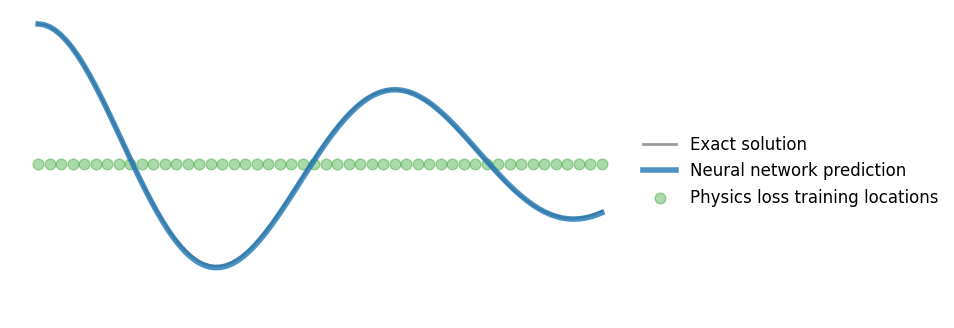

Epochs Progress:  94%|█████████▎| 37496/40000 [20:04<01:11, 35.25it/s]

epoch: 37500, loss: 0.7015583515167236


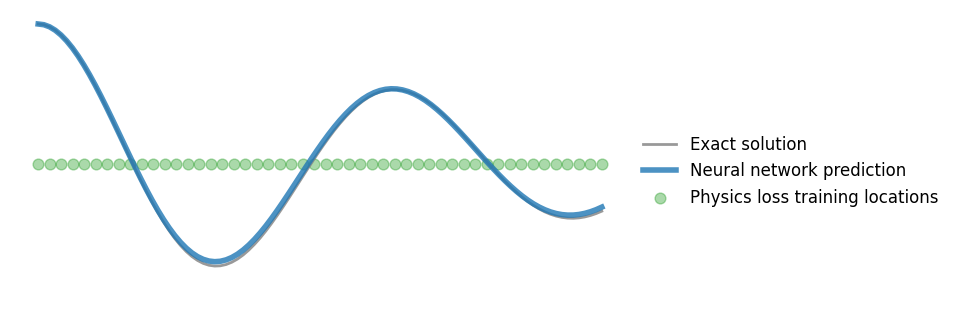

Epochs Progress:  95%|█████████▍| 37996/40000 [20:20<00:55, 36.13it/s]

epoch: 38000, loss: 0.6157446503639221


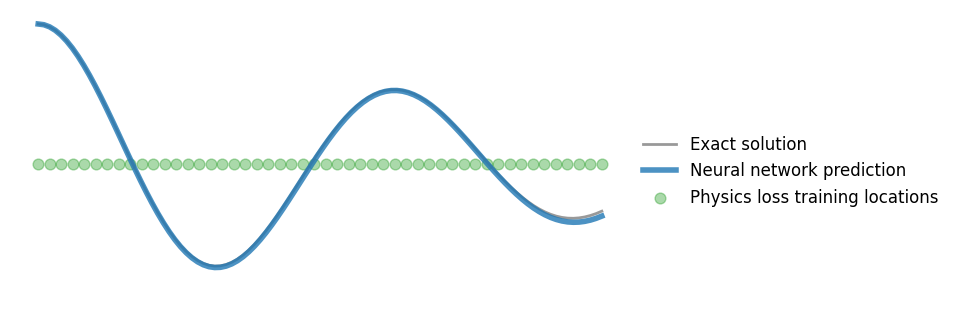

Epochs Progress:  96%|█████████▌| 38499/40000 [20:36<00:37, 40.10it/s]

epoch: 38500, loss: 2.0481393337249756


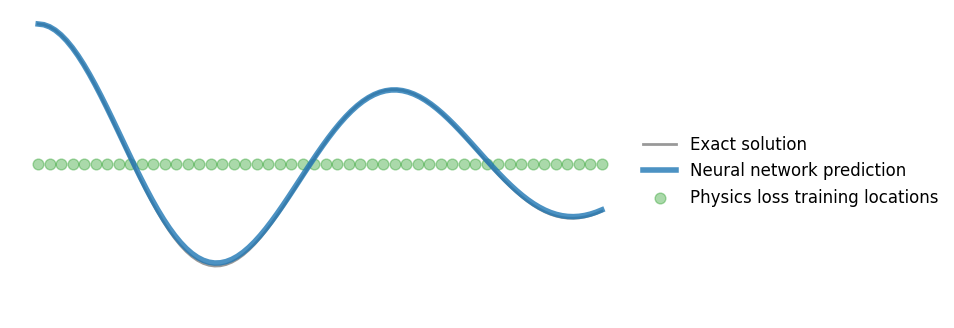

Epochs Progress:  97%|█████████▋| 38996/40000 [20:53<00:27, 36.04it/s]

epoch: 39000, loss: 0.6368697881698608


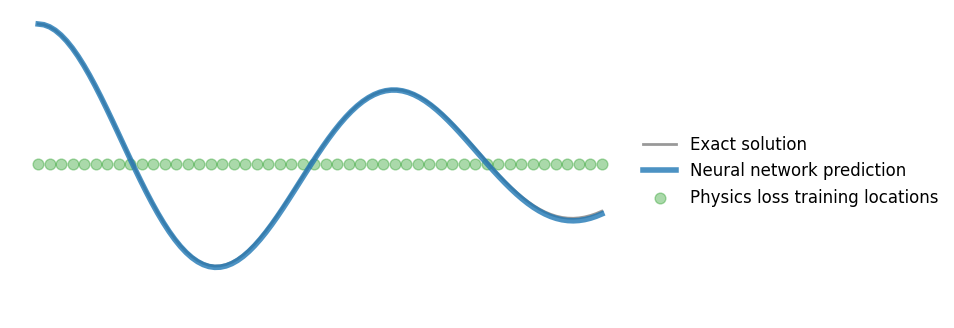

Epochs Progress:  99%|█████████▊| 39497/40000 [21:09<00:15, 31.70it/s]

epoch: 39500, loss: 0.32936644554138184


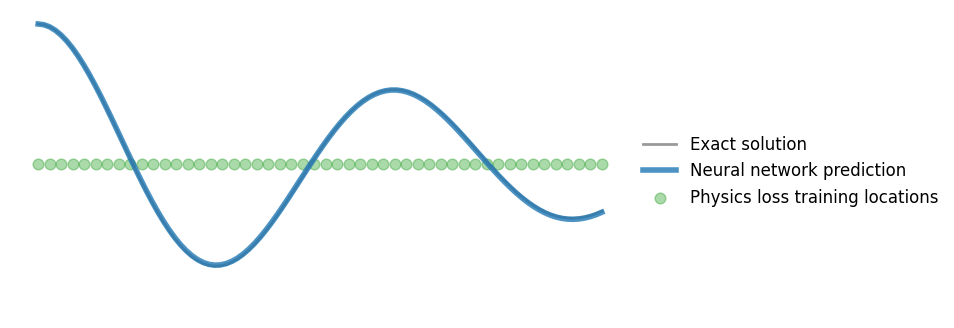

Epochs Progress: 100%|██████████| 40000/40000 [21:26<00:00, 31.10it/s]


In [ ]:
only_physics_train(harmonic_optimizer_4, harmonic_model_4, harmonic_loss, harmonic_trial_solution, epochs = 40000, display_step=500,domain_lb=0, domain_ub=1, num_points=50,  plot_points=100, x = display_x ,y = display_y, gif_n="harmonic_1_5_softplus")

# Soft Plus works better

now trying more complex equation
with  $\delta=1 $, $\omega_0=29$

In [ ]:
w0 = 25
d = 1

In [ ]:
display_x = torch.linspace(0, 2, 500, requires_grad=False).unsqueeze(1)
display_y = harmonic_oscillator(display_x)

In [ ]:
lr = 0.005
harmonic_c_expert_2_softplus = MixtureOfExperts(N_EXPERT = 2, N_LAYERS = 4, N_HIDDEN = 64,  act = nn.Softplus)
harmonic_optimizer_expert_5_softplus = optim.Adam(harmonic_c_expert_2_softplus.parameters(), lr = lr)
# scheduler = optim.lr_scheduler.CosineAnnealingLR(harmonic_optimizer_expert_5_softplus, T_max=100000, eta_min = 0.000001)

In [ ]:
only_physics_train(harmonic_optimizer_expert_5_softplus, harmonic_c_expert_2_softplus, harmonic_loss, harmonic_trial_solution, epochs = 40000, display_step=500,domain_lb=0, domain_ub=2, num_points=100,  plot_points=500, x = display_x ,y = display_y, gif_n="harmonic_optimizer_expert_5_softplus")

In [ ]:
lr = 0.01
harmonic_c_expert_2 = MixtureOfExperts(N_EXPERT = 2, N_LAYERS = 3, N_HIDDEN = 64)
harmonic_c_optimizer_expert_2 = optim.Adam(harmonic_c_expert_2.parameters(), lr = lr)
# scheduler = optim.lr_scheduler.CosineAnnealingLR(harmonic_optimizer_expert_5_softplus, T_max=100000, eta_min = 0.000001)

Epochs Progress:   0%|          | 0/20000 [00:00<?, ?it/s]

epoch: 0, loss: 629.635009765625


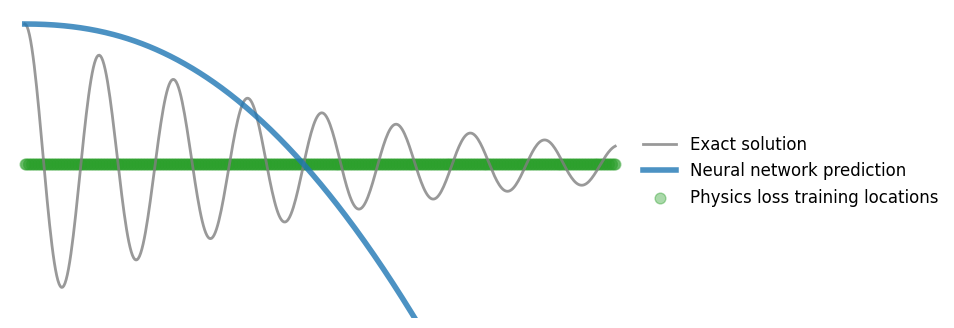

Epochs Progress:   2%|▏         | 496/20000 [00:07<05:44, 56.66it/s]

epoch: 500, loss: 52.2741584777832


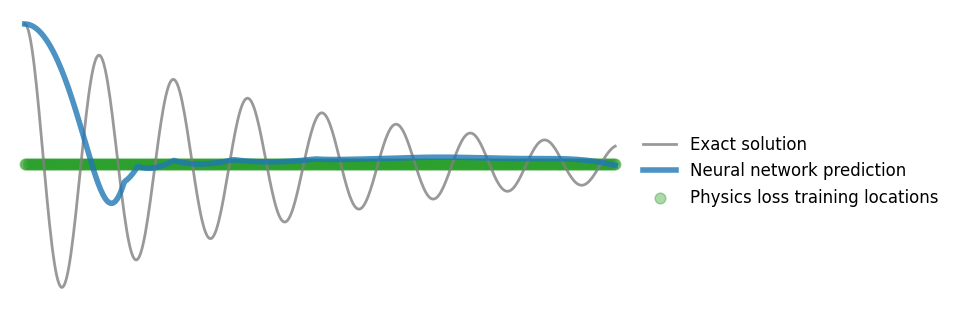

Epochs Progress:   5%|▍         | 998/20000 [00:16<04:07, 76.87it/s]

epoch: 1000, loss: 49.198001861572266


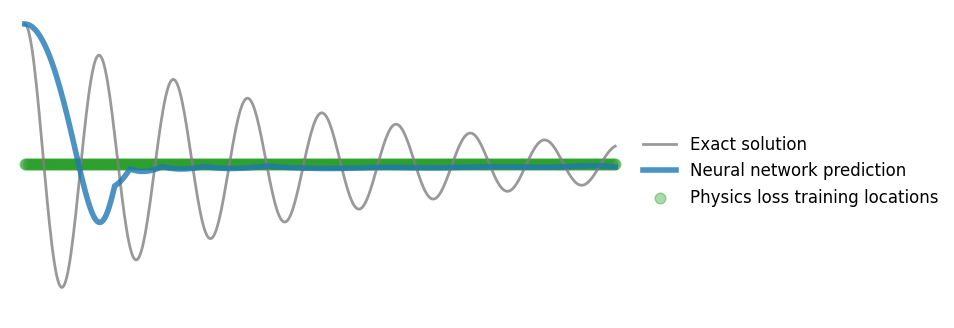

Epochs Progress:   7%|▋         | 1496/20000 [00:25<06:08, 50.26it/s]

epoch: 1500, loss: 33.979122161865234


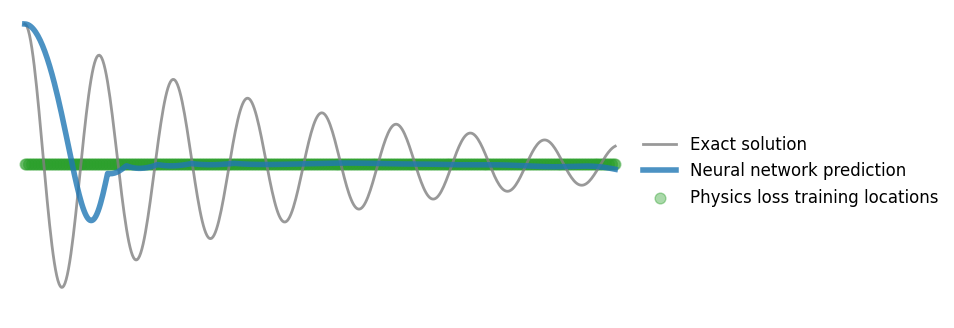

Epochs Progress:  10%|▉         | 1995/20000 [00:32<03:49, 78.34it/s]

epoch: 2000, loss: 38.48039627075195


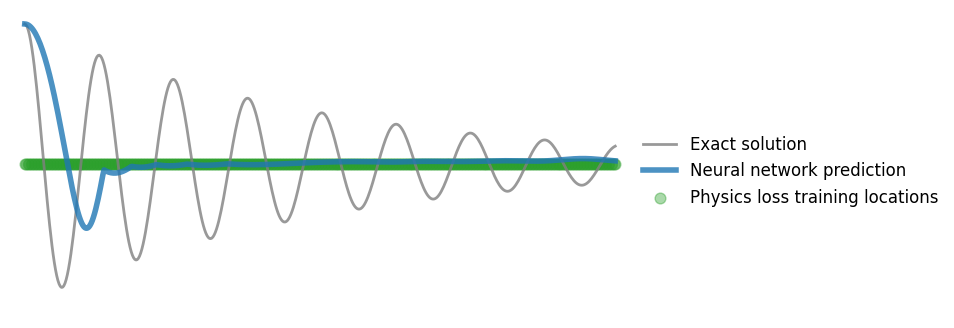

Epochs Progress:  12%|█▏        | 2499/20000 [00:40<03:47, 76.90it/s]

epoch: 2500, loss: 23.846965789794922


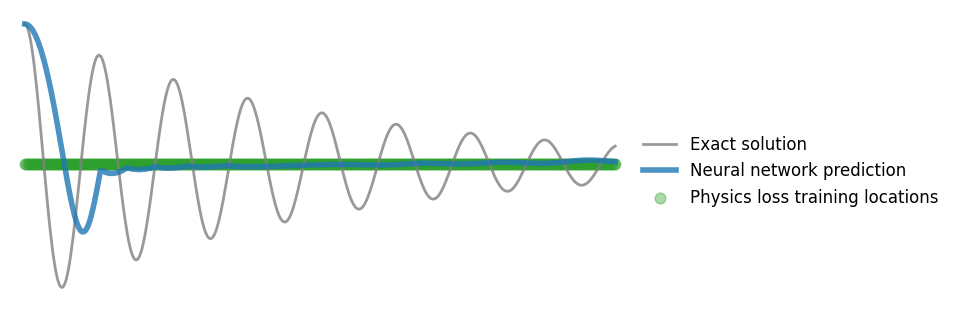

Epochs Progress:  15%|█▍        | 2994/20000 [00:48<03:33, 79.82it/s]

epoch: 3000, loss: 31.740520477294922


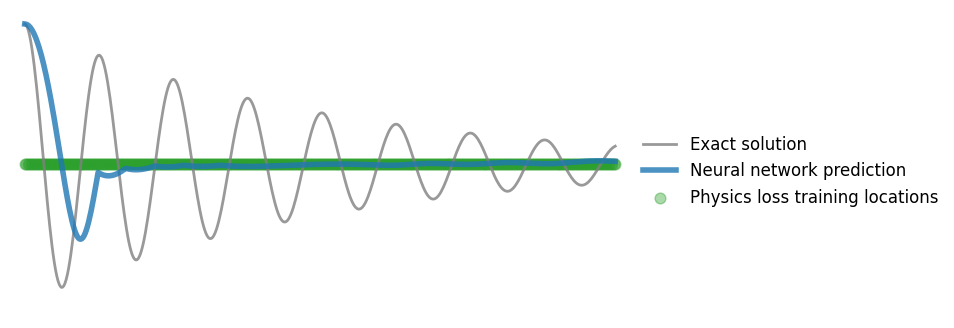

Epochs Progress:  18%|█▊        | 3500/20000 [00:57<04:06, 66.83it/s]

epoch: 3500, loss: 21.313426971435547


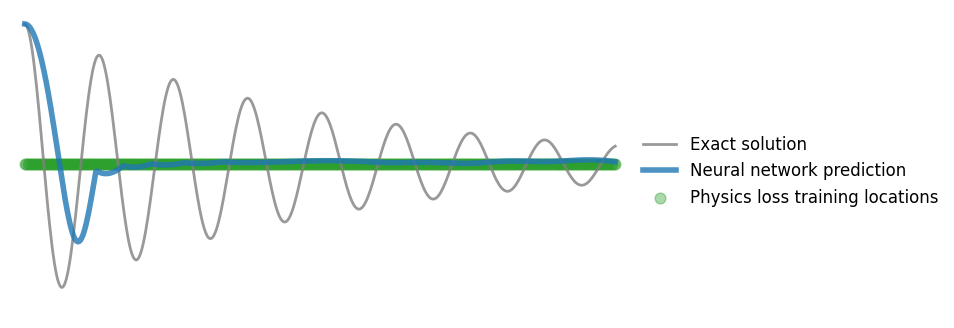

Epochs Progress:  20%|█▉        | 3995/20000 [01:05<05:09, 51.68it/s]

epoch: 4000, loss: 42.445438385009766


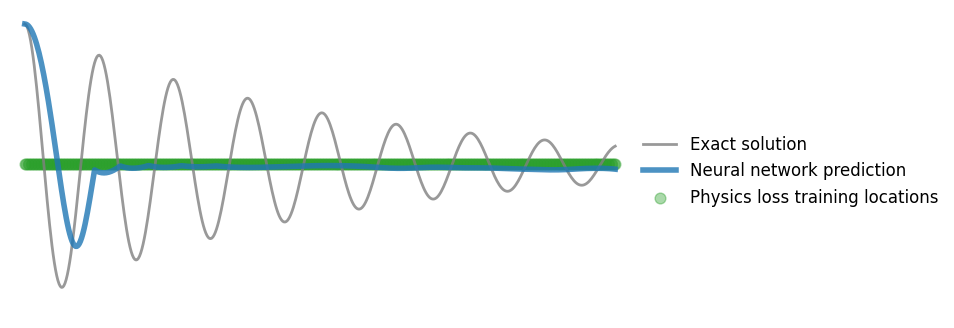

Epochs Progress:  22%|██▏       | 4499/20000 [01:13<03:15, 79.23it/s]

epoch: 4500, loss: 17.62140655517578


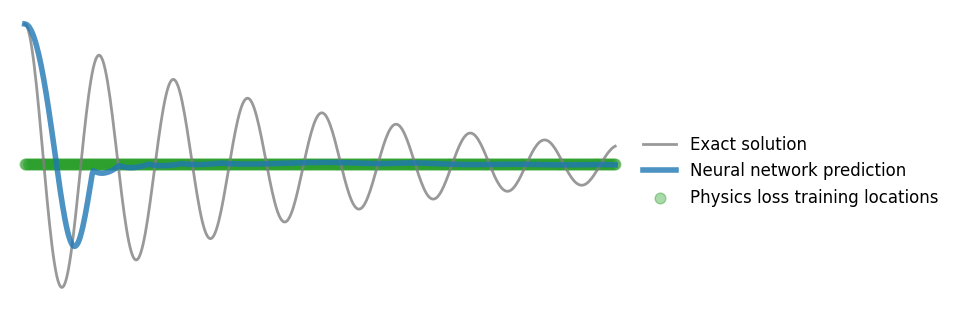

Epochs Progress:  25%|██▌       | 5000/20000 [01:22<03:17, 75.85it/s]

epoch: 5000, loss: 17.670387268066406


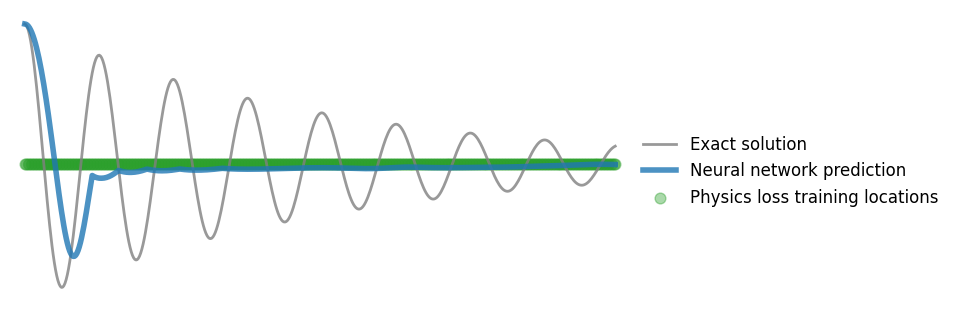

Epochs Progress:  27%|██▋       | 5496/20000 [01:29<03:12, 75.30it/s]

epoch: 5500, loss: 19.2877140045166


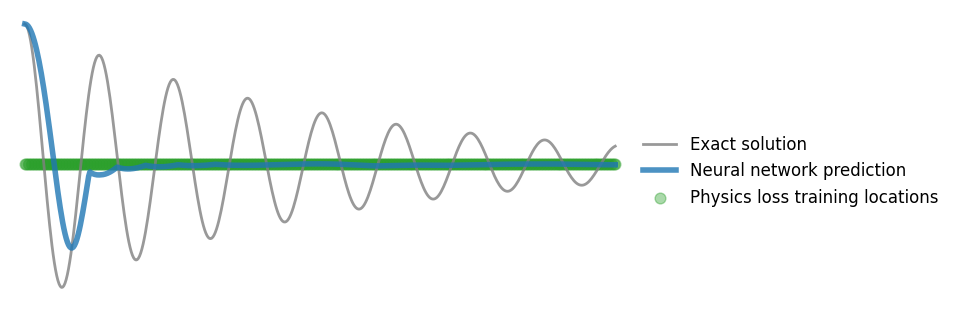

Epochs Progress:  30%|██▉       | 5995/20000 [01:38<03:15, 71.46it/s]

epoch: 6000, loss: 22.198564529418945


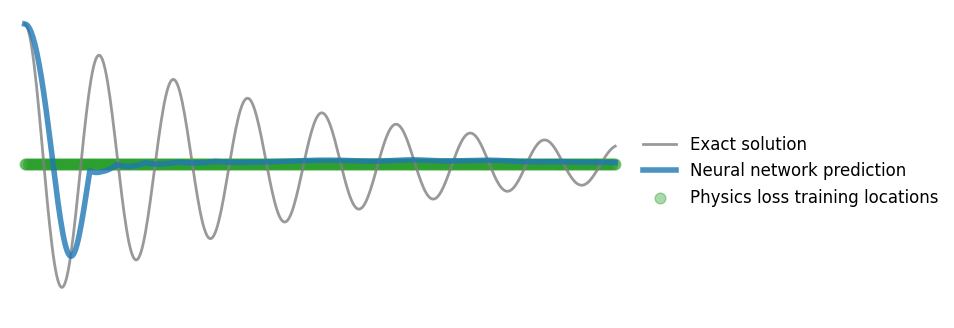

Epochs Progress:  32%|███▏      | 6498/20000 [01:46<04:00, 56.20it/s]

epoch: 6500, loss: 15.507718086242676


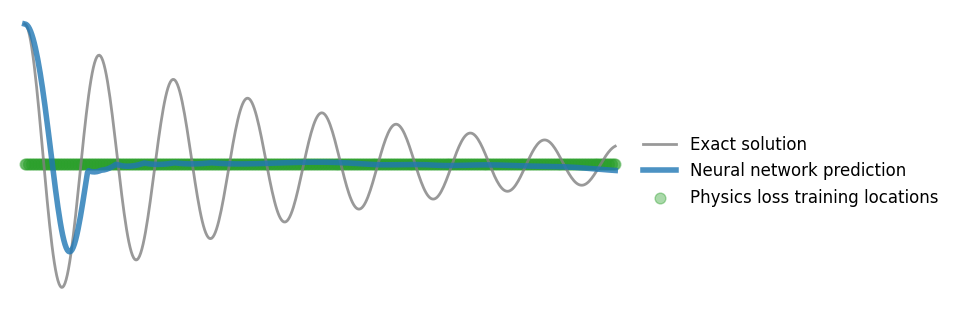

Epochs Progress:  35%|███▍      | 6997/20000 [01:55<02:57, 73.14it/s]

epoch: 7000, loss: 18.296144485473633


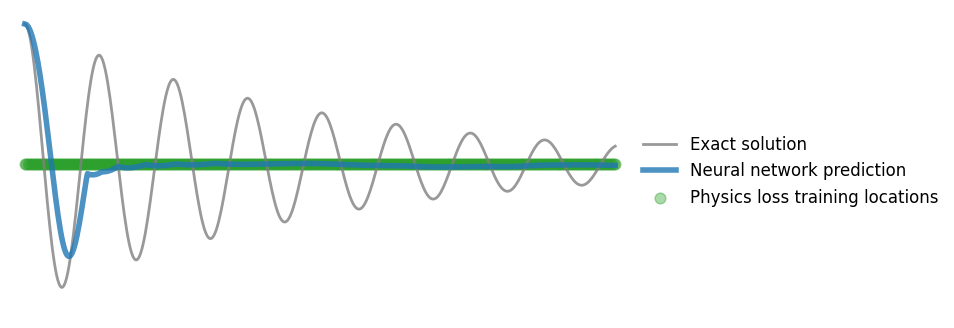

Epochs Progress:  37%|███▋      | 7499/20000 [02:04<04:35, 45.34it/s]

epoch: 7500, loss: 17.022502899169922


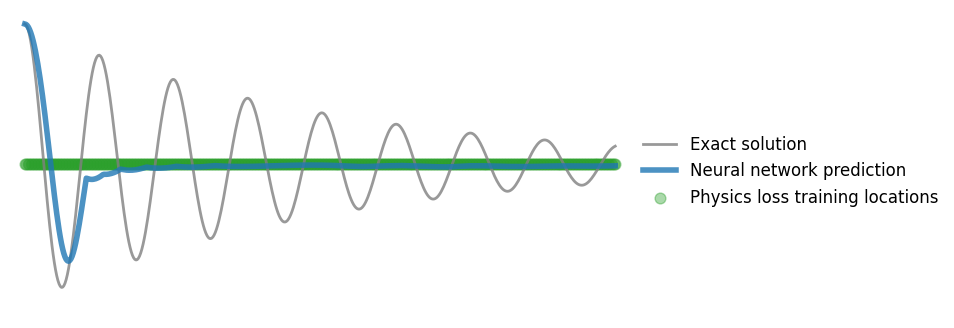

Epochs Progress:  40%|███▉      | 7993/20000 [02:11<02:48, 71.09it/s]

epoch: 8000, loss: 12.513483047485352


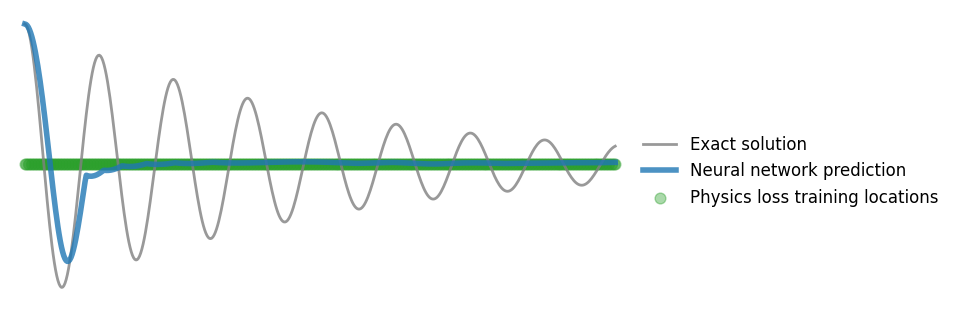

Epochs Progress:  42%|████▏     | 8498/20000 [02:21<02:36, 73.58it/s]

epoch: 8500, loss: 65.59951782226562


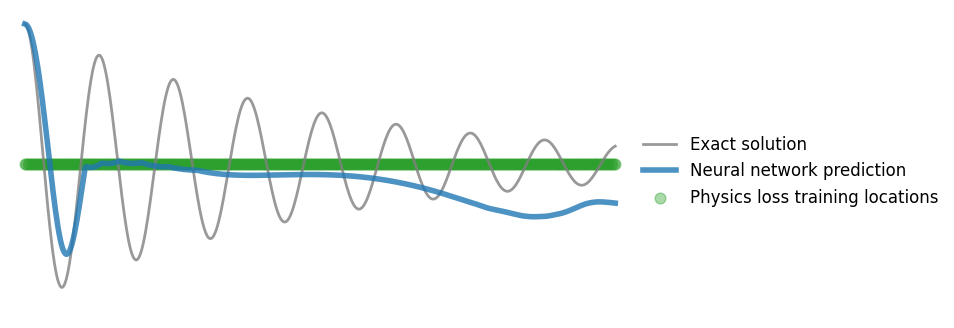

Epochs Progress:  45%|████▍     | 8994/20000 [02:28<03:04, 59.70it/s]

epoch: 9000, loss: 61.759185791015625


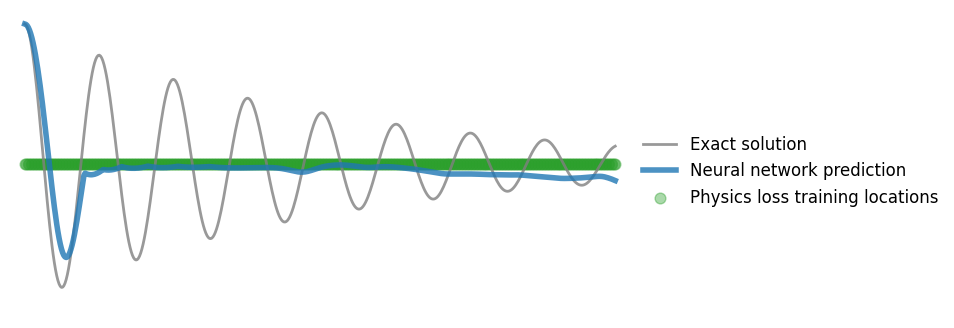

Epochs Progress:  47%|████▋     | 9493/20000 [02:37<02:20, 74.53it/s]

epoch: 9500, loss: 99.58966064453125


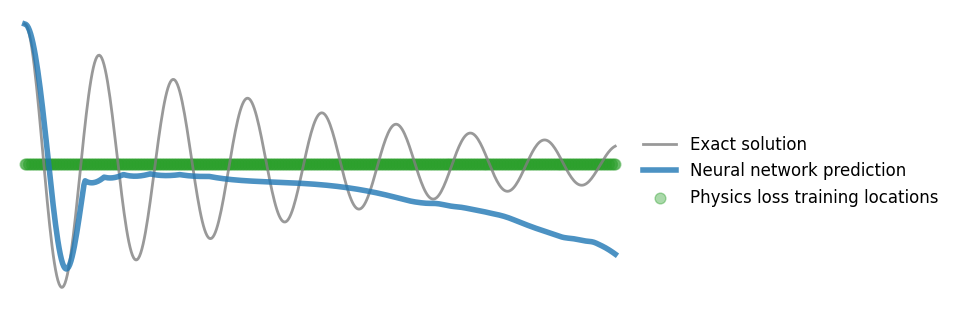

Epochs Progress:  50%|████▉     | 9997/20000 [02:46<03:43, 44.83it/s]

epoch: 10000, loss: 27.30352020263672


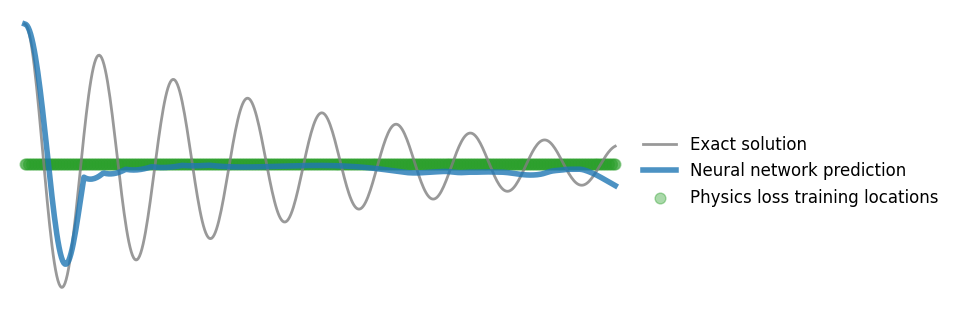

Epochs Progress:  52%|█████▏    | 10495/20000 [02:54<02:17, 69.21it/s]

epoch: 10500, loss: 71.59066772460938


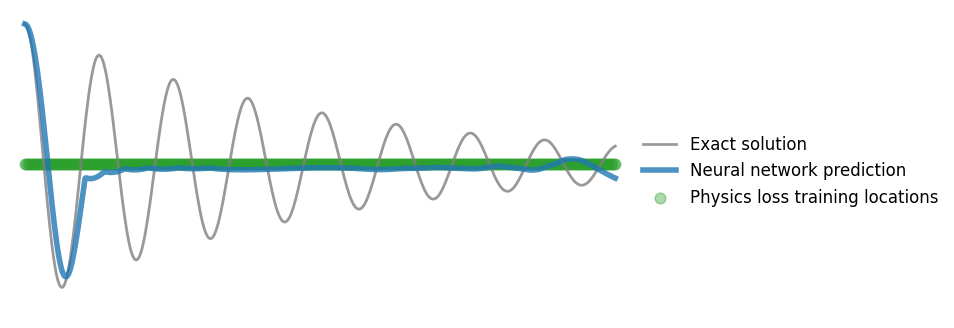

Epochs Progress:  55%|█████▍    | 10994/20000 [03:04<02:06, 71.12it/s]

epoch: 11000, loss: 46.137115478515625


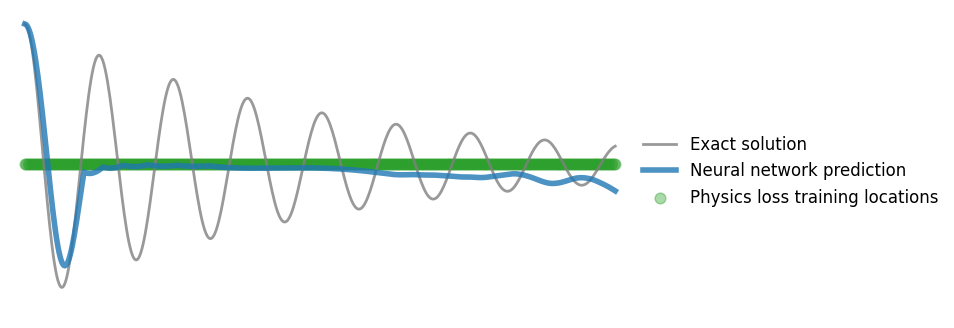

Epochs Progress:  57%|█████▋    | 11497/20000 [03:12<02:25, 58.55it/s]

epoch: 11500, loss: 20.999595642089844


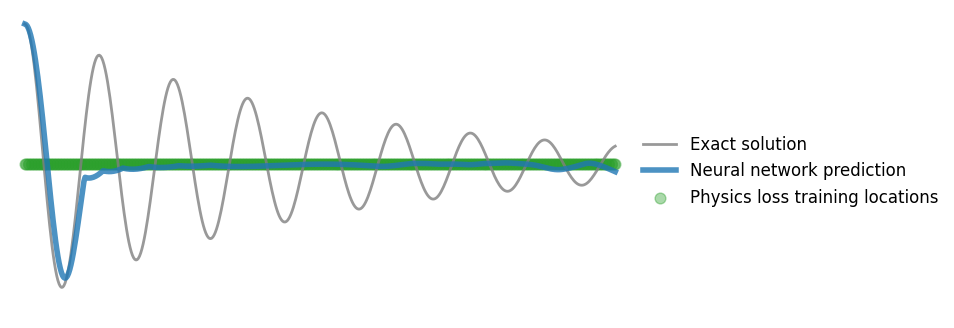

Epochs Progress:  60%|██████    | 12000/20000 [03:21<01:56, 68.43it/s]

epoch: 12000, loss: 38.831138610839844


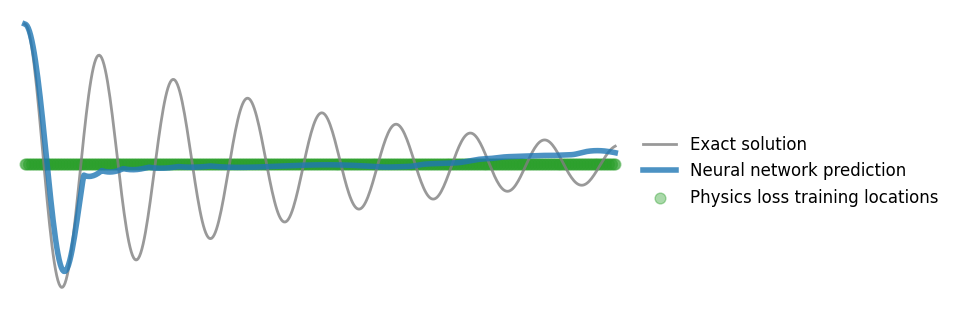

Epochs Progress:  62%|██████▏   | 12496/20000 [03:30<02:50, 44.10it/s]

epoch: 12500, loss: 44.57609558105469


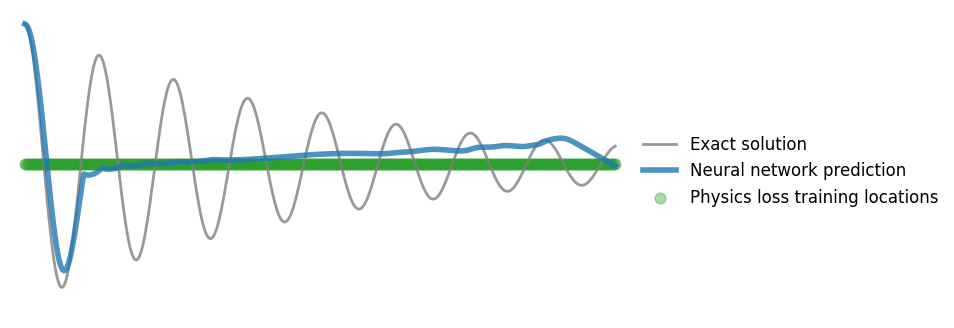

Epochs Progress:  65%|██████▍   | 12994/20000 [03:39<01:52, 62.07it/s]

epoch: 13000, loss: 51.397621154785156


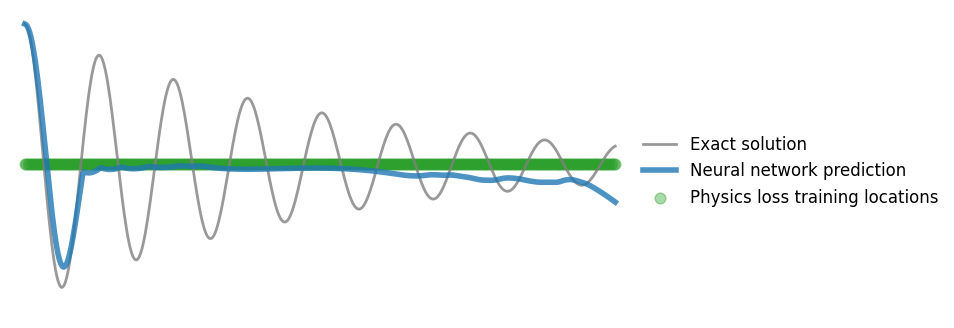

Epochs Progress:  68%|██████▊   | 13500/20000 [03:48<01:53, 57.47it/s]

epoch: 13500, loss: 39.02558517456055


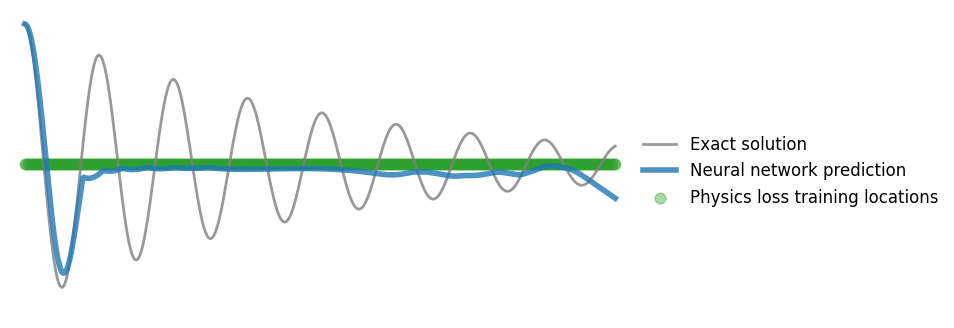

Epochs Progress:  70%|██████▉   | 13998/20000 [03:56<01:52, 53.23it/s]

epoch: 14000, loss: 53.44761276245117


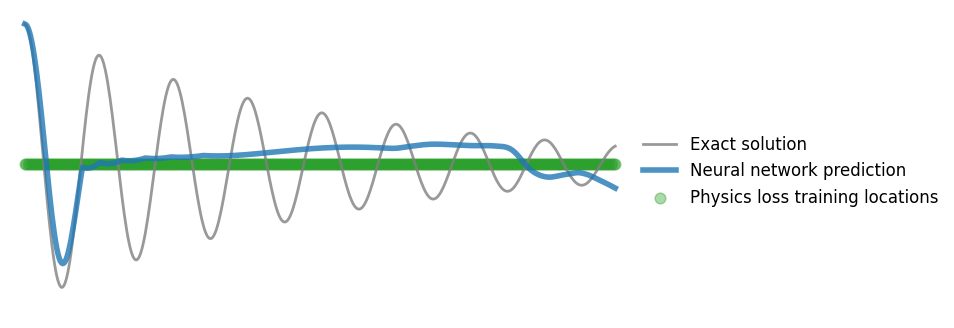

Epochs Progress:  72%|███████▎  | 14500/20000 [04:06<01:19, 68.89it/s]

epoch: 14500, loss: 52.119903564453125


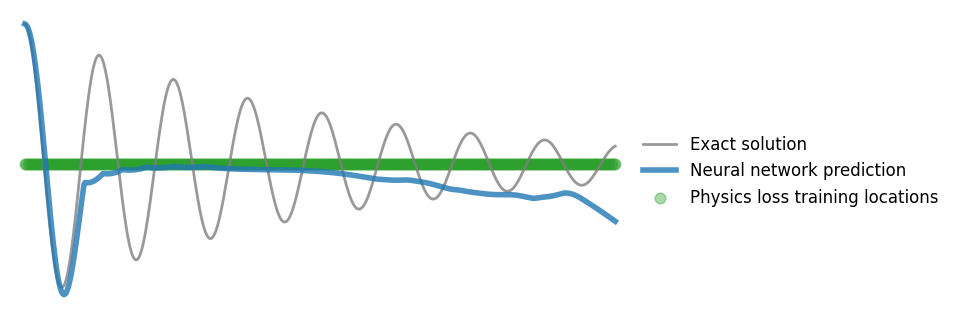

Epochs Progress:  75%|███████▍  | 14997/20000 [04:16<01:16, 65.52it/s]

epoch: 15000, loss: 22.696186065673828


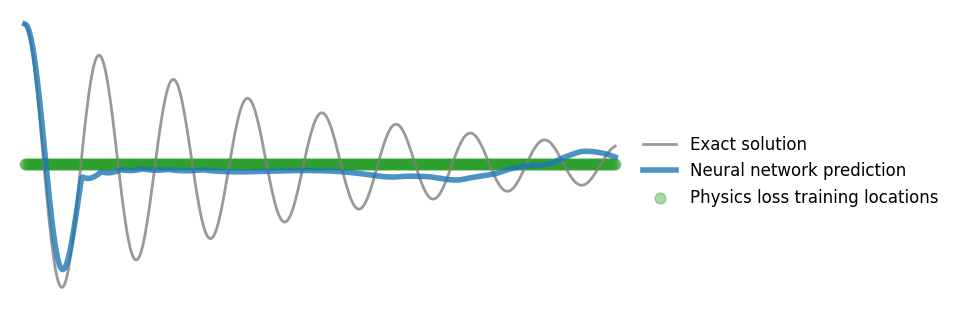

Epochs Progress:  78%|███████▊  | 15500/20000 [04:24<01:05, 68.56it/s]

epoch: 15500, loss: 26.7896671295166


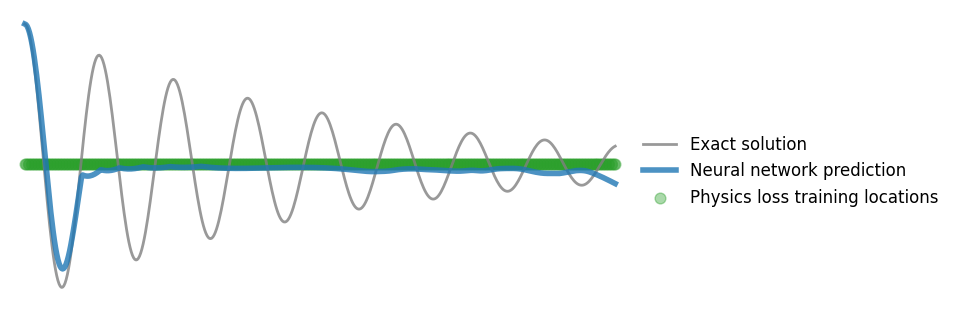

Epochs Progress:  80%|███████▉  | 15995/20000 [04:34<01:00, 66.43it/s]

epoch: 16000, loss: 39.211185455322266


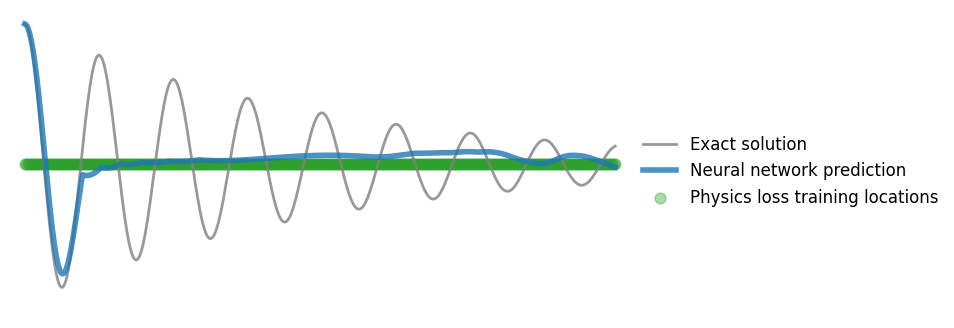

Epochs Progress:  82%|████████▎ | 16500/20000 [04:43<01:04, 54.08it/s]

epoch: 16500, loss: 31.655771255493164


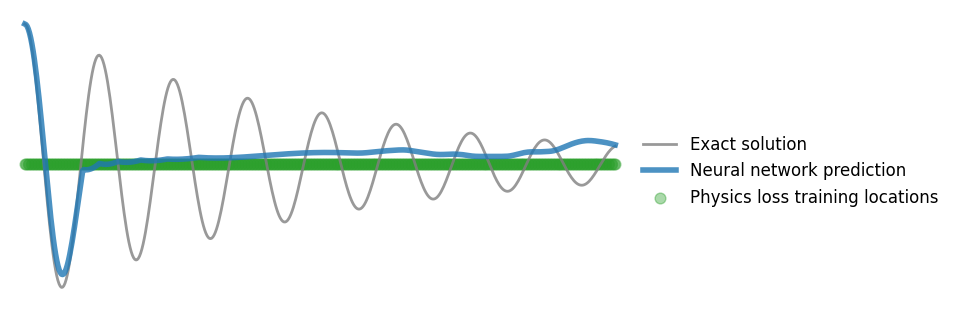

Epochs Progress:  85%|████████▍ | 16997/20000 [04:52<00:44, 67.32it/s]

epoch: 17000, loss: 18.823741912841797


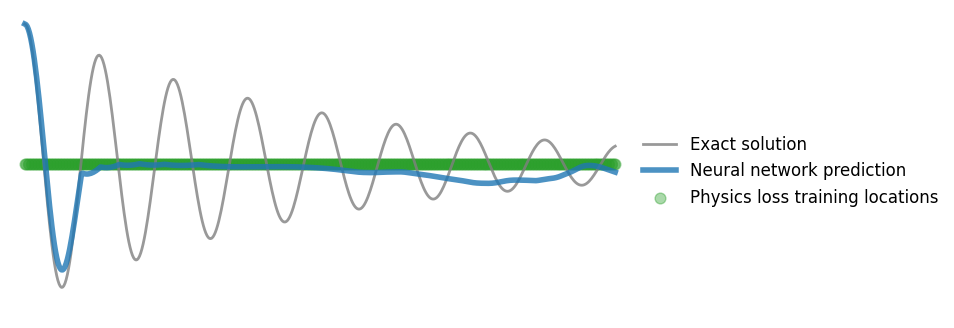

Epochs Progress:  87%|████████▋ | 17494/20000 [05:01<00:37, 66.97it/s]

epoch: 17500, loss: 19.529064178466797


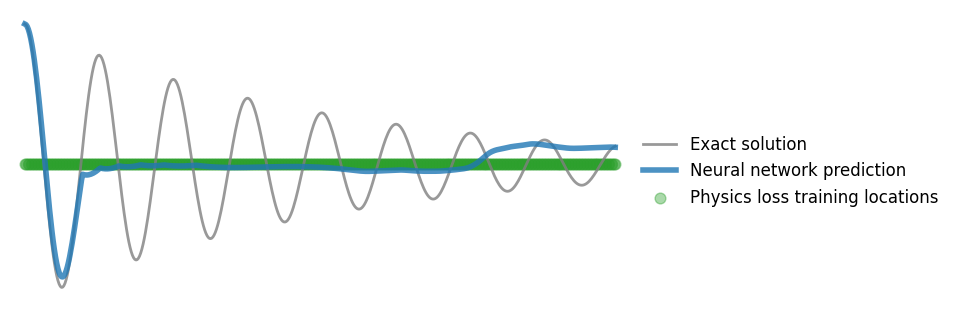

Epochs Progress:  90%|████████▉ | 17994/20000 [05:09<00:28, 70.02it/s]

epoch: 18000, loss: 35.995670318603516


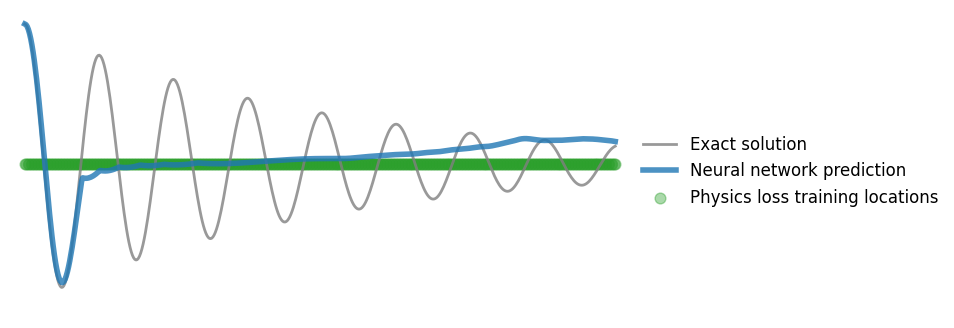

Epochs Progress:  92%|█████████▏| 18494/20000 [05:18<00:21, 70.05it/s]

epoch: 18500, loss: 34.387149810791016


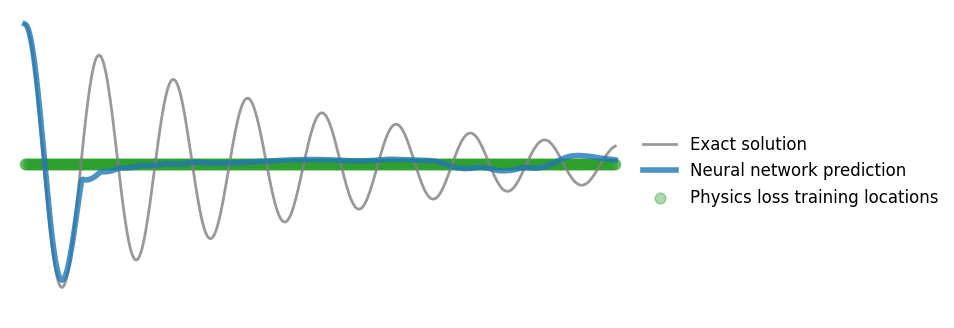

Epochs Progress:  95%|█████████▍| 18997/20000 [05:27<00:18, 55.10it/s]

epoch: 19000, loss: 19.759864807128906


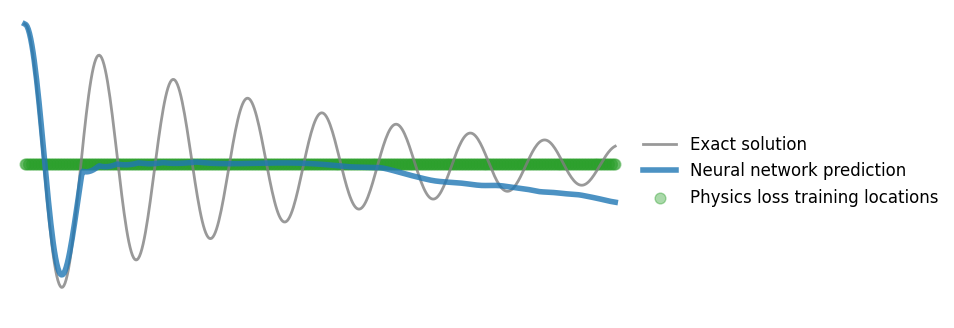

Epochs Progress:  97%|█████████▋| 19495/20000 [05:36<00:07, 67.20it/s]

epoch: 19500, loss: 21.657245635986328


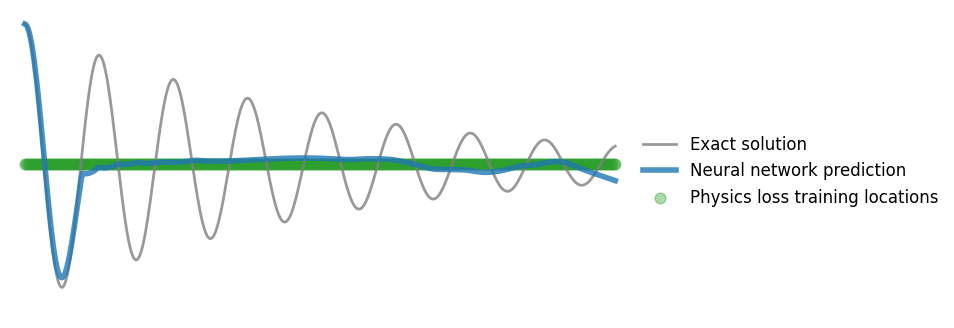

Epochs Progress: 100%|██████████| 20000/20000 [05:46<00:00, 57.76it/s]


In [ ]:
only_physics_train(harmonic_c_optimizer_expert_2, harmonic_c_expert_2, harmonic_loss, harmonic_trial_solution, epochs = 20000, display_step=500,domain_lb=0, domain_ub=2, num_points=400,  plot_points=500, x = display_x ,y = display_y, gif_n="harmonic_c_optimizer_expert_2")

# **Custom Activation Function for Neural Networks**

In this notebook, we explore a custom activation function inspired by periodic and non-linear transformations. We base our approach on activation function concepts discussed in the following paper:

[Activation Functions and Periodicity](https://arxiv.org/html/2401.10967v1#:~:text=2.2%20Activation%20Functions%20and%20Periodicity,-Report%20issue%20for&text=Activations%20are%20essential%20for%20neural,Rectified%20Linear%20Unit%20(ReLU)).

The activation function we are using is defined as:

$$
f(x) = \tanh\left(\beta \cdot \sin( x)\right)
$$

where \( x \) is the input to the activation function.

This function combines the non-linearity of the \( $\tanh$ \) function with the periodic nature of the \( $\sin$ \) function, allowing it to capture complex patterns in data while maintaining smooth gradients.


In [ ]:
class TanhSinActivation(nn.Module):
    def __init__(self):
        super(TanhSinActivation, self).__init__()
        # Initialize alpha as a trainable parameter, starting with 0.8
        self.alpha = nn.Parameter(torch.tensor(-0.8))

    def forward(self, x):
        # Apply the activation function with the trainable alpha
        return torch.tanh(self.alpha * torch.sin(x))

In [ ]:
harmonic_model_6 = MixtureOfExperts(N_EXPERT = 1, N_LAYERS = 5, act = TanhSinActivation)
harmonic_optimizer_6 = optim.Adam(harmonic_model_6.parameters(), lr = lr)

In [ ]:
only_physics_train(harmonic_optimizer_6, harmonic_model_6, harmonic_loss, harmonic_trial_solution, epochs = 40000, display_step=500,domain_lb=0, domain_ub=2, num_points=200,  plot_points=500, x = display_x ,y = display_y, gif_n="harmonic_1_5_softplus_complex_periodic")





# This Approach is Not Working
Since the current approach is not yielding satisfactory results, we will now try a method inspired by **Physics-Informed Neural Networks (PINNs)**.

---

### What are Physics-Informed Neural Networks (PINNs)?

Physics-Informed Neural Networks (PINNs) are a class of neural networks that incorporate physical laws into the training process. Unlike traditional neural networks that rely purely on data, PINNs leverage differential equations to inform the model about the underlying physics of the system being modeled. This allows PINNs to learn solutions that respect physical constraints, making them particularly effective for solving problems governed by partial differential equations (PDEs) and ordinary differential equations (ODEs).

In PINNs, the loss function is constructed not only from data (if available) but also from terms that enforce the physical laws (such as conservation laws, boundary conditions, or system dynamics). By combining data-driven learning with physics-based constraints, PINNs can achieve better generalization and handle cases where data is sparse or noisy.

---

### Why Try the PINN Approach?

1. **Better Generalization**: By incorporating physical constraints, PINNs can generalize better in scenarios where conventional approaches might fail.
2. **Handling Sparse Data**: PINNs can work effectively with limited data by using the underlying physics to guide the model.
3. **Improved Stability**: The physics-based regularization in PINNs often leads to more stable and physically realistic solutions.

---

### Next Steps

We'll modify the current model to incorporate physical constraints, similar to the PINN framework, to see if this yields better results.


In [ ]:
torch.manual_seed(123)

In [ ]:
w0 = 25
d = 1
display_x = torch.linspace(0, 2, 200, requires_grad=False).unsqueeze(1)
display_y = harmonic_oscillator(display_x)

In [ ]:
harmonic_expert_1_pinn = MixtureOfExperts(N_EXPERT = 1, N_LAYERS = 5)
harmonic_optimizer_expert_1_pinn = optim.Adam(harmonic_expert_1_pinn.parameters(), lr=5e-3)

In [ ]:
x_physics = torch.linspace(0,2,100).view(-1,1).requires_grad_(True)
x_data = display_x[0:150:15]
y_data = display_y[0:150:15]
mu, k = 2*d, w0**2

files = []
for i in range(40000):
    harmonic_optimizer_expert_1_pinn.zero_grad()

    yh = harmonic_expert_1_pinn(x_data)
    loss1 = torch.mean((yh-y_data)**2)

    inp = torch.tensor([0.0]).requires_grad_(True)
    yb = harmonic_expert_1_pinn(inp)
    loss1 = torch.mean(loss1 + 0.1*(yb - 1)**2)


    yhp = harmonic_expert_1_pinn(x_physics)
    dx  = torch.autograd.grad(yhp, x_physics, torch.ones_like(yhp), create_graph=True)[0]
    dx2 = torch.autograd.grad(dx,  x_physics, torch.ones_like(dx),  create_graph=True)[0]
    physics = dx2 + mu*dx + k*yhp
    loss2 = (1e-5)*torch.mean(physics**2)

    loss = loss1 + loss2
    loss.backward()
    harmonic_optimizer_expert_1_pinn.step()


    # plot the result as training progresses
    if (i+1) % 100 == 0:

        yh = harmonic_expert_1_pinn(display_x).detach()
        xp = x_physics.detach()

        grad_norms = torch.norm(x_physics.grad, dim=1)  # Or another aggregation if you have multiple layers
        influential_points = torch.topk(grad_norms, k=5)

        plot_result(display_x,display_y,display_x,yh, xp,i, x_data,y_data)

        file = "plots/harmonic_c_expert_1_pinn_%.8i.png"%(i+1)
        plt.savefig(file, bbox_inches='tight', pad_inches=0.1, dpi=100, facecolor="white")
        files.append(file)

        if (i+1) % 1000 == 0:
          plt.show()
          print(influential_points)
        else: plt.close("all")

save_gif_PIL("pinn.gif", files, fps=20, loop=0)

In [ ]:
harmonic_c_expert_1_pinn = MixtureOfExperts(N_EXPERT = 1, N_LAYERS = 5)
harmonic_optimizer_c_expert_1_pinn = optim.Adam(harmonic_c_expert_1_pinn.parameters(), lr=5e-3)

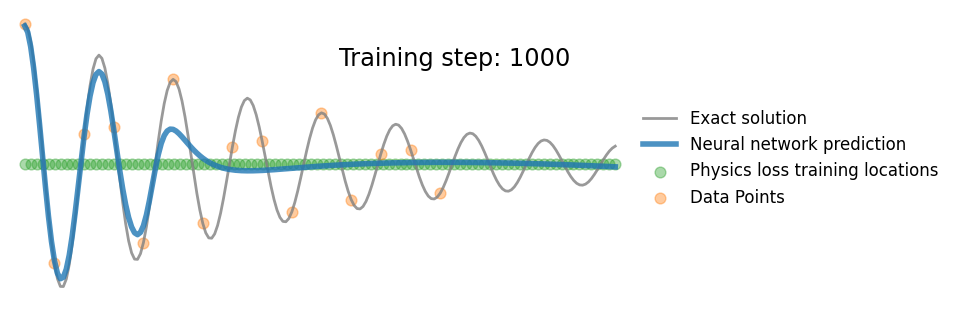

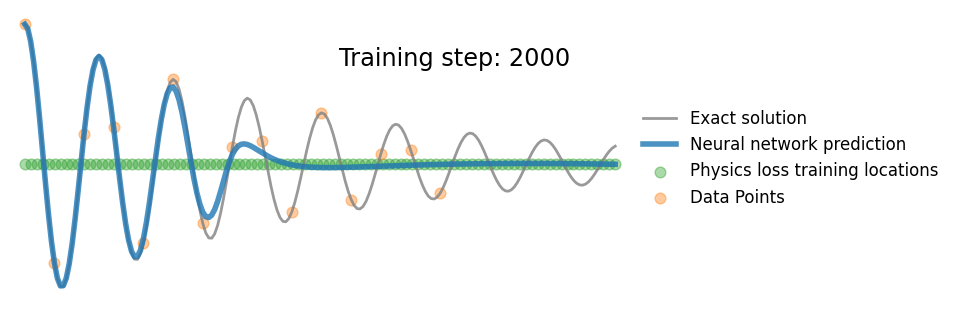

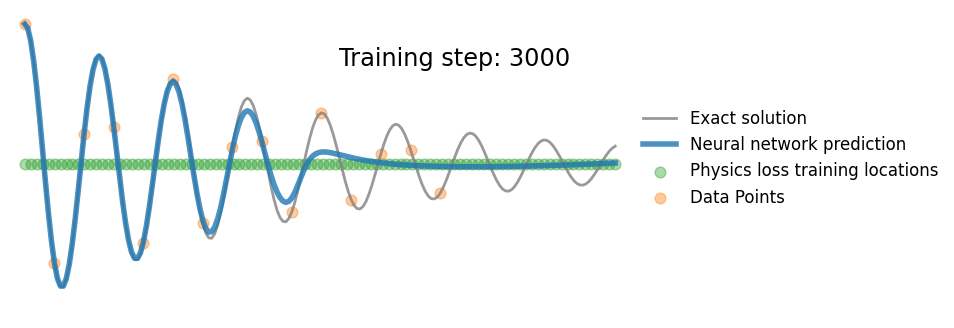

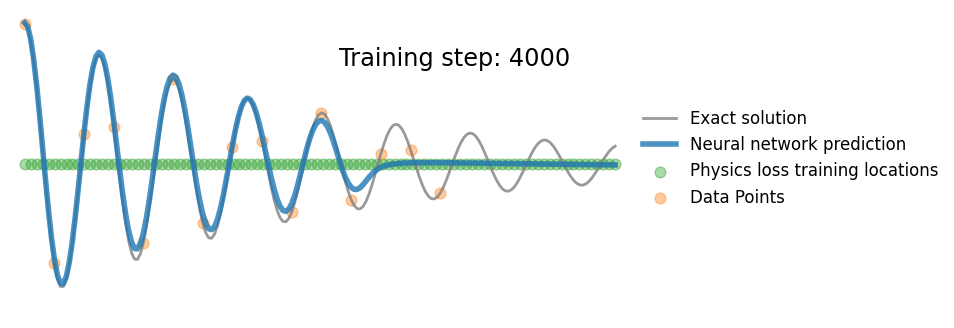

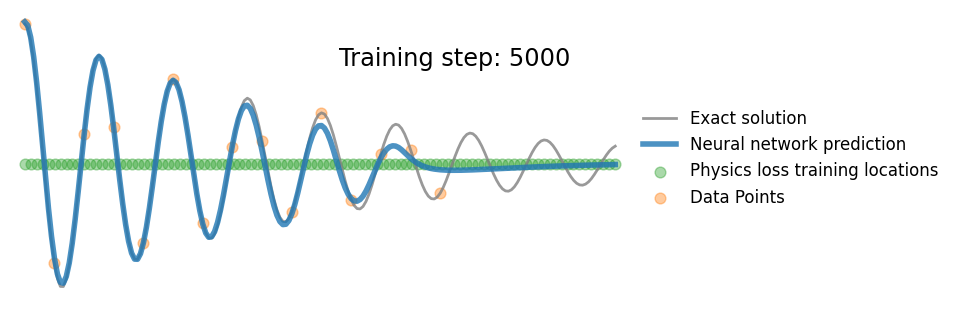

...

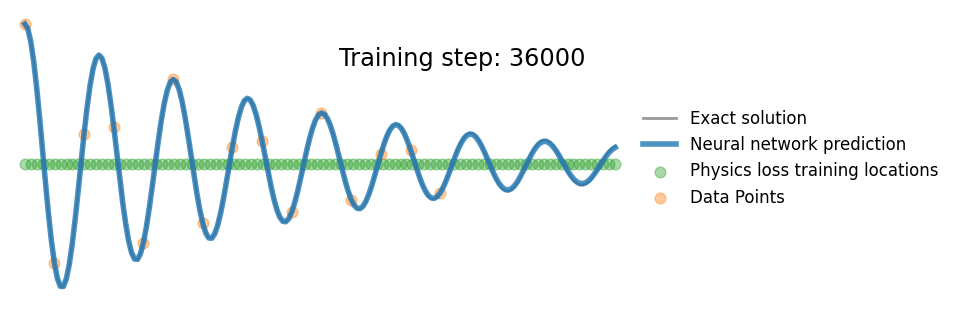

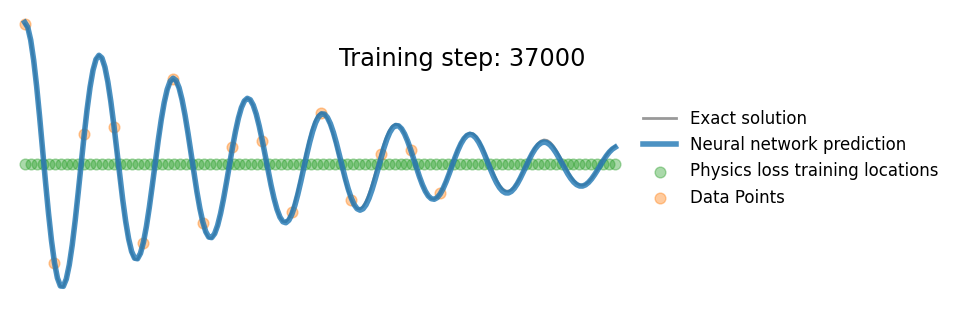

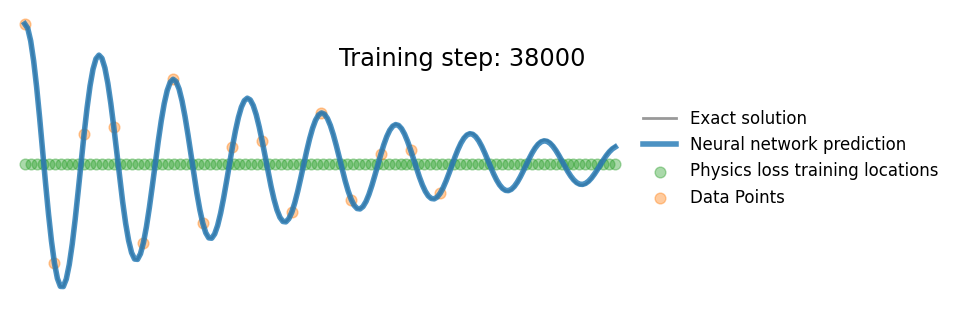

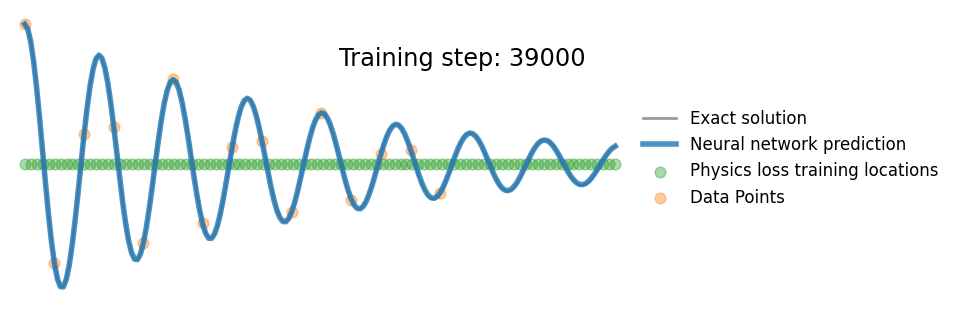

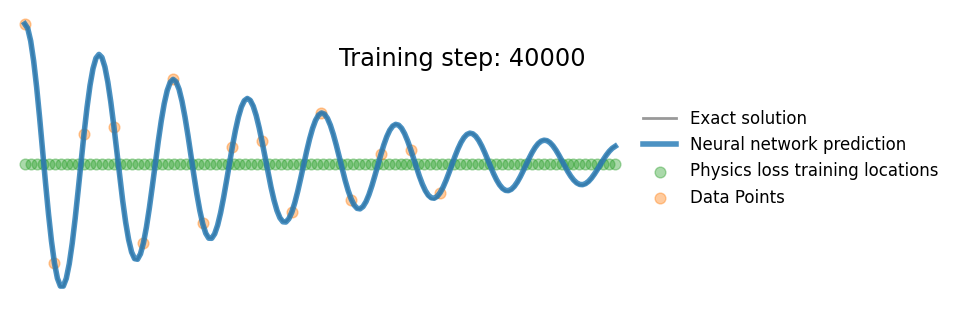

In [ ]:
x_physics = torch.linspace(0,2,100).view(-1,1).requires_grad_(True)
x_data = display_x[0:150:10]
y_data = display_y[0:150:10]
mu, k = 2*d, w0**2

files = []
for i in range(40000):
    harmonic_optimizer_c_expert_1_pinn.zero_grad()

    yh = harmonic_c_expert_1_pinn(x_data)
    loss1 = torch.mean((yh-y_data)**2)

    inp = torch.tensor([0.0]).requires_grad_(True)
    yb = harmonic_c_expert_1_pinn(inp)
    loss1 = torch.mean(loss1 + 0.1*(yb - 1)**2)


    yhp = harmonic_c_expert_1_pinn(x_physics)
    dx  = torch.autograd.grad(yhp, x_physics, torch.ones_like(yhp), create_graph=True)[0]
    dx2 = torch.autograd.grad(dx,  x_physics, torch.ones_like(dx),  create_graph=True)[0]
    physics = dx2 + mu*dx + k*yhp
    loss2 = (1e-5)*torch.mean(physics**2)

    loss = loss1 + loss2
    loss.backward()
    harmonic_optimizer_c_expert_1_pinn.step()


    # plot the result as training progresses
    if (i+1) % 100 == 0:

        yh = harmonic_c_expert_1_pinn(display_x).detach()
        xp = x_physics.detach()

        plot_result(display_x,display_y,display_x,yh, xp,i, x_data,y_data)

        file = "plots/harmonic_c_expert_1_pinn_%.8i.png"%(i+1)
        plt.savefig(file, bbox_inches='tight', pad_inches=0.1, dpi=100, facecolor="white")
        files.append(file)

        if (i+1) % 1000 == 0: plt.show()
        else: plt.close("all")

save_gif_PIL("pinn.gif", files, fps=20, loop=0)

In [ ]:
# x_physics = torch.linspace(0,2,100).view(-1,1).requires_grad_(True)
# x_data = display_x[0:150:10]
# y_data = display_y[0:150:10]
# mu, k = 2*d, w0**2

# files = []
# for i in range(2):
#     harmonic_optimizer_c_expert_1_pinn.zero_grad()

#     yh = harmonic_c_expert_1_pinn(x_data)
#     loss1 = torch.mean((yh-y_data)**2)

#     inp = torch.tensor([0.0]).requires_grad_(True)
#     yb = harmonic_c_expert_1_pinn(inp)
#     loss1 = torch.mean(loss1 + 0.1*(yb - 1)**2)


#     yhp = harmonic_c_expert_1_pinn(x_physics)
#     dx  = torch.autograd.grad(yhp, x_physics, torch.ones_like(yhp), create_graph=True)[0]
#     dx2 = torch.autograd.grad(dx,  x_physics, torch.ones_like(dx),  create_graph=True)[0]
#     physics = dx2 + mu*dx + k*yhp
#     loss2 = (1e-5)*torch.mean(physics**2)

#     loss = loss1 + loss2
#     loss.backward()
#     harmonic_optimizer_c_expert_1_pinn.step()


#     # plot the result as training progresses
#     # if (i+1) % 100 == 0:

#     yh = harmonic_c_expert_1_pinn(display_x).detach()
#     xp = x_physics.detach()

#     plot_result(display_x,display_y,display_x,yh, xp,i, x_data,y_data)

#     # file = "plots/harmonic_c_expert_1_pinn_%.8i.png"%(i+1)
#     # plt.savefig(file, bbox_inches='tight', pad_inches=0.1, dpi=100, facecolor="white")
#     files.append(file)

#     if (i+1) % 1000 == 0: plt.show()
#     else: plt.close("all")

#     # grad_norms = torch.norm(x_physics.grad, dim=1)  # Or another aggregation if you have multiple layers
#     # influential_points = torch.topk(grad_norms, k=5)
#     # print(influential_points)

# # save_gif_PIL("pinn.gif", files, fps=20, loop=0)

torch.return_types.topk(
values=tensor([0.0014, 0.0010, 0.0009, 0.0008, 0.0007]),
indices=tensor([11,  0, 12,  6, 10]))
torch.return_types.topk(
values=tensor([0.0006, 0.0003, 0.0003, 0.0002, 0.0002]),
indices=tensor([11,  7,  0,  1, 18]))


In [ ]:
harmonic_model_8 = MixtureOfExperts(N_EXPERT = 2, N_LAYERS = 5)
harmonic_optimizer_8 = optim.Adam(harmonic_model_8.parameters(), lr=5e-3)

In [ ]:
x_physics = torch.linspace(0,2,100).view(-1,1).requires_grad_(True)
x_data = display_x[0:150:10]
y_data = display_y[0:150:10]
mu, k = 2*d, w0**2

files = []
for i in range(40000):
    harmonic_optimizer_8.zero_grad()

    yh = harmonic_model_8(x_data)
    loss1 = torch.mean((yh-y_data)**2)

    inp = torch.tensor([0.0]).requires_grad_(True)
    yb = harmonic_model_8(inp)
    loss1 = torch.mean(loss1 + 0.1*(yb - 1)**2)


    yhp = harmonic_model_8(x_physics)
    dx  = torch.autograd.grad(yhp, x_physics, torch.ones_like(yhp), create_graph=True)[0]
    dx2 = torch.autograd.grad(dx,  x_physics, torch.ones_like(dx),  create_graph=True)[0]
    physics = dx2 + mu*dx + k*yhp
    loss2 = (1e-5)*torch.mean(physics**2)

    loss = loss1 + loss2
    loss.backward()
    harmonic_optimizer_8.step()


    # plot the result as training progresses
    if (i+1) % 100 == 0:

        yh = harmonic_model_8(display_x).detach()
        xp = x_physics.detach()

        plot_result(display_x,display_y,display_x,yh, xp,i, x_data,y_data)

        file = "plots/harmonic_1_40000_pinn_%.8i.png"%(i+1)
        plt.savefig(file, bbox_inches='tight', pad_inches=0.1, dpi=100, facecolor="white")
        files.append(file)

        if (i+1) % 1000 == 0: plt.show()
        else: plt.close("all")

save_gif_PIL("pinn.gif", files, fps=20, loop=0)

In [ ]:
harmonic_model_9 = MixtureOfExperts(N_EXPERT = 2, N_LAYERS = 5, act = nn.Softplus)
harmonic_optimizer_9 = optim.Adam(harmonic_model_9.parameters(), lr=5e-3)

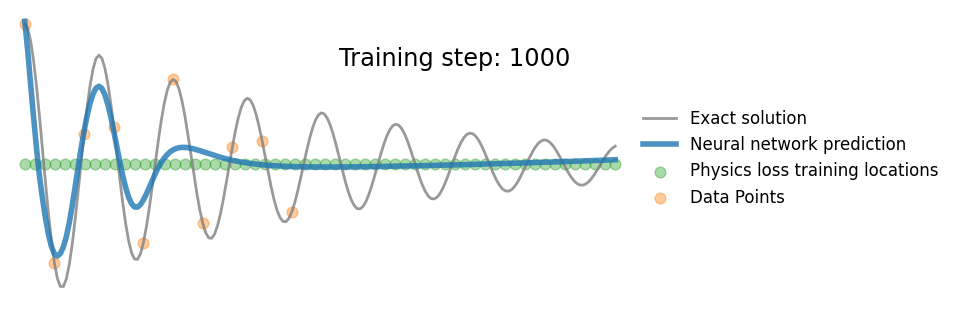

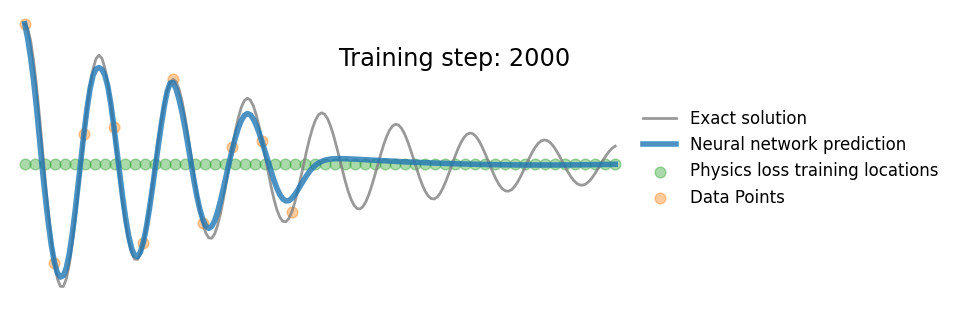

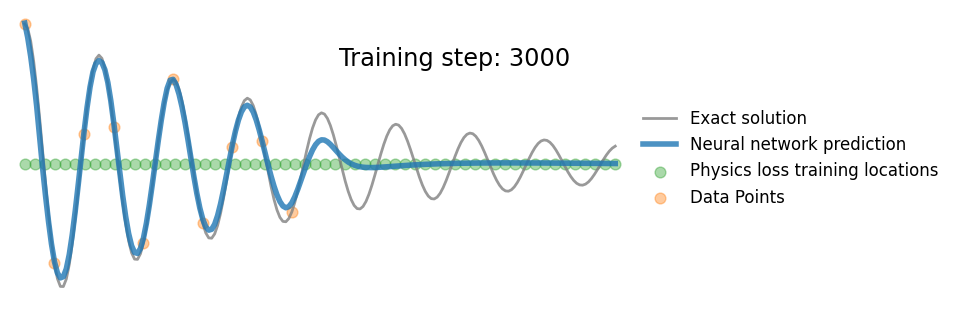

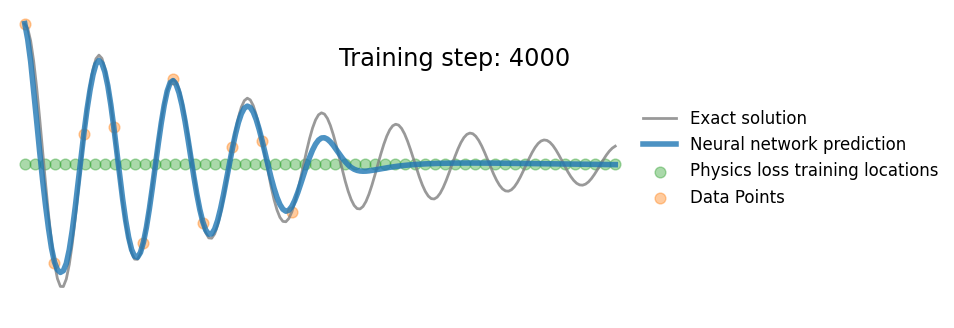

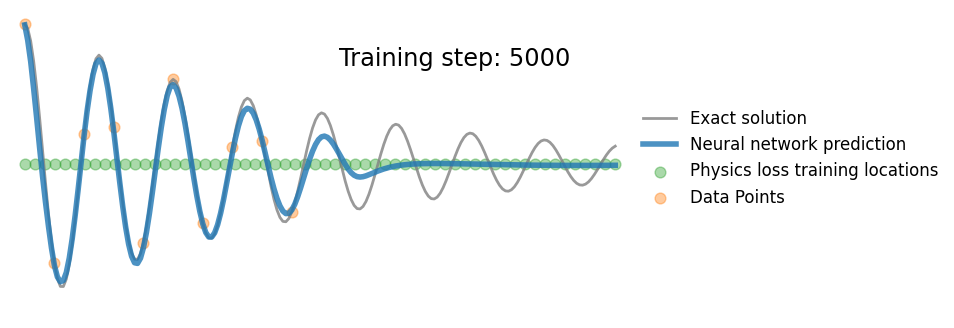

...

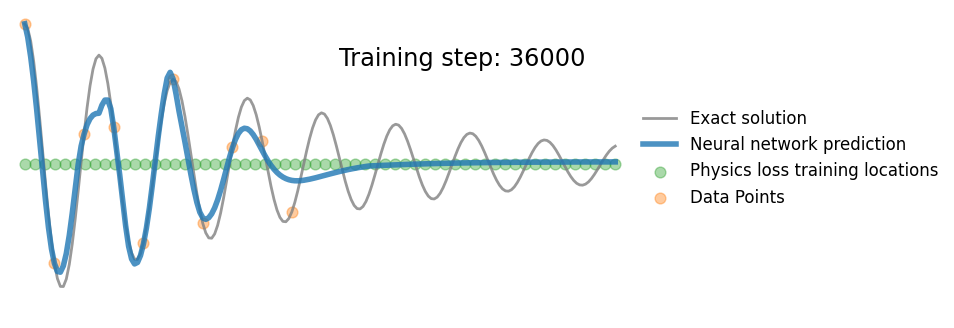

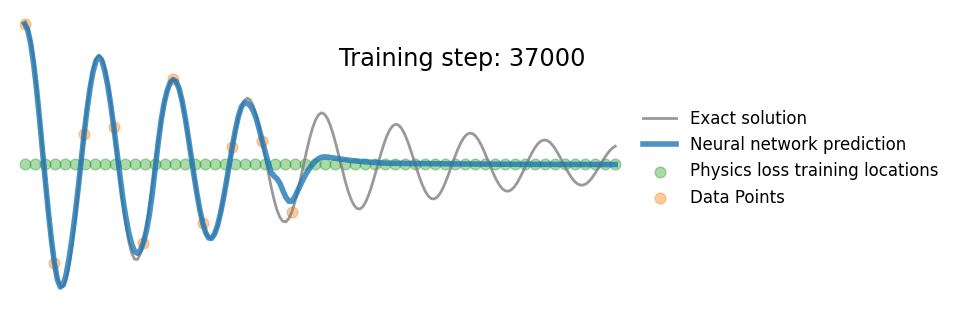

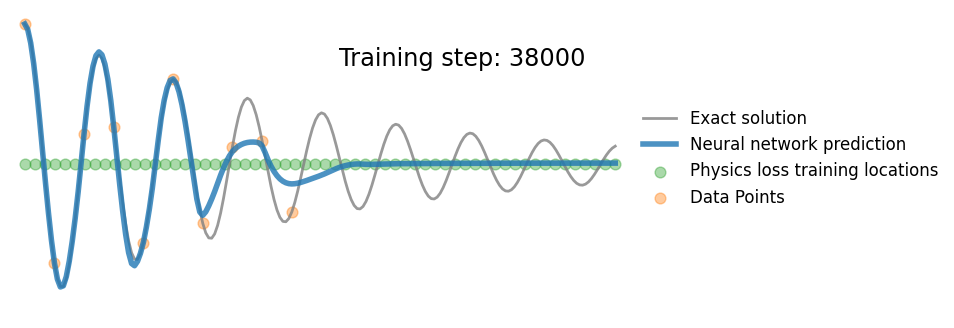

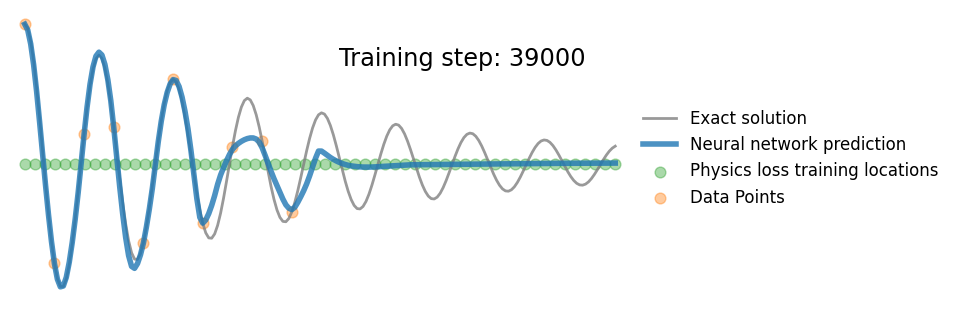

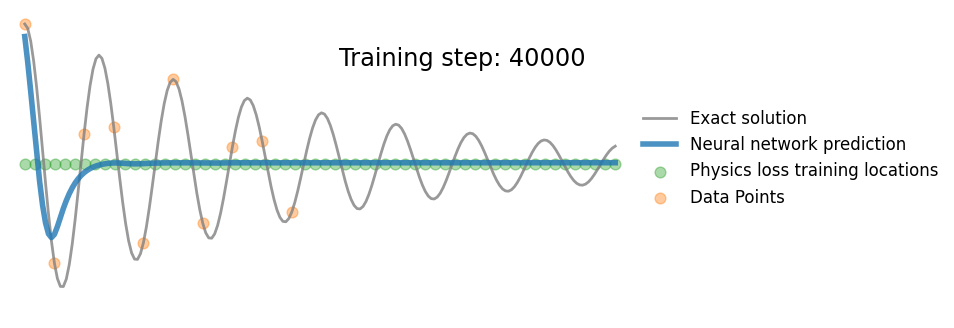

In [ ]:
x_physics = torch.linspace(0,2,60).view(-1,1).requires_grad_(True)
x_data = display_x[0:100:10]
y_data = display_y[0:100:10]
mu, k = 2*d, w0**2

files = []
for i in range(40000):
    harmonic_optimizer_9.zero_grad()

    # compute the "data loss"
    yh = harmonic_model_9(x_data)
    loss1 = torch.mean((yh-y_data)**2)# use mean squared error
    # print(loss1)

    # compute boundry loss
    inp = torch.tensor([0.0]).requires_grad_(True)
    yb = harmonic_model_9(inp)
    # dx_dt = torch.autograd.grad(yb, inp, create_graph=True, grad_outputs=torch.ones_like(torch.tensor([0.0])))[0]
    loss1 = torch.mean(loss1 + 0.1*(yb - 1)**2)

    # compute the "physics loss"
    yhp = harmonic_model_9(x_physics)
    dx  = torch.autograd.grad(yhp, x_physics, torch.ones_like(yhp), create_graph=True)[0]# computes dy/dx
    dx2 = torch.autograd.grad(dx,  x_physics, torch.ones_like(dx),  create_graph=True)[0]# computes d^2y/dx^2
    physics = dx2 + mu*dx + k*yhp
    loss2 = (1e-5)*torch.mean(physics**2)

    # backpropagate joint loss
    loss = loss1 + loss2
    loss.backward()
    harmonic_optimizer_9.step()


    # plot the result as training progresses
    if (i+1) % 100 == 0:

        yh = harmonic_model_9(display_x).detach()
        xp = x_physics.detach()

        plot_result(display_x,display_y,display_x,yh, xp,i, x_data,y_data)

        file = "plots/harmonic_2_40000_pinn_%.8i.png"%(i+1)
        plt.savefig(file, bbox_inches='tight', pad_inches=0.1, dpi=100, facecolor="white")
        files.append(file)

        if (i+1) % 1000 == 0: plt.show()
        else: plt.close("all")

save_gif_PIL("pinn.gif", files, fps=20, loop=0)

In [ ]:
harmonic_model_9 = MixtureOfExperts(N_EXPERT = 2, N_LAYERS = 5)
harmonic_optimizer_9 = optim.Adam(harmonic_model_9.parameters(), lr=5e-3)

In [ ]:
x_physics = torch.linspace(0,2,60).view(-1,1).requires_grad_(True)
x_data = display_x[0:100:10]
y_data = display_y[0:100:10]
mu, k = 2*d, w0**2

files = []
for i in range(40000):
    harmonic_optimizer_9.zero_grad()

    # compute the "data loss"
    yh = harmonic_model_9(x_data)
    loss1 = torch.mean((yh-y_data)**2)# use mean squared error
    # print(loss1)

    # compute boundry loss
    inp = torch.tensor([0.0]).requires_grad_(True)
    yb = harmonic_model_9(inp)
    # dx_dt = torch.autograd.grad(yb, inp, create_graph=True, grad_outputs=torch.ones_like(torch.tensor([0.0])))[0]
    loss1 = torch.mean(loss1 + 0.1*(yb - 1)**2)

    # compute the "physics loss"
    yhp = harmonic_model_9(x_physics)
    dx  = torch.autograd.grad(yhp, x_physics, torch.ones_like(yhp), create_graph=True)[0]# computes dy/dx
    dx2 = torch.autograd.grad(dx,  x_physics, torch.ones_like(dx),  create_graph=True)[0]# computes d^2y/dx^2
    physics = dx2 + mu*dx + k*yhp
    loss2 = (1e-5)*torch.mean(physics**2)

    # backpropagate joint loss
    loss = loss1 + loss2
    loss.backward()
    harmonic_optimizer_9.step()


    # plot the result as training progresses
    if (i+1) % 100 == 0:

        yh = harmonic_model_9(display_x).detach()
        xp = x_physics.detach()

        plot_result(display_x,display_y,display_x,yh, xp,i, x_data,y_data)

        file = "plots/harmonic_2_40000_pinn_%.8i.png"%(i+1)
        plt.savefig(file, bbox_inches='tight', pad_inches=0.1, dpi=100, facecolor="white")
        files.append(file)

        if (i+1) % 1000 == 0: plt.show()
        else: plt.close("all")

save_gif_PIL("hermite_pinn_10_points.gif", files, fps=20, loop=0)